# Two-agent Pong

The following code solves the two-player Pong game using a reinforcement learning (RL) algorithm for a single agent only, and where the competitor is an element of the gaming environment.

The popular OpenAI Gym Implementation of the ATARI 2600 Pong game is employed below.

In [17]:
import numpy as np
import pickle
import gym
from IPython.display import Image

# General Overview

- We receive an image frame (a 210x160x3 byte array (integers from 0 to 255 giving pixel values)) based on which the algorithm should decide if the paddle should be moved UP or DOWN (i.e. a binary decision).
 
- After every single decision the game simulator executes the action and returns a reward: Either a +1 reward if the ball went past the opponent, a -1 reward if the agent missed the ball, or 0 otherwise. 
 
- The goal is to move the paddle so that the agent maximizes the total reward.

# Neural Network (NN)

- The following network is a two-layer fully connected NN with output layer of size 1 indicating the probability of moving "up". 

- It uses ReLU nonlinearity.

- The optimization algorithm is based on G.Hinton's adaptive RMSProp.

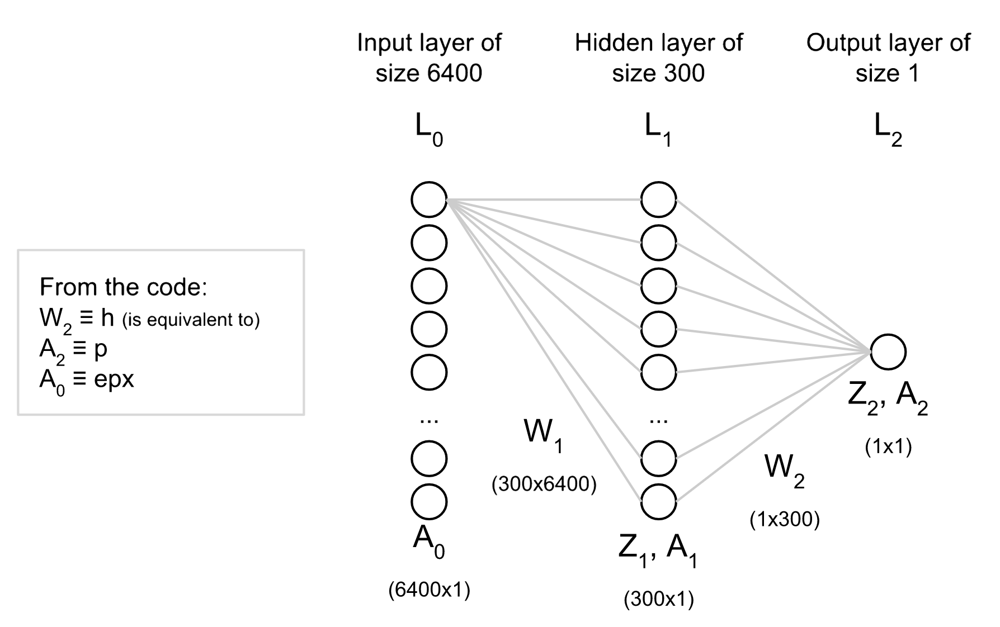

In [16]:
Image(filename='nn.png') 

In [9]:
# The following code implements the training process proposed by Andrew Karpaty with some minor changes:
# https://gist.github.com/karpathy/a4166c7fe253700972fcbc77e4ea32c5

# hyperparameters
H = 200 # number of hidden layer neurons
batch_size = 10 # number of episodes before updating parameters
learning_rate = 1e-4 

gamma = 0.99 # discount factor for reward
decay_rate = 0.99 # decay factor for RMSProp leaky sum of grad^2
resume = False # resume from previous checkpoint. Set True for inference mode
render = False

# model initialization
# the model is a dictionary with two weights matrices
D = 80 * 80 # input dimensionality: 80x80 grid
if resume:
    model = pickle.load(open('RL.pkl', 'rb'))
else:
    model = {}
    # set the initial state of the parameters
    model['W1'] = np.random.randn(H,D) / np.sqrt(D) 
    model['W2'] = np.random.randn(H) / np.sqrt(H)

grad_buffer = { k : np.zeros_like(v) for k,v in model.items() } # update buffers that add up gradients over a batch
rmsprop_cache = { k : np.zeros_like(v) for k,v in model.items() } # rmsprop memory

def sigmoid(x): 
    '''Sigmoid "squashing" function to interval [0,1]'''
    return 1.0 / (1.0 + np.exp(-x))


def prepro(I):
    """ prepro 210x160x3 uint8 frame into 6400 (80x80) 1D float vector """
    I = I[35:195] # crop
    I = I[::2,::2,0] # downsample by factor of 2
    I[I == 144] = 0 # erase background (background type 1)
    I[I == 109] = 0 # erase background (background type 2)
    I[I != 0] = 1 # everything else (paddles, ball) set to 1
    return I.astype(np.float).ravel()

def discount_rewards(r):
    """ take 1D float array of rewards and compute discounted reward """
    discounted_r = np.zeros_like(r)
    running_add = 0
    for t in reversed(range(0, r.size)):
        if r[t] != 0: running_add = 0 # reset the sum since this is a game boundary
        running_add = running_add * gamma + r[t]
        discounted_r[t] = running_add
    return discounted_r

def policy_forward(x):
    h = np.dot(model['W1'], x)
    h[h<0] = 0 # ReLU nonlinearity
    logp = np.dot(model['W2'], h)
    p = sigmoid(logp)
    return p, h # return probability of taking action 2, and hidden state

def policy_backward(eph, epdlogp):
    """ backward pass. (eph is array of intermediate hidden states) """
    dW2 = np.dot(eph.T, epdlogp).ravel()
    dh = np.outer(epdlogp, model['W2'])
    dh[eph <= 0] = 0 # backpro prelu
    dW1 = np.dot(dh.T, epx)
    return {'W1':dW1, 'W2':dW2}

env = gym.make("Pong-v0")
observation = env.reset()
prev_x = None # used in computing the difference frame
xs,hs,dlogps,drs = [],[],[],[]
running_reward = None
reward_sum = 0
episode_number = 0
while True:
    if render: env.render()

    # preprocess the observation, set input to network to be difference image
    cur_x = prepro(observation)
    x = cur_x - prev_x if prev_x is not None else np.zeros(D)
    prev_x = cur_x

    # forward the policy network and sample an action from the returned probability
    aprob, h = policy_forward(x)
    action = 2 if np.random.uniform() < aprob else 3 

    # record various intermediates (needed later for backprop)
    xs.append(x) # observation
    hs.append(h) # hidden state
    y = 1 if action == 2 else 0 
    dlogps.append(y - aprob) 

    # step the environment and get new measurements
    observation, reward, done, info = env.step(action)
    reward_sum += reward

    drs.append(reward) # record reward (has to be done after we call step() to get reward for previous action)

    if done: # an episode finished
        episode_number += 1

        # stack together all inputs, hidden states, action gradients, and rewards for this episode
        epx = np.vstack(xs)
        eph = np.vstack(hs)
        epdlogp = np.vstack(dlogps)
        epr = np.vstack(drs)
        xs,hs,dlogps,drs = [],[],[],[] # reset array memory
    
        # compute the discounted reward backwards through time
        discounted_epr = discount_rewards(epr)
        # standardize the rewards to be unit normal (helps control the gradient estimator variance)
        discounted_epr -= np.mean(discounted_epr)
        discounted_epr /= np.std(discounted_epr)

        epdlogp *= discounted_epr # modulate the gradient
        grad = policy_backward(eph, epdlogp)
        for k in model: grad_buffer[k] += grad[k] # accumulate grad over batch

        # perform rmsprop parameter update every batch_size episodes
        if episode_number % batch_size == 0:
              for k,v in model.items():
                    g = grad_buffer[k] # gradient
                    rmsprop_cache[k] = decay_rate * rmsprop_cache[k] + (1 - decay_rate) * g**2
                    model[k] += learning_rate * g / (np.sqrt(rmsprop_cache[k]) + 1e-5)
                    grad_buffer[k] = np.zeros_like(v) # reset batch gradient buffer

        # Recording of output
        running_reward = reward_sum if running_reward is None else running_reward * 0.99 + reward_sum * 0.01
        print('resetting env. episode reward total was %f. running mean: %f' % (reward_sum, running_reward))
        if episode_number % 100 == 0: pickle.dump(model, open('RL.pkl', 'wb'))
        reward_sum = 0
        observation = env.reset() # reset env
        prev_x = None

    if reward != 0: # Pong has either +1 or -1 reward exactly when game ends.
        print('ep %d: game finished, reward: %f' % (episode_number, reward))

ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: 1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
ep 0: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.000000
ep 1: game finished, reward: -1.000000
ep 1: game finished, reward: -1.000000
ep 1: game finished, reward

ep 8: game finished, reward: -1.000000
ep 8: game finished, reward: -1.000000
ep 8: game finished, reward: -1.000000
ep 8: game finished, reward: -1.000000
ep 8: game finished, reward: -1.000000
ep 8: game finished, reward: -1.000000
ep 8: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.950883
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, reward: -1.000000
ep 9: game finished, rewar

ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: 1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: 1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
ep 17: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.982212
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18: game finished, reward: -1.000000
ep 18

ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
ep 26: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.032382
ep 27: game finished, reward: -1.000000
ep 27: game finished, reward: -1.000000
ep 27: game finished, reward: -1.000000
ep 27: game finished, reward: -1.000000
ep 27: game finished, reward: -1.000000
ep 27: game finished, reward: -1.000000
ep 

ep 34: game finished, reward: -1.000000
ep 34: game finished, reward: -1.000000
ep 34: game finished, reward: -1.000000
ep 34: game finished, reward: -1.000000
ep 34: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.990367
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 35: game finished, reward: -1.000000
ep 

ep 43: game finished, reward: -1.000000
ep 43: game finished, reward: -1.000000
ep 43: game finished, reward: -1.000000
ep 43: game finished, reward: -1.000000
ep 43: game finished, reward: -1.000000
ep 43: game finished, reward: -1.000000
ep 43: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.040023
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 44: game finished, reward: -1.000000
ep 

ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
ep 52: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.094419
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 53: game finished, reward: -1.000000
ep 

ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
ep 61: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.116141
ep 62: game finished, reward: -1.000000
ep 62: game finished, reward: -1.000000
ep 62: game finished, reward: -1.000000
ep 62: game finished, reward: -1.000000
ep 62: game finished, reward: -1.000000
ep 62: game finished, reward: -1.000000
ep 62: game finished, reward: -1.000000
ep 

resetting env. episode reward total was -21.000000. running mean: -20.127643
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
ep 70: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.136367
ep 71:

resetting env. episode reward total was -21.000000. running mean: -20.193384
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: 1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
ep 79: game finished, reward: -1.000000
resetting env. episode reward total was -20.

ep 87: game finished, reward: -1.000000
ep 87: game finished, reward: -1.000000
ep 87: game finished, reward: -1.000000
ep 87: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.215284
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 88: game finished, reward: -1.000000
ep 

ep 96: game finished, reward: -1.000000
ep 96: game finished, reward: -1.000000
ep 96: game finished, reward: -1.000000
ep 96: game finished, reward: -1.000000
ep 96: game finished, reward: -1.000000
ep 96: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.264222
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 97: game finished, reward: -1.000000
ep 

ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: 1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
ep 105: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.279615
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished, reward: -1.000000
ep 106: game finished,

resetting env. episode reward total was -20.000000. running mean: -20.296442
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
ep 114: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running me

ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
ep 122: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.290710
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished, reward: -1.000000
ep 123: game finished

ep 130: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.268349
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: 1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished, reward: -1.000000
ep 131: game finished,

ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: 1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
ep 139: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.264252
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished, reward: -1.000000
ep 140: game finished,

ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
ep 148: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.308858
ep 149: game finished, reward: -1.000000
ep 149: game finished, reward: -1.000000
ep 149: game finished, reward: -1.000000
ep 149: game finished

ep 156: game finished, reward: -1.000000
ep 156: game finished, reward: -1.000000
ep 156: game finished, reward: -1.000000
ep 156: game finished, reward: -1.000000
ep 156: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.323141
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished, reward: -1.000000
ep 157: game finished

ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: 1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: 1.000000
ep 165: game finished, reward: -1.000000
ep 165: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.285675
ep 166: game finished, reward: -1.000000
ep 166: game finished, reward: -1.000000
ep 166: game finished, 

ep 173: game finished, reward: -1.000000
ep 173: game finished, reward: -1.000000
ep 173: game finished, reward: -1.000000
ep 173: game finished, reward: -1.000000
ep 173: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.312710
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: 1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished, reward: -1.000000
ep 174: game finished,

ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
ep 182: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.314688
ep 183: game finished, reward: -1.000000
ep 183: game finished, reward: -1.000000
ep 183: game finished, reward: -1.000000
ep 183: game finished, reward: -1.000000
ep 183: game finished, reward: -1.000000
ep 183: game finished, reward: -1.000000
ep 183: game finished, reward: -1.000000
ep 183: game finished

ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
ep 191: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.364350
ep 192: game finished, reward: -1.000000
ep 192: game finished, reward: -1.000000
ep 192: game finished, reward: -1.000000
ep 192: game finished

ep 199: game finished, reward: -1.000000
ep 199: game finished, reward: -1.000000
ep 199: game finished, reward: -1.000000
ep 199: game finished, reward: -1.000000
ep 199: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.384728
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished, reward: -1.000000
ep 200: game finished

ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
ep 208: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.360205
ep 209: game finished, reward: -1.000000
ep 209: game finished, reward: -1.000000
ep 209: game finished, reward: -1.000000
ep 209: game finished, reward: -1.000000
ep 209: game finished, reward: -1.000000
ep 209: game finished, reward: -1.000000
ep 209: game finished

resetting env. episode reward total was -19.000000. running mean: -20.380122
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: 1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, reward: 1.000000
ep 217: game finished, reward: -1.000000
ep 217: game finished, 

ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
ep 225: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.376559
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished, reward: -1.000000
ep 226: game finished

ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: 1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
ep 234: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.391557
ep 235: game finished, reward: -1.000000
ep 235: game finished,

ep 242: game finished, reward: 1.000000
ep 242: game finished, reward: -1.000000
ep 242: game finished, reward: -1.000000
ep 242: game finished, reward: 1.000000
ep 242: game finished, reward: -1.000000
ep 242: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.398763
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, reward: -1.000000
ep 243: game finished, 

ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: 1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: 1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
ep 251: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.373010
ep 252: game finished, reward: -1.000000
ep 252: game finished, reward: -1.000000
ep 252: game finished, reward: -1.000000
ep 252: game finished, 

ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
ep 259: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.363122
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished, reward: -1.000000
ep 260: game finished

ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: 1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
ep 268: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.379091
ep 269: game finished, reward: -1.000000
ep 269: game finished, reward: -1.000000
ep 269: game finished, reward: -1.000000
ep 269: game finished, reward: -1.000000
ep 269: game finished,

ep 276: game finished, reward: -1.000000
ep 276: game finished, reward: -1.000000
ep 276: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.407748
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished, reward: -1.000000
ep 277: game finished

ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: 1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: 1.000000
ep 285: game finished, reward: 1.000000
ep 285: game finished, reward: -1.000000
ep 285: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.353063
ep 286: game finished, reward: -1.000000
ep 286: game finished, reward: -1.000000
ep 286: game finished, reward: -1.000000
ep 286: game finished, r

ep 293: game finished, reward: -1.000000
ep 293: game finished, reward: -1.000000
ep 293: game finished, reward: -1.000000
ep 293: game finished, reward: -1.000000
ep 293: game finished, reward: -1.000000
ep 293: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.355487
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: 1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished, reward: -1.000000
ep 294: game finished,

ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: 1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
ep 302: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.353376
ep 303: game finished, reward: -1.000000
ep 303: game finished, reward: -1.000000
ep 303: game finished, reward: -1.000000
ep 303: game finished, reward: -1.000000
ep 303: game finished, reward: -1.000000
ep 303: game finished, reward: -1.000000
ep 303: game finished, reward: -1.000000
ep 303: game finished,

ep 310: game finished, reward: 1.000000
ep 310: game finished, reward: -1.000000
ep 310: game finished, reward: -1.000000
ep 310: game finished, reward: -1.000000
ep 310: game finished, reward: -1.000000
ep 310: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.326171
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: 1.000000
ep 311: game finished, reward: 1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, reward: -1.000000
ep 311: game finished, r

ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
ep 319: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.346388
ep 320: game finished, reward: -1.000000
ep 320: game finished, reward: -1.000000
ep 320: game finished, reward: -1.000000
ep 320: game finished, reward: -1.000000
ep 320: game finished, reward: -1.000000
ep 320: game finished, reward: -1.000000
ep 320: game finished, reward: -1.000000
ep 320: game finished

ep 327: game finished, reward: -1.000000
ep 327: game finished, reward: -1.000000
ep 327: game finished, reward: -1.000000
ep 327: game finished, reward: -1.000000
ep 327: game finished, reward: -1.000000
ep 327: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.320397
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished, reward: -1.000000
ep 328: game finished

ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
ep 336: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.350153
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished, reward: -1.000000
ep 337: game finished

ep 344: game finished, reward: -1.000000
ep 344: game finished, reward: -1.000000
ep 344: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.343186
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished, reward: -1.000000
ep 345: game finished

ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
ep 353: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.352135
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished, reward: -1.000000
ep 354: game finished

resetting env. episode reward total was -21.000000. running mean: -20.354633
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
ep 362: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running me

ep 370: game finished, reward: -1.000000
ep 370: game finished, reward: -1.000000
ep 370: game finished, reward: -1.000000
ep 370: game finished, reward: -1.000000
ep 370: game finished, reward: -1.000000
ep 370: game finished, reward: -1.000000
ep 370: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.381720
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: 1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished, reward: -1.000000
ep 371: game finished,

ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: 1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: 1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: 1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
ep 379: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.348117
ep 380: game finished, reward: -1.000000
ep 380: game finished, reward: -1.000000
ep 380: game finished, reward: -1.000000
ep 380: game finished, r

ep 387: game finished, reward: -1.000000
ep 387: game finished, reward: -1.000000
ep 387: game finished, reward: -1.000000
ep 387: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.379837
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: 1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished, reward: -1.000000
ep 388: game finished,

ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
ep 396: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.405031
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished, reward: -1.000000
ep 397: game finished

ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
ep 405: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.437265
ep 406: game finished, reward: -1.000000
ep 406: game finished, reward: -1.000000
ep 406: game finished

ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
ep 413: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.422608
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished, reward: -1.000000
ep 414: game finished

ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
ep 422: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.443237
ep 423: game finished, reward: -1.000000
ep 423: game finished, reward: -1.000000
ep 423: game finished, reward: -1.000000
ep 423: game finished, reward: -1.000000
ep 423: game finished, reward: -1.000000
ep 423: game finished

ep 430: game finished, reward: -1.000000
ep 430: game finished, reward: -1.000000
ep 430: game finished, reward: -1.000000
ep 430: game finished, reward: -1.000000
ep 430: game finished, reward: -1.000000
ep 430: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.428321
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished, reward: -1.000000
ep 431: game finished

ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
ep 439: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.429916
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished, reward: -1.000000
ep 440: game finished

resetting env. episode reward total was -21.000000. running mean: -20.426302
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: 1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: 1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, reward: -1.000000
ep 448: game finished, 

ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
ep 456: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.447562
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished, reward: -1.000000
ep 457: game finished

ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: 1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: 1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
ep 465: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.418272
ep 466: game finished, reward: -1.000000
ep 466: game finished, reward: -1.000000
ep 466: game finished, reward: -1.000000
ep 466: game finished, reward: -1.000000
ep 466: game finished, 

ep 473: game finished, reward: -1.000000
ep 473: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -20.433893
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished, reward: -1.000000
ep 474: game finished,

ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
ep 482: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.463925
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: 1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, reward: 1.000000
ep 483: game finished, reward: -1.000000
ep 483: game finished, 

ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
ep 491: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.463962
ep 492: game finished, reward: -1.000000
ep 492: game finished, reward: -1.000000
ep 492: game finished, reward: -1.000000
ep 492: game finished, reward: -1.000000
ep 492: game finished

ep 499: game finished, reward: -1.000000
ep 499: game finished, reward: -1.000000
ep 499: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.467328
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: 1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished, reward: -1.000000
ep 500: game finished,

ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: 1.000000
ep 508: game finished, reward: -1.000000
ep 508: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.446521
ep 509: game finished, reward: -1.000000
ep 509: game finished, reward: -1.000000
ep 509: game finished, reward: -1.000000
ep 509: game finished, reward: -1.000000
ep 509: game finished, reward: -1.000000
ep 509: game finished, reward: -1.000000
ep 509: game finished, reward: -1.000000
ep 509: game finished,

resetting env. episode reward total was -20.000000. running mean: -20.460449
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
ep 517: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running me

ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: 1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: 1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: -1.000000
ep 525: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.439459
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, reward: -1.000000
ep 526: game finished, 

resetting env. episode reward total was -21.000000. running mean: -20.425408
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
ep 534: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running me

ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: 1.000000
ep 542: game finished, reward: -1.000000
ep 542: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.387062
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: 1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, reward: -1.000000
ep 543: game finished, 

ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
ep 551: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.411917
ep 552: game finished, reward: -1.000000
ep 552: game finished, reward: 1.000000
ep 552: game finished, reward: -1.000000
ep 552: game finished, reward: -1.000000
ep 552: game finished,

ep 559: game finished, reward: -1.000000
ep 559: game finished, reward: -1.000000
ep 559: game finished, reward: -1.000000
ep 559: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.428228
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished, reward: -1.000000
ep 560: game finished

ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: 1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: 1.000000
ep 568: game finished, reward: -1.000000
ep 568: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -20.399634
ep 569: game finished, reward: -1.000000
ep 569: game finished, reward: -1.000000
ep 569: game finished, reward: -1.000000
ep 569: game finished, reward: -1.000000
ep 569: game finished, reward: -1.000000
ep 569: game finished, r

ep 576: game finished, reward: -1.000000
ep 576: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.426994
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished, reward: -1.000000
ep 577: game finished

ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
ep 585: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.448107
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished, reward: -1.000000
ep 586: game finished

ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: 1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: 1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: 1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
ep 594: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.436917
ep 595: game finished, r

ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
ep 602: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.411602
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: 1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished, reward: -1.000000
ep 603: game finished,

ep 610: game finished, reward: -1.000000
ep 610: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.359705
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished, reward: -1.000000
ep 611: game finished

ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
ep 619: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.347334
ep 620: game finished, reward: -1.000000
ep 620: game finished, reward: -1.000000
ep 620: game finished, reward: 1.000000
ep 620: game finished, reward: -1.000000
ep 620: game finished, reward: 1.000000
ep 620: game finished, reward: -1.000000
ep 620: game finished, reward: -1.000000
ep 620: game finished, reward: -1.000000
ep 620: game finished, 

ep 627: game finished, reward: -1.000000
ep 627: game finished, reward: -1.000000
ep 627: game finished, reward: -1.000000
ep 627: game finished, reward: -1.000000
ep 627: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.320974
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: 1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished, reward: -1.000000
ep 628: game finished,

ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
ep 636: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.274476
ep 637: game finished, reward: -1.000000
ep 637: game finished, reward: 1.000000
ep 637: game finished, reward: -1.000000
ep 637: game finished, reward: -1.000000
ep 637: game finished,

ep 644: game finished, reward: -1.000000
ep 644: game finished, reward: -1.000000
ep 644: game finished, reward: -1.000000
ep 644: game finished, reward: -1.000000
ep 644: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.292385
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished, reward: -1.000000
ep 645: game finished

ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: 1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
ep 653: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.315045
ep 654: game finished, reward: -1.000000
ep 654: game finished, reward: -1.000000
ep 654: game finished, reward: -1.000000
ep 654: game finished, reward: -1.000000
ep 654: game finished, reward: 1.000000
ep 654: game finished, reward: -1.000000
ep 654: game finished, reward: 1.000000
ep 654: game finished, reward: -1.000000
ep 654: game finished, reward: -1.000000
ep 654: game finished, r

resetting env. episode reward total was -21.000000. running mean: -20.330009
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: 1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished, reward: -1.000000
ep 662: game finished,

ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
ep 670: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.320879
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished, reward: -1.000000
ep 671: game finished

ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
ep 679: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.360781
ep 680: game finished, reward: -1.000000
ep 680: game finished, reward: -1.000000
ep 680: game finished, reward: -1.000000
ep 680: game finished, reward: -1.000000
ep 680: game finished, reward: -1.000000
ep 680: game finished

ep 687: game finished, reward: -1.000000
ep 687: game finished, reward: -1.000000
ep 687: game finished, reward: -1.000000
ep 687: game finished, reward: 1.000000
ep 687: game finished, reward: -1.000000
ep 687: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.352411
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished, reward: -1.000000
ep 688: game finished,

ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: 1.000000
ep 696: game finished, reward: -1.000000
ep 696: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.350470
ep 697: game finished, reward: -1.000000
ep 697: game finished, reward: -1.000000
ep 697: game finished, reward: -1.000000
ep 697: game finished, reward: -1.000000
ep 697: game finished, reward: -1.000000
ep 697: game finished, reward: -1.000000
ep 697: game finished, reward: -1.000000
ep 697: game finished,

ep 704: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.361634
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
ep 705: game finished, reward: -1.000000
resetting env. episod

ep 713: game finished, reward: -1.000000
ep 713: game finished, reward: -1.000000
ep 713: game finished, reward: -1.000000
ep 713: game finished, reward: -1.000000
ep 713: game finished, reward: -1.000000
ep 713: game finished, reward: -1.000000
ep 713: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.397821
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: 1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished, reward: -1.000000
ep 714: game finished,

ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: 1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
ep 722: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.401560
ep 723: game finished, reward: -1.000000
ep 723: game finished, reward: -1.000000
ep 723: game finished, reward: -1.000000
ep 723: game finished, reward: -1.000000
ep 723: game finished, reward: -1.000000
ep 723: game finished, reward: -1.000000
ep 723: game finished,

ep 730: game finished, reward: -1.000000
ep 730: game finished, reward: -1.000000
ep 730: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.409351
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: 1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, reward: 1.000000
ep 731: game finished, reward: -1.000000
ep 731: game finished, 

ep 739: game finished, reward: 1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: 1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
ep 739: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.383648
ep 740: game finished, reward: -1.000000
ep 740: game finished, reward: -1.000000
ep 740: game finished, reward: -1.000000
ep 740: game finished, reward: -1.000000
ep 740: game finished, reward: -1.000000
ep 740: game finished, reward: -1.000000
ep 740: game finished, 

ep 747: game finished, reward: -1.000000
ep 747: game finished, reward: -1.000000
ep 747: game finished, reward: -1.000000
ep 747: game finished, reward: -1.000000
ep 747: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.373516
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished, reward: -1.000000
ep 748: game finished

ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: 1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
ep 756: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.351309
ep 757: game finished, reward: -1.000000
ep 757: game finished, reward: -1.000000
ep 757: game finished, reward: -1.000000
ep 757: game finished, reward: -1.000000
ep 757: game finished, reward: -1.000000
ep 757: game finished,

ep 764: game finished, reward: -1.000000
ep 764: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.372017
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: 1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished, reward: -1.000000
ep 765: game finished,

ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
ep 773: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.407684
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished, reward: -1.000000
ep 774: game finished

ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: -1.000000
ep 782: game finished, reward: 1.000000
ep 782: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.409995
ep 783: game finished, reward: -1.000000
ep 783: game finished, reward: -1.000000
ep 783: game finished, reward: -1.000000
ep 783: game finished,

ep 790: game finished, reward: -1.000000
ep 790: game finished, reward: -1.000000
ep 790: game finished, reward: -1.000000
ep 790: game finished, reward: -1.000000
ep 790: game finished, reward: -1.000000
ep 790: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.407335
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished, reward: -1.000000
ep 791: game finished

ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: 1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: 1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
ep 799: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.390935
ep 800: game finished, reward: -1.000000
ep 800: game finished, reward: -1.000000
ep 800: game finished, reward: -1.000000
ep 800: game finished, reward: -1.000000
ep 800: game finished, reward: -1.000000
ep 800: game finished, 

ep 807: game finished, reward: -1.000000
ep 807: game finished, reward: -1.000000
ep 807: game finished, reward: -1.000000
ep 807: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.399657
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished, reward: -1.000000
ep 808: game finished

ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
ep 816: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.394015
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished, reward: -1.000000
ep 817: game finished

ep 824: game finished, reward: -1.000000
ep 824: game finished, reward: -1.000000
ep 824: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.372694
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: 1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, reward: 1.000000
ep 825: game finished, reward: -1.000000
ep 825: game finished, 

ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: -1.000000
ep 833: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.379278
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished, reward: -1.000000
ep 834: game finished,

resetting env. episode reward total was -20.000000. running mean: -20.388413
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: 1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
ep 842: game finished, reward: -1.000000
resetting env. episode

ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
ep 850: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.392573
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: 1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished, reward: -1.000000
ep 851: game finished,

ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: 1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
ep 859: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.396959
ep 860: game finished, reward: -1.000000
ep 860: game finished, reward: -1.000000
ep 860: game finished, reward: -1.000000
ep 860: game finished, reward: -1.000000
ep 860: game finished, reward: -1.000000
ep 860: game finished,

ep 867: game finished, reward: -1.000000
ep 867: game finished, reward: -1.000000
ep 867: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.385897
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished, reward: -1.000000
ep 868: game finished

ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
ep 876: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.410280
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished, reward: -1.000000
ep 877: game finished

resetting env. episode reward total was -21.000000. running mean: -20.388391
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
ep 885: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running me

ep 893: game finished, reward: -1.000000
ep 893: game finished, reward: -1.000000
ep 893: game finished, reward: -1.000000
ep 893: game finished, reward: -1.000000
ep 893: game finished, reward: -1.000000
ep 893: game finished, reward: -1.000000
ep 893: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.403139
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished, reward: -1.000000
ep 894: game finished

ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
ep 902: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.426416
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished, reward: -1.000000
ep 903: game finished

resetting env. episode reward total was -20.000000. running mean: -20.441224
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: 1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: 1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, reward: -1.000000
ep 911: game finished, 

ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
ep 919: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.403646
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished, reward: -1.000000
ep 920: game finished

ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
ep 928: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.436200
ep 929: game finished, reward: -1.000000
ep 929: game finished, reward: -1.000000
ep 929: game finished, reward: -1.000000
ep 929: game finished, reward: -1.000000
ep 929: game finished, reward: -1.000000
ep 929: game finished

ep 936: game finished, reward: -1.000000
ep 936: game finished, reward: -1.000000
ep 936: game finished, reward: -1.000000
ep 936: game finished, reward: -1.000000
ep 936: game finished, reward: -1.000000
ep 936: game finished, reward: -1.000000
ep 936: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.411729
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished, reward: -1.000000
ep 937: game finished

ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
ep 945: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.376046
ep 946: game finished, reward: -1.000000
ep 946: game finished, reward: -1.000000
ep 946: game finished, reward: -1.000000
ep 946: game finished, reward: -1.000000
ep 946: game finished

ep 953: game finished, reward: -1.000000
ep 953: game finished, reward: -1.000000
ep 953: game finished, reward: -1.000000
ep 953: game finished, reward: -1.000000
ep 953: game finished, reward: -1.000000
ep 953: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.375913
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: 1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished, reward: -1.000000
ep 954: game finished,

ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
ep 962: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.334961
ep 963: game finished, reward: -1.000000
ep 963: game finished, reward: -1.000000
ep 963: game finished, reward: -1.000000
ep 963: game finished, reward: -1.000000
ep 963: game finished, reward: -1.000000
ep 963: game finished

ep 970: game finished, reward: -1.000000
ep 970: game finished, reward: -1.000000
ep 970: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.347417
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished, reward: -1.000000
ep 971: game finished

ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
ep 979: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.384638
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished, reward: -1.000000
ep 980: game finished

ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: 1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: 1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: 1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
ep 988: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.388735
ep 989: game finished, reward: -1.000000
ep 989: game finished, r

ep 996: game finished, reward: -1.000000
ep 996: game finished, reward: -1.000000
ep 996: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.426058
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: 1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished, reward: -1.000000
ep 997: game finished,

ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: 1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
ep 1005: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.388049
ep 1006: game finished, reward: -1.000000
ep 1006: game finished, reward: -1.000000
ep 1006: game finished, reward: -1.000000
ep 1006: game finished, reward: -1.000000


ep 1013: game finished, reward: -1.000000
ep 1013: game finished, reward: -1.000000
ep 1013: game finished, reward: -1.000000
ep 1013: game finished, reward: -1.000000
ep 1013: game finished, reward: -1.000000
ep 1013: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.396403
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: 1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: 1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: 1.000000
ep 1014: game finished, reward: -1.000000
ep 1014: game finished, reward: -1.000000
ep

resetting env. episode reward total was -20.000000. running mean: -20.375962
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
ep 1022: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
ep 1030: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.363253
ep 1031: game finished, reward: -1.000000
ep 1031: game finished, reward: -1.000000
ep 1031: game finished, reward: -1.000000
ep 1031: game finished, reward: -1.000000
ep 1031: game finished, reward: -1.000000

ep 1038: game finished, reward: -1.000000
ep 1038: game finished, reward: -1.000000
ep 1038: game finished, reward: -1.000000
ep 1038: game finished, reward: -1.000000
ep 1038: game finished, reward: -1.000000
ep 1038: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.374206
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: 1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000
ep 1039: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -20.354708
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
ep 1047: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
ep 1055: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.352967
ep 1056: game finished, reward: -1.000000
ep 1056: game finished, reward: -1.000000
ep 1056: game finished, reward: -1.000000
ep 1056: game finished, reward: -1.000000
ep 1056: game finished, reward: -1.000000
ep 1056: game finished, reward: -1.000000
ep 1056: game finished, reward: -1.000000

ep 1063: game finished, reward: 1.000000
ep 1063: game finished, reward: -1.000000
ep 1063: game finished, reward: -1.000000
ep 1063: game finished, reward: -1.000000
ep 1063: game finished, reward: -1.000000
ep 1063: game finished, reward: -1.000000
ep 1063: game finished, reward: -1.000000
ep 1063: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.334042
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: -1.000000
ep 1064: game finished, reward: 1.000000
e

ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
ep 1072: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.353583
ep 1073: game finished, reward: -1.000000
ep 1073: game finished, reward: -1.000000
ep 1073: game finished, reward: -1.000000
ep 1073: game finished, reward: -1.000000
ep 1073: game finished, reward: -1.000000

ep 1080: game finished, reward: -1.000000
ep 1080: game finished, reward: -1.000000
ep 1080: game finished, reward: -1.000000
ep 1080: game finished, reward: -1.000000
ep 1080: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.375372
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000
ep 1081: game finished, reward: -1.000000

resetting env. episode reward total was -20.000000. running mean: -20.318035
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: 1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000
ep 1089: game finished, reward: -1.000000


ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: 1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: 1.000000
ep 1097: game finished, reward: -1.000000
ep 1097: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.299555
ep 1098: game finished, reward: -1.000000
ep 1098: game finished, reward: -1.000000
ep 1098: game finished, reward: -1.000000
ep 1098: game finished, reward: -1.000000
ep 1098: game finished, reward: -1.000000
e

ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: -1.000000
ep 1105: game finished, reward: 1.000000
ep 1105: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.285626
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000
ep 1106: game finished, reward: -1.000000


ep 1113: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.263368
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000
ep 1114: game finished, reward: -1.000000

ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
ep 1122: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.287274
ep 1123: game finished, reward: -1.000000
ep 1123: game finished, reward: -1.000000
ep 1123: game finished, reward: -1.000000
ep 1123: game finished, reward: -1.000000
ep 1123: game finished, reward: -1.000000
ep 1123: game finished, reward: -1.000000
ep 1123: game finished, reward: -1.000000

ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
ep 1130: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.256731
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: 1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: 1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
ep 1131: game finished, reward: -1.000000
e

ep 1138: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.247960
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000
ep 1139: game finished, reward: -1.000000

ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: 1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
ep 1147: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.236328
ep 1148: game finished, reward: -1.000000
ep 1148: game finished, reward: -1.000000
ep 1148: game finished, reward: -1.000000
ep 1148: game finished, reward: -1.000000


ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: 1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: 1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
ep 1155: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.180598
ep 1156: game finished, reward: -1.000000
ep 1156: game finished, reward: -1.000000
ep 1156: game finished, reward: -1.000000
ep 1156: game finished, reward: -1.000000
ep 1156: game finished, reward: -1.000000
ep 1156: game finished, reward: -1.000000
e

ep 1163: game finished, reward: -1.000000
ep 1163: game finished, reward: -1.000000
ep 1163: game finished, reward: -1.000000
ep 1163: game finished, reward: -1.000000
ep 1163: game finished, reward: -1.000000
ep 1163: game finished, reward: 1.000000
ep 1163: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.195277
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000
ep 1164: game finished, reward: -1.000000


ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: 1.000000
ep 1172: game finished, reward: -1.000000
ep 1172: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.216141
ep 1173: game finished, reward: -1.000000
ep 1173: game finished, reward: -1.000000


ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
ep 1180: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.219813
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: 1.000000
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: -1.000000
ep 1181: game finished, reward: 1.000000
ep 1181: game finished, reward: -1.000000
e

ep 1188: game finished, reward: -1.000000
ep 1188: game finished, reward: -1.000000
ep 1188: game finished, reward: -1.000000
ep 1188: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.221941
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: 1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000
ep 1189: game finished, reward: -1.000000


ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
ep 1197: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.221975
ep 1198: game finished, reward: -1.000000
ep 1198: game finished, reward: -1.000000
ep 1198: game finished, reward: -1.000000
ep 1198: game finished, reward: -1.000000

ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: 1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
ep 1205: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.205020
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000
ep 1206: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -20.236930
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: 1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000
ep 1214: game finished, reward: -1.000000


ep 1222: game finished, reward: 1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
ep 1222: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.245544
ep 1223: game finished, reward: -1.000000
ep 1223: game finished, reward: -1.000000
ep 1223: game finished, reward: -1.000000
ep 1223: game finished, reward: -1.000000
ep 1223: game finished, reward: -1.000000
ep 1223: game finished, reward: -1.000000
ep 1223: game finished, reward: -1.000000


ep 1230: game finished, reward: -1.000000
ep 1230: game finished, reward: -1.000000
ep 1230: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.284509
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000
ep 1231: game finished, reward: -1.000000

ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
ep 1239: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.327269
ep 1240: game finished, reward: -1.000000
ep 1240: game finished, reward: -1.000000
ep 1240: game finished, reward: -1.000000
ep 1240: game finished, reward: -1.000000
ep 1240: game finished, reward: -1.000000
ep 1240: game finished, reward: -1.000000
ep 1240: game finished, reward: -1.000000

ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: 1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: 1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
ep 1247: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.281507
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
ep 1248: game finished, reward: -1.000000
e

ep 1255: game finished, reward: -1.000000
ep 1255: game finished, reward: -1.000000
ep 1255: game finished, reward: -1.000000
ep 1255: game finished, reward: -1.000000
ep 1255: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.268981
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000
ep 1256: game finished, reward: -1.000000

ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
ep 1264: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.322499
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000
ep 1265: game finished, reward: -1.000000

ep 1272: game finished, reward: -1.000000
ep 1272: game finished, reward: -1.000000
ep 1272: game finished, reward: -1.000000
ep 1272: game finished, reward: -1.000000
ep 1272: game finished, reward: -1.000000
ep 1272: game finished, reward: -1.000000
ep 1272: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.298074
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000
ep 1273: game finished, reward: -1.000000

resetting env. episode reward total was -20.000000. running mean: -20.294651
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: 1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000
ep 1281: game finished, reward: -1.000000


ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
ep 1289: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.346424
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000
ep 1290: game finished, reward: -1.000000

resetting env. episode reward total was -20.000000. running mean: -20.367116
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: 1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: 1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: 1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: 1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 1298: game finished, reward: -1.000000
ep 

ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: 1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: -1.000000
ep 1306: game finished, reward: 1.000000
ep 1306: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.336019
ep 1307: game finished, reward: -1.000000
ep 1307: game finished, reward: -1.000000
ep 1307: game finished, reward: -1.000000
ep 1307: game finished, reward: -1.000000
ep 1307: game finished, reward: -1.000000
e

ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
ep 1314: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.329965
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: 1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000
ep 1315: game finished, reward: -1.000000


ep 1322: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.323201
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000
ep 1323: game finished, reward: -1.000000

ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
ep 1331: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.305639
ep 1332: game finished, reward: -1.000000
ep 1332: game finished, reward: -1.000000
ep 1332: game finished, reward: -1.000000
ep 1332: game finished, reward: -1.000000
ep 1332: game finished, reward: -1.000000

ep 1339: game finished, reward: 1.000000
ep 1339: game finished, reward: -1.000000
ep 1339: game finished, reward: -1.000000
ep 1339: game finished, reward: -1.000000
ep 1339: game finished, reward: -1.000000
ep 1339: game finished, reward: -1.000000
ep 1339: game finished, reward: -1.000000
ep 1339: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.320363
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000
ep 1340: game finished, reward: -1.000000


ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: 1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
ep 1348: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.331095


ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
ep 1356: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.335506
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000
ep 1357: game finished, reward: -1.000000

ep 1364: game finished, reward: -1.000000
ep 1364: game finished, reward: -1.000000
ep 1364: game finished, reward: -1.000000
ep 1364: game finished, reward: -1.000000
ep 1364: game finished, reward: 1.000000
ep 1364: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.318710
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000
ep 1365: game finished, reward: -1.000000


ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
ep 1373: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.318921
ep 1374: game finished, reward: -1.000000
ep 1374: game finished, reward: -1.000000
ep 1374: game finished, reward: -1.000000
ep 1374: game finished, reward: -1.000000
ep 1374: game finished, reward: 1.000000


ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: 1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
ep 1381: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.284768
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000
ep 1382: game finished, reward: -1.000000


ep 1389: game finished, reward: -1.000000
ep 1389: game finished, reward: 1.000000
ep 1389: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.272381
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000
ep 1390: game finished, reward: -1.000000


ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: 1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
ep 1398: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.286875
ep 1399: game finished, reward: -1.000000
ep 1399: game finished, reward: -1.000000
ep 1399: game finished, reward: -1.000000
ep 1399: game finished, reward: -1.000000


ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: -1.000000
ep 1406: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.274322
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000
ep 1407: game finished, reward: -1.000000


ep 1414: game finished, reward: -1.000000
ep 1414: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.262354
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000
ep 1415: game finished, reward: -1.000000


ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
ep 1423: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.297606
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000
ep 1424: game finished, reward: -1.000000

ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
ep 1431: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.264628
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: 1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000
ep 1432: game finished, reward: -1.000000


ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: 1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
ep 1440: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.280370
ep 1441: game finished, reward: -1.000000
ep 1441: game finished, reward: -1.000000


ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
ep 1448: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.259392
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000
ep 1449: game finished, reward: -1.000000

ep 1456: game finished, reward: -1.000000
ep 1456: game finished, reward: -1.000000
ep 1456: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.287490
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: 1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000
ep 1457: game finished, reward: -1.000000


resetting env. episode reward total was -17.000000. running mean: -20.245176
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: -1.000000
ep 1465: game finished, reward: 1.000000


ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
ep 1473: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.282204
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000
ep 1474: game finished, reward: -1.000000

ep 1489: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.246268
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000
ep 1490: game finished, reward: -1.000000

ep 1498: game finished, reward: 1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
ep 1498: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.281453
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000
ep 1499: game finished, reward: -1.000000


ep 1506: game finished, reward: -1.000000
ep 1506: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.288344
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: -1.000000
ep 1507: game finished, reward: 1.000000


ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
ep 1515: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.263034
ep 1516: game finished, reward: -1.000000
ep 1516: game finished, reward: -1.000000

ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: -1.000000
ep 1523: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.271829
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000
ep 1524: game finished, reward: -1.000000


ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
ep 1532: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.315200
ep 1533: game finished, reward: -1.000000
ep 1533: game finished, reward: -1.000000
ep 1533: game finished, reward: -1.000000

ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
ep 1540: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.329583
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000
ep 1541: game finished, reward: -1.000000

ep 1548: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.303939
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: 1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000
ep 1549: game finished, reward: -1.000000


ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
ep 1557: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.315893
ep 1558: game finished, reward: -1.000000
ep 1558: game finished, reward: -1.000000
ep 1558: game finished, reward: -1.000000
ep 1558: game finished, reward: -1.000000
ep 1558: game finished, reward: -1.000000
ep 1558: game finished, reward: -1.000000
ep 1558: game finished, reward: -1.000000

ep 1565: game finished, reward: -1.000000
ep 1565: game finished, reward: 1.000000
ep 1565: game finished, reward: -1.000000
ep 1565: game finished, reward: -1.000000
ep 1565: game finished, reward: -1.000000
ep 1565: game finished, reward: -1.000000
ep 1565: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.320509
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000
ep 1566: game finished, reward: -1.000000


ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: 1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
ep 1574: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.329967
ep 1575: game finished, reward: -1.000000
ep 1575: game finished, reward: -1.000000
ep 1575: game finished, reward: -1.000000


ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
ep 1582: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.266429
ep 1583: game finished, reward: -1.000000
ep 1583: game finished, reward: -1.000000
ep 1583: game finished, reward: -1.000000
ep 1583: game finished, reward: -1.000000
ep 1583: game finished, reward: -1.000000

ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
ep 1590: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.275055
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: 1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000
ep 1591: game finished, reward: -1.000000


ep 1598: game finished, reward: -1.000000
ep 1598: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.244293
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000
ep 1599: game finished, reward: -1.000000

ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
ep 1607: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.281213
ep 1608: game finished, reward: -1.000000
ep 1608: game finished, reward: -1.000000
ep 1608: game finished, reward: -1.000000
ep 1608: game finished, reward: -1.000000
ep 1608: game finished, reward: -1.000000
ep 1608: game finished, reward: -1.000000
ep 1608: game finished, reward: -1.000000

ep 1615: game finished, reward: -1.000000
ep 1615: game finished, reward: -1.000000
ep 1615: game finished, reward: -1.000000
ep 1615: game finished, reward: -1.000000
ep 1615: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.307040
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000
ep 1616: game finished, reward: -1.000000

ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: -1.000000
ep 1624: game finished, reward: 1.000000
ep 1624: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.279820
ep 1625: game finished, reward: -1.000000


ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: -1.000000
ep 1632: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -20.258191
ep 1633: game finished, reward: -1.000000
ep 1633: game finished, reward: -1.000000
ep 1633: game finished, reward: -1.000000
ep 1633: game finished, reward: -1.000000
ep 1633: game finished, reward: -1.000000
ep 1633: game finished, reward: -1.000000


ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
ep 1640: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.247952
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000
ep 1641: game finished, reward: -1.000000

ep 1648: game finished, reward: -1.000000
ep 1648: game finished, reward: -1.000000
ep 1648: game finished, reward: -1.000000
ep 1648: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.238406
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: 1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: 1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
ep 1649: game finished, reward: -1.000000
e

ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: 1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
ep 1657: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.217591
ep 1658: game finished, reward: -1.000000
ep 1658: game finished, reward: -1.000000


ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: 1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
ep 1665: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.210678
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: 1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
ep 1666: game finished, reward: -1.000000
e

ep 1673: game finished, reward: -1.000000
ep 1673: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.214195
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000
ep 1674: game finished, reward: -1.000000

ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: 1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
ep 1682: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.195105
ep 1683: game finished, reward: -1.000000
ep 1683: game finished, reward: -1.000000


ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
ep 1690: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.209158
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000
ep 1691: game finished, reward: -1.000000

ep 1698: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.221828
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: 1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: 1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
ep 1699: game finished, reward: -1.000000
e

ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: 1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
ep 1707: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.203320
ep 1708: game finished, reward: -1.000000
ep 1708: game finished, reward: -1.000000
ep 1708: game finished, reward: -1.000000


ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
ep 1715: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.216345
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000
ep 1716: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -20.238355
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
ep 1724: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
ep 1732: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.256767
ep 1733: game finished, reward: -1.000000
ep 1733: game finished, reward: -1.000000
ep 1733: game finished, reward: -1.000000
ep 1733: game finished, reward: -1.000000
ep 1733: game finished, reward: -1.000000
ep 1733: game finished, reward: -1.000000
ep 1733: game finished, reward: -1.000000

ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
ep 1740: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.228104
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000
ep 1741: game finished, reward: -1.000000

ep 1748: game finished, reward: -1.000000
ep 1748: game finished, reward: -1.000000
ep 1748: game finished, reward: -1.000000
ep 1748: game finished, reward: -1.000000
ep 1748: game finished, reward: -1.000000
ep 1748: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.201751
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000
ep 1749: game finished, reward: -1.000000

ep 1756: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.176363
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: 1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: 1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: -1.000000
ep 1757: game finished, reward: 1.000000
ep

ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
ep 1765: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.162457
ep 1766: game finished, reward: -1.000000
ep 1766: game finished, reward: -1.000000
ep 1766: game finished, reward: -1.000000
ep 1766: game finished, reward: -1.000000

ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
ep 1773: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.149713
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: 1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000
ep 1774: game finished, reward: -1.000000


ep 1781: game finished, reward: -1.000000
ep 1781: game finished, reward: -1.000000
ep 1781: game finished, reward: -1.000000
ep 1781: game finished, reward: -1.000000
ep 1781: game finished, reward: -1.000000
ep 1781: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.128740
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000
ep 1782: game finished, reward: -1.000000

ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: 1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: 1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
ep 1790: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.125179
e

ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
ep 1798: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.135506
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000
ep 1799: game finished, reward: -1.000000

ep 1806: game finished, reward: -1.000000
ep 1806: game finished, reward: -1.000000
ep 1806: game finished, reward: -1.000000
ep 1806: game finished, reward: -1.000000
ep 1806: game finished, reward: -1.000000
ep 1806: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.106404
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000
ep 1807: game finished, reward: -1.000000

ep 1814: game finished, reward: -1.000000
ep 1814: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.087411
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000
ep 1815: game finished, reward: -1.000000

ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
ep 1823: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.089658
ep 1824: game finished, reward: -1.000000
ep 1824: game finished, reward: -1.000000
ep 1824: game finished, reward: -1.000000

ep 1831: game finished, reward: -1.000000
ep 1831: game finished, reward: 1.000000
ep 1831: game finished, reward: -1.000000
ep 1831: game finished, reward: -1.000000
ep 1831: game finished, reward: -1.000000
ep 1831: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.139986
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000
ep 1832: game finished, reward: -1.000000


ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
ep 1840: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.158052
ep 1841: game finished, reward: -1.000000
ep 1841: game finished, reward: -1.000000
ep 1841: game finished, reward: -1.000000

ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: 1.000000
ep 1848: game finished, reward: -1.000000
ep 1848: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.135649
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000
ep 1849: game finished, reward: -1.000000


ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: 1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
ep 1856: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.114780
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000
ep 1857: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -20.134729
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
ep 1865: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: 1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
ep 1873: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.170834
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000
ep 1874: game finished, reward: -1.000000


resetting env. episode reward total was -21.000000. running mean: -20.225091
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: 1.000000
ep 1882: game finished, reward: 1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
ep 1882: game finished, reward: -1.000000
e

ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: 1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: 1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: 1.000000
ep 1890: game finished, reward: -1.000000
ep 1890: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.196005
ep 1891: game finished, reward: -1.000000
ep 1891: game finished, reward: -1.000000
ep 1891: game finished, reward: -1.000000
ep 1891: game finished, reward: -1.000000
ep 1891: game finished, reward: -1.000000
ep

ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
ep 1898: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.190378
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000
ep 1899: game finished, reward: -1.000000

ep 1906: game finished, reward: -1.000000
ep 1906: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.204406
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: 1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000
ep 1907: game finished, reward: -1.000000


ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
ep 1915: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.215657
ep 1916: game finished, reward: -1.000000
ep 1916: game finished, reward: -1.000000
ep 1916: game finished, reward: 1.000000
ep 1916: game finished, reward: -1.000000


ep 1923: game finished, reward: -1.000000
ep 1923: game finished, reward: -1.000000
ep 1923: game finished, reward: -1.000000
ep 1923: game finished, reward: -1.000000
ep 1923: game finished, reward: -1.000000
ep 1923: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.238400
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000
ep 1924: game finished, reward: -1.000000

ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: 1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: -1.000000
ep 1932: game finished, reward: 1.000000
ep 1932: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.226423
ep 1933: game finished, reward: -1.000000
ep 1933: game finished, reward: -1.000000
ep 1933: game finished, reward: -1.000000
e

ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
ep 1940: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.189619
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000
ep 1941: game finished, reward: -1.000000

ep 1948: game finished, reward: -1.000000
ep 1948: game finished, reward: -1.000000
ep 1948: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.203696
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000
ep 1949: game finished, reward: -1.000000

ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
ep 1957: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.243060
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000
ep 1958: game finished, reward: -1.000000

ep 1965: game finished, reward: -1.000000
ep 1965: game finished, reward: -1.000000
ep 1965: game finished, reward: -1.000000
ep 1965: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.243105
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000
ep 1966: game finished, reward: -1.000000

ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
ep 1974: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.259840
ep 1975: game finished, reward: -1.000000
ep 1975: game finished, reward: -1.000000
ep 1975: game finished, reward: -1.000000

ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
ep 1982: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.240628
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000
ep 1983: game finished, reward: -1.000000

ep 1990: game finished, reward: -1.000000
ep 1990: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.251347
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000
ep 1991: game finished, reward: -1.000000

ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
ep 1999: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.248847
ep 2000: game finished, reward: -1.000000
ep 2000: game finished, reward: -1.000000
ep 2000: game finished, reward: -1.000000

ep 2007: game finished, reward: -1.000000
ep 2007: game finished, reward: -1.000000
ep 2007: game finished, reward: -1.000000
ep 2007: game finished, reward: -1.000000
ep 2007: game finished, reward: -1.000000
ep 2007: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.287657
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: -1.000000
ep 2008: game finished, reward: 1.000000
ep 2008: game finished, reward: -1.000000


ep 2015: game finished, reward: -1.000000
ep 2015: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -20.255230
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: 1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
ep 2016: game finished, reward: -1.000000
e

ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: -1.000000
ep 2024: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.224503
ep 2025: game finished, reward: -1.000000
ep 2025: game finished, reward: -1.000000


ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: 1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: 1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
ep 2032: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.197060
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
ep 2033: game finished, reward: -1.000000
e

ep 2040: game finished, reward: -1.000000
ep 2040: game finished, reward: -1.000000
ep 2040: game finished, reward: -1.000000
ep 2040: game finished, reward: -1.000000
ep 2040: game finished, reward: -1.000000
ep 2040: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.200766
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000
ep 2041: game finished, reward: -1.000000

ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: 1.000000
ep 2049: game finished, reward: -1.000000
ep 2049: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.212216


ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
ep 2057: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.215713
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: 1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000
ep 2058: game finished, reward: -1.000000


ep 2065: game finished, reward: -1.000000
ep 2065: game finished, reward: -1.000000
ep 2065: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.228166
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000
ep 2066: game finished, reward: -1.000000

ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
ep 2074: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.246495
ep 2075: game finished, reward: -1.000000
ep 2075: game finished, reward: -1.000000
ep 2075: game finished, reward: -1.000000
ep 2075: game finished, reward: -1.000000
ep 2075: game finished, reward: -1.000000
ep 2075: game finished, reward: -1.000000

ep 2082: game finished, reward: -1.000000
ep 2082: game finished, reward: -1.000000
ep 2082: game finished, reward: -1.000000
ep 2082: game finished, reward: 1.000000
ep 2082: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.265203
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000
ep 2083: game finished, reward: -1.000000


ep 2090: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.225215
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: 1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000
ep 2091: game finished, reward: -1.000000


ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: 1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
ep 2099: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.234468
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000
ep 2100: game finished, reward: -1.000000


ep 2107: game finished, reward: -1.000000
ep 2107: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.284100
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000
ep 2108: game finished, reward: -1.000000

ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
ep 2116: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.260023
ep 2117: game finished, reward: -1.000000
ep 2117: game finished, reward: -1.000000
ep 2117: game finished, reward: -1.000000

ep 2124: game finished, reward: -1.000000
ep 2124: game finished, reward: -1.000000
ep 2124: game finished, reward: -1.000000
ep 2124: game finished, reward: -1.000000
ep 2124: game finished, reward: -1.000000
ep 2124: game finished, reward: -1.000000
ep 2124: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.297881
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000
ep 2125: game finished, reward: -1.000000

resetting env. episode reward total was -20.000000. running mean: -20.283599
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: 1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: 1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: 1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: 1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 2133: game finished, reward: -1.000000
ep 

ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: 1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
ep 2141: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.240803
ep 2142: game finished, reward: -1.000000
ep 2142: game finished, reward: -1.000000


ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
ep 2149: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.270819
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: 1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000
ep 2150: game finished, reward: -1.000000


ep 2157: game finished, reward: -1.000000
ep 2157: game finished, reward: -1.000000
ep 2157: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.249895
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: 1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: 1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
ep 2158: game finished, reward: -1.000000
e

ep 2166: game finished, reward: 1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
ep 2166: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.247303
ep 2167: game finished, reward: -1.000000
ep 2167: game finished, reward: -1.000000


ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
ep 2174: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.267600
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: -1.000000
ep 2175: game finished, reward: 1.000000


ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: 1.000000
ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: -1.000000
ep 2182: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.198793
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000
ep 2183: game finished, reward: -1.000000


ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
ep 2191: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.268084
ep 2192: game finished, reward: -1.000000
ep 2192: game finished, reward: -1.000000
ep 2192: game finished, reward: -1.000000
ep 2192: game finished, reward: -1.000000
ep 2192: game finished, reward: -1.000000

ep 2199: game finished, reward: -1.000000
ep 2199: game finished, reward: -1.000000
ep 2199: game finished, reward: -1.000000
ep 2199: game finished, reward: -1.000000
ep 2199: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.295897
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000
ep 2200: game finished, reward: -1.000000

ep 2208: game finished, reward: 1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
ep 2208: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.327674
ep 2209: game finished, reward: -1.000000
ep 2209: game finished, reward: 1.000000
ep 2209: game finished, reward: -1.000000
ep 2209: game finished, reward: -1.000000
ep 2209: game finished, reward: -1.000000
e

ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
ep 2216: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.303430
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000
ep 2217: game finished, reward: -1.000000

ep 2224: game finished, reward: 1.000000
ep 2224: game finished, reward: -1.000000
ep 2224: game finished, reward: 1.000000
ep 2224: game finished, reward: -1.000000
ep 2224: game finished, reward: -1.000000
ep 2224: game finished, reward: -1.000000
ep 2224: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -20.259114
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
ep 2225: game finished, reward: -1.000000
e

ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
ep 2233: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.274861
ep 2234: game finished, reward: -1.000000
ep 2234: game finished, reward: -1.000000

ep 2241: game finished, reward: -1.000000
ep 2241: game finished, reward: -1.000000
ep 2241: game finished, reward: -1.000000
ep 2241: game finished, reward: -1.000000
ep 2241: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.311567
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: 1.000000
ep 2242: game finished, reward: 1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
ep 2242: game finished, reward: -1.000000
e

ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
ep 2250: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.304129
ep 2251: game finished, reward: -1.000000
ep 2251: game finished, reward: -1.000000
ep 2251: game finished, reward: -1.000000
ep 2251: game finished, reward: -1.000000
ep 2251: game finished, reward: -1.000000

ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
ep 2258: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.300924
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: 1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000
ep 2259: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -20.316395
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
ep 2267: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: 1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: 1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
ep 2275: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.297863
ep 2276: game finished, reward: -1.000000
ep 2276: game finished, reward: -1.000000
ep 2276: game finished, reward: -1.000000
ep 2276: game finished, reward: -1.000000
ep 2276: game finished, reward: 1.000000
ep

ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
ep 2283: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.314730
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000
ep 2284: game finished, reward: -1.000000

ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
ep 2292: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.336135
ep 2293: game finished, reward: -1.000000
ep 2293: game finished, reward: -1.000000
ep 2293: game finished, reward: -1.000000
ep 2293: game finished, reward: -1.000000
ep 2293: game finished, reward: -1.000000

ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: 1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
ep 2300: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.262713
ep 2301: game finished, reward: -1.000000
ep 2301: game finished, reward: -1.000000
ep 2301: game finished, reward: -1.000000
ep 2301: game finished, reward: -1.000000
ep 2301: game finished, reward: -1.000000
ep 2301: game finished, reward: -1.000000
ep 2301: game finished, reward: -1.000000


ep 2308: game finished, reward: -1.000000
ep 2308: game finished, reward: -1.000000
ep 2308: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.290659
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: 1.000000
ep 2309: game finished, reward: -1.000000
ep 2309: game finished, reward: -1.000000


ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: 1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
ep 2317: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.274849
ep 2318: game finished, reward: -1.000000
ep 2318: game finished, reward: 1.000000
ep 2318: game finished, reward: -1.000000
e

ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
ep 2325: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.264285
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000
ep 2326: game finished, reward: -1.000000

ep 2333: game finished, reward: -1.000000
ep 2333: game finished, reward: 1.000000
ep 2333: game finished, reward: -1.000000
ep 2333: game finished, reward: -1.000000
ep 2333: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.243189
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: 1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
ep 2334: game finished, reward: -1.000000
e

ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
ep 2342: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.241666
ep 2343: game finished, reward: -1.000000
ep 2343: game finished, reward: -1.000000
ep 2343: game finished, reward: -1.000000
ep 2343: game finished, reward: -1.000000

ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
ep 2350: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.213590
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000
ep 2351: game finished, reward: -1.000000

ep 2358: game finished, reward: -1.000000
ep 2358: game finished, reward: -1.000000
ep 2358: game finished, reward: -1.000000
ep 2358: game finished, reward: -1.000000
ep 2358: game finished, reward: -1.000000
ep 2358: game finished, reward: -1.000000
ep 2358: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.177487
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000
ep 2359: game finished, reward: -1.000000

ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
ep 2367: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.220184
ep 2368: game finished, reward: -1.000000
ep 2368: game finished, reward: -1.000000

ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: 1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: 1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: -1.000000
ep 2375: game finished, reward: 1.000000
ep 2375: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -20.174040
ep 2376: game finished, reward: -1.000000
ep 2376: game finished, reward: -1.000000
ep 2376: game finished, reward: -1.000000
ep 2376: game finished, reward: -1.000000
ep 2376: game finished, reward: -1.000000
ep 2376: game finished, reward: -1.000000
ep

ep 2383: game finished, reward: -1.000000
ep 2383: game finished, reward: -1.000000
ep 2383: game finished, reward: -1.000000
ep 2383: game finished, reward: -1.000000
ep 2383: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.179717
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000
ep 2384: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -20.166514
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: 1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000
ep 2392: game finished, reward: -1.000000


ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
ep 2400: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.152888
ep 2401: game finished, reward: -1.000000
ep 2401: game finished, reward: -1.000000
ep 2401: game finished, reward: -1.000000

ep 2408: game finished, reward: -1.000000
ep 2408: game finished, reward: -1.000000
ep 2408: game finished, reward: -1.000000
ep 2408: game finished, reward: -1.000000
ep 2408: game finished, reward: -1.000000
ep 2408: game finished, reward: -1.000000
ep 2408: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.179418
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: -1.000000
ep 2409: game finished, reward: 1.000000
ep 2409: game finished, reward: -1.000000


ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
ep 2417: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.212523
ep 2418: game finished, reward: -1.000000
ep 2418: game finished, reward: -1.000000
ep 2418: game finished, reward: -1.000000

ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: -1.000000
ep 2425: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.224544
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: 1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
ep 2426: game finished, reward: -1.000000
e

ep 2433: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.226512
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: 1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000
ep 2434: game finished, reward: -1.000000


ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: 1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
ep 2442: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.225841
ep 2443: game finished, reward: -1.000000
ep 2443: game finished, reward: -1.000000
ep 2443: game finished, reward: -1.000000
ep 2443: game finished, reward: -1.000000


ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: 1.000000
ep 2450: game finished, reward: 1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
ep 2450: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.188778
ep 2451: game finished, reward: -1.000000
ep 2451: game finished, reward: -1.000000
ep 2451: game finished, reward: -1.000000
ep 2451: game finished, reward: -1.000000
ep 2451: game finished, reward: -1.000000
ep 2451: game finished, reward: -1.000000
ep 2451: game finished, reward: -1.000000
e

ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
ep 2458: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.136432
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: 1.000000
ep 2459: game finished, reward: -1.000000
ep 2459: game finished, reward: -1.000000


ep 2466: game finished, reward: -1.000000
ep 2466: game finished, reward: -1.000000
ep 2466: game finished, reward: -1.000000
ep 2466: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.135403
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: 1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000
ep 2467: game finished, reward: -1.000000


ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: 1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
ep 2475: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.152415
ep 2476: game finished, reward: -1.000000
ep 2476: game finished, reward: -1.000000
ep 2476: game finished, reward: -1.000000


ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
ep 2483: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.102024
ep 2484: game finished, reward: -1.000000
ep 2484: game finished, reward: -1.000000
ep 2484: game finished, reward: -1.000000
ep 2484: game finished, reward: -1.000000

ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: 1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: 1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
ep 2491: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.083571
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
ep 2492: game finished, reward: -1.000000
e

ep 2499: game finished, reward: -1.000000
ep 2499: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.124964
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: 1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000
ep 2500: game finished, reward: -1.000000


ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: -1.000000
ep 2508: game finished, reward: 1.000000
ep 2508: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.142792
ep 2509: game finished, reward: -1.000000
ep 2509: game finished, reward: -1.000000
ep 2509: game finished, reward: -1.000000
ep 2509: game finished, reward: -1.000000
ep 2509: game finished, reward: -1.000000
ep 2509: game finished, reward: -1.000000


ep 2516: game finished, reward: 1.000000
ep 2516: game finished, reward: -1.000000
ep 2516: game finished, reward: -1.000000
ep 2516: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.179803
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: 1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: 1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: 1.000000
ep 2517: game finished, reward: -1.000000
ep 2517: game finished, reward: -1.000000
ep 

ep 2524: game finished, reward: -1.000000
ep 2524: game finished, reward: -1.000000
ep 2524: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.128350
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: 1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: 1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
ep 2525: game finished, reward: -1.000000
e

ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: 1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
ep 2533: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.136550
ep 2534: game finished, reward: -1.000000
ep 2534: game finished, reward: -1.000000
ep 2534: game finished, reward: -1.000000
ep 2534: game finished, reward: -1.000000


ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
ep 2541: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.145610
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000
ep 2542: game finished, reward: -1.000000

ep 2549: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.163182
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: -1.000000
ep 2550: game finished, reward: 1.000000
ep 2550: game finished, reward: -1.000000


ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: 1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
ep 2558: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.168377
ep 2559: game finished, reward: -1.000000
ep 2559: game finished, reward: -1.000000
ep 2559: game finished, reward: -1.000000
ep 2559: game finished, reward: -1.000000
ep 2559: game finished, reward: -1.000000


ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
ep 2566: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.165167
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000
ep 2567: game finished, reward: -1.000000

ep 2574: game finished, reward: -1.000000
ep 2574: game finished, reward: -1.000000
ep 2574: game finished, reward: -1.000000
ep 2574: game finished, reward: -1.000000
ep 2574: game finished, reward: -1.000000
ep 2574: game finished, reward: -1.000000
ep 2574: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.133101
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000
ep 2575: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -20.141256
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: 1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000
ep 2583: game finished, reward: -1.000000


ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: 1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: -1.000000
ep 2591: game finished, reward: 1.000000
ep 2591: game finished, reward: 1.000000
ep 2591: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.118362
ep 2592: game finished, reward: -1.000000
ep 2592: game finished, reward: -1.000000
ep 2592: game finished, reward: -1.000000
ep

ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
ep 2599: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.128917
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000
ep 2600: game finished, reward: -1.000000

ep 2607: game finished, reward: -1.000000
ep 2607: game finished, reward: -1.000000
ep 2607: game finished, reward: -1.000000
ep 2607: game finished, reward: -1.000000
ep 2607: game finished, reward: -1.000000
ep 2607: game finished, reward: -1.000000
ep 2607: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.090143
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000
ep 2608: game finished, reward: -1.000000

ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: 1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
ep 2616: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.120210
ep 2617: game finished, reward: -1.000000
ep 2617: game finished, reward: -1.000000
ep 2617: game finished, reward: -1.000000


ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: 1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
ep 2624: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.129945
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000
ep 2625: game finished, reward: -1.000000


ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
ep 2632: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.109629
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: 1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: 1.000000
ep 2633: game finished, reward: -1.000000
ep 2633: game finished, reward: -1.000000
e

ep 2640: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.121441
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000
ep 2641: game finished, reward: -1.000000

ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: -1.000000
ep 2649: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.129384
ep 2650: game finished, reward: -1.000000
ep 2650: game finished, reward: -1.000000
ep 2650: game finished, reward: -1.000000
ep 2650: game finished, reward: -1.000000
ep 2650: game finished, reward: -1.000000


ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
ep 2657: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.138805
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000
ep 2658: game finished, reward: -1.000000

ep 2665: game finished, reward: -1.000000
ep 2665: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.157207
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: 1.000000
ep 2666: game finished, reward: -1.000000
ep 2666: game finished, reward: -1.000000


ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: 1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: 1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
ep 2674: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.114390
ep 2675: game finished, reward: -1.000000
e

ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: 1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: 1.000000
ep 2682: game finished, reward: -1.000000
ep 2682: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.114483
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
ep 2683: game finished, reward: -1.000000
e

ep 2690: game finished, reward: 1.000000
ep 2690: game finished, reward: -1.000000
ep 2690: game finished, reward: -1.000000
ep 2690: game finished, reward: -1.000000
ep 2690: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.134466
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000
ep 2691: game finished, reward: -1.000000


ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: 1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
ep 2699: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.160888
ep 2700: game finished, reward: -1.000000
ep 2700: game finished, reward: -1.000000
ep 2700: game finished, reward: -1.000000


ep 2707: game finished, reward: 1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: 1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: 1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: -1.000000
ep 2707: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -20.137961
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep 2708: game finished, reward: -1.000000
ep

ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: 1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: 1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
ep 2715: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.058307
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
ep 2716: game finished, reward: -1.000000
e

ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
ep 2723: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.053723
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000
ep 2724: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -20.069569
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: 1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000
ep 2732: game finished, reward: -1.000000


ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
ep 2740: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.121499
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000
ep 2741: game finished, reward: -1.000000

ep 2748: game finished, reward: -1.000000
ep 2748: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.131331
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000
ep 2749: game finished, reward: -1.000000

ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
ep 2757: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.157642
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000
ep 2758: game finished, reward: -1.000000

ep 2765: game finished, reward: -1.000000
ep 2765: game finished, reward: 1.000000
ep 2765: game finished, reward: 1.000000
ep 2765: game finished, reward: -1.000000
ep 2765: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.163894
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
ep 2766: game finished, reward: -1.000000
e

ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
ep 2774: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.207672
ep 2775: game finished, reward: -1.000000
ep 2775: game finished, reward: -1.000000
ep 2775: game finished, reward: -1.000000
ep 2775: game finished, reward: -1.000000
ep 2775: game finished, reward: -1.000000
ep 2775: game finished, reward: -1.000000

ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
ep 2782: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.191633
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000
ep 2783: game finished, reward: -1.000000

ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
ep 2790: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.146947
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: 1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000
ep 2791: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -20.145398
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: 1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000
ep 2799: game finished, reward: -1.000000


ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: 1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: 1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
ep 2807: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.152226
ep 2808: game finished, reward: -1.000000
ep 2808: game finished, reward: -1.000000
ep 2808: game finished, reward: -1.000000
ep 2808: game finished, reward: -1.000000
ep 2808: game finished, reward: -1.000000
ep 2808: game finished, reward: -1.000000
e

ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
ep 2815: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.150668
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: -1.000000
ep 2816: game finished, reward: 1.000000


ep 2823: game finished, reward: -1.000000
ep 2823: game finished, reward: -1.000000
ep 2823: game finished, reward: -1.000000
ep 2823: game finished, reward: -1.000000
ep 2823: game finished, reward: -1.000000
ep 2823: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.109535
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: 1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: 1.000000
ep 2824: game finished, reward: 1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep 2824: game finished, reward: -1.000000
ep

ep 2831: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.082627
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000
ep 2832: game finished, reward: -1.000000


ep 2840: game finished, reward: 1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: 1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: 1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
ep 2840: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.103623
ep 2841: game finished, reward: -1.000000
ep 2841: game finished, reward: -1.000000
ep 2841: game finished, reward: -1.000000
ep 2841: game finished, reward: -1.000000
ep 2841: game finished, reward: -1.000000
ep

ep 2848: game finished, reward: 1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: 1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
ep 2848: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.065627
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
ep 2849: game finished, reward: -1.000000
e

ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: -1.000000
ep 2856: game finished, reward: 1.000000
ep 2856: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.059878
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: 1.000000
ep 2857: game finished, reward: -1.000000
ep 2857: game finished, reward: -1.000000
e

ep 2864: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.065634
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: 1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: 1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
ep 2865: game finished, reward: -1.000000
e

resetting env. episode reward total was -19.000000. running mean: -20.011451
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
ep 2873: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
ep 2881: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.068020
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000
ep 2882: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -20.111385
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: 1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000
ep 2890: game finished, reward: -1.000000


ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
ep 2898: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.100982
ep 2899: game finished, reward: -1.000000
ep 2899: game finished, reward: -1.000000
ep 2899: game finished, reward: -1.000000

ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
ep 2906: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.064171
ep 2907: game finished, reward: -1.000000
ep 2907: game finished, reward: -1.000000
ep 2907: game finished, reward: -1.000000
ep 2907: game finished, reward: -1.000000
ep 2907: game finished, reward: -1.000000
ep 2907: game finished, reward: -1.000000
ep 2907: game finished, reward: -1.000000

ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
ep 2914: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.058154
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000
ep 2915: game finished, reward: -1.000000

ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
ep 2923: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.120298
ep 2924: game finished, reward: -1.000000
ep 2924: game finished, reward: -1.000000
ep 2924: game finished, reward: -1.000000

ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: 1.000000
ep 2931: game finished, reward: -1.000000
ep 2931: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.129740
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000
ep 2932: game finished, reward: -1.000000


ep 2939: game finished, reward: -1.000000
ep 2939: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.139131
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: -1.000000
ep 2940: game finished, reward: 1.000000


ep 2947: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.080829
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000
ep 2948: game finished, reward: -1.000000

resetting env. episode reward total was -19.000000. running mean: -20.035469
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
ep 2956: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: 1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: 1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: 1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
ep 2964: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.030750
ep 2965: game finished, reward: -1.000000
ep 2965: game finished, reward: -1.000000
ep 2965: game finished, reward: -1.000000
ep 2965: game finished, reward: -1.000000
ep

ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: 1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: 1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
ep 2972: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.940634
ep 2973: game finished, reward: -1.000000
ep 2973: game finished, reward: -1.000000
ep 2973: game finished, reward: -1.000000
e

ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
ep 2980: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.954934
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000
ep 2981: game finished, reward: -1.000000

ep 2988: game finished, reward: -1.000000
ep 2988: game finished, reward: -1.000000
ep 2988: game finished, reward: -1.000000
ep 2988: game finished, reward: -1.000000
ep 2988: game finished, reward: -1.000000
ep 2988: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.968309
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: 1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000
ep 2989: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -19.951647
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
ep 2997: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
ep 3005: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.974483
ep 3006: game finished, reward: -1.000000
ep 3006: game finished, reward: -1.000000
ep 3006: game finished, reward: -1.000000
ep 3006: game finished, reward: -1.000000
ep 3006: game finished, reward: -1.000000
ep 3006: game finished, reward: -1.000000

ep 3013: game finished, reward: -1.000000
ep 3013: game finished, reward: -1.000000
ep 3013: game finished, reward: -1.000000
ep 3013: game finished, reward: -1.000000
ep 3013: game finished, reward: -1.000000
ep 3013: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.005286
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000
ep 3014: game finished, reward: -1.000000

ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
ep 3022: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.054215
ep 3023: game finished, reward: -1.000000
ep 3023: game finished, reward: -1.000000
ep 3023: game finished, reward: -1.000000

ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
ep 3030: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.079246
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: -1.000000
ep 3031: game finished, reward: 1.000000


ep 3038: game finished, reward: -1.000000
ep 3038: game finished, reward: -1.000000
ep 3038: game finished, reward: -1.000000
ep 3038: game finished, reward: -1.000000
ep 3038: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -20.053408
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000
ep 3039: game finished, reward: -1.000000


resetting env. episode reward total was -21.000000. running mean: -20.041133
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
ep 3047: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: 1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: 1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
ep 3055: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.066007
ep 3056: game finished, reward: -1.000000
ep 3056: game finished, reward: -1.000000
ep 3056: game finished, reward: -1.000000
ep 3056: game finished, reward: -1.000000
ep 3056: game finished, reward: -1.000000
ep 3056: game finished, reward: -1.000000
ep 3056: game finished, reward: -1.000000
e

ep 3063: game finished, reward: -1.000000
ep 3063: game finished, reward: -1.000000
ep 3063: game finished, reward: -1.000000
ep 3063: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.108952
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000
ep 3064: game finished, reward: -1.000000

ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
ep 3072: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.128079
ep 3073: game finished, reward: -1.000000
ep 3073: game finished, reward: -1.000000
ep 3073: game finished, reward: -1.000000

ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: 1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: 1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
ep 3080: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.097896
ep 3081: game finished, reward: -1.000000
ep 3081: game finished, reward: -1.000000
ep 3081: game finished, reward: -1.000000
ep 3081: game finished, reward: -1.000000
ep 3081: game finished, reward: -1.000000
ep 3081: game finished, reward: -1.000000
e

ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
ep 3088: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.110235
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: 1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: -1.000000
ep 3089: game finished, reward: 1.000000
e

ep 3096: game finished, reward: -1.000000
ep 3096: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.122196
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000
ep 3097: game finished, reward: -1.000000

ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
ep 3105: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.178408
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000
ep 3106: game finished, reward: -1.000000

ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
ep 3113: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.155108
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000
ep 3114: game finished, reward: -1.000000

ep 3121: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -20.152920
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000
ep 3122: game finished, reward: -1.000000


ep 3129: game finished, reward: -1.000000
ep 3129: game finished, reward: -1.000000
ep 3129: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.054261
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: 1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: 1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
ep 3130: game finished, reward: -1.000000
e

ep 3137: game finished, reward: -1.000000
ep 3137: game finished, reward: 1.000000
ep 3137: game finished, reward: -1.000000
ep 3137: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.973194
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: 1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
ep 3138: game finished, reward: -1.000000
e

ep 3145: game finished, reward: -1.000000
ep 3145: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.917923
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000
ep 3146: game finished, reward: -1.000000

ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
ep 3154: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.916102
ep 3155: game finished, reward: -1.000000
ep 3155: game finished, reward: -1.000000
ep 3155: game finished, reward: -1.000000
ep 3155: game finished, reward: -1.000000

ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
ep 3162: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.942196
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: 1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000
ep 3163: game finished, reward: -1.000000


ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: 1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
ep 3171: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.985631
ep 3172: game finished, reward: -1.000000
ep 3172: game finished, reward: -1.000000


ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
ep 3179: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.995970
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000
ep 3180: game finished, reward: -1.000000

ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: -1.000000
ep 3187: game finished, reward: 1.000000
ep 3187: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.956883
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000
ep 3188: game finished, reward: -1.000000


ep 3195: game finished, reward: -1.000000
ep 3195: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.968955
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: 1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000
ep 3196: game finished, reward: -1.000000


ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
ep 3204: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.962229
ep 3205: game finished, reward: -1.000000
ep 3205: game finished, reward: -1.000000
ep 3205: game finished, reward: -1.000000

ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: 1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
ep 3212: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.926522
ep 3213: game finished, reward: -1.000000
ep 3213: game finished, reward: -1.000000
ep 3213: game finished, reward: -1.000000
ep 3213: game finished, reward: -1.000000
ep 3213: game finished, reward: -1.000000


ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: 1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: 1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
ep 3220: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.922499
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
ep 3221: game finished, reward: -1.000000
e

ep 3228: game finished, reward: -1.000000
ep 3228: game finished, reward: -1.000000
ep 3228: game finished, reward: -1.000000
ep 3228: game finished, reward: -1.000000
ep 3228: game finished, reward: -1.000000
ep 3228: game finished, reward: 1.000000
ep 3228: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.937709
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: -1.000000
ep 3229: game finished, reward: 1.000000
ep 3229: game finished, reward: -1.000000
e

ep 3236: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.913795
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: 1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000
ep 3237: game finished, reward: -1.000000


ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: -1.000000
ep 3245: game finished, reward: 1.000000
ep 3245: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.891356
ep 3246: game finished, reward: -1.000000


ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: 1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
ep 3253: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.889079
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000
ep 3254: game finished, reward: -1.000000


ep 3261: game finished, reward: -1.000000
ep 3261: game finished, reward: -1.000000
ep 3261: game finished, reward: -1.000000
ep 3261: game finished, reward: -1.000000
ep 3261: game finished, reward: -1.000000
ep 3261: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.906484
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000
ep 3262: game finished, reward: -1.000000

ep 3269: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.913604
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000
ep 3270: game finished, reward: -1.000000

ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: 1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: 1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
ep 3278: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.929797
ep 3279: game finished, reward: -1.000000
ep 3279: game finished, reward: -1.000000
ep 3279: game finished, reward: -1.000000
ep 3279: game finished, reward: -1.000000
e

ep 3286: game finished, reward: 1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: -1.000000
ep 3286: game finished, reward: 1.000000
ep 3286: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.848535
ep 3287: game finished, reward: -1.000000
ep 3287: game finished, reward: -1.000000
ep 3287: game finished, reward: -1.000000
e

ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: 1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
ep 3294: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.812680
ep 3295: game finished, reward: -1.000000
ep 3295: game finished, reward: -1.000000
ep 3295: game finished, reward: -1.000000
ep 3295: game finished, reward: -1.000000


ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: 1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
ep 3302: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.808038
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000
ep 3303: game finished, reward: -1.000000


ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
ep 3310: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.822194
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000
ep 3311: game finished, reward: -1.000000

ep 3318: game finished, reward: -1.000000
ep 3318: game finished, reward: -1.000000
ep 3318: game finished, reward: -1.000000
ep 3318: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.816527
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: 1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000
ep 3319: game finished, reward: -1.000000


ep 3326: game finished, reward: 1.000000
ep 3326: game finished, reward: -1.000000
ep 3326: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.782459
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000
ep 3327: game finished, reward: -1.000000


ep 3335: game finished, reward: 1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
ep 3335: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.800705
ep 3336: game finished, reward: -1.000000
ep 3336: game finished, reward: -1.000000


ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: 1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: 1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
ep 3343: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.796306
ep 3344: game finished, reward: -1.000000
ep 3344: game finished, reward: -1.000000
ep 3344: game finished, reward: -1.000000
ep 3344: game finished, reward: -1.000000
ep 3344: game finished, reward: -1.000000
ep 3344: game finished, reward: -1.000000
ep 3344: game finished, reward: -1.000000
e

ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: 1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: 1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: -1.000000
ep 3351: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.793110
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
ep 3352: game finished, reward: -1.000000
e

ep 3359: game finished, reward: -1.000000
ep 3359: game finished, reward: -1.000000
ep 3359: game finished, reward: -1.000000
ep 3359: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.828309
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000
ep 3360: game finished, reward: -1.000000

ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: 1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: 1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
ep 3368: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.862364
ep 3369: game finished, reward: -1.000000
ep 3369: game finished, reward: -1.000000
ep 3369: game finished, reward: -1.000000
e

ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
ep 3376: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.834283
ep 3377: game finished, reward: -1.000000
ep 3377: game finished, reward: -1.000000
ep 3377: game finished, reward: -1.000000
ep 3377: game finished, reward: 1.000000
ep 3377: game finished, reward: -1.000000


ep 3384: game finished, reward: -1.000000
ep 3384: game finished, reward: -1.000000
ep 3384: game finished, reward: -1.000000
ep 3384: game finished, reward: -1.000000
ep 3384: game finished, reward: 1.000000
ep 3384: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.885903
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000
ep 3385: game finished, reward: -1.000000


ep 3392: game finished, reward: -1.000000
ep 3392: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.874432
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000
ep 3393: game finished, reward: -1.000000


ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: 1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
ep 3401: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.866939
ep 3402: game finished, reward: -1.000000
ep 3402: game finished, reward: -1.000000


ep 3409: game finished, reward: 1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
ep 3409: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.877499
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000
ep 3410: game finished, reward: -1.000000


ep 3417: game finished, reward: -1.000000
ep 3417: game finished, reward: -1.000000
ep 3417: game finished, reward: -1.000000
ep 3417: game finished, reward: -1.000000
ep 3417: game finished, reward: -1.000000
ep 3417: game finished, reward: -1.000000
ep 3417: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.877353
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000
ep 3418: game finished, reward: -1.000000

ep 3425: game finished, reward: -1.000000
ep 3425: game finished, reward: -1.000000
ep 3425: game finished, reward: 1.000000
ep 3425: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.867228
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: 1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
ep 3426: game finished, reward: -1.000000
e

resetting env. episode reward total was -21.000000. running mean: -19.868563
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
ep 3434: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
ep 3442: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.956998
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000
ep 3443: game finished, reward: -1.000000

ep 3450: game finished, reward: -1.000000
ep 3450: game finished, reward: -1.000000
ep 3450: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.970133
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000
ep 3451: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -19.924424
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: -1.000000
ep 3459: game finished, reward: 1.000000
ep 3459: game finished, reward: -1.000000


ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
ep 3467: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.979493
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000
ep 3468: game finished, reward: -1.000000

ep 3475: game finished, reward: -1.000000
ep 3475: game finished, reward: -1.000000
ep 3475: game finished, reward: -1.000000
ep 3475: game finished, reward: -1.000000
ep 3475: game finished, reward: -1.000000
ep 3475: game finished, reward: -1.000000
ep 3475: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.970986
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: 1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000
ep 3476: game finished, reward: -1.000000


ep 3483: game finished, reward: -1.000000
ep 3483: game finished, reward: -1.000000
ep 3483: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.954504
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: 1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000
ep 3484: game finished, reward: -1.000000


ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
ep 3492: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.958932
ep 3493: game finished, reward: -1.000000
ep 3493: game finished, reward: -1.000000

ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
ep 3500: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.972110
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000
ep 3501: game finished, reward: -1.000000

ep 3508: game finished, reward: -1.000000
ep 3508: game finished, reward: -1.000000
ep 3508: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.013278
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: 1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000
ep 3509: game finished, reward: -1.000000


ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
ep 3517: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -20.013100
ep 3518: game finished, reward: -1.000000
ep 3518: game finished, reward: -1.000000
ep 3518: game finished, reward: -1.000000

ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: 1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
ep 3525: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -20.030915
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000
ep 3526: game finished, reward: -1.000000


ep 3533: game finished, reward: -1.000000
ep 3533: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.057250
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: 1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: 1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
ep 3534: game finished, reward: -1.000000
e

ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: 1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
ep 3542: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.053645
ep 3543: game finished, reward: -1.000000


ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
ep 3550: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -20.029506
ep 3551: game finished, reward: -1.000000
ep 3551: game finished, reward: -1.000000
ep 3551: game finished, reward: -1.000000
ep 3551: game finished, reward: -1.000000
ep 3551: game finished, reward: -1.000000

ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
ep 3558: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.987332
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000
ep 3559: game finished, reward: -1.000000

ep 3566: game finished, reward: -1.000000
ep 3566: game finished, reward: 1.000000
ep 3566: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -20.006745
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: 1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
ep 3567: game finished, reward: -1.000000
e

ep 3574: game finished, reward: -1.000000
ep 3574: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -19.948179
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000
ep 3575: game finished, reward: -1.000000


ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: 1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: 1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
ep 3583: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.942373
ep 3584: game finished, reward: -1.000000
e

ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: 1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
ep 3591: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.947408
ep 3592: game finished, reward: -1.000000
ep 3592: game finished, reward: -1.000000
ep 3592: game finished, reward: -1.000000
ep 3592: game finished, reward: -1.000000
ep 3592: game finished, reward: -1.000000
ep 3592: game finished, reward: -1.000000
ep 3592: game finished, reward: -1.000000


ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
ep 3599: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.922648
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: 1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000
ep 3600: game finished, reward: -1.000000


ep 3607: game finished, reward: -1.000000
ep 3607: game finished, reward: 1.000000
ep 3607: game finished, reward: -1.000000
ep 3607: game finished, reward: -1.000000
ep 3607: game finished, reward: -1.000000
ep 3607: game finished, reward: -1.000000
ep 3607: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.889598
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000
ep 3608: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -19.907350
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: 1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000
ep 3616: game finished, reward: -1.000000


ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: 1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
ep 3624: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.895272
ep 3625: game finished, reward: -1.000000
ep 3625: game finished, reward: -1.000000
ep 3625: game finished, reward: -1.000000


ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: 1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
ep 3632: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.816024
ep 3633: game finished, reward: -1.000000
ep 3633: game finished, reward: -1.000000
ep 3633: game finished, reward: -1.000000
ep 3633: game finished, reward: -1.000000


ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: -1.000000
ep 3640: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.783254
ep 3641: game finished, reward: -1.000000
ep 3641: game finished, reward: -1.000000
ep 3641: game finished, reward: -1.000000
ep 3641: game finished, reward: -1.000000


ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
ep 3648: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.780193
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000
ep 3649: game finished, reward: -1.000000

ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
ep 3656: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.797667
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000
ep 3657: game finished, reward: -1.000000

ep 3664: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.812919
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: 1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: 1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: 1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: -1.000000
ep 3665: game finished, reward: 1.000000
ep 

ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: -1.000000
ep 3673: game finished, reward: 1.000000
ep 3673: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.802092
ep 3674: game finished, reward: -1.000000
ep 3674: game finished, reward: -1.000000
ep 3674: game finished, reward: -1.000000
ep 3674: game finished, reward: -1.000000


ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
ep 3681: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.817380
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000
ep 3682: game finished, reward: -1.000000

ep 3689: game finished, reward: -1.000000
ep 3689: game finished, reward: -1.000000
ep 3689: game finished, reward: -1.000000
ep 3689: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.841187
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: 1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
ep 3690: game finished, reward: -1.000000
e

resetting env. episode reward total was -20.000000. running mean: -19.843852
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
ep 3698: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 3706: game finished, reward: 1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
ep 3706: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.905307
ep 3707: game finished, reward: -1.000000
ep 3707: game finished, reward: -1.000000
ep 3707: game finished, reward: -1.000000
ep 3707: game finished, reward: 1.000000
ep 3707: game finished, reward: -1.000000
ep 3707: game finished, reward: -1.000000
ep 3707: game finished, reward: -1.000000
ep 3707: game finished, reward: -1.000000
e

ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: 1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: -1.000000
ep 3714: game finished, reward: 1.000000
ep 3714: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.883790
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
ep 3715: game finished, reward: -1.000000
e

ep 3722: game finished, reward: -1.000000
ep 3722: game finished, reward: -1.000000
ep 3722: game finished, reward: -1.000000
ep 3722: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.901696
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000
ep 3723: game finished, reward: -1.000000


ep 3730: game finished, reward: -1.000000
ep 3730: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.880380
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: 1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000
ep 3731: game finished, reward: -1.000000


resetting env. episode reward total was -20.000000. running mean: -19.850996
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: 1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000
ep 3739: game finished, reward: -1.000000


ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: 1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
ep 3747: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.872709
ep 3748: game finished, reward: -1.000000
ep 3748: game finished, reward: -1.000000
ep 3748: game finished, reward: -1.000000
ep 3748: game finished, reward: -1.000000
ep 3748: game finished, reward: -1.000000


ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: -1.000000
ep 3755: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.882065
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000
ep 3756: game finished, reward: -1.000000


ep 3763: game finished, reward: -1.000000
ep 3763: game finished, reward: -1.000000
ep 3763: game finished, reward: -1.000000
ep 3763: game finished, reward: -1.000000
ep 3763: game finished, reward: -1.000000
ep 3763: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.871186
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: 1.000000
ep 3764: game finished, reward: 1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
ep 3764: game finished, reward: -1.000000
e

ep 3771: game finished, reward: -1.000000
ep 3771: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.872010
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: 1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000
ep 3772: game finished, reward: -1.000000


ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: 1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: 1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
ep 3780: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.873173
ep 3781: game finished, reward: -1.000000
e

ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
ep 3788: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.883261
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000
ep 3789: game finished, reward: -1.000000

ep 3796: game finished, reward: -1.000000
ep 3796: game finished, reward: -1.000000
ep 3796: game finished, reward: -1.000000
ep 3796: game finished, reward: -1.000000
ep 3796: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.911016
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000
ep 3797: game finished, reward: -1.000000

ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: 1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
ep 3805: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.927458
ep 3806: game finished, reward: -1.000000
ep 3806: game finished, reward: -1.000000


ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: -1.000000
ep 3813: game finished, reward: 1.000000
ep 3813: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.913456
ep 3814: game finished, reward: -1.000000
ep 3814: game finished, reward: -1.000000
ep 3814: game finished, reward: -1.000000
ep 3814: game finished, reward: -1.000000
ep 3814: game finished, reward: -1.000000


ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
ep 3821: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.871729
ep 3822: game finished, reward: -1.000000
ep 3822: game finished, reward: -1.000000
ep 3822: game finished, reward: -1.000000
ep 3822: game finished, reward: -1.000000
ep 3822: game finished, reward: -1.000000

ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
ep 3829: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.871647
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000
ep 3830: game finished, reward: -1.000000

ep 3837: game finished, reward: -1.000000
ep 3837: game finished, reward: -1.000000
ep 3837: game finished, reward: -1.000000
ep 3837: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.909515
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: 1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: -1.000000
ep 3838: game finished, reward: 1.000000
ep 3838: game finished, reward: -1.000000
e

ep 3845: game finished, reward: -1.000000
ep 3845: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.869048
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: 1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000
ep 3846: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -19.849850
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: 1.000000
ep 3854: game finished, reward: -1.000000
ep 3854: game finished, reward: -1.000000


ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: 1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
ep 3862: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.900879
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000
ep 3863: game finished, reward: -1.000000


ep 3870: game finished, reward: -1.000000
ep 3870: game finished, reward: -1.000000
ep 3870: game finished, reward: -1.000000
ep 3870: game finished, reward: -1.000000
ep 3870: game finished, reward: -1.000000
ep 3870: game finished, reward: -1.000000
ep 3870: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.918718
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: 1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: 1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: -1.000000
ep 3871: game finished, reward: 1.000000
ep 3871: game finished, reward: -1.000000
ep 

ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
ep 3878: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.847921
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: 1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000
ep 3879: game finished, reward: -1.000000


ep 3886: game finished, reward: -1.000000
ep 3886: game finished, reward: -1.000000
ep 3886: game finished, reward: 1.000000
ep 3886: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.849763
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: -1.000000
ep 3887: game finished, reward: 1.000000
e

ep 3894: game finished, reward: -1.000000
ep 3894: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.832357
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000
ep 3895: game finished, reward: -1.000000

ep 3902: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.786790
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: 1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: 1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: 1.000000
ep 3903: game finished, reward: -1.000000
ep 3903: game finished, reward: -1.000000
ep

ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
ep 3911: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.796390
ep 3912: game finished, reward: -1.000000
ep 3912: game finished, reward: -1.000000
ep 3912: game finished, reward: -1.000000

ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: -1.000000
ep 3919: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.821629
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000
ep 3920: game finished, reward: -1.000000


ep 3927: game finished, reward: -1.000000
ep 3927: game finished, reward: -1.000000
ep 3927: game finished, reward: -1.000000
ep 3927: game finished, reward: -1.000000
ep 3927: game finished, reward: 1.000000
ep 3927: game finished, reward: -1.000000
ep 3927: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.835313
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: 1.000000
ep 3928: game finished, reward: -1.000000
ep 3928: game finished, reward: -1.000000
e

resetting env. episode reward total was -21.000000. running mean: -19.858516
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: 1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000
ep 3936: game finished, reward: -1.000000


ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
ep 3944: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.841454
ep 3945: game finished, reward: -1.000000
ep 3945: game finished, reward: -1.000000
ep 3945: game finished, reward: -1.000000
ep 3945: game finished, reward: 1.000000


ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: 1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
ep 3952: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.863390
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000
ep 3953: game finished, reward: -1.000000


ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
ep 3960: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.856086
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000
ep 3961: game finished, reward: -1.000000

ep 3968: game finished, reward: -1.000000
ep 3968: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.866718
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: 1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: 1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
ep 3969: game finished, reward: -1.000000
e

ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: 1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
ep 3977: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.897361
ep 3978: game finished, reward: -1.000000
ep 3978: game finished, reward: -1.000000
ep 3978: game finished, reward: -1.000000


ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: 1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: 1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
ep 3985: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.905291
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
ep 3986: game finished, reward: -1.000000
e

ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: 1.000000
ep 3993: game finished, reward: -1.000000
ep 3993: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.872810
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000
ep 3994: game finished, reward: -1.000000


ep 4001: game finished, reward: -1.000000
ep 4001: game finished, reward: -1.000000
ep 4001: game finished, reward: -1.000000
ep 4001: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.910882
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000
ep 4002: game finished, reward: -1.000000

ep 4009: game finished, reward: -1.000000
ep 4009: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.888471
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000
ep 4010: game finished, reward: -1.000000

ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: 1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: 1.000000
ep 4018: game finished, reward: 1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: 1.000000
ep 4018: game finished, reward: -1.000000
ep 4018: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.886283
ep 

ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: 1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
ep 4026: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.895547
ep 4027: game finished, reward: -1.000000
ep 4027: game finished, reward: -1.000000
ep 4027: game finished, reward: -1.000000
ep 4027: game finished, reward: -1.000000
ep 4027: game finished, reward: -1.000000
ep 4027: game finished, reward: -1.000000


ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
ep 4034: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.847047
ep 4035: game finished, reward: -1.000000
ep 4035: game finished, reward: -1.000000
ep 4035: game finished, reward: -1.000000
ep 4035: game finished, reward: -1.000000
ep 4035: game finished, reward: -1.000000
ep 4035: game finished, reward: -1.000000
ep 4035: game finished, reward: -1.000000

ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: 1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: 1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
ep 4042: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.780841
ep 4043: game finished, reward: -1.000000
ep 4043: game finished, reward: -1.000000
ep 4043: game finished, reward: -1.000000
ep 4043: game finished, reward: -1.000000
ep 4043: game finished, reward: -1.000000
ep 4043: game finished, reward: -1.000000
e

ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
ep 4050: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.818046
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000
ep 4051: game finished, reward: -1.000000

ep 4058: game finished, reward: -1.000000
ep 4058: game finished, reward: -1.000000
ep 4058: game finished, reward: -1.000000
ep 4058: game finished, reward: -1.000000
ep 4058: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.802803
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: 1.000000
ep 4059: game finished, reward: -1.000000
ep 4059: game finished, reward: -1.000000


ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: 1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: 1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: 1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: 1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: 1.000000
ep 4067: game finished, reward: -1.000000
ep 4067: game finished, reward: 1.00000

ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: -1.000000
ep 4075: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.776824
ep 4076: game finished, reward: -1.000000
ep 4076: game finished, reward: -1.000000


ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: 1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
ep 4083: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.822404
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: 1.000000
ep 4084: game finished, reward: -1.000000
ep 4084: game finished, reward: -1.000000
e

ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: 1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
ep 4091: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.749164
ep 4092: game finished, reward: -1.000000
ep 4092: game finished, reward: -1.000000
ep 4092: game finished, reward: -1.000000
ep 4092: game finished, reward: -1.000000
ep 4092: game finished, reward: -1.000000
ep 4092: game finished, reward: -1.000000
ep 4092: game finished, reward: -1.000000


ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
ep 4099: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.768843
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000
ep 4100: game finished, reward: -1.000000

ep 4107: game finished, reward: -1.000000
ep 4107: game finished, reward: -1.000000
ep 4107: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.777003
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: 1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000
ep 4108: game finished, reward: -1.000000


ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: 1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: 1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: 1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: -1.000000
ep 4116: game finished, reward: 1.000000
resetting env. episode reward total wa

ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: 1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
ep 4124: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.801915
ep 4125: game finished, reward: -1.000000
ep 4125: game finished, reward: -1.000000
ep 4125: game finished, reward: -1.000000
ep 4125: game finished, reward: -1.000000
ep 4125: game finished, reward: -1.000000


ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
ep 4132: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.836348
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: 1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: 1.000000
ep 4133: game finished, reward: -1.000000
ep 4133: game finished, reward: 1.000000
ep 4133: game finished, reward: -1.000000
ep

ep 4140: game finished, reward: -1.000000
ep 4140: game finished, reward: -1.000000
ep 4140: game finished, reward: -1.000000
ep 4140: game finished, reward: -1.000000
ep 4140: game finished, reward: -1.000000
ep 4140: game finished, reward: -1.000000
ep 4140: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.802193
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000
ep 4141: game finished, reward: -1.000000

ep 4148: game finished, reward: -1.000000
ep 4148: game finished, reward: -1.000000
ep 4148: game finished, reward: -1.000000
ep 4148: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.797288
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: 1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000
ep 4149: game finished, reward: -1.000000


ep 4156: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.793049
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000
ep 4157: game finished, reward: -1.000000

resetting env. episode reward total was -20.000000. running mean: -19.760515
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: 1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000
ep 4165: game finished, reward: -1.000000


ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
ep 4173: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.800358
ep 4174: game finished, reward: -1.000000
ep 4174: game finished, reward: -1.000000
ep 4174: game finished, reward: -1.000000
ep 4174: game finished, reward: -1.000000
ep 4174: game finished, reward: -1.000000
ep 4174: game finished, reward: -1.000000

ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: 1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: 1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
ep 4181: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.795688
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
ep 4182: game finished, reward: -1.000000
e

ep 4189: game finished, reward: -1.000000
ep 4189: game finished, reward: -1.000000
ep 4189: game finished, reward: -1.000000
ep 4189: game finished, reward: -1.000000
ep 4189: game finished, reward: -1.000000
ep 4189: game finished, reward: -1.000000
ep 4189: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.792255
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000
ep 4190: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -19.818787
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: 1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: 1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
ep 4198: game finished, reward: -1.000000
e

resetting env. episode reward total was -17.000000. running mean: -19.783852
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
ep 4206: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
ep 4214: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.802747
ep 4215: game finished, reward: -1.000000
ep 4215: game finished, reward: -1.000000
ep 4215: game finished, reward: -1.000000
ep 4215: game finished, reward: -1.000000

ep 4222: game finished, reward: -1.000000
ep 4222: game finished, reward: -1.000000
ep 4222: game finished, reward: -1.000000
ep 4222: game finished, reward: -1.000000
ep 4222: game finished, reward: -1.000000
ep 4222: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.856713
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000
ep 4223: game finished, reward: -1.000000

ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: 1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: 1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
ep 4231: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.878715
e

ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
ep 4239: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.849947
ep 4240: game finished, reward: -1.000000
ep 4240: game finished, reward: -1.000000
ep 4240: game finished, reward: -1.000000
ep 4240: game finished, reward: -1.000000
ep 4240: game finished, reward: -1.000000

ep 4247: game finished, reward: 1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: 1.000000
ep 4247: game finished, reward: -1.000000
ep 4247: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.802827
ep 4248: game finished, reward: -1.000000
ep 4248: game finished, reward: -1.000000
ep 4248: game finished, reward: 1.000000
ep 4248: game finished, reward: 1.000000
ep 4248: game finished, reward: -1.000000
ep 

ep 4255: game finished, reward: 1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: 1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
ep 4255: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.808634
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
ep 4256: game finished, reward: -1.000000
e

ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
ep 4263: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.813420
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: 1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000
ep 4264: game finished, reward: -1.000000


ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
ep 4271: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.779784
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000
ep 4272: game finished, reward: -1.000000

ep 4279: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.804550
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: 1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: 1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: 1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep 4280: game finished, reward: -1.000000
ep

ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: 1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
ep 4288: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.812605
ep 4289: game finished, reward: -1.000000
ep 4289: game finished, reward: -1.000000


ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: 1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: 1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: -1.000000
ep 4296: game finished, reward: 1.000000
ep 4296: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.739340
ep

ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: 1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: 1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
ep 4304: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.721230
ep 4305: game finished, reward: -1.000000
ep 4305: game finished, reward: -1.000000
e

ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
ep 4312: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.732967
ep 4313: game finished, reward: -1.000000
ep 4313: game finished, reward: -1.000000
ep 4313: game finished, reward: -1.000000
ep 4313: game finished, reward: -1.000000
ep 4313: game finished, reward: -1.000000
ep 4313: game finished, reward: -1.000000
ep 4313: game finished, reward: -1.000000

ep 4320: game finished, reward: -1.000000
ep 4320: game finished, reward: -1.000000
ep 4320: game finished, reward: -1.000000
ep 4320: game finished, reward: -1.000000
ep 4320: game finished, reward: -1.000000
ep 4320: game finished, reward: -1.000000
ep 4320: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.782820
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000
ep 4321: game finished, reward: -1.000000

ep 4328: game finished, reward: 1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
ep 4328: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.731072
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000
ep 4329: game finished, reward: -1.000000


ep 4336: game finished, reward: -1.000000
ep 4336: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.752147
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000
ep 4337: game finished, reward: -1.000000

ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: 1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: 1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
ep 4345: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.781544
ep 4346: game finished, reward: -1.000000
ep 4346: game finished, reward: -1.000000
ep 4346: game finished, reward: -1.000000
e

resetting env. episode reward total was -17.000000. running mean: -19.697878
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
ep 4353: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: 1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: 1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
ep 4361: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.674619
ep 4362: game finished, reward: -1.000000
e

ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
ep 4369: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.661718
ep 4370: game finished, reward: -1.000000
ep 4370: game finished, reward: -1.000000
ep 4370: game finished, reward: -1.000000

ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: -1.000000
ep 4377: game finished, reward: 1.000000
ep 4377: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.667960
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000
ep 4378: game finished, reward: -1.000000


ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: -1.000000
ep 4385: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.684394
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000
ep 4386: game finished, reward: -1.000000


ep 4393: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.727808
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: 1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: 1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
ep 4394: game finished, reward: -1.000000
e

ep 4402: game finished, reward: 1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
ep 4402: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.751443
ep 4403: game finished, reward: -1.000000
ep 4403: game finished, reward: -1.000000


ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: 1.000000
ep 4410: game finished, reward: -1.000000
ep 4410: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.769867
ep 4411: game finished, reward: -1.000000
ep 4411: game finished, reward: -1.000000
ep 4411: game finished, reward: -1.000000
ep 4411: game finished, reward: -1.000000
ep 4411: game finished, reward: -1.000000
ep 4411: game finished, reward: -1.000000
ep 4411: game finished, reward: -1.000000


ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: 1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
ep 4418: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.768046
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000
ep 4419: game finished, reward: -1.000000


ep 4426: game finished, reward: -1.000000
ep 4426: game finished, reward: -1.000000
ep 4426: game finished, reward: -1.000000
ep 4426: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.795971
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: 1.000000
ep 4427: game finished, reward: -1.000000
ep 4427: game finished, reward: -1.000000


ep 4434: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.762721
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: 1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000
ep 4435: game finished, reward: -1.000000


ep 4442: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.731942
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: 1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000
ep 4443: game finished, reward: -1.000000


ep 4450: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.704122
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000
ep 4451: game finished, reward: -1.000000

ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: 1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
ep 4459: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.720303
ep 4460: game finished, reward: -1.000000
ep 4460: game finished, reward: -1.000000
ep 4460: game finished, reward: -1.000000


ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: 1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
ep 4467: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.732100
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000
ep 4468: game finished, reward: -1.000000


ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: 1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: 1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
ep 4475: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.695133
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
ep 4476: game finished, reward: -1.000000
e

ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
ep 4483: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.727805
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000
ep 4484: game finished, reward: -1.000000

ep 4491: game finished, reward: 1.000000
ep 4491: game finished, reward: -1.000000
ep 4491: game finished, reward: -1.000000
ep 4491: game finished, reward: -1.000000
ep 4491: game finished, reward: 1.000000
ep 4491: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.719239
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: 1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep 4492: game finished, reward: -1.000000
ep

resetting env. episode reward total was -20.000000. running mean: -19.751212
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
ep 4500: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
ep 4508: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.772937
ep 4509: game finished, reward: -1.000000
ep 4509: game finished, reward: -1.000000
ep 4509: game finished, reward: -1.000000
ep 4509: game finished, reward: -1.000000

ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
ep 4516: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.752058
ep 4517: game finished, reward: -1.000000
ep 4517: game finished, reward: -1.000000
ep 4517: game finished, reward: -1.000000
ep 4517: game finished, reward: -1.000000
ep 4517: game finished, reward: -1.000000
ep 4517: game finished, reward: -1.000000

ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: 1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: -1.000000
ep 4524: game finished, reward: 1.000000
ep 4524: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.732771
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
ep 4525: game finished, reward: -1.000000
e

ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
ep 4532: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.725272
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: 1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000
ep 4533: game finished, reward: -1.000000


ep 4540: game finished, reward: -1.000000
ep 4540: game finished, reward: -1.000000
ep 4540: game finished, reward: -1.000000
ep 4540: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.747274
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000
ep 4541: game finished, reward: -1.000000

ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
ep 4549: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.807770
ep 4550: game finished, reward: -1.000000
ep 4550: game finished, reward: -1.000000
ep 4550: game finished, reward: -1.000000
ep 4550: game finished, reward: -1.000000

ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
ep 4557: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.823208
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000
ep 4558: game finished, reward: -1.000000

ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
ep 4565: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.789041
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000
ep 4566: game finished, reward: -1.000000

ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
ep 4573: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.755948
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000
ep 4574: game finished, reward: -1.000000

ep 4581: game finished, reward: -1.000000
ep 4581: game finished, reward: 1.000000
ep 4581: game finished, reward: -1.000000
ep 4581: game finished, reward: -1.000000
ep 4581: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.774415
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000
ep 4582: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -19.790484
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: 1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: 1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
ep 4590: game finished, reward: -1.000000
e

ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
ep 4598: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.810151
ep 4599: game finished, reward: -1.000000
ep 4599: game finished, reward: -1.000000
ep 4599: game finished, reward: -1.000000

ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: 1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
ep 4606: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.853734
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000
ep 4607: game finished, reward: -1.000000


ep 4614: game finished, reward: -1.000000
ep 4614: game finished, reward: -1.000000
ep 4614: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.873869
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: 1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000
ep 4615: game finished, reward: -1.000000


ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
ep 4623: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.913994
ep 4624: game finished, reward: -1.000000
ep 4624: game finished, reward: -1.000000
ep 4624: game finished, reward: -1.000000
ep 4624: game finished, reward: -1.000000

ep 4631: game finished, reward: 1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: 1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
ep 4631: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.882488
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
ep 4632: game finished, reward: -1.000000
e

ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: 1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
ep 4639: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.804823
ep 4640: game finished, reward: -1.000000
ep 4640: game finished, reward: -1.000000
ep 4640: game finished, reward: -1.000000
ep 4640: game finished, reward: -1.000000
ep 4640: game finished, reward: -1.000000


ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: 1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
ep 4647: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.773404
ep 4648: game finished, reward: -1.000000
ep 4648: game finished, reward: -1.000000
ep 4648: game finished, reward: -1.000000
ep 4648: game finished, reward: -1.000000
ep 4648: game finished, reward: -1.000000
ep 4648: game finished, reward: -1.000000
ep 4648: game finished, reward: -1.000000


ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: 1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: 1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: 1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: -1.000000
ep 4655: game finished, reward: 1.000000
ep 4655: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.694724
ep 4656: game finished, reward: -1.000000
ep 4656: game finished, reward: -1.000000
ep 

ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: 1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: 1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
ep 4663: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.679299
ep 4664: game finished, reward: -1.000000
ep 4664: game finished, reward: -1.000000
ep 4664: game finished, reward: -1.000000
ep 4664: game finished, reward: -1.000000
ep 4664: game finished, reward: -1.000000
e

ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
ep 4671: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.723392
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000
ep 4672: game finished, reward: -1.000000

ep 4679: game finished, reward: -1.000000
ep 4679: game finished, reward: -1.000000
ep 4679: game finished, reward: -1.000000
ep 4679: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.735642
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: 1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: 1.000000
ep 4680: game finished, reward: -1.000000
ep 4680: game finished, reward: -1.000000
e

ep 4687: game finished, reward: -1.000000
ep 4687: game finished, reward: -1.000000
ep 4687: game finished, reward: -1.000000
ep 4687: game finished, reward: -1.000000
ep 4687: game finished, reward: -1.000000
ep 4687: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.689577
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000
ep 4688: game finished, reward: -1.000000

ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: -1.000000
ep 4695: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.636216
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000
ep 4696: game finished, reward: -1.000000


ep 4703: game finished, reward: -1.000000
ep 4703: game finished, reward: -1.000000
ep 4703: game finished, reward: -1.000000
ep 4703: game finished, reward: -1.000000
ep 4703: game finished, reward: -1.000000
ep 4703: game finished, reward: -1.000000
ep 4703: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.625615
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000
ep 4704: game finished, reward: -1.000000

resetting env. episode reward total was -20.000000. running mean: -19.673273
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
ep 4712: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: 1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: 1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
ep 4720: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.692404
ep 4721: game finished, reward: -1.000000
ep 4721: game finished, reward: -1.000000
ep 4721: game finished, reward: -1.000000
e

ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
ep 4728: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.744803
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000
ep 4729: game finished, reward: -1.000000

ep 4736: game finished, reward: -1.000000
ep 4736: game finished, reward: -1.000000
ep 4736: game finished, reward: -1.000000
ep 4736: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.744427
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000
ep 4737: game finished, reward: -1.000000

ep 4744: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.745549
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000
ep 4745: game finished, reward: -1.000000

ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: 1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: 1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
ep 4753: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.766294
ep 4754: game finished, reward: -1.000000
ep 4754: game finished, reward: -1.000000
ep 4754: game finished, reward: -1.000000
ep 4754: game finished, reward: -1.000000
e

ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
ep 4761: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.757361
ep 4762: game finished, reward: -1.000000
ep 4762: game finished, reward: 1.000000
ep 4762: game finished, reward: -1.000000
ep 4762: game finished, reward: 1.000000
ep 4762: game finished, reward: -1.000000
ep 4762: game finished, reward: -1.000000
e

ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: 1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: 1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
ep 4769: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.709228
ep 4770: game finished, reward: -1.000000
ep 4770: game finished, reward: -1.000000
ep 4770: game finished, reward: -1.000000
ep 4770: game finished, reward: -1.000000
ep 4770: game finished, reward: -1.000000
ep 4770: game finished, reward: -1.000000
e

ep 4777: game finished, reward: 1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: 1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: 1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: -1.000000
ep 4777: game finished, reward: 1.000000
ep 4777: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -19.662869
ep 4778: game finished, reward: -1.000000
ep 4778: game finished, reward: -1.000000
ep 4778: game finished, reward: -1.000000
ep 4778: game finished, reward: -1.000000
ep 

ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
ep 4785: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.688734
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: 1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000
ep 4786: game finished, reward: -1.000000


ep 4793: game finished, reward: -1.000000
ep 4793: game finished, reward: -1.000000
ep 4793: game finished, reward: -1.000000
ep 4793: game finished, reward: -1.000000
ep 4793: game finished, reward: -1.000000
ep 4793: game finished, reward: -1.000000
ep 4793: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.693666
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: 1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: 1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
ep 4794: game finished, reward: -1.000000
e

ep 4801: game finished, reward: -1.000000
ep 4801: game finished, reward: -1.000000
ep 4801: game finished, reward: -1.000000
ep 4801: game finished, reward: -1.000000
ep 4801: game finished, reward: -1.000000
ep 4801: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.669384
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000
ep 4802: game finished, reward: -1.000000

ep 4809: game finished, reward: -1.000000
ep 4809: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.665708
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000
ep 4810: game finished, reward: -1.000000

resetting env. episode reward total was -19.000000. running mean: -19.661648
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: 1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000
ep 4818: game finished, reward: -1.000000


ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: 1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
ep 4826: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.709449
ep 4827: game finished, reward: -1.000000
ep 4827: game finished, reward: -1.000000
ep 4827: game finished, reward: 1.000000
ep 4827: game finished, reward: -1.000000
ep 4827: game finished, reward: -1.000000
ep 4827: game finished, reward: -1.000000
ep 4827: game finished, reward: -1.000000
ep 4827: game finished, reward: -1.000000
e

ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
ep 4834: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.723446
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000
ep 4835: game finished, reward: -1.000000

ep 4842: game finished, reward: -1.000000
ep 4842: game finished, reward: -1.000000
ep 4842: game finished, reward: -1.000000
ep 4842: game finished, reward: -1.000000
ep 4842: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.735698
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000
ep 4843: game finished, reward: -1.000000

ep 4850: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.746909
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: -1.000000
ep 4851: game finished, reward: 1.000000


resetting env. episode reward total was -20.000000. running mean: -19.727355
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
ep 4859: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: 1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: -1.000000
ep 4867: game finished, reward: 1.000000
ep 4867: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.730276
ep 4868: game finished, reward: -1.000000
ep 4868: game finished, reward: -1.000000
e

ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: 1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
ep 4875: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.731411
ep 4876: game finished, reward: -1.000000
ep 4876: game finished, reward: -1.000000
ep 4876: game finished, reward: -1.000000
ep 4876: game finished, reward: -1.000000
ep 4876: game finished, reward: 1.000000
ep 4876: game finished, reward: -1.000000
e

ep 4883: game finished, reward: -1.000000
ep 4883: game finished, reward: -1.000000
ep 4883: game finished, reward: -1.000000
ep 4883: game finished, reward: -1.000000
ep 4883: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.800196
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: 1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000
ep 4884: game finished, reward: -1.000000


resetting env. episode reward total was -21.000000. running mean: -19.796613
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: -1.000000
ep 4892: game finished, reward: 1.000000
ep 4892: game finished, reward: -1.000000


ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: 1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: -1.000000
ep 4900: game finished, reward: 1.000000
ep 4900: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.774605
ep 4901: game finished, reward: -1.000000
e

ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: 1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: -1.000000
ep 4908: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.714077
ep 4909: game finished, reward: -1.000000
e

ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: 1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
ep 4916: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.678311
ep 4917: game finished, reward: -1.000000


ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: 1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: 1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
ep 4924: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.712380
ep 4925: game finished, reward: -1.000000
ep 4925: game finished, reward: -1.000000
ep 4925: game finished, reward: -1.000000
ep 4925: game finished, reward: -1.000000
ep 4925: game finished, reward: 1.000000
ep 4925: game finished, reward: -1.000000
ep 4925: game finished, reward: -1.000000
ep

ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: 1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
ep 4932: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.696638
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000
ep 4933: game finished, reward: -1.000000


ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: 1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
ep 4940: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.670275
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000
ep 4941: game finished, reward: -1.000000


ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
ep 4948: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.666049
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: 1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: 1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
ep 4949: game finished, reward: -1.000000
e

ep 4956: game finished, reward: -1.000000
ep 4956: game finished, reward: -1.000000
ep 4956: game finished, reward: -1.000000
ep 4956: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.691458
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000
ep 4957: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -19.696771
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
ep 4965: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: 1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: 1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
ep 4973: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.712510
ep 4974: game finished, reward: -1.000000
ep 4974: game finished, reward: -1.000000
e

ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: 1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: 1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: 1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: 1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
ep 4981: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.666197
ep 

ep 4988: game finished, reward: -1.000000
ep 4988: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.591727
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000
ep 4989: game finished, reward: -1.000000

resetting env. episode reward total was -19.000000. running mean: -19.593955
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: 1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000
ep 4997: game finished, reward: -1.000000


ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: 1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
ep 5005: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.638576
ep 5006: game finished, reward: -1.000000
ep 5006: game finished, reward: -1.000000
ep 5006: game finished, reward: -1.000000
ep 5006: game finished, reward: -1.000000
ep 5006: game finished, reward: -1.000000


ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: 1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: 1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: 1.000000
ep 5013: game finished, reward: -1.000000
ep 5013: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.627478
ep 5014: game finished, reward: -1.000000
ep 5014: game finished, reward: -1.000000
ep 5014: game finished, reward: -1.000000
ep 5014: game finished, reward: -1.000000
ep 5014: game finished, reward: -1.000000
ep 5014: game finished, reward: -1.000000
ep 5014: game finished, reward: -1.000000
ep

ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: 1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
ep 5021: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.618608
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000
ep 5022: game finished, reward: -1.000000


ep 5029: game finished, reward: 1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
ep 5029: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.590709
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000
ep 5030: game finished, reward: -1.000000


ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: 1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: 1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: -1.000000
ep 5037: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -19.592138
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: 1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: 1.000000
ep 5038: game finished, reward: -1.000000
ep 5038: game finished, reward: -1.000000
ep 5

ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: 1.000000
ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: -1.000000
ep 5045: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -19.594228
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
ep 5046: game finished, reward: -1.000000
e

ep 5053: game finished, reward: -1.000000
ep 5053: game finished, reward: -1.000000
ep 5053: game finished, reward: -1.000000
ep 5053: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.616269
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: 1.000000
ep 5054: game finished, reward: 1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
ep 5054: game finished, reward: -1.000000
e

ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
ep 5061: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.548872
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000
ep 5062: game finished, reward: -1.000000

ep 5069: game finished, reward: -1.000000
ep 5069: game finished, reward: -1.000000
ep 5069: game finished, reward: -1.000000
ep 5069: game finished, reward: -1.000000
ep 5069: game finished, reward: -1.000000
ep 5069: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.554024
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: 1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: 1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: 1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep 5070: game finished, reward: -1.000000
ep

ep 5077: game finished, reward: -1.000000
ep 5077: game finished, reward: -1.000000
ep 5077: game finished, reward: -1.000000
ep 5077: game finished, reward: -1.000000
ep 5077: game finished, reward: 1.000000
ep 5077: game finished, reward: -1.000000
ep 5077: game finished, reward: -1.000000
ep 5077: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.511203
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: 1.000000
ep 5078: game finished, reward: 1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep 5078: game finished, reward: -1.000000
ep

ep 5085: game finished, reward: -1.000000
ep 5085: game finished, reward: -1.000000
ep 5085: game finished, reward: -1.000000
ep 5085: game finished, reward: -1.000000
ep 5085: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.510817
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: 1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000
ep 5086: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -19.548889
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: 1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: 1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
ep 5094: game finished, reward: -1.000000
e

ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: 1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: 1.000000
ep 5102: game finished, reward: -1.000000
ep 5102: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.587408
ep 5103: game finished, reward: -1.000000
ep 5103: game finished, reward: -1.000000
ep 5103: game finished, reward: -1.000000
ep 5103: game finished, reward: -1.000000
ep 5103: game finished, reward: -1.000000
ep 5103: game finished, reward: -1.000000
e

ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
ep 5110: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.608609
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000
ep 5111: game finished, reward: -1.000000

ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
ep 5118: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.620213
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: 1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: 1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: -1.000000
ep 5119: game finished, reward: 1.000000
ep 5119: game finished, reward: -1.000000
ep

ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: 1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
ep 5126: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.564814
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: 1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
ep 5127: game finished, reward: -1.000000
e

ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
ep 5134: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.549719
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: 1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000
ep 5135: game finished, reward: -1.000000


ep 5142: game finished, reward: -1.000000
ep 5142: game finished, reward: -1.000000
ep 5142: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.574999
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: 1.000000
ep 5143: game finished, reward: 1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
ep 5143: game finished, reward: -1.000000
e

ep 5150: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.560271
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: 1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: 1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep 5151: game finished, reward: -1.000000
ep

ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: 1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
ep 5159: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.588693
ep 5160: game finished, reward: -1.000000
ep 5160: game finished, reward: -1.000000
ep 5160: game finished, reward: -1.000000


ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: 1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
ep 5167: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.639201
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: 1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
ep 5168: game finished, reward: -1.000000
e

ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: 1.000000
ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: 1.000000
ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: -1.000000
ep 5175: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.628432
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
ep 5176: game finished, reward: -1.000000
e

ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: 1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
ep 5183: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.588626
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: -1.000000
ep 5184: game finished, reward: 1.000000
ep 5184: game finished, reward: -1.000000
e

ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
ep 5191: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.591099
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: 1.000000
ep 5192: game finished, reward: 1.000000
ep 5192: game finished, reward: 1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: 1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 5192: game finished, reward: -1.000000
ep 

ep 5199: game finished, reward: -1.000000
ep 5199: game finished, reward: 1.000000
ep 5199: game finished, reward: -1.000000
ep 5199: game finished, reward: -1.000000
ep 5199: game finished, reward: -1.000000
ep 5199: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.585694
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000
ep 5200: game finished, reward: -1.000000


ep 5207: game finished, reward: -1.000000
ep 5207: game finished, reward: -1.000000
ep 5207: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.597712
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000
ep 5208: game finished, reward: -1.000000

ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
ep 5216: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.651923
ep 5217: game finished, reward: -1.000000
ep 5217: game finished, reward: -1.000000
ep 5217: game finished, reward: -1.000000
ep 5217: game finished, reward: -1.000000

ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
ep 5224: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.698526
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: 1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000
ep 5225: game finished, reward: -1.000000


ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: 1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: 1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
ep 5232: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.614366
ep 5233: game finished, reward: -1.000000
ep 5233: game finished, reward: 1.000000
ep 5233: game finished, reward: -1.000000
ep 5233: game finished, reward: -1.000000
ep 5233: game finished, reward: -1.000000
ep 5233: game finished, reward: -1.000000
ep 5233: game finished, reward: -1.000000
ep

ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: 1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
ep 5240: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.595734
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000
ep 5241: game finished, reward: -1.000000


ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: -1.000000
ep 5248: game finished, reward: 1.000000
ep 5248: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.589413
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: 1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: 1.000000
ep 5249: game finished, reward: -1.000000
ep 5249: game finished, reward: -1.000000
ep

ep 5256: game finished, reward: -1.000000
ep 5256: game finished, reward: -1.000000
ep 5256: game finished, reward: -1.000000
ep 5256: game finished, reward: -1.000000
ep 5256: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.602506
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: 1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000
ep 5257: game finished, reward: -1.000000


ep 5264: game finished, reward: -1.000000
ep 5264: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.603817
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: 1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: -1.000000
ep 5265: game finished, reward: 1.000000
ep 5265: game finished, reward: -1.000000
e

ep 5272: game finished, reward: -1.000000
ep 5272: game finished, reward: -1.000000
ep 5272: game finished, reward: 1.000000
ep 5272: game finished, reward: -1.000000
ep 5272: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.545810
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000
ep 5273: game finished, reward: -1.000000


ep 5280: game finished, reward: -1.000000
ep 5280: game finished, reward: -1.000000
ep 5280: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.542760
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: 1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: 1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
ep 5281: game finished, reward: -1.000000
e

ep 5288: game finished, reward: -1.000000
ep 5288: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.540721
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: 1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: 1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: 1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep 5289: game finished, reward: -1.000000
ep

ep 5296: game finished, reward: -1.000000
ep 5296: game finished, reward: -1.000000
ep 5296: game finished, reward: -1.000000
ep 5296: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.510592
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: 1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: 1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: 1.000000
ep 5297: game finished, reward: 1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: 1.000000
ep 5297: game finished, reward: 1.000000
ep 5297: game finished, reward: -1.000000
ep 5297: game finished, reward: -1.000000
ep 52

ep 5304: game finished, reward: -1.000000
ep 5304: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.501699
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: -1.000000
ep 5305: game finished, reward: 1.000000
ep 5305: game finished, reward: -1.000000


resetting env. episode reward total was -21.000000. running mean: -19.512532
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: 1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: 1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
ep 5313: game finished, reward: -1.000000
e

ep 5320: game finished, reward: -1.000000
ep 5320: game finished, reward: -1.000000
ep 5320: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.453421
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000
ep 5321: game finished, reward: -1.000000

ep 5328: game finished, reward: -1.000000
ep 5328: game finished, reward: -1.000000
ep 5328: game finished, reward: -1.000000
ep 5328: game finished, reward: -1.000000
ep 5328: game finished, reward: -1.000000
ep 5328: game finished, reward: -1.000000
ep 5328: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.407040
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: 1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000
ep 5329: game finished, reward: -1.000000


ep 5336: game finished, reward: -1.000000
ep 5336: game finished, reward: -1.000000
ep 5336: game finished, reward: -1.000000
ep 5336: game finished, reward: -1.000000
ep 5336: game finished, reward: -1.000000
ep 5336: game finished, reward: -1.000000
ep 5336: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.395108
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: 1.000000
ep 5337: game finished, reward: 1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
ep 5337: game finished, reward: -1.000000
e

ep 5344: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.433186
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000
ep 5345: game finished, reward: -1.000000

ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: 1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
ep 5353: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.463771
ep 5354: game finished, reward: -1.000000
ep 5354: game finished, reward: -1.000000


ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: 1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: -1.000000
ep 5361: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.447151
ep 5362: game finished, reward: -1.000000
e

ep 5368: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.398736
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: 1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: 1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: -1.000000
ep 5369: game finished, reward: 1.000000
ep

ep 5376: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.388025
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: 1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: -1.000000
ep 5377: game finished, reward: 1.000000
ep 5377: game finished, reward: -1.000000
e

ep 5384: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.378815
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: 1.000000
ep 5385: game finished, reward: 1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: 1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep 5385: game finished, reward: -1.000000
ep

ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: 1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: 1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
ep 5393: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.423589
ep 5394: game finished, reward: -1.000000
e

ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: 1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
ep 5401: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.430359
ep 5402: game finished, reward: -1.000000
ep 5402: game finished, reward: -1.000000
ep 5402: game finished, reward: -1.000000


ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: 1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: 1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
ep 5409: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.426506
ep 5410: game finished, reward: -1.000000
ep 5410: game finished, reward: -1.000000
ep 5410: game finished, reward: -1.000000
e

ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
ep 5417: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.451505
ep 5418: game finished, reward: -1.000000
ep 5418: game finished, reward: -1.000000
ep 5418: game finished, reward: -1.000000
ep 5418: game finished, reward: 1.000000
ep 5418: game finished, reward: -1.000000
ep 5418: game finished, reward: -1.000000


ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
ep 5425: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.399349
ep 5426: game finished, reward: -1.000000
ep 5426: game finished, reward: -1.000000
ep 5426: game finished, reward: -1.000000
ep 5426: game finished, reward: -1.000000

ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: 1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
ep 5433: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.406064
ep 5434: game finished, reward: -1.000000
ep 5434: game finished, reward: -1.000000
ep 5434: game finished, reward: -1.000000
ep 5434: game finished, reward: -1.000000
ep 5434: game finished, reward: -1.000000


ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: 1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: 1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: -1.000000
ep 5441: game finished, reward: 1.000000
ep 5441: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -19.392637
ep 5442: game finished, reward: -1.000000
ep 5442: game finished, reward: -1.000000
ep 5442: game finished, reward: -1.000000
ep 5442: game finished, reward: -1.000000
ep

ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: 1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
ep 5449: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.382304
ep 5450: game finished, reward: -1.000000
ep 5450: game finished, reward: -1.000000
ep 5450: game finished, reward: -1.000000


ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: 1.000000
ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: -1.000000
ep 5457: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.468553
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000
ep 5458: game finished, reward: -1.000000


ep 5465: game finished, reward: -1.000000
ep 5465: game finished, reward: -1.000000
ep 5465: game finished, reward: -1.000000
ep 5465: game finished, reward: -1.000000
ep 5465: game finished, reward: 1.000000
ep 5465: game finished, reward: -1.000000
ep 5465: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.480101
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: 1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
ep 5466: game finished, reward: -1.000000
e

ep 5473: game finished, reward: -1.000000
ep 5473: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.511537
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000
ep 5474: game finished, reward: -1.000000

ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
ep 5482: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.544474
ep 5483: game finished, reward: -1.000000
ep 5483: game finished, reward: -1.000000
ep 5483: game finished, reward: -1.000000
ep 5483: game finished, reward: -1.000000

ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: 1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
ep 5490: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.540354
ep 5491: game finished, reward: -1.000000
ep 5491: game finished, reward: -1.000000
ep 5491: game finished, reward: -1.000000
ep 5491: game finished, reward: -1.000000
ep 5491: game finished, reward: -1.000000
ep 5491: game finished, reward: -1.000000
ep 5491: game finished, reward: -1.000000


ep 5498: game finished, reward: -1.000000
ep 5498: game finished, reward: -1.000000
ep 5498: game finished, reward: 1.000000
ep 5498: game finished, reward: -1.000000
ep 5498: game finished, reward: 1.000000
ep 5498: game finished, reward: -1.000000
ep 5498: game finished, reward: -1.000000
ep 5498: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.566060
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
ep 5499: game finished, reward: -1.000000
e

resetting env. episode reward total was -21.000000. running mean: -19.608900
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: 1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: 1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: 1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep 5507: game finished, reward: -1.000000
ep

resetting env. episode reward total was -19.000000. running mean: -19.570771
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
ep 5515: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: 1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: 1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
ep 5523: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.559366
ep 5524: game finished, reward: -1.000000
e

ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: 1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
ep 5531: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.527124
ep 5532: game finished, reward: -1.000000
ep 5532: game finished, reward: -1.000000


ep 5539: game finished, reward: 1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
ep 5539: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.553470
ep 5540: game finished, reward: -1.000000
ep 5540: game finished, reward: -1.000000
ep 5540: game finished, reward: -1.000000
ep 5540: game finished, reward: -1.000000
ep 5540: game finished, reward: -1.000000
ep 5540: game finished, reward: -1.000000
ep 5540: game finished, reward: -1.000000


ep 5547: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.646010
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: 1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000
ep 5548: game finished, reward: -1.000000


ep 5555: game finished, reward: -1.000000
ep 5555: game finished, reward: -1.000000
ep 5555: game finished, reward: -1.000000
ep 5555: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.586011
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: 1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: 1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
ep 5556: game finished, reward: -1.000000
e

ep 5563: game finished, reward: -1.000000
ep 5563: game finished, reward: 1.000000
ep 5563: game finished, reward: -1.000000
ep 5563: game finished, reward: -1.000000
ep 5563: game finished, reward: -1.000000
ep 5563: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.540047
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000
ep 5564: game finished, reward: -1.000000


ep 5571: game finished, reward: -1.000000
ep 5571: game finished, reward: -1.000000
ep 5571: game finished, reward: 1.000000
ep 5571: game finished, reward: -1.000000
ep 5571: game finished, reward: -1.000000
ep 5571: game finished, reward: -1.000000
ep 5571: game finished, reward: -1.000000
ep 5571: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.477956
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: -1.000000
ep 5572: game finished, reward: 1.000000
ep 5572: game finished, reward: -1.000000
e

ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: 1.000000
ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: 1.000000
ep 5579: game finished, reward: -1.000000
ep 5579: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.451026
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: 1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep 5580: game finished, reward: -1.000000
ep

ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: 1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
ep 5587: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.397356
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000
ep 5588: game finished, reward: -1.000000


ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
ep 5595: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.415191
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000
ep 5596: game finished, reward: -1.000000

ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
ep 5603: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.411941
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: 1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: 1.000000
ep 5604: game finished, reward: 1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep 5604: game finished, reward: -1.000000
ep

resetting env. episode reward total was -21.000000. running mean: -19.457755
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: 1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000
ep 5612: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -19.450636
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
ep 5620: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
ep 5628: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.489317
ep 5629: game finished, reward: -1.000000
ep 5629: game finished, reward: -1.000000
ep 5629: game finished, reward: -1.000000

ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: 1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
ep 5636: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.509453
ep 5637: game finished, reward: -1.000000
ep 5637: game finished, reward: -1.000000
ep 5637: game finished, reward: -1.000000
ep 5637: game finished, reward: -1.000000
ep 5637: game finished, reward: -1.000000
ep 5637: game finished, reward: -1.000000


ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: -1.000000
ep 5644: game finished, reward: 1.000000
ep 5644: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.528715
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: 1.000000
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: -1.000000
ep 5645: game finished, reward: -1.000000
e

ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: -1.000000
ep 5652: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.460303
ep 5653: game finished, reward: -1.000000
ep 5653: game finished, reward: -1.000000
ep 5653: game finished, reward: -1.000000
ep 5653: game finished, reward: -1.000000


ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: 1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
ep 5660: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.396217
ep 5661: game finished, reward: -1.000000


ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
ep 5668: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.404448
ep 5669: game finished, reward: -1.000000
ep 5669: game finished, reward: -1.000000
ep 5669: game finished, reward: -1.000000

ep 5676: game finished, reward: -1.000000
ep 5676: game finished, reward: -1.000000
ep 5676: game finished, reward: -1.000000
ep 5676: game finished, reward: -1.000000
ep 5676: game finished, reward: -1.000000
ep 5676: game finished, reward: 1.000000
ep 5676: game finished, reward: -1.000000
ep 5676: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.480147
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000
ep 5677: game finished, reward: -1.000000


ep 5684: game finished, reward: 1.000000
ep 5684: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.519816
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: 1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
ep 5685: game finished, reward: -1.000000
e

ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: 1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: 1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
ep 5693: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.533381
ep 5694: game finished, reward: -1.000000
e

ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: 1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: 1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
ep 5701: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.540218
ep 5702: game finished, reward: -1.000000
ep 5702: game finished, reward: -1.000000
ep 5702: game finished, reward: -1.000000
e

ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: 1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
ep 5709: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.555844
ep 5710: game finished, reward: -1.000000
ep 5710: game finished, reward: -1.000000
ep 5710: game finished, reward: -1.000000
ep 5710: game finished, reward: -1.000000
ep 5710: game finished, reward: -1.000000
ep 5710: game finished, reward: -1.000000
ep 5710: game finished, reward: -1.000000


ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: 1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
ep 5717: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.532505
ep 5718: game finished, reward: -1.000000
ep 5718: game finished, reward: -1.000000
ep 5718: game finished, reward: -1.000000
ep 5718: game finished, reward: -1.000000
ep 5718: game finished, reward: -1.000000
ep 5718: game finished, reward: -1.000000
ep 5718: game finished, reward: -1.000000


ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: 1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: -1.000000
ep 5725: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -19.500387
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
ep 5726: game finished, reward: -1.000000
e

ep 5733: game finished, reward: -1.000000
ep 5733: game finished, reward: -1.000000
ep 5733: game finished, reward: 1.000000
ep 5733: game finished, reward: -1.000000
ep 5733: game finished, reward: -1.000000
ep 5733: game finished, reward: -1.000000
ep 5733: game finished, reward: -1.000000
ep 5733: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.529371
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: 1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: 1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 5734: game finished, reward: -1.000000
ep 

ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: 1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: -1.000000
ep 5741: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -19.458968
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
ep 5742: game finished, reward: -1.000000
e

ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
ep 5749: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.470596
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: 1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000
ep 5750: game finished, reward: -1.000000


ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
ep 5757: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.387857
ep 5758: game finished, reward: -1.000000
ep 5758: game finished, reward: -1.000000
ep 5758: game finished, reward: -1.000000
ep 5758: game finished, reward: -1.000000
ep 5758: game finished, reward: -1.000000
ep 5758: game finished, reward: -1.000000

ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
ep 5765: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.396433
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000
ep 5766: game finished, reward: -1.000000

ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
ep 5773: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.414141
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000
ep 5774: game finished, reward: -1.000000

ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: 1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
ep 5781: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.392643
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: 1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
ep 5782: game finished, reward: -1.000000
e

ep 5789: game finished, reward: -1.000000
ep 5789: game finished, reward: -1.000000
ep 5789: game finished, reward: -1.000000
ep 5789: game finished, reward: -1.000000
ep 5789: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.430251
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: 1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000
ep 5790: game finished, reward: -1.000000


ep 5797: game finished, reward: -1.000000
ep 5797: game finished, reward: -1.000000
ep 5797: game finished, reward: -1.000000
ep 5797: game finished, reward: 1.000000
ep 5797: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.416415
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: 1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
ep 5798: game finished, reward: -1.000000
e

ep 5805: game finished, reward: 1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: 1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: -1.000000
ep 5805: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -19.316796
ep 5806: game finished, reward: -1.000000
ep 5806: game finished, reward: -1.000000
ep 5806: game finished, reward: -1.000000
ep 5806: game finished, reward: 1.000000
ep 5806: game finished, reward: -1.000000
ep 5806: game finished, reward: 1.000000
ep 5806: game finished, reward: -1.000000
ep 5

ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
ep 5813: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.265724
ep 5814: game finished, reward: -1.000000
ep 5814: game finished, reward: -1.000000
ep 5814: game finished, reward: -1.000000

ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
ep 5821: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.255390
ep 5822: game finished, reward: -1.000000
ep 5822: game finished, reward: -1.000000
ep 5822: game finished, reward: -1.000000

ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: 1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: 1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: -1.000000
ep 5829: game finished, reward: 1.000000
ep 5829: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.262344
ep 5830: game finished, reward: -1.000000
ep 5830: game finished, reward: -1.000000
ep 5830: game finished, reward: -1.000000
ep

ep 5837: game finished, reward: 1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: 1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
ep 5837: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.270415
ep 5838: game finished, reward: -1.000000
ep 5838: game finished, reward: -1.000000
ep 5838: game finished, reward: -1.000000
ep 5838: game finished, reward: 1.000000
ep

ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: 1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
ep 5845: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.268548
ep 5846: game finished, reward: -1.000000
ep 5846: game finished, reward: -1.000000
ep 5846: game finished, reward: -1.000000
ep 5846: game finished, reward: -1.000000
ep 5846: game finished, reward: -1.000000


ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: 1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
ep 5853: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.305734
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: 1.000000
ep 5854: game finished, reward: -1.000000
ep 5854: game finished, reward: -1.000000
e

ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
ep 5861: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.350238
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: 1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000
ep 5862: game finished, reward: -1.000000


ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
ep 5869: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.322887
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000
ep 5870: game finished, reward: -1.000000

ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
ep 5877: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.328340
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: 1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000
ep 5878: game finished, reward: -1.000000


ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: 1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: 1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
ep 5885: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.294222
ep 5886: game finished, reward: -1.000000
ep 5886: game finished, reward: -1.000000
ep 5886: game finished, reward: -1.000000
ep 5886: game finished, reward: -1.000000
ep 5886: game finished, reward: 1.000000
ep 5886: game finished, reward: -1.000000
ep 5886: game finished, reward: -1.000000
ep

ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: 1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: 1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: 1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
ep 5893: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.233627
ep

resetting env. episode reward total was -19.000000. running mean: -19.208723
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: 1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000
ep 5901: game finished, reward: -1.000000


ep 5908: game finished, reward: 1.000000
ep 5908: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -19.183092
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
ep 5909: game finished, reward: -1.000000
e

ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: 1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
ep 5917: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.243656
ep 5918: game finished, reward: -1.000000
ep 5918: game finished, reward: -1.000000


ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: 1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: 1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
ep 5925: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.244724
ep 5926: game finished, reward: -1.000000
ep 5926: game finished, reward: -1.000000
ep 5926: game finished, reward: -1.000000
e

ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: 1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: 1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: 1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: -1.000000
ep 5933: game finished, reward: 1.000000
resetting env. episode reward total wa

ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: 1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: 1.000000
ep 5941: game finished, reward: 1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: 1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: 1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
ep 5941: game finished, reward: -1.000000
resetting env. episode reward total was

ep 5948: game finished, reward: -1.000000
ep 5948: game finished, reward: 1.000000
ep 5948: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.138156
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: 1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: 1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep 5949: game finished, reward: -1.000000
ep

ep 5956: game finished, reward: -1.000000
ep 5956: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.156695
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000
ep 5957: game finished, reward: -1.000000

resetting env. episode reward total was -21.000000. running mean: -19.192641
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: 1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: -1.000000
ep 5965: game finished, reward: 1.000000
ep 5965: game finished, reward: -1.000000
e

ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: 1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: 1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: 1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: 1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
ep 5973: game finished, reward: -1.000000
resetting env. episode reward total wa

ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: 1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: 1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: 1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
ep 5981: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.234811
ep 5982: game finished, reward: -1.000000
ep 5982: game finished, reward: -1.000000
ep

ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: 1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: 1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
ep 5989: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.254714
ep 5990: game finished, reward: -1.000000
ep 5990: game finished, reward: -1.000000
ep 5990: game finished, reward: -1.000000
ep 5990: game finished, reward: -1.000000
e

ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
ep 5997: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.302881
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000
ep 5998: game finished, reward: -1.000000

ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: 1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
ep 6005: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.249599
ep 6006: game finished, reward: -1.000000
ep 6006: game finished, reward: -1.000000
ep 6006: game finished, reward: -1.000000
ep 6006: game finished, reward: -1.000000


ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: 1.000000
ep 6013: game finished, reward: -1.000000
ep 6013: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.287389
ep 6014: game finished, reward: -1.000000
ep 6014: game finished, reward: -1.000000
ep 6014: game finished, reward: -1.000000
ep 6014: game finished, reward: -1.000000
ep 6014: game finished, reward: -1.000000
ep 6014: game finished, reward: -1.000000
ep 6014: game finished, reward: -1.000000


ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: 1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: 1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: 1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
ep 6021: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.244803
ep 6022: game finished, reward: -1.000000
ep 6022: game finished, reward: -1.000000
ep

ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: 1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: 1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: 1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: 1.000000
ep 6029: game finished, reward: -1.000000
ep 6029: game finished, reward: -1.000

ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: 1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: 1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: 1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
ep 6037: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.237393
ep

ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: 1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: -1.000000
ep 6045: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.230103
ep 6046: game finished, reward: -1.000000
e

ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: 1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: 1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
ep 6053: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.222320
ep 6054: game finished, reward: -1.000000
e

ep 6061: game finished, reward: 1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: 1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
ep 6061: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.262010
ep 6062: game finished, reward: -1.000000
ep 6062: game finished, reward: -1.000000
ep 6062: game finished, reward: -1.000000
ep 6062: game finished, reward: -1.000000
ep 6062: game finished, reward: -1.000000
e

ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: 1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
ep 6069: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.270695
ep 6070: game finished, reward: -1.000000
ep 6070: game finished, reward: -1.000000
ep 6070: game finished, reward: -1.000000
ep 6070: game finished, reward: -1.000000
ep 6070: game finished, reward: -1.000000


ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: -1.000000
ep 6077: game finished, reward: 1.000000
ep 6077: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.288218
ep 6078: game finished, reward: -1.000000
ep 6078: game finished, reward: -1.000000
ep 6078: game finished, reward: -1.000000
ep 6078: game finished, reward: -1.000000
ep 6078: game finished, reward: 1.000000
ep 6078: game finished, reward: -1.000000
ep 6078: game finished, reward: -1.000000
e

ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: 1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: -1.000000
ep 6085: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.256632
ep 6086: game finished, reward: -1.000000
ep 6086: game finished, reward: -1.000000
ep 6086: game finished, reward: -1.000000
e

ep 6093: game finished, reward: 1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: 1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: 1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: 1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
ep 6093: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.237568
ep 

ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: 1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: 1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
ep 6101: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.257938
ep 6102: game finished, reward: -1.000000
ep 6102: game finished, reward: -1.000000
ep 6102: game finished, reward: -1.000000
e

ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: 1.000000
ep 6109: game finished, reward: 1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
ep 6109: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.277497
ep 6110: game finished, reward: -1.000000
ep 6110: game finished, reward: -1.000000
ep 6110: game finished, reward: -1.000000
ep 6110: game finished, reward: -1.000000
ep 6110: game finished, reward: -1.000000
ep 6110: game finished, reward: -1.000000
e

ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: 1.000000
ep 6117: game finished, reward: -1.000000
ep 6117: game finished, reward: 1.000000
ep 6117: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.285171
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: 1.000000
ep 6118: game finished, reward: -1.000000
ep 6118: game finished, reward: -1.000000
ep

ep 6125: game finished, reward: 1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
ep 6125: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.254105
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000
ep 6126: game finished, reward: -1.000000


ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: 1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
ep 6133: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.235050
ep 6134: game finished, reward: -1.000000
ep 6134: game finished, reward: -1.000000
ep 6134: game finished, reward: -1.000000
ep 6134: game finished, reward: -1.000000
ep 6134: game finished, reward: -1.000000


ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: 1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
ep 6141: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.227183
ep 6142: game finished, reward: -1.000000
ep 6142: game finished, reward: -1.000000
ep 6142: game finished, reward: -1.000000
ep 6142: game finished, reward: -1.000000


ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: 1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: -1.000000
ep 6149: game finished, reward: 1.000000
ep 6149: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.248245
ep 6150: game finished, reward: -1.000000
ep 6150: game finished, reward: -1.000000
ep 6150: game finished, reward: -1.000000
ep 6150: game finished, reward: -1.000000
ep 6150: game finished, reward: -1.000000
e

ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: 1.000000
ep 6157: game finished, reward: 1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: 1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: 1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: -1.000000
ep 6157: game finished, reward: 1.000000
ep 6157: game finished, reward: -1.0000

resetting env. episode reward total was -19.000000. running mean: -19.147713
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: 1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000
ep 6165: game finished, reward: -1.000000


ep 6172: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.155816
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: 1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
ep 6173: game finished, reward: -1.000000
e

ep 6180: game finished, reward: -1.000000
ep 6180: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.152996
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000
ep 6181: game finished, reward: -1.000000

ep 6188: game finished, reward: -1.000000
ep 6188: game finished, reward: -1.000000
ep 6188: game finished, reward: -1.000000
ep 6188: game finished, reward: -1.000000
ep 6188: game finished, reward: -1.000000
ep 6188: game finished, reward: -1.000000
ep 6188: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.111780
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000
ep 6189: game finished, reward: -1.000000

ep 6196: game finished, reward: -1.000000
ep 6196: game finished, reward: -1.000000
ep 6196: game finished, reward: -1.000000
ep 6196: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.161090
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: 1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: 1.000000
ep 6197: game finished, reward: -1.000000
ep 6197: game finished, reward: 1.000000
ep 6197: game finished, reward: -1.000000
ep

ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: 1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: 1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
ep 6204: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.101285
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
ep 6205: game finished, reward: -1.000000
e

ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: 1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
ep 6212: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.075117
ep 6213: game finished, reward: -1.000000
ep 6213: game finished, reward: -1.000000
ep 6213: game finished, reward: -1.000000
ep 6213: game finished, reward: -1.000000
ep 6213: game finished, reward: -1.000000
ep 6213: game finished, reward: -1.000000
ep 6213: game finished, reward: -1.000000


ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
ep 6220: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.118233
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: 1.000000
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: -1.000000
ep 6221: game finished, reward: -1.000000


ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
ep 6228: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.091045
ep 6229: game finished, reward: -1.000000
ep 6229: game finished, reward: -1.000000
ep 6229: game finished, reward: -1.000000
ep 6229: game finished, reward: -1.000000
ep 6229: game finished, reward: -1.000000

ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
ep 6236: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.085854
ep 6237: game finished, reward: -1.000000
ep 6237: game finished, reward: -1.000000
ep 6237: game finished, reward: -1.000000

ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: 1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: 1.000000
ep 6244: game finished, reward: -1.000000
ep 6244: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.155599
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
ep 6245: game finished, reward: -1.000000
e

ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: 1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
ep 6252: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.172105
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: -1.000000
ep 6253: game finished, reward: 1.000000
e

ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: 1.000000
ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: -1.000000
ep 6260: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.225477
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: 1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
ep 6261: game finished, reward: -1.000000
e

ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: 1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: 1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
ep 6268: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.168082
ep 6269: game finished, reward: -1.000000
ep 6269: game finished, reward: -1.000000
ep 6269: game finished, reward: -1.000000
ep 6269: game finished, reward: -1.000000
ep 6269: game finished, reward: -1.000000
ep 6269: game finished, reward: -1.000000
e

ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: 1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: 1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: 1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
ep 6276: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.153834
ep 6277: game finished, reward: -1.000000
ep 6277: game finished, reward: -1.000000
ep 6277: game finished, reward: -1.000000
ep 6277: game finished, reward: -1.000000
ep 6277: game finished, reward: -1.000000
ep 6277: game finished, reward: -1.000000
ep 6277: game finished, reward: 1.000000
ep 

ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: 1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: -1.000000
ep 6284: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.123318
ep 6285: game finished, reward: -1.000000
ep 6285: game finished, reward: -1.000000
ep 6285: game finished, reward: -1.000000
ep 6285: game finished, reward: -1.000000
ep 6285: game finished, reward: -1.000000
e

ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: 1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
ep 6292: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.170944
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: 1.000000
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: 1.000000
ep 6293: game finished, reward: -1.000000
ep 6293: game finished, reward: -1.000000
ep

ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: 1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: -1.000000
ep 6300: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.100854
ep 6301: game finished, reward: -1.000000
e

ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: 1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: 1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: 1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: 1.000000
ep 6308: game finished, reward: 1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.000000
ep 6308: game finished, reward: -1.0000

ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
ep 6316: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.183705
ep 6317: game finished, reward: -1.000000
ep 6317: game finished, reward: -1.000000
ep 6317: game finished, reward: -1.000000
ep 6317: game finished, reward: -1.000000
ep 6317: game finished, reward: -1.000000
ep 6317: game finished, reward: -1.000000
ep 6317: game finished, reward: -1.000000

ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: 1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: 1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: 1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: -1.000000
ep 6324: game finished, reward: 1.000000
ep 6324: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.158540
ep 6325: game finished, reward: -1.000000
ep 6325: game finished, reward: -1.000000
ep 6325: game finished, reward: -1.000000
ep 

ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: 1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: 1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
ep 6332: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.184909
ep 6333: game finished, reward: -1.000000
ep 6333: game finished, reward: -1.000000
ep 6333: game finished, reward: -1.000000
ep 6333: game finished, reward: -1.000000
ep 6333: game finished, reward: -1.000000
ep 6333: game finished, reward: -1.000000
e

ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
ep 6340: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.190342
ep 6341: game finished, reward: -1.000000
ep 6341: game finished, reward: -1.000000
ep 6341: game finished, reward: -1.000000
ep 6341: game finished, reward: -1.000000
ep 6341: game finished, reward: -1.000000
ep 6341: game finished, reward: -1.000000
ep 6341: game finished, reward: -1.000000

ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: 1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: 1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
ep 6348: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.155836
ep 6349: game finished, reward: -1.000000
ep 6349: game finished, reward: -1.000000
e

ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: 1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: 1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
ep 6356: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.182514
ep 6357: game finished, reward: -1.000000
ep 6357: game finished, reward: -1.000000
ep 6357: game finished, reward: -1.000000
ep 6357: game finished, reward: -1.000000
e

ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
ep 6364: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.207532
ep 6365: game finished, reward: -1.000000
ep 6365: game finished, reward: -1.000000
ep 6365: game finished, reward: -1.000000
ep 6365: game finished, reward: -1.000000
ep 6365: game finished, reward: -1.000000
ep 6365: game finished, reward: -1.000000

ep 6372: game finished, reward: 1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
ep 6372: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.277480
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: 1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: 1.000000
ep 6373: game finished, reward: 1.000000
ep 6373: game finished, reward: -1.000000
ep 6373: game finished, reward: -1.000000
ep 

ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
ep 6380: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.285840
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: 1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: 1.000000
ep 6381: game finished, reward: -1.000000
ep 6381: game finished, reward: -1.000000
e

ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: 1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
ep 6388: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.244337
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: -1.000000
ep 6389: game finished, reward: 1.000000
e

ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
ep 6396: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.255069
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: -1.000000
ep 6397: game finished, reward: 1.000000


ep 6404: game finished, reward: 1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
ep 6404: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.246625
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000
ep 6405: game finished, reward: -1.000000


ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: 1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: 1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
ep 6412: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.227767
ep 6413: game finished, reward: -1.000000
ep 6413: game finished, reward: -1.000000
ep 6413: game finished, reward: -1.000000
ep 6413: game finished, reward: -1.000000
ep 6413: game finished, reward: -1.000000
ep 6413: game finished, reward: -1.000000
ep 6413: game finished, reward: -1.000000
e

ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: 1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: 1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: 1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
ep 6420: game finished, reward: -1.000000
resetting env. episode reward total w

ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: 1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: 1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: 1.000000
ep 6428: game finished, reward: -1.000000
ep 6428: game finished, reward: 1.000000
ep 6428: game finished, reward: -1.000000
resetting env. episode reward total wa

ep 6435: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.145578
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000
ep 6436: game finished, reward: -1.000000

ep 6443: game finished, reward: -1.000000
ep 6443: game finished, reward: -1.000000
ep 6443: game finished, reward: -1.000000
ep 6443: game finished, reward: -1.000000
ep 6443: game finished, reward: -1.000000
ep 6443: game finished, reward: -1.000000
ep 6443: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.085717
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: 1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: 1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
ep 6444: game finished, reward: -1.000000
e

ep 6451: game finished, reward: -1.000000
ep 6451: game finished, reward: -1.000000
ep 6451: game finished, reward: -1.000000
ep 6451: game finished, reward: -1.000000
ep 6451: game finished, reward: -1.000000
ep 6451: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -19.108688
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000
ep 6452: game finished, reward: -1.000000


ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
ep 6459: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.100203
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: 1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: -1.000000
ep 6460: game finished, reward: 1.000000
ep 6460: game finished, reward: 1.000000
ep 6460: game finished, reward: -1.000000
ep

ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
ep 6467: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.083922
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000
ep 6468: game finished, reward: -1.000000

ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
ep 6475: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.106361
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: 1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000
ep 6476: game finished, reward: -1.000000


ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: 1.000000
ep 6483: game finished, reward: -1.000000
ep 6483: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -19.038635
ep 6484: game finished, reward: -1.000000
ep 6484: game finished, reward: -1.000000
ep 648

ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: 1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
ep 6491: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.093014
ep 6492: game finished, reward: -1.000000
ep 6492: game finished, reward: -1.000000
ep 6492: game finished, reward: -1.000000
ep 6492: game finished, reward: -1.000000
ep 6492: game finished, reward: -1.000000
ep 6492: game finished, reward: -1.000000
ep 6492: game finished, reward: -1.000000


ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
ep 6499: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.114174
ep 6500: game finished, reward: -1.000000
ep 6500: game finished, reward: -1.000000
ep 6500: game finished, reward: -1.000000
ep 6500: game finished, reward: -1.000000
ep 6500: game finished, reward: -1.000000
ep 6500: game finished, reward: -1.000000
ep 6500: game finished, reward: -1.000000

ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: 1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: 1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
ep 6507: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.067607
ep 6508: game finished, reward: -1.000000
e

ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
ep 6515: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.149729
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000
ep 6516: game finished, reward: -1.000000

ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: 1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: 1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: 1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: -1.000000
ep 6523: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -19.108947
ep 6524: game finished, reward: -1.000000
ep 6524: game finished, reward: -1.000000
ep 6524: game finished, reward: -1.000000
ep 

ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: 1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: 1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
ep 6531: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.109363
ep 6532: game finished, reward: -1.000000
ep 6532: game finished, reward: -1.000000
e

ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: 1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: 1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: 1.000000
ep 6539: game finished, reward: -1.000000
ep 6539: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.080909
ep

ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: 1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
ep 6546: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.960499
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000
ep 6547: game finished, reward: -1.000000


ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: -1.000000
ep 6554: game finished, reward: 1.000000
ep 6554: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.972885
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: 1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
ep 6555: game finished, reward: -1.000000
e

ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
ep 6562: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.024183
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: 1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000
ep 6563: game finished, reward: -1.000000


ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: 1.000000
ep 6570: game finished, reward: 1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: 1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: 1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: 1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: -1.000000
ep 6570: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -18.934462
ep 6571: game finished, reward: -1.000000
ep 65

ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: 1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
ep 6578: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.956911
ep 6579: game finished, reward: -1.000000


ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: 1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: 1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: 1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: 1.000000
ep 6586: game finished, reward: -1.000000
ep 6586: game finished, reward: -1.000000
resetting env. episode reward total wa

ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: 1.000000
ep 6594: game finished, reward: 1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: 1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
ep 6594: game finished, reward: -1.000000
resetting env. episode reward total w

ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: 1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: 1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
ep 6602: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.011266
ep 6603: game finished, reward: -1.000000
e

ep 6609: game finished, reward: -1.000000
ep 6609: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.982167
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: 1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: 1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
ep 6610: game finished, reward: -1.000000
e

ep 6617: game finished, reward: -1.000000
ep 6617: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.003648
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: 1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000
ep 6618: game finished, reward: -1.000000


ep 6625: game finished, reward: -1.000000
ep 6625: game finished, reward: -1.000000
ep 6625: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.012390
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: 1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000
ep 6626: game finished, reward: -1.000000


ep 6633: game finished, reward: -1.000000
ep 6633: game finished, reward: 1.000000
ep 6633: game finished, reward: -1.000000
ep 6633: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.021134
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: 1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: 1.000000
ep 6634: game finished, reward: -1.000000
ep 6634: game finished, reward: 1.000000
ep 

ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: 1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: 1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: -1.000000
ep 6641: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.971453
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
ep 6642: game finished, reward: -1.000000
e

ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
ep 6649: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.012791
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: 1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: -1.000000
ep 6650: game finished, reward: 1.000000
ep 6650: game finished, reward: -1.000000
e

ep 6657: game finished, reward: -1.000000
ep 6657: game finished, reward: -1.000000
ep 6657: game finished, reward: -1.000000
ep 6657: game finished, reward: -1.000000
ep 6657: game finished, reward: -1.000000
ep 6657: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.070323
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: 1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000
ep 6658: game finished, reward: -1.000000


ep 6665: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.131665
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: 1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: 1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
ep 6666: game finished, reward: -1.000000
e

ep 6673: game finished, reward: -1.000000
ep 6673: game finished, reward: -1.000000
ep 6673: game finished, reward: -1.000000
ep 6673: game finished, reward: -1.000000
ep 6673: game finished, reward: -1.000000
ep 6673: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.102278
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: 1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000
ep 6674: game finished, reward: -1.000000


ep 6681: game finished, reward: -1.000000
ep 6681: game finished, reward: -1.000000
ep 6681: game finished, reward: -1.000000
ep 6681: game finished, reward: -1.000000
ep 6681: game finished, reward: -1.000000
ep 6681: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.123787
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: 1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000
ep 6682: game finished, reward: -1.000000


ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: 1.000000
ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: -1.000000
ep 6689: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.105400
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: 1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: 1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep 6690: game finished, reward: -1.000000
ep

ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: 1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: 1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: 1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
ep 6697: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.060155
ep 6698: game finished, reward: -1.000000
ep 6698: game finished, reward: -1.000000
ep 6698: game finished, reward: -1.000000
ep 6698: game finished, reward: -1.000000
ep 6698: game finished, reward: -1.000000
ep 6698: game finished, reward: 1.000000
ep 

ep 6705: game finished, reward: 1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: 1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: 1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: -1.000000
ep 6705: game finished, reward: 1.000000
ep 6705: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -19.045689
ep 6706: game finished, reward: -1.000000
ep 6706: game finished, reward: -1.000000
ep 6706: game finished, reward: -1.000000
ep 6706: game finished, reward: -1.000000
ep 

ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: 1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: 1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
ep 6713: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.042445
ep 6714: game finished, reward: -1.000000
e

ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
ep 6721: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.107688
ep 6722: game finished, reward: -1.000000
ep 6722: game finished, reward: -1.000000
ep 6722: game finished, reward: -1.000000
ep 6722: game finished, reward: -1.000000
ep 6722: game finished, reward: -1.000000

ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: 1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: 1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: 1.000000
ep 6729: game finished, reward: -1.000000
ep 6729: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.089274
ep 6730: game finished, reward: -1.000000
ep 6730: game finished, reward: -1.000000
ep

ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: 1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: 1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: 1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: 1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: 1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.000000
ep 6737: game finished, reward: -1.0000

ep 6744: game finished, reward: -1.000000
ep 6744: game finished, reward: -1.000000
ep 6744: game finished, reward: -1.000000
ep 6744: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.039712
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: 1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: 1.000000
ep 6745: game finished, reward: 1.000000
ep 6745: game finished, reward: 1.000000
ep 6745: game finished, reward: -1.000000
ep 6745: game finished, reward: -1.000000
ep 6

ep 6752: game finished, reward: -1.000000
ep 6752: game finished, reward: -1.000000
ep 6752: game finished, reward: -1.000000
ep 6752: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.056141
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: 1.000000
ep 6753: game finished, reward: -1.000000
ep 6753: game finished, reward: -1.000000


ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: 1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: 1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: -1.000000
ep 6760: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.013847
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: 1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep 6761: game finished, reward: -1.000000
ep

ep 6768: game finished, reward: -1.000000
ep 6768: game finished, reward: -1.000000
ep 6768: game finished, reward: 1.000000
ep 6768: game finished, reward: -1.000000
ep 6768: game finished, reward: -1.000000
ep 6768: game finished, reward: -1.000000
ep 6768: game finished, reward: 1.000000
ep 6768: game finished, reward: -1.000000
ep 6768: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -19.050430
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: 1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 6769: game finished, reward: -1.000000
ep 

ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: 1.000000
ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: 1.000000
ep 6776: game finished, reward: -1.000000
ep 6776: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -19.055747
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: 1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep 6777: game finished, reward: -1.000000
ep

ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: 1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
ep 6784: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.033864
ep 6785: game finished, reward: -1.000000
ep 6785: game finished, reward: -1.000000
ep 6785: game finished, reward: -1.000000
ep 6785: game finished, reward: -1.000000
ep 6785: game finished, reward: -1.000000
ep 6785: game finished, reward: -1.000000
ep 6785: game finished, reward: -1.000000


ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
ep 6792: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.070944
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000
ep 6793: game finished, reward: -1.000000

ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: 1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: 1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
ep 6800: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.064706
ep 6801: game finished, reward: -1.000000
ep 6801: game finished, reward: -1.000000
ep 6801: game finished, reward: -1.000000
ep 6801: game finished, reward: -1.000000
ep 6801: game finished, reward: -1.000000
ep 6801: game finished, reward: -1.000000
ep 6801: game finished, reward: 1.000000
ep

ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: 1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
ep 6808: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.070682
ep 6809: game finished, reward: -1.000000
ep 6809: game finished, reward: -1.000000
ep 6809: game finished, reward: -1.000000
ep 6809: game finished, reward: -1.000000
ep 6809: game finished, reward: -1.000000
ep 6809: game finished, reward: -1.000000


ep 6815: game finished, reward: 1.000000
ep 6815: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.978832
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: 1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: 1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: 1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: 1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6816: game finished, reward: -1.000000
ep 6

ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: 1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: 1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: -1.000000
ep 6823: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.912626
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: -1.000000
ep 6824: game finished, reward: 1.000000
ep 6824: game finished, reward: -1.000000
ep

ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
ep 6831: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.910267
ep 6832: game finished, reward: -1.000000
ep 6832: game finished, reward: -1.000000
ep 6832: game finished, reward: -1.000000
ep 6832: game finished, reward: -1.000000
ep 6832: game finished, reward: 1.000000
ep 6832: game finished, reward: -1.000000
ep 6832: game finished, reward: -1.000000


ep 6839: game finished, reward: 1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: 1.000000
ep 6839: game finished, reward: 1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
ep 6839: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.887887
ep 6840: game finished, reward: -1.000000
ep 6840: game finished, reward: -1.000000
ep

ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: 1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: 1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: 1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: 1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: 1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: -1.000000
ep 6847: game finished, reward: 1.00000

ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
ep 6855: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.952784
ep 6856: game finished, reward: -1.000000
ep 6856: game finished, reward: -1.000000
ep 6856: game finished, reward: -1.000000

ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
ep 6863: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.014776
ep 6864: game finished, reward: -1.000000
ep 6864: game finished, reward: -1.000000
ep 6864: game finished, reward: -1.000000
ep 6864: game finished, reward: -1.000000
ep 6864: game finished, reward: -1.000000
ep 6864: game finished, reward: -1.000000

ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: 1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: 1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
ep 6871: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.002583
ep 6872: game finished, reward: -1.000000
ep 6872: game finished, reward: -1.000000
ep 6872: game finished, reward: -1.000000
e

ep 6879: game finished, reward: 1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: 1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
ep 6879: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.011020
ep 6880: game finished, reward: -1.000000
e

ep 6886: game finished, reward: -1.000000
ep 6886: game finished, reward: -1.000000
ep 6886: game finished, reward: -1.000000
ep 6886: game finished, reward: -1.000000
ep 6886: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.953409
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: 1.000000
ep 6887: game finished, reward: -1.000000
ep 6887: game finished, reward: -1.000000


ep 6894: game finished, reward: -1.000000
ep 6894: game finished, reward: 1.000000
ep 6894: game finished, reward: -1.000000
ep 6894: game finished, reward: -1.000000
ep 6894: game finished, reward: -1.000000
ep 6894: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.966906
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000
ep 6895: game finished, reward: -1.000000


ep 6902: game finished, reward: -1.000000
ep 6902: game finished, reward: -1.000000
ep 6902: game finished, reward: -1.000000
ep 6902: game finished, reward: -1.000000
ep 6902: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.989268
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: 1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: 1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
ep 6903: game finished, reward: -1.000000
e

ep 6910: game finished, reward: -1.000000
ep 6910: game finished, reward: -1.000000
ep 6910: game finished, reward: -1.000000
ep 6910: game finished, reward: 1.000000
ep 6910: game finished, reward: -1.000000
ep 6910: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.009221
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000
ep 6911: game finished, reward: -1.000000


ep 6918: game finished, reward: -1.000000
ep 6918: game finished, reward: -1.000000
ep 6918: game finished, reward: -1.000000
ep 6918: game finished, reward: -1.000000
ep 6918: game finished, reward: -1.000000
ep 6918: game finished, reward: -1.000000
ep 6918: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.017063
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: 1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: 1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
ep 6919: game finished, reward: -1.000000
e

ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
ep 6926: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.006340
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: 1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000
ep 6927: game finished, reward: -1.000000


ep 6934: game finished, reward: -1.000000
ep 6934: game finished, reward: -1.000000
ep 6934: game finished, reward: 1.000000
ep 6934: game finished, reward: -1.000000
ep 6934: game finished, reward: -1.000000
ep 6934: game finished, reward: -1.000000
ep 6934: game finished, reward: -1.000000
ep 6934: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.064755
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: 1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
ep 6935: game finished, reward: -1.000000
e

ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: 1.000000
ep 6942: game finished, reward: -1.000000
ep 6942: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.039476
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000
ep 6943: game finished, reward: -1.000000


ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: 1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: 1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: 1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
ep 6950: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.968502
ep

ep 6957: game finished, reward: -1.000000
ep 6957: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.952022
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: 1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: 1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
ep 6958: game finished, reward: -1.000000
e

ep 6965: game finished, reward: -1.000000
ep 6965: game finished, reward: 1.000000
ep 6965: game finished, reward: -1.000000
ep 6965: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.965522
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000
ep 6966: game finished, reward: -1.000000


ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
ep 6973: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.949081
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000
ep 6974: game finished, reward: -1.000000

ep 6981: game finished, reward: -1.000000
ep 6981: game finished, reward: 1.000000
ep 6981: game finished, reward: -1.000000
ep 6981: game finished, reward: -1.000000
ep 6981: game finished, reward: -1.000000
ep 6981: game finished, reward: -1.000000
ep 6981: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.000481
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: 1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: 1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep 6982: game finished, reward: -1.000000
ep

ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: 1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
ep 6989: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.972979
ep 6990: game finished, reward: -1.000000
ep 6990: game finished, reward: -1.000000
ep 6990: game finished, reward: 1.000000
ep 6990: game finished, reward: 1.000000
ep 6990: game finished, reward: -1.000000
ep 6990: game finished, reward: -1.000000
ep 6990: game finished, reward: -1.000000
ep 6990: game finished, reward: 1.000000
ep 6990: game finished, reward: -1.000000
ep 

ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
ep 6997: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.967300
ep 6998: game finished, reward: -1.000000
ep 6998: game finished, reward: -1.000000
ep 6998: game finished, reward: -1.000000
ep 6998: game finished, reward: -1.000000
ep 6998: game finished, reward: -1.000000

ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
ep 7005: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.037678
ep 7006: game finished, reward: -1.000000
ep 7006: game finished, reward: -1.000000
ep 7006: game finished, reward: -1.000000
ep 7006: game finished, reward: 1.000000
ep 7006: game finished, reward: -1.000000
ep 7006: game finished, reward: -1.000000
ep 7006: game finished, reward: -1.000000
ep 7006: game finished, reward: 1.000000
ep 7006: game finished, reward: 1.000000
ep 7006: game finished, reward: -1.000000
ep

ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: 1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: 1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: 1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: 1.000000
ep 7013: game finished, reward: -1.000000
ep 7013: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -18.995052
ep 7014: game finished, reward: -1.000000
ep 7014: game finished, reward: -1.000000
ep 7014: game finished, reward: -1.000000
ep 7014: game finished, reward: -1.000000
ep 7

ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: 1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: 1.000000
ep 7021: game finished, reward: -1.000000
ep 7021: game finished, reward: 1.000000
ep 7021: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.956222
ep

resetting env. episode reward total was -20.000000. running mean: -18.959782
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: 1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: 1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
ep 7029: game finished, reward: -1.000000
e

ep 7036: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.982107
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: 1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: 1.000000
ep 7037: game finished, reward: -1.000000
ep 7037: game finished, reward: -1.000000
e

ep 7044: game finished, reward: -1.000000
ep 7044: game finished, reward: -1.000000
ep 7044: game finished, reward: -1.000000
ep 7044: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.984371
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: 1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: 1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
ep 7045: game finished, reward: -1.000000
e

ep 7052: game finished, reward: -1.000000
ep 7052: game finished, reward: -1.000000
ep 7052: game finished, reward: -1.000000
ep 7052: game finished, reward: -1.000000
ep 7052: game finished, reward: -1.000000
ep 7052: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.986829
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: -1.000000
ep 7053: game finished, reward: 1.000000


ep 7060: game finished, reward: -1.000000
ep 7060: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.046083
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: 1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: 1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: -1.000000
ep 7061: game finished, reward: 1.000000
ep

ep 7068: game finished, reward: 1.000000
ep 7068: game finished, reward: 1.000000
ep 7068: game finished, reward: -1.000000
ep 7068: game finished, reward: -1.000000
ep 7068: game finished, reward: -1.000000
ep 7068: game finished, reward: -1.000000
ep 7068: game finished, reward: 1.000000
ep 7068: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.004768
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep 7069: game finished, reward: -1.000000
ep

ep 7076: game finished, reward: -1.000000
ep 7076: game finished, reward: -1.000000
ep 7076: game finished, reward: -1.000000
ep 7076: game finished, reward: -1.000000
ep 7076: game finished, reward: -1.000000
ep 7076: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -19.050987
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: 1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: -1.000000
ep 7077: game finished, reward: 1.000000
ep

ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
ep 7084: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.039969
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: 1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000
ep 7085: game finished, reward: -1.000000


ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: 1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: -1.000000
ep 7092: game finished, reward: 1.000000
ep 7092: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.017473
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
ep 7093: game finished, reward: -1.000000
e

ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
ep 7100: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.035151
ep 7101: game finished, reward: -1.000000
ep 7101: game finished, reward: -1.000000
ep 7101: game finished, reward: -1.000000
ep 7101: game finished, reward: -1.000000
ep 7101: game finished, reward: -1.000000
ep 7101: game finished, reward: -1.000000
ep 7101: game finished, reward: -1.000000

ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: 1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: 1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: 1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: 1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: -1.000000
ep 7108: game finished, reward: 1.0000

ep 7115: game finished, reward: 1.000000
ep 7115: game finished, reward: -1.000000
ep 7115: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.957294
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000
ep 7116: game finished, reward: -1.000000


ep 7123: game finished, reward: -1.000000
ep 7123: game finished, reward: -1.000000
ep 7123: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.988933
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000
ep 7124: game finished, reward: -1.000000

ep 7131: game finished, reward: -1.000000
ep 7131: game finished, reward: -1.000000
ep 7131: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.008144
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000
ep 7132: game finished, reward: -1.000000

ep 7139: game finished, reward: 1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: 1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: 1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: 1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
ep 7139: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.918234
ep 7140: game finished, reward: -1.000000
ep 7140: game finished, reward: -1.000000
ep 7140: game finished, reward: -1.000000
ep 7140: game finished, reward: -1.000000
ep 7140: game finished, reward: -1.000000
ep 7140: game finished, reward: -1.000000
ep 7140: game finished, reward: -1.000000
ep 

ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: 1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: 1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
ep 7147: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.886991
e

ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: 1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
ep 7155: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.934436
ep 7156: game finished, reward: -1.000000
ep 7156: game finished, reward: -1.000000


ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: 1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: 1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
ep 7163: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.986670
ep 7164: game finished, reward: -1.000000
ep 7164: game finished, reward: -1.000000
ep 7164: game finished, reward: -1.000000
ep 7164: game finished, reward: -1.000000
ep 7164: game finished, reward: -1.000000
e

ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: 1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: 1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
ep 7171: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.959271
ep 7172: game finished, reward: -1.000000
e

ep 7178: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.943228
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: 1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: 1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: 1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep 7179: game finished, reward: -1.000000
ep

ep 7186: game finished, reward: -1.000000
ep 7186: game finished, reward: -1.000000
ep 7186: game finished, reward: -1.000000
ep 7186: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.928778
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: 1.000000
ep 7187: game finished, reward: -1.000000
ep 7187: game finished, reward: 1.000000
e

ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
ep 7194: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.914682
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000
ep 7195: game finished, reward: -1.000000

ep 7202: game finished, reward: -1.000000
ep 7202: game finished, reward: -1.000000
ep 7202: game finished, reward: -1.000000
ep 7202: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.969027
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: 1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: -1.000000
ep 7203: game finished, reward: 1.000000
e

ep 7210: game finished, reward: 1.000000
ep 7210: game finished, reward: -1.000000
ep 7210: game finished, reward: -1.000000
ep 7210: game finished, reward: -1.000000
ep 7210: game finished, reward: -1.000000
ep 7210: game finished, reward: 1.000000
ep 7210: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.971711
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
ep 7211: game finished, reward: -1.000000
e

ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
ep 7218: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.983034
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000
ep 7219: game finished, reward: -1.000000

ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: 1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: 1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: -1.000000
ep 7226: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.886929
ep 7227: game finished, reward: -1.000000
ep

ep 7233: game finished, reward: -1.000000
ep 7233: game finished, reward: -1.000000
ep 7233: game finished, reward: -1.000000
ep 7233: game finished, reward: -1.000000
ep 7233: game finished, reward: -1.000000
ep 7233: game finished, reward: -1.000000
ep 7233: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.817278
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000
ep 7234: game finished, reward: -1.000000

ep 7241: game finished, reward: -1.000000
ep 7241: game finished, reward: -1.000000
ep 7241: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.890313
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: 1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000
ep 7242: game finished, reward: -1.000000


ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: 1.000000
ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: 1.000000
ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: -1.000000
ep 7249: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.860154
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep 7250: game finished, reward: -1.000000
ep

ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
ep 7257: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.919886
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000
ep 7258: game finished, reward: -1.000000

ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: 1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: -1.000000
ep 7265: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.905403
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
ep 7266: game finished, reward: -1.000000
e

ep 7273: game finished, reward: -1.000000
ep 7273: game finished, reward: 1.000000
ep 7273: game finished, reward: -1.000000
ep 7273: game finished, reward: -1.000000
ep 7273: game finished, reward: -1.000000
ep 7273: game finished, reward: 1.000000
ep 7273: game finished, reward: -1.000000
ep 7273: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.960757
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
ep 7274: game finished, reward: -1.000000
e

ep 7281: game finished, reward: -1.000000
ep 7281: game finished, reward: 1.000000
ep 7281: game finished, reward: -1.000000
ep 7281: game finished, reward: -1.000000
ep 7281: game finished, reward: -1.000000
ep 7281: game finished, reward: -1.000000
ep 7281: game finished, reward: 1.000000
ep 7281: game finished, reward: 1.000000
ep 7281: game finished, reward: -1.000000
ep 7281: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.972322
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: 1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: -1.000000
ep 7282: game finished, reward: 1.000000
ep 7

ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: 1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: 1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: 1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: 1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: -1.000000
ep 7289: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -18.906599
ep 7290: game finished, reward: -1.000000
ep 7290: game finished, reward: -1.000000
ep 7

ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
ep 7297: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.933143
ep 7298: game finished, reward: -1.000000
ep 7298: game finished, reward: -1.000000
ep 7298: game finished, reward: -1.000000
ep 7298: game finished, reward: -1.000000

ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
ep 7305: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.986642
ep 7306: game finished, reward: -1.000000
ep 7306: game finished, reward: -1.000000
ep 7306: game finished, reward: -1.000000
ep 7306: game finished, reward: -1.000000
ep 7306: game finished, reward: -1.000000
ep 7306: game finished, reward: -1.000000
ep 7306: game finished, reward: -1.000000

ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: 1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: 1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
ep 7313: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.034948
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
ep 7314: game finished, reward: -1.000000
e

ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: 1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
ep 7321: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.022345
ep 7322: game finished, reward: -1.000000
ep 7322: game finished, reward: -1.000000
ep 7322: game finished, reward: -1.000000
ep 7322: game finished, reward: -1.000000
ep 7322: game finished, reward: -1.000000
ep 7322: game finished, reward: -1.000000


ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: -1.000000
ep 7329: game finished, reward: 1.000000
ep 7329: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.078170
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: -1.000000
ep 7330: game finished, reward: 1.000000
ep 7330: game finished, reward: 1.000000
ep

ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: 1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
ep 7337: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.035262
ep 7338: game finished, reward: -1.000000
ep 7338: game finished, reward: -1.000000
ep 7338: game finished, reward: -1.000000
ep 7338: game finished, reward: -1.000000
ep 7338: game finished, reward: -1.000000
ep 7338: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -18.973184
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
ep 7345: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 7352: game finished, reward: -1.000000
ep 7352: game finished, reward: -1.000000
ep 7352: game finished, reward: 1.000000
ep 7352: game finished, reward: -1.000000
ep 7352: game finished, reward: -1.000000
ep 7352: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.936058
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000
ep 7353: game finished, reward: -1.000000


ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: 1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
ep 7360: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.902287
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: -1.000000
ep 7361: game finished, reward: 1.000000
ep 7361: game finished, reward: -1.000000
e

ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
ep 7368: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.910902
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000
ep 7369: game finished, reward: -1.000000

ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: 1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: -1.000000
ep 7376: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.879741
ep 7377: game finished, reward: -1.000000
ep 7377: game finished, reward: -1.000000
e

resetting env. episode reward total was -18.000000. running mean: -18.859659
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: 1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: 1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
ep 7384: game finished, reward: -1.000000
e

resetting env. episode reward total was -19.000000. running mean: -18.899619
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: -1.000000
ep 7392: game finished, reward: 1.000000


ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: 1.000000
ep 7399: game finished, reward: -1.000000
ep 7399: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.839736
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: 1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: 1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep 7400: game finished, reward: -1.000000
ep

ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
ep 7407: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.901224
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000
ep 7408: game finished, reward: -1.000000

ep 7415: game finished, reward: -1.000000
ep 7415: game finished, reward: -1.000000
ep 7415: game finished, reward: -1.000000
ep 7415: game finished, reward: -1.000000
ep 7415: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.967580
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: 1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: 1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: 1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep 7416: game finished, reward: -1.000000
ep

ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
ep 7423: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.931841
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000
ep 7424: game finished, reward: -1.000000

ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: 1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: 1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
ep 7431: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.869379
ep 7432: game finished, reward: -1.000000
e

resetting env. episode reward total was -18.000000. running mean: -18.868645
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
ep 7439: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 7446: game finished, reward: -1.000000
ep 7446: game finished, reward: -1.000000
ep 7446: game finished, reward: -1.000000
ep 7446: game finished, reward: -1.000000
ep 7446: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.857747
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: 1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: 1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
ep 7447: game finished, reward: -1.000000
e

ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
ep 7454: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.840708
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000
ep 7455: game finished, reward: -1.000000

ep 7462: game finished, reward: -1.000000
ep 7462: game finished, reward: 1.000000
ep 7462: game finished, reward: -1.000000
ep 7462: game finished, reward: 1.000000
ep 7462: game finished, reward: -1.000000
ep 7462: game finished, reward: -1.000000
ep 7462: game finished, reward: -1.000000
ep 7462: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.910362
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: 1.000000
ep 7463: game finished, reward: -1.000000
ep 7463: game finished, reward: -1.000000
ep

ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: 1.000000
ep 7470: game finished, reward: -1.000000
ep 7470: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.925047
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000
ep 7471: game finished, reward: -1.000000


ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: 1.000000
ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: 1.000000
ep 7478: game finished, reward: -1.000000
ep 7478: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.931025
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: 1.000000
ep 7479: game finished, reward: -1.000000
ep 7479: game finished, reward: 1.000000
ep 7479: game finished, reward: -1.000000
ep 

ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
ep 7486: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.937327
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: 1.000000
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: 1.000000
ep 7487: game finished, reward: -1.000000
ep 7487: game finished, reward: -1.000000
e

ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: -1.000000
ep 7494: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.913447
ep 7495: game finished, reward: -1.000000
ep 7495: game finished, reward: -1.000000
ep 7495: game finished, reward: -1.000000
ep 7495: game finished, reward: -1.000000
ep 7495: game finished, reward: -1.000000


ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: 1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
ep 7502: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.006601
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: -1.000000
ep 7503: game finished, reward: 1.000000
ep 7503: game finished, reward: -1.000000
e

ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: 1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: 1.000000
ep 7510: game finished, reward: 1.000000
ep 7510: game finished, reward: -1.000000
ep 7510: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -18.995982
ep 7511: game finished, reward: -1.000000
ep 7511: game finished, reward: -1.000000
ep 7511: game finished, reward: -1.000000
ep 7511: game finished, reward: -1.000000
ep 7511: game finished, reward: -1.000000
ep 7511: game finished, reward: 1.000000
ep 7511: game finished, reward: -1.000000
ep 7511: game finished, reward: -1.000000
ep 7

ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: 1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: 1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: 1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: 1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
ep 7518: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -18.956675
ep 7519: game finished, reward: -1.000000
ep 

ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: 1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: 1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: 1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: -1.000000
ep 7526: game finished, reward: 1.000000
ep 7526: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.997867
ep 7527: game finished, reward: -1.000000
ep 7527: game finished, reward: -1.000000
ep 7527: game finished, reward: -1.000000
ep 

ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: 1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: 1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
ep 7534: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.986400
ep 7535: game finished, reward: -1.000000
e

ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
ep 7542: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.045982
ep 7543: game finished, reward: -1.000000
ep 7543: game finished, reward: -1.000000
ep 7543: game finished, reward: -1.000000
ep 7543: game finished, reward: -1.000000

ep 7549: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.984354
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: 1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: 1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: 1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: 1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 7550: game finished, reward: -1.000000
ep 

ep 7557: game finished, reward: -1.000000
ep 7557: game finished, reward: -1.000000
ep 7557: game finished, reward: -1.000000
ep 7557: game finished, reward: -1.000000
ep 7557: game finished, reward: -1.000000
ep 7557: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.948189
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000
ep 7558: game finished, reward: -1.000000

ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: 1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: 1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: 1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: 1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
ep 7565: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.872808
ep 7566: game finished, reward: -1.000000
ep 7566: game finished, reward: -1.000000
ep 7566: game finished, reward: -1.000000
ep 7566: game finished, reward: -1.000000
ep 7566: game finished, reward: -1.000000
ep 

ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: -1.000000
ep 7573: game finished, reward: 1.000000
ep 7573: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.961142
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: 1.000000
ep 7574: game finished, reward: -1.000000
ep 7574: game finished, reward: -1.000000
e

ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: 1.000000
ep 7581: game finished, reward: 1.000000
ep 7581: game finished, reward: -1.000000
ep 7581: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.963161
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
ep 7582: game finished, reward: -1.000000
e

ep 7589: game finished, reward: -1.000000
ep 7589: game finished, reward: -1.000000
ep 7589: game finished, reward: -1.000000
ep 7589: game finished, reward: -1.000000
ep 7589: game finished, reward: -1.000000
ep 7589: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -19.033465
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000
ep 7590: game finished, reward: -1.000000

ep 7597: game finished, reward: -1.000000
ep 7597: game finished, reward: -1.000000
ep 7597: game finished, reward: -1.000000
ep 7597: game finished, reward: -1.000000
ep 7597: game finished, reward: -1.000000
ep 7597: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -19.059521
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000
ep 7598: game finished, reward: -1.000000

ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
ep 7605: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.044448
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: -1.000000
ep 7606: game finished, reward: 1.000000
ep 7606: game finished, reward: -1.000000


ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: 1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: -1.000000
ep 7613: game finished, reward: 1.000000
ep 7613: game finished, reward: 1.000000
ep 7613: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -19.040436
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: 1.000000
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: 1.000000
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: -1.000000
ep 7614: game finished, reward: -1.000000
ep 7

ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: 1.000000
ep 7621: game finished, reward: 1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
ep 7621: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.998682
ep 7622: game finished, reward: -1.000000
ep 7622: game finished, reward: -1.000000
ep 7622: game finished, reward: -1.000000
ep 7622: game finished, reward: -1.000000
e

ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: 1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
ep 7629: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -19.008487
ep 7630: game finished, reward: -1.000000
ep 7630: game finished, reward: -1.000000


ep 7636: game finished, reward: -1.000000
ep 7636: game finished, reward: 1.000000
ep 7636: game finished, reward: -1.000000
ep 7636: game finished, reward: -1.000000
ep 7636: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.920747
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: 1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
ep 7637: game finished, reward: -1.000000
e

ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: 1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: 1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: -1.000000
ep 7644: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -18.887746
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: 1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: -1.000000
ep 7645: game finished, reward: 1.000000
ep 7

ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: 1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: -1.000000
ep 7652: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -18.859521
ep 7653: game finished, reward: -1.000000
ep 7653: game finished, reward: -1.000000
ep 7653: game finished, reward: -1.000000
ep 7653: game finished, reward: -1.000000
e

ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: 1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: 1.000000
ep 7660: game finished, reward: 1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: 1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: -1.000000
ep 7660: game finished, reward: 1.000000
ep 7660: game finished, reward: -1.0000

ep 7667: game finished, reward: -1.000000
ep 7667: game finished, reward: -1.000000
ep 7667: game finished, reward: -1.000000
ep 7667: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.812031
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: 1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: 1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: 1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: 1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: -1.000000
ep 7668: game finished, reward: 1.000000
ep 7

ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
ep 7675: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.752292
ep 7676: game finished, reward: -1.000000
ep 7676: game finished, reward: -1.000000
ep 7676: game finished, reward: -1.000000
ep 7676: game finished, reward: -1.000000
ep 7676: game finished, reward: -1.000000
ep 7676: game finished, reward: 1.000000
ep 7676: game finished, reward: -1.000000
ep 7676: game finished, reward: 1.000000
ep 7676: game finished, reward: -1.000000
e

ep 7683: game finished, reward: 1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: 1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: 1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: 1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
ep 7683: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.732214
ep 7684: game finished, reward: -1.000000
ep 7684: game finished, reward: 1.000000
ep 7684: game finished, reward: -1.000000
ep 7

ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: 1.000000
ep 7691: game finished, reward: 1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: 1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: 1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000000
ep 7691: game finished, reward: -1.000

resetting env. episode reward total was -19.000000. running mean: -18.751134
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: 1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: 1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
ep 7699: game finished, reward: -1.000000
e

ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
ep 7706: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.702346
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: 1.000000
ep 7707: game finished, reward: -1.000000
ep 7707: game finished, reward: 1.000000
ep 7707: game finished, reward: -1.000000
e

resetting env. episode reward total was -17.000000. running mean: -18.585825
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: 1.000000
ep 7714: game finished, reward: 1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: 1.000000
ep 7714: game finished, reward: -1.000000
ep 7714: game finished, reward: 1.000000
ep 

ep 7721: game finished, reward: -1.000000
ep 7721: game finished, reward: -1.000000
ep 7721: game finished, reward: -1.000000
ep 7721: game finished, reward: -1.000000
ep 7721: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.578312
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000
ep 7722: game finished, reward: -1.000000

ep 7729: game finished, reward: -1.000000
ep 7729: game finished, reward: -1.000000
ep 7729: game finished, reward: -1.000000
ep 7729: game finished, reward: -1.000000
ep 7729: game finished, reward: -1.000000
ep 7729: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.620699
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: 1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: 1.000000
ep 7730: game finished, reward: 1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep 7730: game finished, reward: -1.000000
ep

ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
ep 7737: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.650482
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: 1.000000
ep 7738: game finished, reward: -1.000000
ep 7738: game finished, reward: -1.000000


ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
ep 7745: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.668379
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000
ep 7746: game finished, reward: -1.000000

ep 7753: game finished, reward: -1.000000
ep 7753: game finished, reward: -1.000000
ep 7753: game finished, reward: -1.000000
ep 7753: game finished, reward: -1.000000
ep 7753: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.789786
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: 1.000000
ep 7754: game finished, reward: 1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: -1.000000
ep 7754: game finished, reward: 1.000000
ep 7754: game finished, reward: -1.000000
ep

ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: 1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
ep 7761: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.749354
ep 7762: game finished, reward: -1.000000
ep 7762: game finished, reward: 1.000000
ep 7762: game finished, reward: -1.000000
ep 7762: game finished, reward: -1.000000
ep 7762: game finished, reward: -1.000000
ep 7762: game finished, reward: -1.000000
ep 7762: game finished, reward: -1.000000
ep 7762: game finished, reward: -1.000000
e

ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: 1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: 1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: 1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: 1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: -1.000000
ep 7769: game finished, reward: 1.0000

ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
ep 7776: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.643834
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000
ep 7777: game finished, reward: -1.000000

ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
ep 7784: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.681065
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: 1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000
ep 7785: game finished, reward: -1.000000


ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: 1.000000
ep 7792: game finished, reward: 1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: 1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: 1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: 1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: 1.000000
ep 7792: game finished, reward: -1.000000
ep 7792: game finished, reward: -1.00000

ep 7799: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.610252
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: 1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: 1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
ep 7800: game finished, reward: -1.000000
e

ep 7807: game finished, reward: 1.000000
ep 7807: game finished, reward: -1.000000
ep 7807: game finished, reward: -1.000000
ep 7807: game finished, reward: -1.000000
ep 7807: game finished, reward: -1.000000
ep 7807: game finished, reward: -1.000000
ep 7807: game finished, reward: -1.000000
ep 7807: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.591925
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: 1.000000
ep 7808: game finished, reward: 1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: 1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 7808: game finished, reward: -1.000000
ep 

ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: 1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: 1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: 1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: 1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: 1.000000
ep 7815: game finished, reward: 1.000000
ep 7815: game finished, reward: -1.000000
ep 7815: game finished, reward: -1.00000

ep 7822: game finished, reward: 1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: 1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: 1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
ep 7822: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -18.397635
ep 7823: game finished, reward: -1.000000
ep 7823: game finished, reward: -1.000000
ep 7823: game finished, reward: -1.000000
ep 7823: game finished, reward: -1.000000
ep 7823: game finished, reward: -1.000000
ep 7823: game finished, reward: -1.000000
ep

ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: 1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
ep 7830: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.481453
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: 1.000000
ep 7831: game finished, reward: -1.000000
ep 7831: game finished, reward: -1.000000
e

ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
ep 7838: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.552081
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: 1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: -1.000000
ep 7839: game finished, reward: 1.000000
ep 7839: game finished, reward: -1.000000
e

ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: 1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: -1.000000
ep 7846: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -18.529236
ep 7847: game finished, reward: -1.000000
ep 7847: game finished, reward: -1.000000
ep 7847: game finished, reward: -1.000000
e

ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: 1.000000
ep 7854: game finished, reward: 1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: 1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
ep 7854: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.547257
ep 7855: game finished, reward: -1.000000
ep

ep 7861: game finished, reward: -1.000000
ep 7861: game finished, reward: -1.000000
ep 7861: game finished, reward: -1.000000
ep 7861: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.529097
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: 1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: 1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: 1.000000
ep 7862: game finished, reward: -1.000000
ep 7862: game finished, reward: -1.000000
ep 

ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: 1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: 1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: 1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
ep 7869: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.488792
ep 7870: game finished, reward: -1.000000
ep 7870: game finished, reward: -1.000000
ep 7870: game finished, reward: -1.000000
ep 7870: game finished, reward: -1.000000
ep 7870: game finished, reward: -1.000000
ep 7870: game finished, reward: 1.000000
ep 7870: game finished, reward: -1.000000
ep 7870: game finished, reward: -1.000000
ep 

ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: 1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: 1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
ep 7877: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.509353
ep 7878: game finished, reward: -1.000000
ep 7878: game finished, reward: -1.000000
ep 7878: game finished, reward: -1.000000
ep 7878: game finished, reward: -1.000000
e

ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: 1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: 1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
ep 7885: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.546288
ep 7886: game finished, reward: -1.000000
e

resetting env. episode reward total was -19.000000. running mean: -18.567700
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: 1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: -1.000000
ep 7893: game finished, reward: 1.000000
ep 7893: game finished, reward: 1.000000
ep

ep 7900: game finished, reward: -1.000000
ep 7900: game finished, reward: -1.000000
ep 7900: game finished, reward: -1.000000
ep 7900: game finished, reward: -1.000000
ep 7900: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.573547
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: 1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: -1.000000
ep 7901: game finished, reward: 1.000000
ep 7901: game finished, reward: -1.000000
e

ep 7908: game finished, reward: 1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: -1.000000
ep 7908: game finished, reward: 1.000000
ep 7908: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.587460
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
ep 7909: game finished, reward: -1.000000
e

ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: 1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: 1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: 1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: -1.000000
ep 7916: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.608455
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep 7917: game finished, reward: -1.000000
ep

ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: 1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: 1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: -1.000000
ep 7924: game finished, reward: 1.000000
ep 7924: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.573066
ep

ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: 1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
ep 7932: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.626334
ep 7933: game finished, reward: -1.000000
ep 7933: game finished, reward: -1.000000


ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: 1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: 1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
ep 7940: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.646360
ep 7941: game finished, reward: -1.000000
e

resetting env. episode reward total was -15.000000. running mean: -18.661045
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: 1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: 1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: 1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep 7948: game finished, reward: -1.000000
ep

ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
ep 7955: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.620847
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: -1.000000
ep 7956: game finished, reward: 1.000000


ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
ep 7963: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.687894
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: 1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: 1.000000
ep 7964: game finished, reward: 1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep 7964: game finished, reward: -1.000000
ep

ep 7971: game finished, reward: -1.000000
ep 7971: game finished, reward: -1.000000
ep 7971: game finished, reward: -1.000000
ep 7971: game finished, reward: -1.000000
ep 7971: game finished, reward: -1.000000
ep 7971: game finished, reward: -1.000000
ep 7971: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.751506
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: 1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000
ep 7972: game finished, reward: -1.000000


ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: 1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: 1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: 1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: -1.000000
ep 7979: game finished, reward: 1.000000
ep 7979: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.663565
ep 7980: game finished, reward: -1.000000
ep 

ep 7986: game finished, reward: -1.000000
ep 7986: game finished, reward: -1.000000
ep 7986: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.630035
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000
ep 7987: game finished, reward: -1.000000


ep 7994: game finished, reward: -1.000000
ep 7994: game finished, reward: -1.000000
ep 7994: game finished, reward: -1.000000
ep 7994: game finished, reward: 1.000000
ep 7994: game finished, reward: -1.000000
ep 7994: game finished, reward: -1.000000
ep 7994: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.628635
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000
ep 7995: game finished, reward: -1.000000


ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
ep 8002: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.638516
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: 1.000000
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: 1.000000
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: -1.000000
ep 8003: game finished, reward: -1.000000
e

ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: 1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: 1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
ep 8010: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.617912
ep 8011: game finished, reward: -1.000000
ep 8011: game finished, reward: -1.000000
e

ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: 1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: 1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: 1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: 1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: 1.000000
ep 8018: game finished, reward: -1.000000
ep 8018: game finished, reward: -1.0000

ep 8025: game finished, reward: -1.000000
ep 8025: game finished, reward: -1.000000
ep 8025: game finished, reward: -1.000000
ep 8025: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.623946
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: 1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: 1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: 1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: 1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 8026: game finished, reward: -1.000000
ep 

ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: 1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: 1.000000
ep 8033: game finished, reward: -1.000000
ep 8033: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.527107
ep 8034: game finished, reward: -1.000000
ep 8034: game finished, reward: -1.000000
ep 8034: game finished, reward: -1.000000
ep 8034: game finished, reward: -1.000000
e

ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: 1.000000
ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: 1.000000
ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: -1.000000
ep 8040: game finished, reward: 1.000000
ep 8040: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -18.402590
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: 1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: 1.000000
ep 8041: game finished, reward: -1.000000
ep 8041: game finished, reward: -1.000000
ep 8

ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: 1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: -1.000000
ep 8048: game finished, reward: 1.000000
ep 8048: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.420117
ep 8049: game finished, reward: -1.000000
ep 8049: game finished, reward: -1.000000
ep 8049: game finished, reward: -1.000000
ep 8049: game finished, reward: -1.000000
ep 8049: game finished, reward: -1.000000
e

ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: -1.000000
ep 8056: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.493067
ep 8057: game finished, reward: -1.000000
ep 8057: game finished, reward: -1.000000
ep 8057: game finished, reward: -1.000000
ep 8057: game finished, reward: -1.000000
ep 8057: game finished, reward: -1.000000
ep 8057: game finished, reward: -1.000000


ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
ep 8064: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.514769
ep 8065: game finished, reward: -1.000000
ep 8065: game finished, reward: -1.000000
ep 8065: game finished, reward: -1.000000

ep 8071: game finished, reward: -1.000000
ep 8071: game finished, reward: -1.000000
ep 8071: game finished, reward: -1.000000
ep 8071: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -18.480977
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: 1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
ep 8072: game finished, reward: -1.000000
e

ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: 1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
ep 8079: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.453838
ep 8080: game finished, reward: -1.000000
ep 8080: game finished, reward: 1.000000
ep 8080: game finished, reward: -1.000000
ep 8080: game finished, reward: -1.000000
ep 8080: game finished, reward: -1.000000
ep 8080: game finished, reward: 1.000000
ep 8080: game finished, reward: -1.000000
ep 8080: game finished, reward: -1.000000
ep

ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
ep 8087: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.450127
ep 8088: game finished, reward: -1.000000
ep 8088: game finished, reward: -1.000000
ep 8088: game finished, reward: -1.000000

resetting env. episode reward total was -18.000000. running mean: -18.457492
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
ep 8095: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: 1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: 1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: 1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: -1.000000
ep 8103: game finished, reward: 1.000000
resetting env. episode reward total wa

ep 8110: game finished, reward: -1.000000
ep 8110: game finished, reward: -1.000000
ep 8110: game finished, reward: -1.000000
ep 8110: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.525048
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: 1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000
ep 8111: game finished, reward: -1.000000


ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: 1.000000
ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: 1.000000
ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: 1.000000
ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: -1.000000
ep 8118: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -18.520290
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: -1.000000
ep 8119: game finished, reward: 1.000000
ep 8119: game finished, reward: -1.000000
ep 

ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: 1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: -1.000000
ep 8126: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -18.510091
ep 8127: game finished, reward: -1.000000
ep 8127: game finished, reward: -1.000000
ep 8127: game finished, reward: -1.000000
ep 8127: game finished, reward: -1.000000
e

ep 8133: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.494843
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: 1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: 1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: 1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: 1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 8134: game finished, reward: -1.000000
ep 

ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
ep 8141: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.477979
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000
ep 8142: game finished, reward: -1.000000

ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: 1.000000
ep 8149: game finished, reward: 1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: -1.000000
ep 8149: game finished, reward: 1.000000
ep 8149: game finished, reward: 1.000000
ep 8149: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.470263
ep 8150: game finished, reward: -1.000000
ep 8150: game finished, reward: -1.000000
ep 8150: game finished, reward: -1.000000
ep 8150: game finished, reward: -1.000000
ep 8150: game finished, reward: -1.000000
ep 

ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: 1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: 1.000000
ep 8157: game finished, reward: 1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
ep 8157: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.471688
ep

ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
ep 8165: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.552007
ep 8166: game finished, reward: -1.000000
ep 8166: game finished, reward: -1.000000
ep 8166: game finished, reward: -1.000000
ep 8166: game finished, reward: -1.000000

ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: -1.000000
ep 8173: game finished, reward: 1.000000
ep 8173: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.585853
ep 8174: game finished, reward: -1.000000


ep 8180: game finished, reward: -1.000000
ep 8180: game finished, reward: -1.000000
ep 8180: game finished, reward: -1.000000
ep 8180: game finished, reward: -1.000000
ep 8180: game finished, reward: -1.000000
ep 8180: game finished, reward: -1.000000
ep 8180: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.537038
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: 1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: 1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: 1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep 8181: game finished, reward: -1.000000
ep

ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: 1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
ep 8188: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.516796
ep 8189: game finished, reward: -1.000000
ep 8189: game finished, reward: -1.000000
ep 8189: game finished, reward: -1.000000
ep 8189: game finished, reward: -1.000000
ep 8189: game finished, reward: -1.000000
ep 8189: game finished, reward: -1.000000
ep 8189: game finished, reward: -1.000000


ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: 1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: 1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: 1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: 1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: -1.000000
ep 8196: game finished, reward: 1.0000

ep 8203: game finished, reward: 1.000000
ep 8203: game finished, reward: -1.000000
ep 8203: game finished, reward: -1.000000
ep 8203: game finished, reward: -1.000000
ep 8203: game finished, reward: -1.000000
ep 8203: game finished, reward: -1.000000
ep 8203: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.452797
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: -1.000000
ep 8204: game finished, reward: 1.000000
ep 8204: game finished, reward: -1.000000
e

ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: -1.000000
ep 8211: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.486056
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000
ep 8212: game finished, reward: -1.000000


ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
ep 8219: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.516749
ep 8220: game finished, reward: -1.000000
ep 8220: game finished, reward: -1.000000
ep 8220: game finished, reward: -1.000000
ep 8220: game finished, reward: -1.000000
ep 8220: game finished, reward: -1.000000
ep 8220: game finished, reward: -1.000000
ep 8220: game finished, reward: -1.000000

ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: 1.000000
ep 8227: game finished, reward: 1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: 1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
ep 8227: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.515265
ep

ep 8234: game finished, reward: -1.000000
ep 8234: game finished, reward: -1.000000
ep 8234: game finished, reward: 1.000000
ep 8234: game finished, reward: 1.000000
ep 8234: game finished, reward: -1.000000
ep 8234: game finished, reward: -1.000000
ep 8234: game finished, reward: -1.000000
ep 8234: game finished, reward: -1.000000
ep 8234: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.460172
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: 1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: 1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8235: game finished, reward: -1.000000
ep 8

ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: 1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: -1.000000
ep 8242: game finished, reward: 1.000000
ep 8242: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.472962
ep 8243: game finished, reward: -1.000000
ep 8243: game finished, reward: -1.000000
ep 8243: game finished, reward: -1.000000
ep 8243: game finished, reward: -1.000000
ep 8243: game finished, reward: -1.000000
ep 8243: game finished, reward: -1.000000
ep 8243: game finished, reward: 1.000000
ep

resetting env. episode reward total was -17.000000. running mean: -18.429866
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: 1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: 1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: 1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: 1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 8250: game finished, reward: -1.000000
ep 

ep 8257: game finished, reward: -1.000000
ep 8257: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.484968
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: 1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: 1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep 8258: game finished, reward: -1.000000
ep

ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: 1.000000
ep 8265: game finished, reward: -1.000000
ep 8265: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.467111
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: 1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
ep 8266: game finished, reward: -1.000000
e

ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: 1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: 1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: 1.000000
ep 8273: game finished, reward: -1.000000
ep 8273: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.420350
ep

ep 8280: game finished, reward: -1.000000
ep 8280: game finished, reward: -1.000000
ep 8280: game finished, reward: -1.000000
ep 8280: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.411701
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: 1.000000
ep 8281: game finished, reward: -1.000000
ep 8281: game finished, reward: 1.000000
ep 8281: game finished, reward: -1.000000
ep

ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: 1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: 1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: -1.000000
ep 8288: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.341088
ep 8289: game finished, reward: -1.000000
ep 8289: game finished, reward: -1.000000
ep 8289: game finished, reward: -1.000000
ep 8289: game finished, reward: -1.000000
ep

ep 8295: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.328705
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: 1.000000
ep 8296: game finished, reward: 1.000000
ep 8296: game finished, reward: -1.000000
ep 8296: game finished, reward: -1.000000
ep

ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: -1.000000
ep 8303: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -18.331161
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: 1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: 1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: -1.000000
ep 8304: game finished, reward: 1.000000
ep 8304: game finished, reward: -1.000000
ep 

ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: 1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: 1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
ep 8311: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.260243
ep 8312: game finished, reward: -1.000000
e

ep 8318: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.292169
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: 1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: 1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: -1.000000
ep 8319: game finished, reward: 1.000000
ep

ep 8326: game finished, reward: -1.000000
ep 8326: game finished, reward: -1.000000
ep 8326: game finished, reward: -1.000000
ep 8326: game finished, reward: -1.000000
ep 8326: game finished, reward: -1.000000
ep 8326: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.328696
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: 1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: 1.000000
ep 8327: game finished, reward: -1.000000
ep 8327: game finished, reward: -1.000000
e

ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: 1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: 1.000000
ep 8334: game finished, reward: -1.000000
ep 8334: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.342116
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
ep 8335: game finished, reward: -1.000000
e

ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: 1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: 1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
ep 8342: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.373817
ep 8343: game finished, reward: -1.000000
ep 8343: game finished, reward: -1.000000
ep 8343: game finished, reward: 1.000000
ep 8343: game finished, reward: 1.000000
ep 8343: game finished, reward: -1.000000
ep 

ep 8349: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.348999
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000
ep 8350: game finished, reward: -1.000000

ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
ep 8357: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.350186
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: 1.000000
ep 8358: game finished, reward: -1.000000
ep 8358: game finished, reward: -1.000000


ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: 1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: 1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
ep 8365: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.323528
ep 8366: game finished, reward: -1.000000
ep 8366: game finished, reward: -1.000000
ep 8366: game finished, reward: -1.000000
ep 8366: game finished, reward: -1.000000
e

ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: 1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: 1.000000
ep 8373: game finished, reward: -1.000000
ep 8373: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.375792
ep 8374: game finished, reward: -1.000000
ep 8374: game finished, reward: -1.000000
ep

ep 8380: game finished, reward: -1.000000
ep 8380: game finished, reward: -1.000000
ep 8380: game finished, reward: -1.000000
ep 8380: game finished, reward: -1.000000
ep 8380: game finished, reward: -1.000000
ep 8380: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.340962
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: 1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: 1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
ep 8381: game finished, reward: -1.000000
e

ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: 1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: 1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: 1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: 1.000000
ep 8388: game finished, reward: -1.000000
ep 8388: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -18.255230
ep 8

ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: 1.000000
ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: -1.000000
ep 8395: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -18.208592
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
ep 8396: game finished, reward: -1.000000
e

ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: 1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: 1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: 1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: 1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: -1.000000
ep 8403: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -18.227692
ep 8404: game finished, reward: -1.000000
ep 8404: game finished, reward: -1.000000
ep 8404: game finished, reward: -1.000000
ep 8404: game finished, reward: -1.000000
ep 8404: game finished, reward: -1.000000
ep 8404: game finished, reward: -1.000000
ep 8

ep 8411: game finished, reward: 1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: 1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: 1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
ep 8411: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.287841
ep 8412: game finished, reward: -1.000000
ep 8412: game finished, reward: -1.000000
ep 8412: game finished, reward: -1.000000
ep

resetting env. episode reward total was -18.000000. running mean: -18.306237
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: 1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: 1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: 1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: 1.000000
ep 8419: game finished, reward: -1.000000
ep 8419: game finished, reward: -1.000000
ep 

ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: 1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: 1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: 1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: 1.000000
ep 8426: game finished, reward: -1.000000
ep 8426: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.196387
ep 8427: game finished, reward: -1.000000
ep 8427: game finished, reward: -1.000000
ep 8427: game finished, reward: -1.000000
ep 8427: game finished, reward: -1.000000
ep 

ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: 1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: 1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: 1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: 1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
ep 8434: game finished, reward: -1.000000
resetting env. episode reward total wa

ep 8441: game finished, reward: 1.000000
ep 8441: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.255188
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: 1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: 1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep 8442: game finished, reward: -1.000000
ep

ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: 1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: -1.000000
ep 8449: game finished, reward: 1.000000
ep 8449: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.235674
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
ep 8450: game finished, reward: -1.000000
e

ep 8456: game finished, reward: -1.000000
ep 8456: game finished, reward: -1.000000
ep 8456: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.169683
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: 1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000
ep 8457: game finished, reward: -1.000000


ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: 1.000000
ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: 1.000000
ep 8464: game finished, reward: 1.000000
ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: 1.000000
ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: -1.000000
ep 8464: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.175777
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: 1.000000
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: -1.000000
ep 8465: game finished, reward: 1.000000
ep 8465: game finished, reward: -1.000000
ep 84

ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: 1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
ep 8472: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.229546
ep 8473: game finished, reward: -1.000000
ep 8473: game finished, reward: -1.000000
ep 8473: game finished, reward: -1.000000
ep 8473: game finished, reward: -1.000000
ep 8473: game finished, reward: -1.000000
ep 8473: game finished, reward: -1.000000


ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: 1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
ep 8480: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.289845
ep 8481: game finished, reward: -1.000000
ep 8481: game finished, reward: -1.000000
ep 8481: game finished, reward: -1.000000
ep 8481: game finished, reward: -1.000000


resetting env. episode reward total was -17.000000. running mean: -18.299658
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: 1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: -1.000000
ep 8488: game finished, reward: 1.000000
ep 8488: game finished, reward: -1.000000
e

ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: 1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
ep 8495: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.275631
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: 1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: -1.000000
ep 8496: game finished, reward: 1.000000
ep

ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: 1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: 1.000000
ep 8503: game finished, reward: -1.000000
ep 8503: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.331299
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: 1.000000
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: -1.000000
ep 8504: game finished, reward: -1.000000
ep

ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: 1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: 1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: -1.000000
ep 8511: game finished, reward: 1.000000
ep 8511: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.324736
ep

resetting env. episode reward total was -19.000000. running mean: -18.369923
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: 1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: 1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
ep 8519: game finished, reward: -1.000000
e

ep 8526: game finished, reward: -1.000000
ep 8526: game finished, reward: -1.000000
ep 8526: game finished, reward: -1.000000
ep 8526: game finished, reward: -1.000000
ep 8526: game finished, reward: -1.000000
ep 8526: game finished, reward: -1.000000
ep 8526: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.370274
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: 1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: 1.000000
ep 8527: game finished, reward: -1.000000
ep 8527: game finished, reward: -1.000000
ep

ep 8534: game finished, reward: 1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: 1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: 1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: 1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: 1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: 1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
ep 8534: game finished, reward: -1.000000
resetting env. episode reward total was 

ep 8541: game finished, reward: 1.000000
ep 8541: game finished, reward: -1.000000
ep 8541: game finished, reward: -1.000000
ep 8541: game finished, reward: -1.000000
ep 8541: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.293114
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: 1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: 1.000000
ep 8542: game finished, reward: 1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 8542: game finished, reward: -1.000000
ep 

ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: 1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
ep 8549: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.320917
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: 1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
ep 8550: game finished, reward: -1.000000
e

ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: 1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: -1.000000
ep 8557: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -18.317478
ep 8558: game finished, reward: -1.000000
ep 8558: game finished, reward: -1.000000
ep 8558: game finished, reward: 1.000000
ep

ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: 1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: 1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: 1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: -1.000000
ep 8564: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.197969
ep 8565: game finished, reward: -1.000000
ep 8565: game finished, reward: 1.000000
ep 8565: game finished, reward: -1.000000
ep 8565: game finished, reward: -1.000000
ep 8565: game finished, reward: -1.000000
ep 8565: game finished, reward: -1.000000
ep 8565: game finished, reward: 1.000000
ep 8565: game finished, reward: -1.000000
ep 8565: game finished, reward: -1.000000
ep 8

ep 8571: game finished, reward: -1.000000
ep 8571: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.147460
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000
ep 8572: game finished, reward: -1.000000

ep 8579: game finished, reward: -1.000000
ep 8579: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.231397
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: 1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: 1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
ep 8580: game finished, reward: -1.000000
e

ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: 1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
ep 8587: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.223620
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: 1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
ep 8588: game finished, reward: -1.000000
e

ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: 1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: 1.000000
ep 8595: game finished, reward: -1.000000
ep 8595: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.205181
ep

ep 8602: game finished, reward: 1.000000
ep 8602: game finished, reward: -1.000000
ep 8602: game finished, reward: -1.000000
ep 8602: game finished, reward: 1.000000
ep 8602: game finished, reward: -1.000000
ep 8602: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -18.191131
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: 1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: 1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 8603: game finished, reward: -1.000000
ep 

ep 8610: game finished, reward: 1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: 1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: 1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
ep 8610: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.186055
ep 8611: game finished, reward: -1.000000
ep 8611: game finished, reward: -1.000000
ep 8611: game finished, reward: -1.000000
ep 8611: game finished, reward: -1.000000
ep 8611: game finished, reward: -1.000000
ep 8611: game finished, reward: 1.000000
ep 8611: game finished, reward: 1.000000
ep 8611: game finished, reward: -1.000000
ep 8

ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: 1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: 1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: 1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: 1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: 1.000000
ep 8618: game finished, reward: -1.000000
ep 8618: game finished, reward: 1.00000

ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: 1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
ep 8625: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.142021
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: 1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
ep 8626: game finished, reward: -1.000000
e

ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: 1.000000
ep 8633: game finished, reward: -1.000000
ep 8633: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.226251
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: 1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: 1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep 8634: game finished, reward: -1.000000
ep

ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: 1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: 1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: 1.000000
ep 8641: game finished, reward: 1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
ep 8641: game finished, reward: -1.000000
resetting env. episode reward total wa

ep 8648: game finished, reward: -1.000000
ep 8648: game finished, reward: -1.000000
ep 8648: game finished, reward: -1.000000
ep 8648: game finished, reward: -1.000000
ep 8648: game finished, reward: 1.000000
ep 8648: game finished, reward: -1.000000
ep 8648: game finished, reward: -1.000000
ep 8648: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.150072
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000
ep 8649: game finished, reward: -1.000000


ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: 1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: -1.000000
ep 8656: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -18.116627
ep 8657: game finished, reward: -1.000000
ep 8657

ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: 1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: 1.000000
ep 8664: game finished, reward: 1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: 1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: -1.000000
ep 8664: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -18.202912
ep 8665: game finished, reward: -1.000000
ep 8

ep 8671: game finished, reward: 1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: 1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: 1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: -1.000000
ep 8671: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.140990
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep 8672: game finished, reward: -1.000000
ep

ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: 1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: 1.000000
ep 8679: game finished, reward: -1.000000
ep 8679: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.196003
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep 8680: game finished, reward: -1.000000
ep

ep 8687: game finished, reward: 1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: 1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: 1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
ep 8687: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.257731
ep 8688: game finished, reward: -1.000000
ep 8688: game finished, reward: -1.000000
ep 8688: game finished, reward: -1.000000
ep 8688: game finished, reward: -1.000000
ep 8688: game finished, reward: -1.000000
ep

ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: 1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
ep 8695: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.285960
ep 8696: game finished, reward: -1.000000
ep 8696: game finished, reward: -1.000000
ep 8696: game finished, reward: -1.000000


ep 8702: game finished, reward: -1.000000
ep 8702: game finished, reward: -1.000000
ep 8702: game finished, reward: 1.000000
ep 8702: game finished, reward: -1.000000
ep 8702: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.256443
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
ep 8703: game finished, reward: -1.000000
e

ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: 1.000000
ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: 1.000000
ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: 1.000000
ep 8710: game finished, reward: -1.000000
ep 8710: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -18.271553
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 8711: game finished, reward: -1.000000
ep 

ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: 1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: 1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
ep 8718: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.279787
ep 8719: game finished, reward: -1.000000
ep 8719: game finished, reward: -1.000000
ep 8719: game finished, reward: -1.000000
ep 8719: game finished, reward: -1.000000
e

ep 8725: game finished, reward: -1.000000
ep 8725: game finished, reward: -1.000000
ep 8725: game finished, reward: -1.000000
ep 8725: game finished, reward: -1.000000
ep 8725: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.242164
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: 1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: 1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
ep 8726: game finished, reward: -1.000000
e

ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: 1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: 1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
ep 8733: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.212566
ep 8734: game finished, reward: -1.000000
ep 8734: game finished, reward: -1.000000
ep 8734: game finished, reward: 1.000000
ep 8734: game finished, reward: -1.000000
ep 8734: game finished, reward: -1.000000
ep 8734: game finished, reward: -1.000000
ep

ep 8740: game finished, reward: -1.000000
ep 8740: game finished, reward: 1.000000
ep 8740: game finished, reward: 1.000000
ep 8740: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.167049
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: 1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: 1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: -1.000000
ep 8741: game finished, reward: 1.000000
ep 8

ep 8748: game finished, reward: -1.000000
ep 8748: game finished, reward: -1.000000
ep 8748: game finished, reward: -1.000000
ep 8748: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.261780
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: 1.000000
ep 8749: game finished, reward: 1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: 1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: 1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: 1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: 1.000000
ep 8749: game finished, reward: -1.000000
ep 8749: game finished, reward: -1.000000
ep 87

ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: 1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: -1.000000
ep 8756: game finished, reward: 1.000000
ep 8756: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.185540
ep 8757: game finished, reward: -1.000000
ep 8757: game finished, reward: -1.000000
e

ep 8763: game finished, reward: -1.000000
ep 8763: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -18.200100
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: -1.000000
ep 8764: game finished, reward: 1.000000


ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
ep 8771: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.184459
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: 1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000
ep 8772: game finished, reward: -1.000000


ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: 1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: 1.000000
ep 8779: game finished, reward: -1.000000
ep 8779: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.159160
ep

ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
ep 8786: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.139632
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: 1.000000
ep 8787: game finished, reward: 1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
ep 8787: game finished, reward: -1.000000
e

ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: -1.000000
ep 8794: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.198620
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: -1.000000
ep 8795: game finished, reward: 1.000000
ep 8795: game finished, reward: -1.000000
e

ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
ep 8802: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.202796
ep 8803: game finished, reward: -1.000000
ep 8803: game finished, reward: -1.000000
ep 8803: game finished, reward: -1.000000
ep 8803: game finished, reward: -1.000000

ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: 1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: 1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: -1.000000
ep 8810: game finished, reward: 1.000000
ep 8810: game finished, reward: 1.000000
resetting env. episode reward total wa

resetting env. episode reward total was -17.000000. running mean: -18.297828
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: 1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: 1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: 1.000000
ep 8818: game finished, reward: 1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: 1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8818: game finished, reward: -1.000000
ep 8

ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: 1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: 1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: 1.000000
ep 8825: game finished, reward: -1.000000
ep 8825: game finished, reward: 1.000000
ep 8825: game finished, reward: 1.000000
ep 8825: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.197355
ep 8826: game finished, reward: -1.000000
ep 8826: game finished, reward: -1.000000
ep 8826: game finished, reward: 1.000000
ep 8826: game finished, reward: -1.000000
ep 88

ep 8832: game finished, reward: -1.000000
ep 8832: game finished, reward: -1.000000
ep 8832: game finished, reward: -1.000000
ep 8832: game finished, reward: -1.000000
ep 8832: game finished, reward: -1.000000
ep 8832: game finished, reward: 1.000000
ep 8832: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.134049
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: 1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: 1.000000
ep 8833: game finished, reward: 1.000000
ep 8833: game finished, reward: 1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8833: game finished, reward: -1.000000
ep 8

ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: 1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: 1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
ep 8840: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.105057
ep 8841: game finished, reward: -1.000000
ep 8841: game finished, reward: -1.000000
ep 8841: game finished, reward: -1.000000
e

ep 8847: game finished, reward: -1.000000
ep 8847: game finished, reward: -1.000000
ep 8847: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.107137
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000
ep 8848: game finished, reward: -1.000000

ep 8855: game finished, reward: -1.000000
ep 8855: game finished, reward: -1.000000
ep 8855: game finished, reward: -1.000000
ep 8855: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.175837
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: -1.000000
ep 8856: game finished, reward: 1.000000


ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
ep 8863: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.209511
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: 1.000000
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: 1.000000
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: 1.000000
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: 1.000000
ep 8864: game finished, reward: -1.000000
ep 8864: game finished, reward: -1.000000
ep 

ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: 1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: 1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
ep 8871: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.184780
ep 8872: game finished, reward: -1.000000
e

resetting env. episode reward total was -19.000000. running mean: -18.229102
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
ep 8879: game finished, reward: -1.000000
resetting env. episode reward total was -

resetting env. episode reward total was -20.000000. running mean: -18.318365
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: 1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: 1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: 1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: 1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 8887: game finished, reward: -1.000000
ep 

ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: 1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: 1.000000
ep 8894: game finished, reward: -1.000000
ep 8894: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.247069
ep 8895: game finished, reward: -1.000000
ep 8895: game finished, reward: -1.000000
ep 8895: game finished, reward: -1.000000
ep 8895: game finished, reward: -1.000000
ep 8895: game finished, reward: -1.000000
ep 8895: game finished, reward: -1.000000
ep 8895: game finished, reward: -1.000000
e

ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: 1.000000
ep 8902: game finished, reward: -1.000000
ep 8902: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.315419
ep 8903: game finished, reward: -1.000000
ep 8903: game finished, reward: -1.000000
ep 8903: game finished, reward: -1.000000
ep 8903: game finished, reward: -1.000000
ep 8903: game finished, reward: -1.000000


ep 8909: game finished, reward: -1.000000
ep 8909: game finished, reward: -1.000000
ep 8909: game finished, reward: -1.000000
ep 8909: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.265267
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: 1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000
ep 8910: game finished, reward: -1.000000


ep 8917: game finished, reward: 1.000000
ep 8917: game finished, reward: -1.000000
ep 8917: game finished, reward: -1.000000
ep 8917: game finished, reward: -1.000000
ep 8917: game finished, reward: -1.000000
ep 8917: game finished, reward: -1.000000
ep 8917: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.312121
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: 1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: 1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 8918: game finished, reward: -1.000000
ep 

ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: 1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: 1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: 1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: 1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
ep 8925: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.287317
ep 8926: game finished, reward: -1.000000
ep 8926: game finished, reward: -1.000000
ep 8926: game finished, reward: -1.000000
ep 8926: game finished, reward: -1.000000
ep 

ep 8932: game finished, reward: -1.000000
ep 8932: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.267717
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: 1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: 1.000000
ep 8933: game finished, reward: -1.000000
ep 8933: game finished, reward: -1.000000
e

ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: 1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
ep 8940: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.256249
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: -1.000000
ep 8941: game finished, reward: 1.000000
e

ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: 1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: 1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
ep 8948: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.303891
ep 8949: game finished, reward: -1.000000
ep 8949: game finished, reward: -1.000000
ep 8949: game finished, reward: -1.000000
ep 8949: game finished, reward: -1.000000
ep 8949: game finished, reward: -1.000000
ep 8949: game finished, reward: -1.000000
e

ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: 1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: 1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: 1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: 1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000000
ep 8956: game finished, reward: -1.000

ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
ep 8963: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.258891
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: 1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: 1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
ep 8964: game finished, reward: -1.000000
e

ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: 1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: 1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: 1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: 1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: -1.000000
ep 8971: game finished, reward: 1.000000
ep 8971: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -18.207431
ep 8

ep 8978: game finished, reward: -1.000000
ep 8978: game finished, reward: -1.000000
ep 8978: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.222454
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000
ep 8979: game finished, reward: -1.000000

ep 8986: game finished, reward: -1.000000
ep 8986: game finished, reward: -1.000000
ep 8986: game finished, reward: -1.000000
ep 8986: game finished, reward: 1.000000
ep 8986: game finished, reward: -1.000000
ep 8986: game finished, reward: -1.000000
ep 8986: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.262637
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: 1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: 1.000000
ep 8987: game finished, reward: 1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: -1.000000
ep 8987: game finished, reward: 1.000000
ep 8

ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: 1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
ep 8994: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -18.273301
ep 8995: game finished, reward: -1.000000
ep 8995: game finished, reward: -1.000000
ep 8995: game finished, reward: -1.000000
ep 8995: game finished, reward: -1.000000
ep 8995: game finished, reward: -1.000000
ep 8995: game finished, reward: -1.000000
ep 8995: game finished, reward: -1.000000


resetting env. episode reward total was -17.000000. running mean: -18.243083
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: 1.000000
ep 9002: game finished, reward: 1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: 1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: 1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: -1.000000
ep 9002: game finished, reward: 1.000000
ep 9002: game finished, reward: -1.000000
ep 9

ep 9009: game finished, reward: 1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: 1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: -1.000000
ep 9009: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.195070
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: 1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: 1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 9010: game finished, reward: -1.000000
ep 

ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: 1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: 1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: 1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
ep 9017: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.170370
ep 9018: game finished, reward: -1.000000
ep

ep 9024: game finished, reward: -1.000000
ep 9024: game finished, reward: 1.000000
ep 9024: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.186346
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: 1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: 1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep 9025: game finished, reward: -1.000000
ep

ep 9032: game finished, reward: 1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: 1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: 1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: 1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
ep 9032: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.102943
ep 9033: game finished, reward: -1.000000
ep 9033: game finished, reward: -1.000000
ep 

ep 9039: game finished, reward: -1.000000
ep 9039: game finished, reward: -1.000000
ep 9039: game finished, reward: -1.000000
ep 9039: game finished, reward: -1.000000
ep 9039: game finished, reward: -1.000000
ep 9039: game finished, reward: -1.000000
ep 9039: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.065676
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000
ep 9040: game finished, reward: -1.000000


ep 9047: game finished, reward: 1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: 1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: 1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: -1.000000
ep 9047: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.107295
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: 1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 9048: game finished, reward: -1.000000
ep 

ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: 1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: 1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: -1.000000
ep 9055: game finished, reward: 1.000000
ep 9055: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.098030
ep 9056: game finished, reward: -1.000000
ep

ep 9062: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.139800
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: 1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000
ep 9063: game finished, reward: -1.000000


ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: 1.000000
ep 9070: game finished, reward: -1.000000
ep 9070: game finished, reward: 1.000000
ep 9070: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.147636
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: 1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: -1.000000
ep 9071: game finished, reward: 1.000000
ep 

ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: 1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: 1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: 1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: -1.000000
ep 9078: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.134961
ep 9079: game finished, reward: -1.000000
ep 

ep 9085: game finished, reward: -1.000000
ep 9085: game finished, reward: -1.000000
ep 9085: game finished, reward: -1.000000
ep 9085: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.124424
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: 1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: 1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
ep 9086: game finished, reward: -1.000000
e

ep 9093: game finished, reward: 1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: 1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: 1.000000
ep 9093: game finished, reward: -1.000000
ep 9093: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -18.124314
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 9094: game finished, reward: -1.000000
ep 

ep 9100: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -18.096842
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000
ep 9101: game finished, reward: -1.000000

ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
ep 9108: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.107696
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: 1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: 1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
ep 9109: game finished, reward: -1.000000
e

ep 9116: game finished, reward: 1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: 1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
ep 9116: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -18.119944
ep 9117: game finished, reward: -1.000000
ep 9117: game finished, reward: -1.000000
ep 9117: game finished, reward: -1.000000
ep 9117: game finished, reward: 1.000000
ep 9117: game finished, reward: -1.000000
ep

ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
ep 9123: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.055419
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000
ep 9124: game finished, reward: -1.000000

ep 9130: game finished, reward: -1.000000
ep 9130: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.953944
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: 1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: 1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: 1.000000
ep 9131: game finished, reward: -1.000000
ep 9131: game finished, reward: -1.000000
ep

ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: 1.000000
ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: -1.000000
ep 9138: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.987593
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: 1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
ep 9139: game finished, reward: -1.000000
e

ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: 1.000000
ep 9146: game finished, reward: 1.000000
ep 9146: game finished, reward: -1.000000
ep 9146: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -18.037366
ep 9147: game finished, reward: -1.000000
ep 9147: game finished, reward: -1.000000
ep 9147: game finished, reward: -1.000000
ep 9147: game finished, reward: -1.000000
ep 9147: game finished, reward: -1.000000
ep 9147: game finished, reward: -1.000000
ep 9147: game finished, reward: -1.000000
ep

ep 9153: game finished, reward: -1.000000
ep 9153: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.996791
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: 1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000
ep 9154: game finished, reward: -1.000000


ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: 1.000000
ep 9161: game finished, reward: -1.000000
ep 9161: game finished, reward: 1.000000
ep 9161: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.987936
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: -1.000000
ep 9162: game finished, reward: 1.000000
ep

ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: 1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: 1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
ep 9169: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.008483
ep 9170: game finished, reward: -1.000000
e

ep 9176: game finished, reward: -1.000000
ep 9176: game finished, reward: 1.000000
ep 9176: game finished, reward: 1.000000
ep 9176: game finished, reward: -1.000000
ep 9176: game finished, reward: 1.000000
ep 9176: game finished, reward: -1.000000
ep 9176: game finished, reward: -1.000000
ep 9176: game finished, reward: 1.000000
ep 9176: game finished, reward: -1.000000
ep 9176: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.939575
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: 1.000000
ep 9177: game finished, reward: -1.000000
ep 9177: game finished, reward: -1.000000
ep 9

ep 9184: game finished, reward: 1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: 1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: 1.000000
ep 9184: game finished, reward: -1.000000
ep 9184: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -17.942868
ep 9185: game finished, reward: -1.000000
ep 9185: game finished, reward: -1.000000
ep 9185: game finished, reward: -1.000000
ep 

ep 9191: game finished, reward: -1.000000
ep 9191: game finished, reward: -1.000000
ep 9191: game finished, reward: -1.000000
ep 9191: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.947616
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: 1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: -1.000000
ep 9192: game finished, reward: 1.000000
ep 9192: game finished, reward: -1.000000
e

ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: 1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: 1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: 1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: -1.000000
ep 9199: game finished, reward: 1.000000
ep 9199: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.910999
ep 9200: game finished, reward: -1.000000
ep 9200: game finished, reward: -1.000000
ep 9200: game finished, reward: -1.000000
ep 

ep 9206: game finished, reward: -1.000000
ep 9206: game finished, reward: -1.000000
ep 9206: game finished, reward: 1.000000
ep 9206: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -17.894898
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: 1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: -1.000000
ep 9207: game finished, reward: 1.000000
ep 9207: game finished, reward: -1.000000
ep

ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: 1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: 1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
ep 9214: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.893689
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
ep 9215: game finished, reward: -1.000000
e

resetting env. episode reward total was -18.000000. running mean: -17.881412
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
ep 9222: game finished, reward: -1.000000
resetting env. episode reward total was -

ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
ep 9229: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.919019
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: 1.000000
ep 9230: game finished, reward: -1.000000
ep 9230: game finished, reward: 1.000000
e

ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: 1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: 1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: 1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: 1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
ep 9237: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.934388
ep 9238: game finished, reward: -1.000000
ep 9238: game finished, reward: -1.000000
ep 9238: game finished, reward: -1.000000
ep 9238: game finished, reward: -1.000000
ep 9238: game finished, reward: -1.000000
ep 9238: game finished, reward: -1.000000
ep 

resetting env. episode reward total was -13.000000. running mean: -17.946001
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: 1.000000
ep 9245: game finished, reward: -1.000000
ep 9245: game finished, reward: -1.000000


resetting env. episode reward total was -19.000000. running mean: -18.045960
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: 1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: 1.000000
ep 9253: game finished, reward: 1.000000
ep 9253: game finished, reward: 1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 9253: game finished, reward: -1.000000
ep 

ep 9260: game finished, reward: -1.000000
ep 9260: game finished, reward: -1.000000
ep 9260: game finished, reward: -1.000000
ep 9260: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -18.110740
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: 1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000
ep 9261: game finished, reward: -1.000000


ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
ep 9268: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.111705
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000
ep 9269: game finished, reward: -1.000000

resetting env. episode reward total was -16.000000. running mean: -18.091686
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: 1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000
ep 9276: game finished, reward: -1.000000


ep 9283: game finished, reward: 1.000000
ep 9283: game finished, reward: -1.000000
ep 9283: game finished, reward: -1.000000
ep 9283: game finished, reward: -1.000000
ep 9283: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.140896
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: 1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: 1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: 1.000000
ep 9284: game finished, reward: -1.000000
ep 9284: game finished, reward: -1.000000
ep 

ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: -1.000000
ep 9291: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -18.111489
ep 9292: game finished, reward: -1.000000
ep 9292: game finished, reward: -1.000000
ep 9292: game finished, reward: -1.000000
ep 9292: game finished, reward: -1.000000
ep 9292: game finished, reward: 1.000000
ep 9292: game finished, reward: -1.000000
ep 9292: game finished, reward: 1.000000
ep

resetting env. episode reward total was -15.000000. running mean: -18.102254
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: 1.000000
ep 9299: game finished, reward: 1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: 1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: 1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 9299: game finished, reward: -1.000000
ep 

ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: 1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: 1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: 1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: 1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
ep 9306: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -18.017677
ep 9307: game finished, reward: -1.000000
ep 9307: game finished, reward: -1.000000
ep 9307: game finished, reward: -1.000000
ep 9307: game finished, reward: -1.000000
ep 9307: game finished, reward: -1.000000
ep 

ep 9313: game finished, reward: -1.000000
ep 9313: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.015895
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000
ep 9314: game finished, reward: -1.000000

ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: 1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: 1.000000
ep 9321: game finished, reward: 1.000000
ep 9321: game finished, reward: 1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
ep 9321: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.917051
ep 9322: game finished, reward: -1.000000
ep 9322: game finished, reward: -1.000000
ep 

ep 9329: game finished, reward: 1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: 1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
ep 9329: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.038569
ep 9330: game finished, reward: -1.000000
ep 9330: game finished, reward: -1.000000
ep 9330: game finished, reward: -1.000000
ep 9330: game finished, reward: -1.000000
ep 9330: game finished, reward: -1.000000
e

ep 9336: game finished, reward: -1.000000
ep 9336: game finished, reward: -1.000000
ep 9336: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.016338
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: 1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: 1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: 1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: 1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9337: game finished, reward: -1.000000
ep 9

ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: 1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: 1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: 1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: 1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: 1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: -1.000000
ep 9344: game finished, reward: 1.00000

ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
ep 9351: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.841217
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000
ep 9352: game finished, reward: -1.000000

ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
ep 9359: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.892610
ep 9360: game finished, reward: -1.000000
ep 9360: game finished, reward: -1.000000
ep 9360: game finished, reward: -1.000000
ep 9360: game finished, reward: -1.000000

ep 9366: game finished, reward: -1.000000
ep 9366: game finished, reward: -1.000000
ep 9366: game finished, reward: -1.000000
ep 9366: game finished, reward: -1.000000
ep 9366: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.879928
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: 1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: 1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: 1.000000
ep 9367: game finished, reward: -1.000000
ep 9367: game finished, reward: -1.000000
ep

ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: 1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: 1.000000
ep 9374: game finished, reward: -1.000000
ep 9374: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.918210
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
ep 9375: game finished, reward: -1.000000
e

ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: 1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
ep 9382: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.936190
ep 9383: game finished, reward: -1.000000
ep 9383: game finished, reward: -1.000000


ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: -1.000000
ep 9389: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -17.873375
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000
ep 9390: game finished, reward: -1.000000


ep 9397: game finished, reward: 1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: 1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
ep 9397: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.959056
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
ep 9398: game finished, reward: -1.000000
e

ep 9404: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.941929
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: 1.000000
ep 9405: game finished, reward: -1.000000
ep 9405: game finished, reward: 1.000000
e

ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: 1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: 1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
ep 9412: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.916519
ep 9413: game finished, reward: -1.000000
ep 9413: game finished, reward: -1.000000
ep 9413: game finished, reward: -1.000000
ep 9413: game finished, reward: -1.000000
ep 9413: game finished, reward: 1.000000
ep 9413: game finished, reward: -1.000000
ep 9413: game finished, reward: 1.000000
ep 

ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: 1.000000
ep 9419: game finished, reward: -1.000000
ep 9419: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.815336
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000
ep 9420: game finished, reward: -1.000000


ep 9426: game finished, reward: -1.000000
ep 9426: game finished, reward: -1.000000
ep 9426: game finished, reward: -1.000000
ep 9426: game finished, reward: 1.000000
ep 9426: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.719485
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: 1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: 1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: 1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: 1.000000
ep 9427: game finished, reward: -1.000000
ep 9427: game finished, reward: -1.000000
ep 9

ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: 1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: 1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
ep 9434: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.692340
ep 9435: game finished, reward: -1.000000
ep 9435: game finished, reward: -1.000000
ep 9435: game finished, reward: -1.000000
e

ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
ep 9441: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.674610
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: 1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: 1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
ep 9442: game finished, reward: -1.000000
e

ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: 1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
ep 9449: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.777103
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: 1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: 1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep 9450: game finished, reward: -1.000000
ep

ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: 1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: 1.000000
ep 9457: game finished, reward: 1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: -1.000000
ep 9457: game finished, reward: 1.000000
ep 9457: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.805080
ep 9458: game finished, reward: -1.000000
ep 9458: game finished, reward: -1.000000
ep 9458: game finished, reward: -1.000000
ep 9458: game finished, reward: -1.000000
ep 

resetting env. episode reward total was -18.000000. running mean: -17.827734
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: 1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: 1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: 1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep 9465: game finished, reward: -1.000000
ep

ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: 1.000000
ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: 1.000000
ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: -1.000000
ep 9472: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -17.848295
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
ep 9473: game finished, reward: -1.000000
e

ep 9480: game finished, reward: 1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: 1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: 1.000000
ep 9480: game finished, reward: -1.000000
ep 9480: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.907282
ep 9481: game finished, reward: -1.000000
ep 9481: game finished, reward: 1.000000
ep 9481: game finished, reward: -1.000000
ep 9481: game finished, reward: 1.000000
ep 9481: game finished, reward: -1.000000
ep 9481: game finished, reward: -1.000000
ep 9481: game finished, reward: -1.000000
ep 9481: game finished, reward: -1.000000
ep 9481: game finished, reward: -1.000000
ep 9

ep 9487: game finished, reward: -1.000000
ep 9487: game finished, reward: -1.000000
ep 9487: game finished, reward: 1.000000
ep 9487: game finished, reward: -1.000000
ep 9487: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.835653
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: 1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: 1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep 9488: game finished, reward: -1.000000
ep

ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
ep 9495: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.878727
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: 1.000000
ep 9496: game finished, reward: 1.000000
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: 1.000000
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: -1.000000
ep 9496: game finished, reward: -1.000000
ep

ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: 1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: 1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
ep 9503: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.880608
ep 9504: game finished, reward: -1.000000
e

ep 9510: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.936653
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: 1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: 1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
ep 9511: game finished, reward: -1.000000
e

ep 9518: game finished, reward: 1.000000
ep 9518: game finished, reward: -1.000000
ep 9518: game finished, reward: 1.000000
ep 9518: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.997725
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
ep 9519: game finished, reward: -1.000000
e

ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: 1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: -1.000000
ep 9526: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -18.024106
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: 1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: 1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 9527: game finished, reward: -1.000000
ep 

ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: 1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: 1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
ep 9534: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -18.003908
ep 9535: game finished, reward: -1.000000
e

ep 9541: game finished, reward: -1.000000
ep 9541: game finished, reward: 1.000000
ep 9541: game finished, reward: -1.000000
ep 9541: game finished, reward: -1.000000
ep 9541: game finished, reward: -1.000000
ep 9541: game finished, reward: -1.000000
ep 9541: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.994794
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: 1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: 1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: 1.000000
ep 9542: game finished, reward: -1.000000
ep 9542: game finished, reward: -1.000000
ep 

ep 9548: game finished, reward: -1.000000
ep 9548: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -17.896620
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: 1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: 1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: 1.000000
ep 9549: game finished, reward: -1.000000
ep 9549: game finished, reward: -1.000000
ep 

ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
ep 9556: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.879181
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000
ep 9557: game finished, reward: -1.000000

ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: 1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000
ep 9564: game finished, reward: -1.000000

ep 9571: game finished, reward: -1.000000
ep 9571: game finished, reward: -1.000000
ep 9571: game finished, reward: 1.000000
ep 9571: game finished, reward: -1.000000
ep 9571: game finished, reward: -1.000000
ep 9571: game finished, reward: -1.000000
ep 9571: game finished, reward: -1.000000
ep 9571: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.896659
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: 1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: 1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: 1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: -1.000000
ep 9572: game finished, reward: 1.000000
ep 9572: game finished, reward: 1.000000
ep 957

resetting env. episode reward total was -19.000000. running mean: -17.827308
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: 1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: 1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
ep 9579: game finished, reward: -1.000000
e

ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: 1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: 1.000000
ep 9586: game finished, reward: -1.000000
ep 9586: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.783213
ep 9587: game finished, reward: -1.000000
ep 9587: game finished, reward: -1.000000
ep 9587: game finished, reward: -1.000000
ep 9587: game finished, reward: -1.000000
ep 9587: game finished, reward: -1.000000
ep 9587: game finished, reward: -1.000000
ep 9587: game finished, reward: -1.000000
e

ep 9593: game finished, reward: 1.000000
ep 9593: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.759909
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: 1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
ep 9594: game finished, reward: -1.000000
e

ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: 1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: 1.000000
ep 9601: game finished, reward: -1.000000
ep 9601: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.757801
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep 9602: game finished, reward: -1.000000
ep

ep 9608: game finished, reward: -1.000000
ep 9608: game finished, reward: -1.000000
ep 9608: game finished, reward: -1.000000
ep 9608: game finished, reward: -1.000000
ep 9608: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.708969
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: 1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000
ep 9609: game finished, reward: -1.000000


ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: 1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: -1.000000
ep 9616: game finished, reward: 1.000000
ep 9616: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.722239
ep 9617: game finished, reward: -1.000000
ep 9617: game finished, reward: -1.000000
ep 9617: game finished, reward: 1.000000
ep 9617: game finished, reward: -1.000000
ep 9617: game finished, reward: 1.000000
ep 

ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: 1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: 1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: -1.000000
ep 9623: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -17.645015
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep 9624: game finished, reward: -1.000000
ep

resetting env. episode reward total was -13.000000. running mean: -17.618544
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: 1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: 1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
ep 9631: game finished, reward: -1.000000
e

ep 9638: game finished, reward: -1.000000
ep 9638: game finished, reward: 1.000000
ep 9638: game finished, reward: -1.000000
ep 9638: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.704895
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: 1.000000
ep 9639: game finished, reward: 1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: -1.000000
ep 9639: game finished, reward: 1.000000
ep 

ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: 1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: 1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
ep 9646: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.709642
ep 9647: game finished, reward: -1.000000
ep 9647: game finished, reward: -1.000000
ep 9647: game finished, reward: -1.000000
ep 9647: game finished, reward: -1.000000
ep 9647: game finished, reward: -1.000000
ep 9647: game finished, reward: -1.000000
e

ep 9653: game finished, reward: 1.000000
ep 9653: game finished, reward: -1.000000
ep 9653: game finished, reward: 1.000000
ep 9653: game finished, reward: -1.000000
ep 9653: game finished, reward: -1.000000
ep 9653: game finished, reward: -1.000000
ep 9653: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.661920
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: 1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: 1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 9654: game finished, reward: -1.000000
ep 

ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: 1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
ep 9661: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.669985
ep 9662: game finished, reward: -1.000000
ep 9662: game finished, reward: -1.000000
ep 9662: game finished, reward: -1.000000


ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
ep 9668: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.558679
ep 9669: game finished, reward: -1.000000
ep 9669: game finished, reward: -1.000000
ep 9669: game finished, reward: -1.000000
ep 9669: game finished, reward: -1.000000
ep 9669: game finished, reward: -1.000000
ep 9669: game finished, reward: -1.000000

ep 9675: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.588862
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: 1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: 1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: 1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: 1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 9676: game finished, reward: -1.000000
ep 

ep 9683: game finished, reward: 1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: 1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: 1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: -1.000000
ep 9683: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -17.610808
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: 1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9684: game finished, reward: -1.000000
ep 9

ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: 1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: 1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: -1.000000
ep 9691: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -17.649021
ep

ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: 1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: 1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: 1.000000
ep 9698: game finished, reward: -1.000000
ep 9698: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.603837
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 9699: game finished, reward: -1.000000
ep 

ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
ep 9706: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.712498
ep 9707: game finished, reward: -1.000000
ep 9707: game finished, reward: -1.000000
ep 9707: game finished, reward: -1.000000
ep 9707: game finished, reward: -1.000000
ep 9707: game finished, reward: 1.000000
ep 9707: game finished, reward: -1.000000
ep 9707: game finished, reward: -1.000000
ep 9707: game finished, reward: -1.000000


ep 9713: game finished, reward: -1.000000
ep 9713: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.693798
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: 1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000
ep 9714: game finished, reward: -1.000000


ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: 1.000000
ep 9721: game finished, reward: 1.000000
ep 9721: game finished, reward: 1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: 1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
ep 9721: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.657190
ep 9722: game finished, reward: -1.000000
ep 9722: game finished, reward: -1.000000
ep 9722: game finished, reward: -1.000000
ep 9722: game finished, reward: -1.000000
ep 9722: game finished, reward: -1.000000
ep 

ep 9728: game finished, reward: 1.000000
ep 9728: game finished, reward: -1.000000
ep 9728: game finished, reward: -1.000000
ep 9728: game finished, reward: 1.000000
ep 9728: game finished, reward: -1.000000
ep 9728: game finished, reward: -1.000000
ep 9728: game finished, reward: -1.000000
ep 9728: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.622241
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: 1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep 9729: game finished, reward: -1.000000
ep

ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: 1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: 1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: 1.000000
ep 9736: game finished, reward: -1.000000
ep 9736: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.632218
ep 9737: game finished, reward: -1.000000
ep 9737: game finished, reward: -1.000000
ep 9737: game finished, reward: -1.000000
ep

ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
ep 9743: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.599283
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: 1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: 1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
ep 9744: game finished, reward: -1.000000
e

ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: 1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: -1.000000
ep 9751: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -17.620551
ep 9752: game finished, reward: -1.000000
e

ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: 1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
ep 9758: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.577130
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: 1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
ep 9759: game finished, reward: -1.000000
e

ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: 1.000000
ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: 1.000000
ep 9765: game finished, reward: -1.000000
ep 9765: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -17.480169
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: 1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 9766: game finished, reward: -1.000000
ep 

ep 9773: game finished, reward: 1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: 1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: 1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: 1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
ep 9773: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.529530
ep 9774: game finished, reward: -1.000000
ep 9774: game finished, reward: -1.000000
ep 9774: game finished, reward: -1.000000
ep 

ep 9780: game finished, reward: 1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: 1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: 1.000000
ep 9780: game finished, reward: 1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: 1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
ep 9780: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -17.442776
ep 9781: game finished, reward: -1.000000
ep 9781: game finished, reward: -1.000000
ep 9781: game finished, reward: -1.000000
ep 9781: game finished, reward: -1.000000
ep 9781: game finished, reward: 1.000000
ep 9781: game finished, reward: -1.000000
ep 97

ep 9787: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.479845
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: 1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: 1.000000
ep 9788: game finished, reward: -1.000000
ep 9788: game finished, reward: -1.000000
e

ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: -1.000000
ep 9795: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -17.491413
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000
ep 9796: game finished, reward: -1.000000


ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: 1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: 1.000000
ep 9803: game finished, reward: 1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: 1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
ep 9803: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.540397
ep 9804: game finished, reward: -1.000000
ep 9804: game finished, reward: -1.000000
ep 

ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: 1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: 1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
ep 9811: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.642891
ep 9812: game finished, reward: -1.000000
e

ep 9818: game finished, reward: -1.000000
ep 9818: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.688108
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: 1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: 1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
ep 9819: game finished, reward: -1.000000
e

ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: 1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: 1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: 1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: -1.000000
ep 9826: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -17.643206
ep 9827: game finished, reward: -1.000000
ep 9827: game finished, reward: -1.000000
ep 9827: game finished, reward: -1.000000
ep 9827: game finished, reward: -1.000000
ep 

resetting env. episode reward total was -19.000000. running mean: -17.685686
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: 1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: 1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
ep 9834: game finished, reward: -1.000000
e

ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: 1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
ep 9841: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.613050
ep 9842: game finished, reward: -1.000000
ep 9842: game finished, reward: -1.000000


ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: 1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: 1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: -1.000000
ep 9848: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.569743
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: 1.000000
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: 1.000000
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: -1.000000
ep 9849: game finished, reward: -1.000000
ep 9

ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: 1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: 1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: 1.000000
ep 9856: game finished, reward: 1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: -1.000000
ep 9856: game finished, reward: 1.0000

ep 9863: game finished, reward: -1.000000
ep 9863: game finished, reward: -1.000000
ep 9863: game finished, reward: -1.000000
ep 9863: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.657574
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: 1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: 1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: 1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: -1.000000
ep 9864: game finished, reward: 1.000000
ep 

ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: 1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: 1.000000
ep 9871: game finished, reward: 1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: 1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: 1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: 1.000000
ep 9871: game finished, reward: -1.000000
ep 9871: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.623644
ep 9872: game finished, reward: -1.000000
ep 9872: game finished, reward: -1.000000
ep 9872: game finished, reward: -1.000000
ep 987

ep 9878: game finished, reward: -1.000000
ep 9878: game finished, reward: -1.000000
ep 9878: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.640971
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000
ep 9879: game finished, reward: -1.000000

ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: 1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
ep 9886: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.601186
ep 9887: game finished, reward: -1.000000
ep 9887: game finished, reward: -1.000000


ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: 1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: 1.000000
ep 9893: game finished, reward: 1.000000
ep 9893: game finished, reward: -1.000000
ep 9893: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.531421
ep 9894: game finished, reward: -1.000000
ep 9894: game finished, reward: -1.000000
ep 9894: game finished, reward: -1.000000
ep 9894: game finished, reward: -1.000000
ep 9894: game finished, reward: -1.000000
ep 9894: game finished, reward: -1.000000
ep 9894: game finished, reward: -1.000000
ep

ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: 1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: 1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
ep 9901: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.596841
ep 9902: game finished, reward: -1.000000
e

ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: 1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
ep 9908: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.565312
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: 1.000000
ep 9909: game finished, reward: 1.000000
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: 1.000000
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: -1.000000
ep 9909: game finished, reward: -1.000000
ep 

ep 9915: game finished, reward: -1.000000
ep 9915: game finished, reward: -1.000000
ep 9915: game finished, reward: 1.000000
ep 9915: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -17.508575
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: 1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep 9916: game finished, reward: -1.000000
ep

ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: 1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
ep 9923: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.517543
ep 9924: game finished, reward: -1.000000
ep 9924: game finished, reward: -1.000000
ep 9924: game finished, reward: -1.000000
ep 9924: game finished, reward: -1.000000
ep 9924: game finished, reward: -1.000000
ep 9924: game finished, reward: -1.000000
ep 9924: game finished, reward: 1.000000
e

ep 9930: game finished, reward: -1.000000
ep 9930: game finished, reward: -1.000000
ep 9930: game finished, reward: -1.000000
ep 9930: game finished, reward: -1.000000
ep 9930: game finished, reward: -1.000000
ep 9930: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.471123
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: 1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000
ep 9931: game finished, reward: -1.000000


ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: 1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
ep 9938: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.570493
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: 1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
ep 9939: game finished, reward: -1.000000
e

ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: 1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
ep 9946: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.624550
ep 9947: game finished, reward: -1.000000
ep 9947: game finished, reward: -1.000000


ep 9953: game finished, reward: -1.000000
ep 9953: game finished, reward: -1.000000
ep 9953: game finished, reward: -1.000000
ep 9953: game finished, reward: 1.000000
ep 9953: game finished, reward: -1.000000
ep 9953: game finished, reward: 1.000000
ep 9953: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.610556
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: 1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: 1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: 1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: 1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: -1.000000
ep 9954: game finished, reward: -1.000000
ep 99

ep 9960: game finished, reward: 1.000000
ep 9960: game finished, reward: -1.000000
ep 9960: game finished, reward: -1.000000
ep 9960: game finished, reward: -1.000000
ep 9960: game finished, reward: -1.000000
ep 9960: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.492117
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: 1.000000
ep 9961: game finished, reward: -1.000000
ep 9961: game finished, reward: 1.000000
ep 9961: game finished, reward: -1.000000
ep

ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: 1.000000
ep 9968: game finished, reward: 1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
ep 9968: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.500680
ep 9969: game finished, reward: -1.000000
ep 9969: game finished, reward: -1.000000
ep 9969: game finished, reward: -1.000000
e

ep 9975: game finished, reward: -1.000000
ep 9975: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.536561
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: 1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: 1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
ep 9976: game finished, reward: -1.000000
e

ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: 1.000000
ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: -1.000000
ep 9983: game finished, reward: 1.000000
ep 9983: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.601076
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: 1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 9984: game finished, reward: -1.000000
ep 

resetting env. episode reward total was -16.000000. running mean: -17.569844
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: 1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000
ep 9991: game finished, reward: -1.000000


ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: 1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
ep 9998: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.584469
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: -1.000000
ep 9999: game finished, reward: 1.000000
ep 9999: game finished, reward: -1.000000
e

ep 10005: game finished, reward: -1.000000
ep 10005: game finished, reward: -1.000000
ep 10005: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.573961
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finished, reward: -1.000000
ep 10006: game finis

ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: 1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: 1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: 1.000000
ep 10013: game finished, reward: -1.000000
ep 10013: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 10020: game finished, reward: 1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: 1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: 1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: -1.000000
ep 10020: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -17.464492
ep 10021: game finished,

ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: 1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
ep 10027: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.472447
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finished, reward: -1.000000
ep 10028: game finish

ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: 1.000000
ep 10035: game finished, reward: 1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: 1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: 1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
ep 10035: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.551534
ep 10036: game finished, reward: -1.000000
ep 10036: game finished,

ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
ep 10042: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.571630
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: 1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finished, reward: -1.000000
ep 10043: game finish

resetting env. episode reward total was -17.000000. running mean: -17.570642
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: 1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: 1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: 1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished, reward: -1.000000
ep 10050: game finished

ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: 1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: 1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: 1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: 1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: 1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: -1.000000
ep 10057: game finished, reward: 1.000000
ep 10057: game fi

ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
ep 10064: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.551706
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: 1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finished, reward: -1.000000
ep 10065: game finish

ep 10071: game finished, reward: -1.000000
ep 10071: game finished, reward: -1.000000
ep 10071: game finished, reward: -1.000000
ep 10071: game finished, reward: -1.000000
ep 10071: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.543529
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: 1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: 1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: 1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished, reward: -1.000000
ep 10072: game finished

ep 10078: game finished, reward: -1.000000
ep 10078: game finished, reward: -1.000000
ep 10078: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -17.467199
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: 1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: 1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished, reward: 1.000000
ep 10079: game finished, reward: -1.000000
ep 10079: game finished

ep 10085: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -17.396549
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: 1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finished, reward: -1.000000
ep 10086: game finishe

ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: 1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: 1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: 1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: -1.000000
ep 10093: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.423184
ep 10094: game finished, reward: -1.000000
ep 10094: game finished, reward: -1.000000
ep 10094: game finished, reward: -1.000000
ep 10094: game finished, reward: -1.000000
ep 10094: game finished,

ep 10100: game finished, reward: 1.000000
ep 10100: game finished, reward: -1.000000
ep 10100: game finished, reward: -1.000000
ep 10100: game finished, reward: -1.000000
ep 10100: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.452194
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finished, reward: -1.000000
ep 10101: game finish

ep 10108: game finished, reward: -1.000000
ep 10108: game finished, reward: -1.000000
ep 10108: game finished, reward: -1.000000
ep 10108: game finished, reward: -1.000000
ep 10108: game finished, reward: -1.000000
ep 10108: game finished, reward: -1.000000
ep 10108: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.609924
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finished, reward: 1.000000
ep 10109: game finished, reward: -1.000000
ep 10109: game finish

resetting env. episode reward total was -17.000000. running mean: -17.578680
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: 1.000000
ep 10116: game finished, reward: 1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: 1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: 1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished, reward: -1.000000
ep 10116: game finished,

ep 10122: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.482709
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: 1.000000
ep 10123: game finished, reward: -1.000000
ep 10123: game finished, reward: 1.000000
ep 10123: game finishe

ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: 1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: 1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
ep 10130: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. runn

ep 10137: game finished, reward: -1.000000
ep 10137: game finished, reward: -1.000000
ep 10137: game finished, reward: -1.000000
ep 10137: game finished, reward: 1.000000
ep 10137: game finished, reward: 1.000000
ep 10137: game finished, reward: -1.000000
ep 10137: game finished, reward: -1.000000
ep 10137: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.502968
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: 1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: 1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: 1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: 1.000000
ep 10138: game finished, reward: -1.000000
ep 10138: game finished, reward: 1.000000
ep 10138: game finished, re

ep 10144: game finished, reward: 1.000000
ep 10144: game finished, reward: 1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: 1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: -1.000000
ep 10144: game finished, reward: 1.000000
ep 10144: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.383880
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: 1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, reward: -1.000000
ep 10145: game finished, 

ep 10151: game finished, reward: -1.000000
ep 10151: game finished, reward: 1.000000
ep 10151: game finished, reward: -1.000000
ep 10151: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.377606
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: 1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: 1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished, reward: -1.000000
ep 10152: game finished

ep 10158: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.342854
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: 1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: 1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finished, reward: -1.000000
ep 10159: game finishe

ep 10166: game finished, reward: 1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: 1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: 1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: 1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: 1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: 1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
ep 10166: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -17.361964
ep 10167: game finished, reward: -1.000000
ep 10167: game finished, reward: -1.000000
ep 10167: game finished, r

ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: 1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: 1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: 1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: 1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: -1.000000
ep 10173: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.307568
ep 10174: game finished, reward: -1.000000
ep 10174: game finished, reward: -1.000000
ep 10174: game finished, reward: -1.000000
ep 10174: game finished, 

ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: -1.000000
ep 10180: game finished, reward: 1.000000
ep 10180: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -17.315311
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: 1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: 1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, reward: 1.000000
ep 10181: game finished, reward: -1.000000
ep 10181: game finished, 

ep 10187: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -17.322596
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: 1.000000
ep 10188: game finished, reward: 1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finished, reward: -1.000000
ep 10188: game finishe

ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: 1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: 1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: -1.000000
ep 10195: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.355224
ep 10196: game finished, reward: -1.000000
ep 10196: game finished, reward: -1.000000
ep 10196: game finished, reward: -1.000000
ep 10196: game finished, reward: -1.000000
ep 10196: game finished

ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: 1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: 1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
ep 10202: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.311578
ep 10203: game finished, reward: -1.000000
ep 10203: game finished, reward: -1.000000
ep 10203: game finished, reward: -1.000000
ep 10203: game finished, reward: 1.000000
ep 10203: game finished, reward: -1.000000
ep 10203: game finished, reward: -1.000000
ep 10203: game finished, reward: -1.000000
ep 10203: game finished

ep 10209: game finished, reward: -1.000000
ep 10209: game finished, reward: -1.000000
ep 10209: game finished, reward: -1.000000
ep 10209: game finished, reward: -1.000000
ep 10209: game finished, reward: 1.000000
ep 10209: game finished, reward: 1.000000
ep 10209: game finished, reward: -1.000000
ep 10209: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.291099
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished, reward: -1.000000
ep 10210: game finished

ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: 1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: 1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
ep 10217: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.365202
ep 10218: game finishe

ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: 1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
ep 10224: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.340297
ep 10225: game finished, reward: -1.000000
ep 10225: game finished, reward: -1.000000
ep 10225: game finished, reward: -1.000000
ep 10225: game finished, reward: -1.000000
ep 10225: game finished, reward: -1.000000
ep 10225: game finished, reward: -1.000000
ep 10225: game finish

ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: 1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: -1.000000
ep 10231: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.297381
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished, reward: 1.000000
ep 10232: game finished, reward: -1.000000
ep 10232: game finished

ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
ep 10238: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.259440
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: 1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: 1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finished, reward: -1.000000
ep 10239: game finishe

ep 10245: game finished, reward: -1.000000
ep 10245: game finished, reward: 1.000000
ep 10245: game finished, reward: 1.000000
ep 10245: game finished, reward: -1.000000
ep 10245: game finished, reward: -1.000000
ep 10245: game finished, reward: -1.000000
ep 10245: game finished, reward: -1.000000
ep 10245: game finished, reward: -1.000000
ep 10245: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -17.191914
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: 1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished, reward: -1.000000
ep 10246: game finished

ep 10252: game finished, reward: -1.000000
ep 10252: game finished, reward: 1.000000
ep 10252: game finished, reward: -1.000000
ep 10252: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.188587
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: 1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: 1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished, reward: -1.000000
ep 10253: game finished

ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: 1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: -1.000000
ep 10260: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -17.218637
ep 10261: game finished, reward: -1.000000
ep 10261: game finished, re

ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: 1.000000
ep 10267: game finished, reward: -1.000000
ep 10267: game finished, reward: 1.000000
ep 10267: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.194466
ep 10268: game finished, reward: -1.000000
ep 10268: game finished, reward: -1.000000
ep 10268: game finished, reward: -1.000000
ep 10268: game finished, reward: -1.000000
ep 10268: game finishe

resetting env. episode reward total was -19.000000. running mean: -17.297916
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: 1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: 1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: 1.000000
ep 10275: game finished, reward: 1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished, reward: -1.000000
ep 10275: game finished,

ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: 1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: 1.000000
ep 10282: game finished, reward: -1.000000
ep 10282: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.285585
ep 10283: game finishe

ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
ep 10289: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.295283
ep 10290: game finished, reward: -1.000000
ep 10290: game finished, reward: -1.000000
ep 10290: game finished, reward: -1.000000
ep 10290: game finished, reward: -1.000000
ep 10290: game finished, reward: -1.000000
ep 10290: game finished, reward: -1.000000
ep 10290: game finished, reward: -1.000000
ep 10290: game finis

ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: 1.000000
ep 10296: game finished, reward: 1.000000
ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: 1.000000
ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: -1.000000
ep 10296: game finished, reward: 1.000000
ep 10296: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.254441
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, reward: -1.000000
ep 10297: game finished, 

ep 10303: game finished, reward: -1.000000
ep 10303: game finished, reward: -1.000000
ep 10303: game finished, reward: -1.000000
ep 10303: game finished, reward: -1.000000
ep 10303: game finished, reward: 1.000000
ep 10303: game finished, reward: -1.000000
ep 10303: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.237830
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: 1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: 1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished, reward: -1.000000
ep 10304: game finished

ep 10310: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -17.240499
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: 1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: 1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished, reward: -1.000000
ep 10311: game finished

ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: -1.000000
ep 10318: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -17.232420
ep 10319: game finished, reward: -1.000000
ep 10319: game finish

ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: -1.000000
ep 10325: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.283971
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: 1.000000
ep 10326: game finished, reward: 1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: -1.000000
ep 10326: game finished, reward: 1.000000
ep 10326: game finished,

ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: 1.000000
ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: -1.000000
ep 10332: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.215759
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: 1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: 1.000000
ep 10333: game finished, reward: 1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished, reward: -1.000000
ep 10333: game finished,

ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: 1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: 1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: 1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: 1.000000
ep 10339: game finished, reward: -1.000000
ep 10339: game finished, reward: 1.000000
ep 10339: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -17.093755
ep 10340: game finished, reward: -1.000000
ep 10340: game finished, reward: -1.000000
ep 10340: game finished, reward: -1.000000
ep 10340: game finished, reward: 1.000000
ep 10340: game finished, reward: 1.000000
ep 10340: game finished, reward: -1.000000
ep 10340: game finished, re

ep 10346: game finished, reward: -1.000000
ep 10346: game finished, reward: -1.000000
ep 10346: game finished, reward: -1.000000
ep 10346: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.156298
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finished, reward: -1.000000
ep 10347: game finis

ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: -1.000000
ep 10354: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -17.280478
ep 10355: game finished, reward: -1.000000
ep 10355: game finished, reward: -1.000000
ep 10355: game finished, reward: -1.000000
ep 10355: game finished, reward: -1.000000
ep 10355: game finished, reward: -1.000000
ep 10355: game finished, reward: 1.000000
ep 10355: game finished, reward: -1.000000
ep 10355: game finished, reward: -1.000000
ep 10355: game finishe

ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
ep 10361: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.262815
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: 1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finished, reward: -1.000000
ep 10362: game finish

ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: 1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: 1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: 1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
ep 10369: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: 1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: 1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
ep 10376: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.279353
ep 10377: game finished, reward: -1.000000
ep 10377: game finished, reward: -1.000000
ep 10377: game finishe

ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: 1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
ep 10383: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.221670
ep 10384: game finished, reward: -1.000000
ep 10384: game finished, reward: -1.000000
ep 10384: game finished, reward: -1.000000
ep 10384: game finish

ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: 1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: 1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
ep 10391: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.377782
ep 10392: game finishe

ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: -1.000000
ep 10398: game finished, reward: 1.000000
ep 10398: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.419174
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: 1.000000
ep 10399: game finished, reward: 1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished, reward: -1.000000
ep 10399: game finished

ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: 1.000000
ep 10406: game finished, reward: 1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: 1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: 1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: 1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: -1.000000
ep 10406: game finished, reward: 1.000000
ep 10406: game fi

ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: 1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: 1.000000
ep 10413: game finished, reward: 1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: 1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: -1.000000
ep 10413: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.480546
ep 10414: game finished, reward: -1.000000
ep 10414: game finished, reward: -1.000000
ep 10414: game finished, reward: -1.000000
ep 10414: game finished, reward: -1.000000
ep 10414: game finished, reward: -1.000000
ep 10414: game finished, reward: -1.000000
ep 10414: game finished, reward: -1.000000
ep 10414: game finished,

ep 10420: game finished, reward: -1.000000
ep 10420: game finished, reward: -1.000000
ep 10420: game finished, reward: -1.000000
ep 10420: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.506416
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finished, reward: 1.000000
ep 10421: game finished, reward: -1.000000
ep 10421: game finish

ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: 1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: 1.000000
ep 10428: game finished, reward: 1.000000
ep 10428: game finished, reward: 1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: 1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game finished, reward: -1.000000
ep 10428: game f

ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: 1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: 1.000000
ep 10435: game finished, reward: 1.000000
ep 10435: game finished, reward: -1.000000
ep 10435: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.454542
ep 10436: game finished, reward: -1.000000
ep 10436: game finished, reward: -1.000000
ep 10436: game finished, reward: 1.000000
ep 10436: game finished, reward: -1.000000
ep 10436: game finished,

ep 10442: game finished, reward: 1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: 1.000000
ep 10442: game finished, reward: 1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: 1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
ep 10442: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.404150
ep 10443: game finished, reward: -1.000000
ep 10443: game finished, reward: -1.000000
ep 10443: game finished, reward: -1.000000
ep 10443: game finished, reward: 1.000000
ep 10443: game finished, reward: 1.000000
ep 10443: game finished, reward: -1.000000
ep 10443: game finished, reward: -1.000000
ep 10443: game finished, r

ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: 1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: 1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: 1.000000
ep 10449: game finished, reward: -1.000000
ep 10449: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.338274
ep 10450: game finished, reward: -1.000000
ep 10450: game finished, reward: -1.000000
ep 10450: game finished, reward: -1.000000
ep 10450: game finished, reward: -1.000000
ep 10450: game finished, reward: -1.000000
ep 10450: game finished, reward: -1.000000
ep 10450: game finished, reward: -1.000000
ep 10450: game finished

ep 10456: game finished, reward: -1.000000
ep 10456: game finished, reward: 1.000000
ep 10456: game finished, reward: -1.000000
ep 10456: game finished, reward: 1.000000
ep 10456: game finished, reward: -1.000000
ep 10456: game finished, reward: -1.000000
ep 10456: game finished, reward: -1.000000
ep 10456: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.315568
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: 1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: -1.000000
ep 10457: game finished, reward: 1.000000
ep 10457: game finished, 

resetting env. episode reward total was -17.000000. running mean: -17.313925
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: 1.000000
ep 10464: game finished, reward: 1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: 1.000000
ep 10464: game finished, reward: 1.000000
ep 10464: game finished, reward: 1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: 1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, reward: -1.000000
ep 10464: game finished, r

ep 10470: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.245530
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: 1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: 1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: 1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished, reward: -1.000000
ep 10471: game finished

ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
ep 10478: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.344203
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finished, reward: -1.000000
ep 10479: game finis

ep 10485: game finished, reward: -1.000000
ep 10485: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.367698
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: 1.000000
ep 10486: game finished, reward: 1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finished, reward: -1.000000
ep 10486: game finishe

ep 10493: game finished, reward: 1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: 1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: 1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: 1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: 1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game finished, reward: -1.000000
ep 10493: game f

ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: 1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: 1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: 1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: 1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: -1.000000
ep 10500: game finished, reward: 1.000000
ep 10500: game f

ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: 1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: 1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: -1.000000
ep 10507: game finished, reward: 1.000000
ep 10507: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.280244
ep 10508: game finished, reward: -1.000000
ep 10508: game finished, reward: -1.000000
ep 10508: game finished, reward: 1.000000
ep 10508: game finished, reward: 1.000000
ep 10508: game finished, reward: -1.000000
ep 10508: game finished, reward: -1.000000
ep 10508: game finished, 

ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
ep 10514: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.271299
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: 1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: 1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: 1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished, reward: -1.000000
ep 10515: game finished

ep 10521: game finished, reward: 1.000000
ep 10521: game finished, reward: -1.000000
ep 10521: game finished, reward: -1.000000
ep 10521: game finished, reward: -1.000000
ep 10521: game finished, reward: -1.000000
ep 10521: game finished, reward: -1.000000
ep 10521: game finished, reward: -1.000000
ep 10521: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.224335
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: 1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: 1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished, reward: 1.000000
ep 10522: game finished, reward: -1.000000
ep 10522: game finished,

ep 10529: game finished, reward: 1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: 1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: 1.000000
ep 10529: game finished, reward: 1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: 1.000000
ep 10529: game finished, reward: 1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: -1.000000
ep 10529: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running m

ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: 1.000000
ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: -1.000000
ep 10536: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.350874
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finished, reward: -1.000000
ep 10537: game finish

ep 10543: game finished, reward: -1.000000
ep 10543: game finished, reward: -1.000000
ep 10543: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.345283
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: 1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finished, reward: -1.000000
ep 10544: game finish

ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: 1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: 1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
ep 10551: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.337951
ep 10552: game finished, reward: -1.000000
ep 10552: game finishe

ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: 1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: 1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
ep 10558: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.287531
ep 10559: game finished, reward: -1.000000
ep 10559: game finished, reward: -1.000000
ep 10559: game finishe

ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: 1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: 1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
ep 10565: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.258771
ep 10566: game finished, reward: -1.000000
ep 10566: game finished, reward: -1.000000
ep 10566: game finished, reward: -1.000000
ep 10566: game finished, reward: -1.000000
ep 10566: game finished, reward: -1.000000
ep 10566: game finished, reward: -1.000000
ep 10566: game finishe

ep 10572: game finished, reward: -1.000000
ep 10572: game finished, reward: -1.000000
ep 10572: game finished, reward: -1.000000
ep 10572: game finished, reward: -1.000000
ep 10572: game finished, reward: 1.000000
ep 10572: game finished, reward: -1.000000
ep 10572: game finished, reward: -1.000000
ep 10572: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.260034
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: 1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: 1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: 1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished, reward: -1.000000
ep 10573: game finished,

ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
ep 10579: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.194239
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finished, reward: -1.000000
ep 10580: game finis

ep 10586: game finished, reward: 1.000000
ep 10586: game finished, reward: -1.000000
ep 10586: game finished, reward: -1.000000
ep 10586: game finished, reward: -1.000000
ep 10586: game finished, reward: -1.000000
ep 10586: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.171357
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: 1.000000
ep 10587: game finished, reward: 1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished, reward: -1.000000
ep 10587: game finished

ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: 1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: 1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: 1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: 1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game finished, reward: 1.000000
ep 10594: game finished, reward: -1.000000
ep 10594: game f

ep 10600: game finished, reward: -1.000000
ep 10600: game finished, reward: -1.000000
ep 10600: game finished, reward: -1.000000
ep 10600: game finished, reward: -1.000000
ep 10600: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -17.049898
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: 1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: 1.000000
ep 10601: game finished, reward: 1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: 1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: 1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, reward: -1.000000
ep 10601: game finished, 

resetting env. episode reward total was -17.000000. running mean: -17.055904
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
ep 10608: game finished, reward: -1.000000
resetting env. episo

ep 10615: game finished, reward: 1.000000
ep 10615: game finished, reward: -1.000000
ep 10615: game finished, reward: -1.000000
ep 10615: game finished, reward: -1.000000
ep 10615: game finished, reward: 1.000000
ep 10615: game finished, reward: -1.000000
ep 10615: game finished, reward: 1.000000
ep 10615: game finished, reward: -1.000000
ep 10615: game finished, reward: -1.000000
ep 10615: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.166217
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished, reward: -1.000000
ep 10616: game finished

ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: 1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: -1.000000
ep 10623: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.269640
ep 10624: game finished, reward: -1.000000
ep 10624: game finishe

ep 10630: game finished, reward: -1.000000
ep 10630: game finished, reward: -1.000000
ep 10630: game finished, reward: 1.000000
ep 10630: game finished, reward: 1.000000
ep 10630: game finished, reward: -1.000000
ep 10630: game finished, reward: -1.000000
ep 10630: game finished, reward: 1.000000
ep 10630: game finished, reward: -1.000000
ep 10630: game finished, reward: 1.000000
ep 10630: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.291691
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: 1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, reward: -1.000000
ep 10631: game finished, 

ep 10637: game finished, reward: -1.000000
ep 10637: game finished, reward: -1.000000
ep 10637: game finished, reward: -1.000000
ep 10637: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.282169
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: 1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: 1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: 1.000000
ep 10638: game finished, reward: -1.000000
ep 10638: game finished, reward: 1.000000
ep 10638: game finished,

ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: 1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game finished, reward: -1.000000
ep 10645: game fin

ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: 1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: 1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
ep 10652: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.212722
ep 10653: game finishe

ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: 1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: 1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: 1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: 1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
ep 10659: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.179642
ep 10660: game finished, reward: -1.000000
ep 10660: game finished, reward: -1.000000
ep 10660: game finished, reward: -1.000000
ep 10660: game finished,

ep 10666: game finished, reward: -1.000000
ep 10666: game finished, reward: -1.000000
ep 10666: game finished, reward: -1.000000
ep 10666: game finished, reward: -1.000000
ep 10666: game finished, reward: -1.000000
ep 10666: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.217437
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finished, reward: -1.000000
ep 10667: game finis

ep 10673: game finished, reward: 1.000000
ep 10673: game finished, reward: -1.000000
ep 10673: game finished, reward: -1.000000
ep 10673: game finished, reward: -1.000000
ep 10673: game finished, reward: -1.000000
ep 10673: game finished, reward: -1.000000
ep 10673: game finished, reward: -1.000000
ep 10673: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.142886
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: 1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: 1.000000
ep 10674: game finished, reward: 1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished, reward: -1.000000
ep 10674: game finished,

ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: 1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: 1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: 1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
ep 10681: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.209086
ep 10682: game finished

ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: 1.000000
ep 10688: game finished, reward: 1.000000
ep 10688: game finished, reward: 1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: 1.000000
ep 10688: game finished, reward: 1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: -1.000000
ep 10688: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -17.173897
ep 10689: game finished, reward: -1.000000
ep 10689: game finished, reward: -1.000000
ep 10689: game finished, reward: -1.000000
ep 10689: game finished, reward: -1.000000
ep 10689: game finished, r

ep 10695: game finished, reward: -1.000000
ep 10695: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.258165
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: 1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: 1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finished, reward: -1.000000
ep 10696: game finishe

ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
ep 10703: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.344889
ep 10704: game finished, reward: -1.000000
ep 10704: game finished, reward: 1.000000
ep 10704: game finished, reward: 1.000000
ep 10704: game finished, reward: -1.000000
ep 10704: game finished, reward: -1.000000
ep 10704: game finished, reward: 1.000000
ep 10704: game finished, reward: -1.000000
ep 10704: game finished, reward: -1.000000
ep 10704: game finished, reward: -1.000000
ep 10704: game finished

ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: 1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: 1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: 1.000000
ep 10711: game finished, reward: -1.000000
ep 10711: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: 1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: 1.000000
ep 10718: game finished, reward: 1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: 1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: 1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
ep 10718: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.357256
ep 10719: game finished, reward: -1.000000
ep 10719: game finished, 

ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: 1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: 1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: 1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: 1.000000
ep 10725: game finished, reward: -1.000000
ep 10725: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -17.322784
ep 10726: game finished, reward: -1.000000
ep 10726: game finished, reward: -1.000000
ep 10726: game finished, reward: -1.000000
ep 10726: game finished, reward: -1.000000
ep 10726: game finished, reward: 1.000000
ep 10726: game finished, r

ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: 1.000000
ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: -1.000000
ep 10732: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -17.320176
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: -1.000000
ep 10733: game finished, reward: 1.000000
ep 10733: game finished

ep 10739: game finished, reward: -1.000000
ep 10739: game finished, reward: -1.000000
ep 10739: game finished, reward: -1.000000
ep 10739: game finished, reward: 1.000000
ep 10739: game finished, reward: -1.000000
ep 10739: game finished, reward: -1.000000
ep 10739: game finished, reward: -1.000000
ep 10739: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.249419
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished, reward: 1.000000
ep 10740: game finished, reward: 1.000000
ep 10740: game finished, reward: -1.000000
ep 10740: game finished

ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: 1.000000
ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: -1.000000
ep 10746: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.175420
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: 1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: 1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished, reward: -1.000000
ep 10747: game finished

ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: 1.000000
ep 10753: game finished, reward: -1.000000
ep 10753: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.087241
ep 10754: game finished, reward: -1.000000
ep 10754: game finished, reward: -1.000000
ep 10754: game finished, reward: -1.000000
ep 10754: game finished, reward: 1.000000
ep 10754: game finished, reward: -1.000000
ep 10754: game finished, reward: 1.000000
ep 10754: game finished, reward: 1.000000
ep 10754: game finished, reward: -1.000000
ep 10754: game finished, reward: -1.000000
ep 10754: game finished,

ep 10760: game finished, reward: 1.000000
ep 10760: game finished, reward: -1.000000
ep 10760: game finished, reward: 1.000000
ep 10760: game finished, reward: -1.000000
ep 10760: game finished, reward: -1.000000
ep 10760: game finished, reward: -1.000000
ep 10760: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.082571
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: 1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: 1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished, reward: -1.000000
ep 10761: game finished,

ep 10767: game finished, reward: -1.000000
ep 10767: game finished, reward: 1.000000
ep 10767: game finished, reward: -1.000000
ep 10767: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.065785
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: 1.000000
ep 10768: game finished, reward: 1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: 1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, reward: -1.000000
ep 10768: game finished, 

ep 10774: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.052790
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: 1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: 1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: -1.000000
ep 10775: game finished, reward: 1.000000
ep 10775: game finished

ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: 1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: 1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: 1.000000
ep 10782: game finished, reward: 1.000000
ep 10782: game finished, reward: -1.000000
ep 10782: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -17.065788
ep 10783: game finished, 

ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: 1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: 1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: 1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: 1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
ep 10789: game finished, reward: -1.000000
resetting env. 

ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: 1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
ep 10796: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.015818
ep 10797: game finished, reward: -1.000000
ep 10797: game finished, reward: -1.000000
ep 10797: game finished, reward: -1.000000
ep 10797: game finished, reward: 1.000000
ep 10797: game finished, reward: -1.000000
ep 10797: game finished, reward: -1.000000
ep 10797: game finishe

ep 10803: game finished, reward: -1.000000
ep 10803: game finished, reward: -1.000000
ep 10803: game finished, reward: -1.000000
ep 10803: game finished, reward: -1.000000
ep 10803: game finished, reward: 1.000000
ep 10803: game finished, reward: -1.000000
ep 10803: game finished, reward: 1.000000
ep 10803: game finished, reward: 1.000000
ep 10803: game finished, reward: 1.000000
ep 10803: game finished, reward: -1.000000
ep 10803: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -16.994637
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: 1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, reward: 1.000000
ep 10804: game finished, reward: -1.000000
ep 10804: game finished, re

ep 10810: game finished, reward: -1.000000
ep 10810: game finished, reward: -1.000000
ep 10810: game finished, reward: -1.000000
ep 10810: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -17.015866
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finished, reward: -1.000000
ep 10811: game finis

ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: 1.000000
ep 10817: game finished, reward: -1.000000
ep 10817: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.898063
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: -1.000000
ep 10818: game finished, reward: 1.000000
ep 10818: game finishe

ep 10824: game finished, reward: -1.000000
ep 10824: game finished, reward: -1.000000
ep 10824: game finished, reward: -1.000000
ep 10824: game finished, reward: -1.000000
ep 10824: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.914307
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: 1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finished, reward: -1.000000
ep 10825: game finish

ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: 1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game finished, reward: -1.000000
ep 10832: game fin

ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: 1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: 1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: 1.000000
ep 10839: game finished, reward: -1.000000
ep 10839: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -16.934796
ep 10840: game finished, reward: -1.000000
ep 10840: game finished, reward: -1.000000
ep 10840: game finished,

ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
ep 10846: game finished, reward: 1.000000
ep 10846: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running m

ep 10853: game finished, reward: 1.000000
ep 10853: game finished, reward: 1.000000
ep 10853: game finished, reward: -1.000000
ep 10853: game finished, reward: -1.000000
ep 10853: game finished, reward: 1.000000
ep 10853: game finished, reward: -1.000000
ep 10853: game finished, reward: -1.000000
ep 10853: game finished, reward: 1.000000
ep 10853: game finished, reward: -1.000000
ep 10853: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.958259
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished, reward: -1.000000
ep 10854: game finished,

ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: 1.000000
ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: 1.000000
ep 10860: game finished, reward: -1.000000
ep 10860: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.911990
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: 1.000000
ep 10861: game finished, reward: -1.000000
ep 10861: game finished, reward: 1.000000
ep 10861: game finished,

resetting env. episode reward total was -17.000000. running mean: -16.976865
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: 1.000000
ep 10868: game finished, reward: 1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: 1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished, reward: -1.000000
ep 10868: game finished

ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: 1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: 1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: 1.000000
ep 10875: game finished, reward: 1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: 1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: 1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game finished, reward: -1.000000
ep 10875: game fi

ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: 1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: 1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
ep 10882: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.960071
ep 10883: game finishe

ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
ep 10889: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.010441
ep 10890: game finished, reward: -1.000000
ep 10890: game finished, reward: -1.000000
ep 10890: game finished, reward: 1.000000
ep 10890: game finished, reward: -1.000000
ep 10890: game finished, reward: 1.000000
ep 10890: game finished, reward: 1.000000
ep 10890: game finished, reward: -1.000000
ep 10890: game finished, reward: -1.000000
ep 10890: game finished, reward: -1.000000
ep 10890: game finished

ep 10896: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.078839
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: 1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: 1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished, reward: 1.000000
ep 10897: game finished, reward: -1.000000
ep 10897: game finished

ep 10903: game finished, reward: 1.000000
ep 10903: game finished, reward: -1.000000
ep 10903: game finished, reward: 1.000000
ep 10903: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -17.003302
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: 1.000000
ep 10904: game finished, reward: -1.000000
ep 10904: game finished, reward: 1.000000
ep 10904: game finished,

ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: 1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: 1.000000
ep 10911: game finished, reward: 1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: 1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
ep 10911: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.108442
ep 10912: game finished, reward: -1.000000
ep 10912: game finished, reward: -1.000000
ep 10912: game finished, reward: 1.000000
ep 10912: game finished, reward: -1.000000
ep 10912: game finished, reward: -1.000000
ep 10912: game finished, 

ep 10918: game finished, reward: -1.000000
ep 10918: game finished, reward: 1.000000
ep 10918: game finished, reward: -1.000000
ep 10918: game finished, reward: -1.000000
ep 10918: game finished, reward: 1.000000
ep 10918: game finished, reward: -1.000000
ep 10918: game finished, reward: -1.000000
ep 10918: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.129222
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: 1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: 1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: 1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, reward: 1.000000
ep 10919: game finished, reward: -1.000000
ep 10919: game finished, r

ep 10925: game finished, reward: -1.000000
ep 10925: game finished, reward: 1.000000
ep 10925: game finished, reward: -1.000000
ep 10925: game finished, reward: -1.000000
ep 10925: game finished, reward: -1.000000
ep 10925: game finished, reward: -1.000000
ep 10925: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.082111
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finished, reward: -1.000000
ep 10926: game finish

ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: 1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: 1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: 1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: 1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: 1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
ep 10933: game finished, reward: -1.000000
resetting env. e

ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: 1.000000
ep 10940: game finished, reward: -1.000000
ep 10940: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -17.161293
ep 10941: game finished, reward: -1.000000
ep 10941: game finished, reward: -1.000000
ep 10941: game finished, reward: 1.000000
ep 10941: game finished, reward: -1.000000
ep 10941: game finished, reward: -1.000000
ep 10941: game finished

ep 10947: game finished, reward: -1.000000
ep 10947: game finished, reward: -1.000000
ep 10947: game finished, reward: -1.000000
ep 10947: game finished, reward: -1.000000
ep 10947: game finished, reward: 1.000000
ep 10947: game finished, reward: -1.000000
ep 10947: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.198183
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: 1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: 1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished, reward: 1.000000
ep 10948: game finished, reward: -1.000000
ep 10948: game finished,

ep 10954: game finished, reward: 1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: 1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: 1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: -1.000000
ep 10954: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -17.107856
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: 1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished, reward: -1.000000
ep 10955: game finished,

ep 10961: game finished, reward: 1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: 1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: 1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: 1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: 1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
ep 10961: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.973481
ep 10962: game finished, reward: -1.000000
ep 10962: game finished, reward: -1.000000
ep 10962: game finished, 

ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: 1.000000
ep 10968: game finished, reward: -1.000000
ep 10968: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -17.033422
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: 1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: -1.000000
ep 10969: game finished, reward: 1.000000
ep 10969: game finished

ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: 1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
ep 10975: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.964200
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: 1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finished, reward: -1.000000
ep 10976: game finishe

ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: 1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: 1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: 1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: 1.000000
ep 10982: game finished, reward: -1.000000
ep 10982: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.898106
ep 10983: game finished, reward: -1.000000
ep 10983: game finished, reward: -1.000000
ep 10983: game finished, reward: -1.000000
ep 10983: game finished, reward: -1.000000
ep 10983: game finished, reward: -1.000000
ep 10983: game finished, reward: -1.000000
ep 10983: game finished, reward: 1.000000
ep 10983: game finished, 

ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: 1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: 1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: -1.000000
ep 10989: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -16.799938
ep 10990: game finished, reward: -1.000000
ep 10990: game finished

ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: 1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: 1.000000
ep 10996: game finished, reward: 1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
ep 10996: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.832851
ep 10997: game finished, reward: -1.000000
ep 10997: game finished, reward: -1.000000
ep 10997: game finished, reward: -1.000000
ep 10997: game finished, reward: -1.000000
ep 10997: game finished, reward: -1.000000
ep 10997: game finished, reward: -1.000000
ep 10997: game finished, reward: -1.000000
ep 10997: game finished

ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: 1.000000
ep 11003: game finished, reward: 1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
ep 11003: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.804318
ep 11004: game finished, reward: -1.000000
ep 11004: game finished, reward: -1.000000
ep 11004: game finished, reward: -1.000000
ep 11004: game finished, reward: -1.000000
ep 11004: game finished, reward: -1.000000
ep 11004: game finished, reward: -1.000000
ep 11004: game finished, reward: -1.000000
ep 11004: game finishe

ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: 1.000000
ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: 1.000000
ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: -1.000000
ep 11010: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.816349
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finished, reward: -1.000000
ep 11011: game finishe

ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: 1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: 1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: 1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: 1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: 1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
ep 11018: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running

ep 11025: game finished, reward: 1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: 1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: 1.000000
ep 11025: game finished, reward: -1.000000
ep 11025: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.967730
ep 11026: game finished, reward: -1.000000
ep 11026: game finished, reward: -1.000000
ep 11026: game finished, reward: -1.000000
ep 11026: game finished, reward: 1.000000
ep 11026: game finished, reward: -1.000000
ep 11026: game finished, reward: 1.000000
ep 11026: game finished, reward: -1.000000
ep 11026: game finished, 

ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: 1.000000
ep 11032: game finished, reward: 1.000000
ep 11032: game finished, reward: 1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: 1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: -1.000000
ep 11032: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -16.903720
ep 11033: game finished, reward: -1.000000
ep 11033: game finished, reward: -1.000000
ep 11033: game finished, reward: -1.000000
ep 11033: game finished, reward: -1.000000
ep 11033: game finished, 

ep 11039: game finished, reward: -1.000000
ep 11039: game finished, reward: -1.000000
ep 11039: game finished, reward: -1.000000
ep 11039: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.997210
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: 1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: 1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: 1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: 1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished, reward: -1.000000
ep 11040: game finished,

ep 11046: game finished, reward: 1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: 1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: 1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: 1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
ep 11046: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.834284
ep 11047: game finished, reward: -1.000000
ep 11047: game finished, reward: -1.000000
ep 11047: game finished, reward: -1.000000
ep 11047: game finished, reward: -1.000000
ep 11047: game finished,

ep 11053: game finished, reward: -1.000000
ep 11053: game finished, reward: -1.000000
ep 11053: game finished, reward: 1.000000
ep 11053: game finished, reward: -1.000000
ep 11053: game finished, reward: -1.000000
ep 11053: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.911629
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: 1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: 1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: 1.000000
ep 11054: game finished, reward: -1.000000
ep 11054: game finished, reward: 1.000000
ep 11054: game finished, 

ep 11060: game finished, reward: -1.000000
ep 11060: game finished, reward: -1.000000
ep 11060: game finished, reward: -1.000000
ep 11060: game finished, reward: 1.000000
ep 11060: game finished, reward: -1.000000
ep 11060: game finished, reward: -1.000000
ep 11060: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.860669
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: 1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finished, reward: -1.000000
ep 11061: game finishe

ep 11067: game finished, reward: 1.000000
ep 11067: game finished, reward: -1.000000
ep 11067: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -16.857402
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: 1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: 1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished, reward: -1.000000
ep 11068: game finished

ep 11074: game finished, reward: -1.000000
ep 11074: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.836994
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: 1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: 1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finished, reward: -1.000000
ep 11075: game finishe

ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: 1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: 1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: 1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: 1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: -1.000000
ep 11082: game finished, reward: 1.000000
ep 11082: game f

resetting env. episode reward total was -17.000000. running mean: -16.769878
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: 1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: 1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: 1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: 1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: 1.000000
ep 11089: game finished, reward: -1.000000
ep 11089: game finished, reward: 1.000000
ep 11089: game finished, r

ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: 1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: 1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: 1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: 1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: 1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: 1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game finished, reward: -1.000000
ep 11096: game fi

ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: 1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: 1.000000
ep 11103: game finished, reward: 1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: 1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: -1.000000
ep 11103: game finished, reward: 1.000000
ep 11103: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -16.763720
ep 11104: game finished, r

ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: 1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: 1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: 1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: -1.000000
ep 11110: game finished, reward: 1.000000
ep 11110: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.759596
ep 11111: game finished, reward: -1.000000
ep 11111: game finished, reward: -1.000000
ep 11111: game finished,

ep 11117: game finished, reward: 1.000000
ep 11117: game finished, reward: -1.000000
ep 11117: game finished, reward: -1.000000
ep 11117: game finished, reward: -1.000000
ep 11117: game finished, reward: -1.000000
ep 11117: game finished, reward: -1.000000
ep 11117: game finished, reward: -1.000000
ep 11117: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.842302
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: -1.000000
ep 11118: game finished, reward: 1.000000
ep 11118: game finishe

ep 11124: game finished, reward: -1.000000
ep 11124: game finished, reward: -1.000000
ep 11124: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.844407
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finished, reward: -1.000000
ep 11125: game finis

ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: 1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: 1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: -1.000000
ep 11132: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -16.911756
ep 11133: game finished, reward: -1.000000
ep 11133: game finished, reward: -1.000000
ep 11133: game finished

ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: 1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: 1.000000
ep 11139: game finished, reward: 1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: 1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
ep 11139: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.888136
ep 11140: game finished, reward: -1.000000
ep 11140: game finished, reward: -1.000000
ep 11140: game finished, reward: -1.000000
ep 11140: game finished, reward: -1.000000
ep 11140: game finished,

ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
ep 11146: game finished, reward: -1.000000
ep 11146: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -16.815947
ep 11147: game finished, reward: -1.000000
ep 11147: game finished, rew

ep 11153: game finished, reward: -1.000000
ep 11153: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.945681
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: 1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: 1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: 1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished, reward: -1.000000
ep 11154: game finished

ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: 1.000000
ep 11161: game finished, reward: 1.000000
ep 11161: game finished, reward: 1.000000
ep 11161: game finished, reward: -1.000000
ep 11161: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. runnin

ep 11168: game finished, reward: -1.000000
ep 11168: game finished, reward: -1.000000
ep 11168: game finished, reward: -1.000000
ep 11168: game finished, reward: -1.000000
ep 11168: game finished, reward: -1.000000
ep 11168: game finished, reward: -1.000000
ep 11168: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -17.080099
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finished, reward: -1.000000
ep 11169: game finis

ep 11175: game finished, reward: -1.000000
ep 11175: game finished, reward: 1.000000
ep 11175: game finished, reward: -1.000000
ep 11175: game finished, reward: -1.000000
ep 11175: game finished, reward: -1.000000
ep 11175: game finished, reward: 1.000000
ep 11175: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -17.034468
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: 1.000000
ep 11176: game finished, reward: 1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished, reward: -1.000000
ep 11176: game finished,

resetting env. episode reward total was -13.000000. running mean: -17.048697
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: 1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finished, reward: 1.000000
ep 11183: game finished, reward: -1.000000
ep 11183: game finishe

ep 11189: game finished, reward: -1.000000
ep 11189: game finished, reward: -1.000000
ep 11189: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.966187
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: 1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: 1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: 1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: -1.000000
ep 11190: game finished, reward: 1.000000
ep 11190: game finished, reward: 1.000000
ep 11190: game finished, reward: 1.000000
ep 11190: game finished, r

ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: 1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: 1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: 1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: 1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: 1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game finished, reward: -1.000000
ep 11197: game f

resetting env. episode reward total was -17.000000. running mean: -16.904507
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: 1.000000
ep 11204: game finished, reward: 1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: 1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished, reward: -1.000000
ep 11204: game finished

ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: 1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: 1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: 1.000000
ep 11211: game finished, reward: 1.000000
ep 11211: game finished, reward: -1.000000
ep 11211: game finished, reward: -1.000000
resetting env. 

ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: 1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: 1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
ep 11218: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.890711
ep 11219: game finished, reward: -1.000000
ep 11219: game finished, reward: -1.000000
ep 11219: game finished, reward: 1.000000
ep 11219: game finished

ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: 1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
ep 11225: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.909507
ep 11226: game finished, reward: -1.000000
ep 11226: game finished, reward: -1.000000
ep 11226: game finished, reward: 1.000000
ep 11226: game finished, reward: -1.000000
ep 11226: game finished, reward: -1.000000
ep 11226: game finished, reward: -1.000000
ep 11226: game finished, reward: 1.000000
ep 11226: game finished, reward: -1.000000
ep 11226: game finished

ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: 1.000000
ep 11232: game finished, reward: 1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: 1.000000
ep 11232: game finished, reward: -1.000000
ep 11232: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -16.875238
ep 11233: game finished, reward: -1.000000
ep 11233: game finished, reward: -1.000000
ep 11233: game finished, reward: -1.000000
ep 11233: game finished, reward: 1.000000
ep 11233: game finished, reward: -1.000000
ep 11233: game finished, reward: 1.000000
ep 11233: game finished, reward: -1.000000
ep 11233: game finished, reward: 1.000000
ep 11233: game finished, reward: -1.000000
ep 11233: game finished, re

ep 11239: game finished, reward: -1.000000
ep 11239: game finished, reward: 1.000000
ep 11239: game finished, reward: -1.000000
ep 11239: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.904306
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: 1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finished, reward: -1.000000
ep 11240: game finishe

ep 11246: game finished, reward: -1.000000
ep 11246: game finished, reward: -1.000000
ep 11246: game finished, reward: -1.000000
ep 11246: game finished, reward: -1.000000
ep 11246: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.862893
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: 1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: 1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: 1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: 1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished, reward: -1.000000
ep 11247: game finished,

ep 11253: game finished, reward: -1.000000
ep 11253: game finished, reward: 1.000000
ep 11253: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.834071
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: 1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: 1.000000
ep 11254: game finished, reward: 1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished, reward: -1.000000
ep 11254: game finished,

ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: 1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: 1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
ep 11261: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.867767
ep 11262: game finishe

ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: 1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: 1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: -1.000000
ep 11268: game finished, reward: 1.000000
ep 11268: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.839298
ep 11269: game finished, reward: -1.000000
ep 11269: game finished

ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
ep 11275: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.889724
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: -1.000000
ep 11276: game finished, reward: 1.000000
ep 11276: game finish

ep 11282: game finished, reward: -1.000000
ep 11282: game finished, reward: 1.000000
ep 11282: game finished, reward: -1.000000
ep 11282: game finished, reward: -1.000000
ep 11282: game finished, reward: -1.000000
ep 11282: game finished, reward: -1.000000
ep 11282: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.899459
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: 1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: 1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished, reward: -1.000000
ep 11283: game finished

ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: 1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: 1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: 1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: 1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: 1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
ep 11290: game finished, reward: -1.000000
resetting env. e

ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: 1.000000
ep 11297: game finished, reward: 1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: 1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: 1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: -1.000000
ep 11297: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.995877
ep 11298: game finished, reward: -1.000000
ep 11298: game finished, reward: -1.000000
ep 11298: game finished, reward: -1.000000
ep 11298: game finished, reward: -1.000000
ep 11298: game finished, reward: -1.000000
ep 11298: game finished, reward: -1.000000
ep 11298: game finished, reward: -1.000000
ep 11298: game finished,

ep 11304: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -17.073017
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: 1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: 1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finished, reward: -1.000000
ep 11305: game finishe

ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: 1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
ep 11312: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -17.086707
ep 11313: game finished, reward: -1.000000
ep 11313: game finish

ep 11319: game finished, reward: 1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: 1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: 1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: 1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: -1.000000
ep 11319: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -17.089143
ep 11320: game finished, reward: -1.000000
ep 11320: game finished, reward: -1.000000
ep 11320: game finished, reward: -1.000000
ep 11320: game finished, reward: -1.000000
ep 11320: game finished, reward: -1.000000
ep 11320: game finished, reward: -1.000000
ep 11320: game finished, reward: 1.000000
ep 11320: game finished, r

ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: 1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: 1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: -1.000000
ep 11326: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -16.985741
ep 11327: game finished, reward: -1.000000
ep 11327: game finished, reward: 1.000000
ep 11327: game finished, reward: -1.000000
ep 11327: game finished,

resetting env. episode reward total was -15.000000. running mean: -16.849736
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: 1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: 1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: 1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: 1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: 1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, reward: -1.000000
ep 11333: game finished, 

ep 11339: game finished, reward: -1.000000
ep 11339: game finished, reward: -1.000000
ep 11339: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.791421
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: -1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, reward: 1.000000
ep 11340: game finished, rew

ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: 1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: 1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: 1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
ep 11346: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.631576
ep 11347: game finished, reward: -1.000000
ep 11347: game finished, reward: -1.000000
ep 11347: game finished, reward: -1.000000
ep 11347: game finished, reward: -1.000000
ep 11347: game finished

ep 11353: game finished, reward: 1.000000
ep 11353: game finished, reward: 1.000000
ep 11353: game finished, reward: 1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: 1.000000
ep 11353: game finished, reward: 1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: 1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: -1.000000
ep 11353: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.636119
ep 11354: game finished, reward: -1.000000
ep 11354: game finished, reward: -1.000000
ep 11354: game finished, reward: -1.000000
ep 11354: game finished, reward: -1.000000
ep 11354: game finished, reward: -1.000000
ep 11354: game finished, reward: -1.000000
ep 11354: game finished, reward: 1.000000
ep 11354: game finished, re

ep 11360: game finished, reward: -1.000000
ep 11360: game finished, reward: -1.000000
ep 11360: game finished, reward: -1.000000
ep 11360: game finished, reward: -1.000000
ep 11360: game finished, reward: 1.000000
ep 11360: game finished, reward: -1.000000
ep 11360: game finished, reward: -1.000000
ep 11360: game finished, reward: 1.000000
ep 11360: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.670062
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: 1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: 1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, reward: 1.000000
ep 11361: game finished, reward: 1.000000
ep 11361: game finished, reward: -1.000000
ep 11361: game finished, r

ep 11367: game finished, reward: -1.000000
ep 11367: game finished, reward: -1.000000
ep 11367: game finished, reward: -1.000000
ep 11367: game finished, reward: -1.000000
ep 11367: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.683337
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: 1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: 1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: -1.000000
ep 11368: game finished, reward: 1.000000
ep 11368: game finished

resetting env. episode reward total was -18.000000. running mean: -16.714756
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: 1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: 1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: 1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: 1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: 1.000000
ep 11375: game finished, reward: 1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, reward: -1.000000
ep 11375: game finished, r

ep 11381: game finished, reward: -1.000000
ep 11381: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.676287
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: 1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: 1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finished, reward: -1.000000
ep 11382: game finishe

resetting env. episode reward total was -13.000000. running mean: -16.668178
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: 1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: 1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished, reward: 1.000000
ep 11389: game finished, reward: -1.000000
ep 11389: game finished

ep 11396: game finished, reward: 1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
ep 11396: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.704400
ep 11397: game finished, reward: -1.000000
ep 11397: game finished, reward: -1.000000
ep 11397: game finish

ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: 1.000000
ep 11403: game finished, reward: 1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: 1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: 1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
ep 11403: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.675579
ep 11404: game finished, reward: -1.000000
ep 11404: game finished,

ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
ep 11410: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -16.757899
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: 1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finished, reward: -1.000000
ep 11411: game finish

ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: 1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: 1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: 1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: 1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: -1.000000
ep 11417: game finished, reward: 1.000000
ep 11417: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -16.636234
ep 11418: game finished, reward: -1.000000
ep 11418: game finished, reward: -1.000000
ep 11418: game finished, reward: -1.000000
ep 11418: game finished, reward: -1.000000
ep 11418: game finished, 

ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: 1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: 1.000000
ep 11424: game finished, reward: -1.000000
ep 11424: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -16.668504
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, reward: 1.000000
ep 11425: game finished, reward: 1.000000
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, reward: 1.000000
ep 11425: game finished, reward: -1.000000
ep 11425: game finished, r

ep 11431: game finished, reward: 1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: 1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: -1.000000
ep 11431: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -16.593388
ep 11432: game finished, reward: -1.000000
ep 11432: game finished, reward: -1.000000
ep 11432: game finished, reward: -1.000000
ep 11432: game finished, reward: -1.000000
ep 11432: game finished, reward: -1.000000
ep 11432: game finished

ep 11438: game finished, reward: -1.000000
ep 11438: game finished, reward: -1.000000
ep 11438: game finished, reward: -1.000000
ep 11438: game finished, reward: -1.000000
ep 11438: game finished, reward: -1.000000
ep 11438: game finished, reward: -1.000000
ep 11438: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -16.668853
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: 1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finished, reward: -1.000000
ep 11439: game finishe

ep 11445: game finished, reward: -1.000000
ep 11445: game finished, reward: -1.000000
ep 11445: game finished, reward: -1.000000
ep 11445: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.670967
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: 1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: 1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finished, reward: -1.000000
ep 11446: game finishe

resetting env. episode reward total was -20.000000. running mean: -16.694795
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: 1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finished, reward: -1.000000
ep 11453: game finish

ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: 1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: 1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: 1.000000
ep 11460: game finished, reward: -1.000000
ep 11460: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.813206
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished, reward: -1.000000
ep 11461: game finished

ep 11467: game finished, reward: 1.000000
ep 11467: game finished, reward: -1.000000
ep 11467: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.884041
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finished, reward: -1.000000
ep 11468: game finish

ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: 1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: 1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: 1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: 1.000000
ep 11475: game finished, reward: -1.000000
ep 11475: game finished, reward: 1.000000
ep 11475: game finished, reward: 1.000000
ep 11475: game fi

ep 11481: game finished, reward: 1.000000
ep 11481: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -16.781222
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: 1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: 1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: 1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: 1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: 1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, reward: 1.000000
ep 11482: game finished, reward: -1.000000
ep 11482: game finished, rew

ep 11488: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.768421
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: 1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: 1.000000
ep 11489: game finished, reward: 1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: 1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished, reward: -1.000000
ep 11489: game finished,

ep 11495: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.737009
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: 1.000000
ep 11496: game finished, reward: 1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: 1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: 1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: 1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: 1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, reward: -1.000000
ep 11496: game finished, r

ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: 1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: 1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: -1.000000
ep 11503: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. runni

resetting env. episode reward total was -10.000000. running mean: -16.692338
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: 1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: 1.000000
ep 11510: game finished, reward: 1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: 1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished, reward: -1.000000
ep 11510: game finished,

ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: 1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: 1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: 1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: -1.000000
ep 11517: game finished, reward: 1.000000
resetting env. 

ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: 1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: 1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: -1.000000
ep 11524: game finished, reward: 1.000000
ep 11524: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.670098
ep 11525: game finished

ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: 1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: 1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: 1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: 1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
ep 11531: game finished, reward: -1.000000
resetting env. 

ep 11537: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.549470
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: 1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: 1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finished, reward: -1.000000
ep 11538: game finishe

ep 11544: game finished, reward: -1.000000
ep 11544: game finished, reward: 1.000000
ep 11544: game finished, reward: -1.000000
ep 11544: game finished, reward: -1.000000
ep 11544: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.473242
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finished, reward: -1.000000
ep 11545: game finish

resetting env. episode reward total was -13.000000. running mean: -16.496876
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: 1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finished, reward: -1.000000
ep 11552: game finish

ep 11558: game finished, reward: -1.000000
ep 11558: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.451774
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: 1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: 1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: 1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished, reward: -1.000000
ep 11559: game finished

ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: 1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: 1.000000
ep 11566: game finished, reward: -1.000000
ep 11566: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. runni

ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: -1.000000
ep 11573: game finished, reward: 1.000000
ep 11573: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.606206
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finished, reward: 1.000000
ep 11574: game finished, reward: -1.000000
ep 11574: game finishe

ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: -1.000000
ep 11580: game finished, reward: 1.000000
ep 11580: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.573373
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: 1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: 1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: -1.000000
ep 11581: game finished, reward: 1.000000
ep 11581: game finished,

ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: 1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: 1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
ep 11587: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.507565
ep 11588: game finished, reward: -1.000000
ep 11588: game finished, reward: 1.000000
ep 11588: game finished, reward: -1.000000
ep 11588: game finished, reward: -1.000000
ep 11588: game finished, reward: -1.000000
ep 11588: game finished, reward: -1.000000
ep 11588: game finished

ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: 1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: 1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: 1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: 1.000000
ep 11594: game finished, reward: 1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: -1.000000
ep 11594: game finished, reward: 1.000000
ep 11594: game finished, reward: -1.000000
resetting env. ep

ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: 1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game finished, reward: -1.000000
ep 11601: game fin

ep 11607: game finished, reward: -1.000000
ep 11607: game finished, reward: 1.000000
ep 11607: game finished, reward: -1.000000
ep 11607: game finished, reward: -1.000000
ep 11607: game finished, reward: 1.000000
ep 11607: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -16.322211
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: 1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: -1.000000
ep 11608: game finished, reward: 1.000000
ep 11608: game finished,

ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: 1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: 1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: 1.000000
ep 11615: game finished, reward: -1.000000
ep 11615: game finished, reward: 1.000000
ep 11615: game finished, reward: 1.000000
ep 11615: game f

ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: 1.000000
ep 11622: game finished, reward: -1.000000
ep 11622: game finished, reward: 1.000000
ep 11622: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.454476
ep 11623: game finished, reward: -1.000000
ep 11623: game finished, reward: -1.000000
ep 11623: game finished, reward: -1.000000
ep 11623: game finished, reward: -1.000000
ep 11623: game finishe

ep 11629: game finished, reward: 1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: 1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: -1.000000
ep 11629: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -16.480861
ep 11630: game finished, reward: -1.000000
ep 11630: game finished, reward: -1.000000
ep 11630: game finished, reward: -1.000000
ep 11630: game finished, reward: -1.000000
ep 11630: game finished, reward: -1.000000
ep 11630: game finished, reward: -1.000000
ep 11630: game finished, reward: -1.000000
ep 11630: game finished

ep 11636: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.584648
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: 1.000000
ep 11637: game finished, reward: 1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finished, reward: -1.000000
ep 11637: game finishe

ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: 1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: 1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: 1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: 1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: -1.000000
ep 11644: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -16.644886
ep 11645: game finished, reward: -1.000000
ep 11645: game finished, 

ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: 1.000000
ep 11651: game finished, reward: 1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: 1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: 1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: 1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game finished, reward: -1.000000
ep 11651: game f

ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: 1.000000
ep 11658: game finished, reward: 1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: 1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: 1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: 1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: 1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game finished, reward: -1.000000
ep 11658: game fi

ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: 1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game finished, reward: -1.000000
ep 11665: game fini

ep 11671: game finished, reward: -1.000000
ep 11671: game finished, reward: 1.000000
ep 11671: game finished, reward: 1.000000
ep 11671: game finished, reward: -1.000000
ep 11671: game finished, reward: -1.000000
ep 11671: game finished, reward: 1.000000
ep 11671: game finished, reward: -1.000000
ep 11671: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -16.405213
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: 1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: 1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: 1.000000
ep 11672: game finished, reward: -1.000000
ep 11672: game finished, reward: 1.000000
ep 11672: game finished, re

ep 11678: game finished, reward: -1.000000
ep 11678: game finished, reward: -1.000000
ep 11678: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.456109
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: 1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: 1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: 1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished, reward: 1.000000
ep 11679: game finished, reward: -1.000000
ep 11679: game finished,

ep 11685: game finished, reward: 1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: 1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: 1.000000
ep 11685: game finished, reward: -1.000000
ep 11685: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.368450
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished, reward: -1.000000
ep 11686: game finished

ep 11692: game finished, reward: -1.000000
ep 11692: game finished, reward: 1.000000
ep 11692: game finished, reward: -1.000000
ep 11692: game finished, reward: 1.000000
ep 11692: game finished, reward: -1.000000
ep 11692: game finished, reward: -1.000000
ep 11692: game finished, reward: -1.000000
ep 11692: game finished, reward: 1.000000
ep 11692: game finished, reward: -1.000000
ep 11692: game finished, reward: 1.000000
ep 11692: game finished, reward: 1.000000
ep 11692: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -16.362033
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, reward: -1.000000
ep 11693: game finished, 

ep 11699: game finished, reward: 1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: 1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: 1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: 1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
ep 11699: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -16.297161
ep 11700: game finished, reward: -1.000000
ep 11700: game finished, reward: -1.000000
ep 11700: game finished, reward: -1.000000
ep 11700: game finished,

ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: 1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: 1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: 1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: 1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: -1.000000
ep 11706: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -16.315590
ep 11707: game finished, reward: -1.000000
ep 11707: game finished, reward: -1.000000
ep 11707: game finished, reward: -1.000000
ep 11707: game finished, reward: -1.000000
ep 11707: game finished, 

ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: 1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: 1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: 1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
ep 11713: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.333656
ep 11714: game finished, reward: -1.000000
ep 11714: game finished, reward: -1.000000
ep 11714: game finished, reward: -1.000000
ep 11714: game finished, reward: -1.000000
ep 11714: game finished, reward: -1.000000
ep 11714: game finished

ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: 1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: 1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: 1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: 1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: 1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: -1.000000
ep 11720: game finished, reward: 1.000000
ep 11720: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -16.319027
ep 11721: game finished, reward: -1.000000
ep 11721: game finished, reward: -1.000000
ep 11721: game finished, reward: -1.000000
ep 11721: game finished, r

ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
ep 11727: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.339284
ep 11728: game finished, reward: -1.000000
ep 11728: game finished, reward: -1.000000
ep 11728: game finished, reward: -1.000000
ep 11728: game finished, reward: -1.000000
ep 11728: game finis

ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: 1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: 1.000000
ep 11734: game finished, reward: 1.000000
ep 11734: game finished, reward: 1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: -1.000000
ep 11734: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -16.336911
ep 11735: game finished, reward: -1.000000
ep 11735: game finished, reward: -1.000000
ep 11735: game finished, reward: -1.000000
ep 11735: game finished, 

ep 11741: game finished, reward: 1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: 1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: 1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
ep 11741: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.324809
ep 11742: game finished, reward: -1.000000
ep 11742: game finished, reward: -1.000000
ep 11742: game finished

ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: 1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: 1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: 1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: 1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: 1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game finished, reward: -1.000000
ep 11748: game f

ep 11755: game finished, reward: 1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
ep 11755: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.401369
ep 11756: game finished, reward: -1.000000
ep 11756: game finished, reward: -1.000000
ep 11756: game finished, reward: -1.000000
ep 11756: game finished, reward: -1.000000
ep 11756: game finished, reward: -1.000000
ep 11756: game finished, reward: 1.000000
ep 11756: game finished, reward: -1.000000
ep 11756: game finished, reward: 1.000000
ep 11756: game finished, reward: -1.000000
ep 11756: game finished

ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: 1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: 1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: 1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
ep 11763: game finished, reward: -1.000000
resetting env.

ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: 1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: 1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: 1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: -1.000000
ep 11770: game finished, reward: 1.000000
ep 11770: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.555490
ep 11771: game finished,

ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: 1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: 1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: 1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
ep 11777: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.584718
ep 11778: game finished, reward: -1.000000
ep 11778: game finished, reward: -1.000000
ep 11778: game finished, reward: -1.000000
ep 11778: game finished, reward: -1.000000
ep 11778: game finished

ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: 1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: 1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
ep 11784: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.574304
ep 11785: game finished, reward: -1.000000
ep 11785: game finished, reward: -1.000000
ep 11785: game finished, reward: -1.000000
ep 11785: game finished, reward: -1.000000
ep 11785: game finishe

ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: 1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: 1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: 1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: 1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: -1.000000
ep 11791: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running

ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: 1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: 1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: 1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game finished, reward: 1.000000
ep 11798: game finished, reward: -1.000000
ep 11798: game 

ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: 1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game finished, reward: -1.000000
ep 11805: game fini

ep 11811: game finished, reward: -1.000000
ep 11811: game finished, reward: 1.000000
ep 11811: game finished, reward: -1.000000
ep 11811: game finished, reward: -1.000000
ep 11811: game finished, reward: -1.000000
ep 11811: game finished, reward: -1.000000
ep 11811: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -16.353258
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: 1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished, reward: -1.000000
ep 11812: game finished

ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
ep 11819: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -16.491664
ep 11820: game finished, reward: -1.000000
ep 11820: game finished, reward: -1.000000
ep 11820: game finis

ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: 1.000000
ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: 1.000000
ep 11826: game finished, reward: -1.000000
ep 11826: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.573853
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finished, reward: -1.000000
ep 11827: game finishe

ep 11833: game finished, reward: 1.000000
ep 11833: game finished, reward: -1.000000
ep 11833: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.622404
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: 1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: 1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: 1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: 1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, reward: -1.000000
ep 11834: game finished, 

ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: 1.000000
ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: 1.000000
ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: -1.000000
ep 11840: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.543361
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: 1.000000
ep 11841: game finished, reward: 1.000000
ep 11841: game finished, reward: -1.000000
ep 11841: game finished, reward: 1.000000
ep 11841: game finished, 

ep 11847: game finished, reward: -1.000000
ep 11847: game finished, reward: -1.000000
ep 11847: game finished, reward: -1.000000
ep 11847: game finished, reward: -1.000000
ep 11847: game finished, reward: 1.000000
ep 11847: game finished, reward: -1.000000
ep 11847: game finished, reward: -1.000000
ep 11847: game finished, reward: 1.000000
ep 11847: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.545260
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finished, reward: -1.000000
ep 11848: game finishe

ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: 1.000000
ep 11854: game finished, reward: 1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
ep 11854: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.469420
ep 11855: game finished, reward: -1.000000
ep 11855: game finished, reward: -1.000000
ep 11855: game finished, reward: -1.000000
ep 11855: game finished, reward: 1.000000
ep 11855: game finished, reward: -1.000000
ep 11855: game finished, reward: -1.000000
ep 11855: game finished

ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: 1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: 1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: 1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: -1.000000
ep 11861: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. runnin

ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: 1.000000
ep 11868: game finished, reward: -1.000000
ep 11868: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.461007
ep 11869: game finished, reward: -1.000000
ep 11869: game finished, reward: -1.000000
ep 11869: game finished, reward: -1.000000
ep 11869: game finished, reward: 1.000000
ep 11869: game finished, reward: -1.000000
ep 11869: game finished, reward: 1.000000
ep 11869: game finished

ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: 1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: 1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: 1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: 1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: 1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: -1.000000
ep 11875: game finished, reward: 1.000000
ep 11875: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running 

ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: 1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: 1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: -1.000000
ep 11882: game finished, reward: 1.000000
ep 11882: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -16.433283
ep 11883: game finished, reward: -1.000000
ep 11883: game finished, reward: -1.000000
ep 11883: game finished, reward: -1.000000
ep 11883: game finished, reward: -1.000000
ep 11883: game finished

ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: 1.000000
ep 11889: game finished, reward: -1.000000
ep 11889: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -16.432566
ep 11890: game finished, reward: -1.000000
ep 11890: game finished, reward: -1.000000
ep 11890: game finished, reward: -1.000000
ep 11890: game finished, reward: -1.000000
ep 11890: game finished, re

ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: 1.000000
ep 11896: game finished, reward: -1.000000
ep 11896: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -16.412083
ep 11897: game finished, reward: -1.000000
ep 11897: game finished, reward: -1.000000
ep 11897: game finished, rew

ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: 1.000000
ep 11903: game finished, reward: 1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: 1.000000
ep 11903: game finished, reward: 1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: 1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
ep 11903: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -16.430454
ep 11904: game finished, reward: -1.000000
ep 11904: game finished, reward: -1.000000
ep 11904: game finished, reward: -1.000000
ep 11904: game finished, reward: -1.000000
ep 11904: game finished, 

ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: 1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: 1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: 1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: 1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: -1.000000
ep 11910: game finished, reward: 1.000000
ep 11910: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running

ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: 1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: 1.000000
ep 11917: game finished, reward: 1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: 1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: -1.000000
ep 11917: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -16.422402
ep 11918: game finished, reward: -1.000000
ep 11918: game finished, reward: 1.000000
ep 11918: game finished, reward: -1.000000
ep 11918: game finished, r

ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: 1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: 1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: 1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: -1.000000
ep 11924: game finished, reward: 1.000000
ep 11924: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.433206
ep 11925: game finished, reward: -1.000000
ep 11925: game finished, reward: -1.000000
ep 11925: game finished, reward: -1.000000
ep 11925: game finished, reward: -1.000000
ep 11925: game finished,

ep 11931: game finished, reward: 1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: 1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: 1.000000
ep 11931: game finished, reward: 1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: 1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game finished, reward: -1.000000
ep 11931: game f

ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: 1.000000
ep 11938: game finished, reward: 1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: 1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
ep 11938: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.407914
ep 11939: game finished, reward: -1.000000
ep 11939: game finished, reward: -1.000000
ep 11939: game finished, reward: -1.000000
ep 11939: game finished

ep 11945: game finished, reward: 1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: 1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: 1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: 1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: -1.000000
ep 11945: game finished, reward: 1.000000
ep 11945: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.386879
ep 11946: game finished, reward: -1.000000
ep 11946: game finished, 

ep 11951: game finished, reward: -1.000000
ep 11951: game finished, reward: -1.000000
ep 11951: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.277298
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: 1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: 1.000000
ep 11952: game finished, reward: 1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: 1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished, reward: -1.000000
ep 11952: game finished,

ep 11958: game finished, reward: -1.000000
ep 11958: game finished, reward: -1.000000
ep 11958: game finished, reward: -1.000000
ep 11958: game finished, reward: 1.000000
ep 11958: game finished, reward: -1.000000
ep 11958: game finished, reward: 1.000000
ep 11958: game finished, reward: 1.000000
ep 11958: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.238169
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished, reward: -1.000000
ep 11959: game finished

ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: 1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: 1.000000
ep 11965: game finished, reward: 1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: 1.000000
ep 11965: game finished, reward: -1.000000
ep 11965: game finished, reward: 1.000000
resetting env. e

ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: 1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: 1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: 1.000000
ep 11972: game finished, reward: -1.000000
ep 11972: game finished, reward: -1.000000
resetting env.

ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: 1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: 1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: 1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
ep 11979: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.162584
ep 11980: game finished, reward: -1.000000
ep 11980: game finished, reward: -1.000000
ep 11980: game finished, reward: -1.000000
ep 11980: game finished

ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: 1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: 1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
ep 11986: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.170590
ep 11987: game finished, reward: -1.000000
ep 11987: game finished, reward: -1.000000
ep 11987: game finishe

ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: 1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
ep 11993: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.237327
ep 11994: game finished, reward: -1.000000
ep 11994: game finished, reward: 1.000000
ep 11994: game finished, reward: -1.000000
ep 11994: game finished, reward: 1.000000
ep 11994: game finished, reward: -1.000000
ep 11994: game finished, reward: -1.000000
ep 11994: game finished, reward: 1.000000
ep 11994: game finished, reward: -1.000000
ep 11994: game finished,

ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: 1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: 1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: 1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: -1.000000
ep 12000: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -16.193241
ep 12001: game finished, reward: -1.000000
ep 12001: game finished, reward: -1.000000
ep 12001: game finished, reward: -1.000000
ep 12001: game finished,

ep 12007: game finished, reward: -1.000000
ep 12007: game finished, reward: -1.000000
ep 12007: game finished, reward: -1.000000
ep 12007: game finished, reward: -1.000000
ep 12007: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -16.336766
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: 1.000000
ep 12008: game finished, reward: 1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: 1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished, reward: -1.000000
ep 12008: game finished

ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
ep 12014: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.305373
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: 1.000000
ep 12015: game finished, reward: 1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: -1.000000
ep 12015: game finished, reward: 1.000000
ep 12015: game finished, reward: 1.000000
ep 12015: game finished,

ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: 1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: 1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: 1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: -1.000000
ep 12021: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -16.215711
ep 12022: game finished, reward: -1.000000
ep 12022: game finished, reward: -1.000000
ep 12022: game finished, reward: -1.000000
ep 12022: game finished,

ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: 1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: 1.000000
ep 12028: game finished, reward: 1.000000
ep 12028: game finished, reward: -1.000000
ep 12028: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

resetting env. episode reward total was -15.000000. running mean: -16.124567
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: 1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finished, reward: 1.000000
ep 12035: game finished, reward: -1.000000
ep 12035: game finishe

resetting env. episode reward total was -12.000000. running mean: -16.134332
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: 1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: -1.000000
ep 12042: game finished, reward: 1.000000
ep 12042: game finished, reward: 1.000000
ep 12042: game finished

ep 12048: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.145015
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: 1.000000
ep 12049: game finished, reward: 1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: 1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished, reward: -1.000000
ep 12049: game finished

ep 12055: game finished, reward: -1.000000
ep 12055: game finished, reward: -1.000000
ep 12055: game finished, reward: 1.000000
ep 12055: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.126352
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: 1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: 1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: 1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: 1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: 1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, reward: -1.000000
ep 12056: game finished, r

ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: 1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: 1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: 1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: 1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
ep 12062: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.991409
ep 12063: game finished, reward: -1.000000
ep 12063: game finished, reward: -1.000000
ep 12063: game finished,

ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: 1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: 1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: 1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
ep 12069: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.021008
ep 12070: game finished, reward: -1.000000
ep 12070: game finished, reward: -1.000000
ep 12070: game finished, reward: -1.000000
ep 12070: game finished

ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: 1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: 1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: 1.000000
ep 12076: game finished, reward: 1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: 1.000000
ep 12076: game finished, reward: -1.000000
ep 12076: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -16.039475
ep 12077: game finished, reward: -1.000000
ep 12077: game finished, reward: -1.000000
ep 12077: game finished, reward: -1.000000
ep 12077: game finished, 

ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: 1.000000
ep 12083: game finished, reward: 1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: 1.000000
ep 12083: game finished, reward: -1.000000
ep 12083: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.058335
ep 12084: game finished, reward: -1.000000
ep 12084: game finished, reward: -1.000000
ep 12084: game finished

ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: 1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: 1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: 1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: 1.000000
ep 12090: game finished, reward: -1.000000
ep 12090: game finished, reward: 1.000000
ep 12090: game f

ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: 1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
ep 12097: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.140888
ep 12098: game finished, reward: -1.000000
ep 12098: game finished, reward: -1.000000
ep 12098: game finished, reward: -1.000000
ep 12098: game finished, reward: -1.000000
ep 12098: game finished, reward: -1.000000
ep 12098: game finish

ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: 1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: 1.000000
ep 12104: game finished, reward: 1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: 1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: 1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: 1.000000
ep 12104: game finished, reward: -1.000000
ep 12104: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -16.128592
ep 12105: game finished, reward: -1.000000
ep 12105: game finished, reward: -1.000000
ep 12105: game finished, reward: -1.000000
ep 12105: game finished, re

ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: 1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: 1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
ep 12111: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.188280
ep 12112: game finished, reward: -1.000000
ep 12112: game finished, reward: -1.000000
ep 12112: game finished, reward: -1.000000
ep 12112: game finished, reward: -1.000000
ep 12112: game finished, reward: -1.000000
ep 12112: game finished, reward: -1.000000
ep 12112: game finished, reward: -1.000000
ep 12112: game finishe

ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: 1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
ep 12118: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.185795
ep 12119: game finished, reward: -1.000000
ep 12119: game finished, reward: -1.000000
ep 12119: game finished, reward: -1.000000
ep 12119: game finished, reward: -1.000000
ep 12119: game finished, reward: 1.000000
ep 12119: game finishe

ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: 1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: 1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: 1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: 1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
ep 12125: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.143380
ep 12126: game finished,

ep 12131: game finished, reward: -1.000000
ep 12131: game finished, reward: -1.000000
ep 12131: game finished, reward: -1.000000
ep 12131: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.057561
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: 1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: 1.000000
ep 12132: game finished, reward: 1.000000
ep 12132: game finished, reward: 1.000000
ep 12132: game finished, reward: -1.000000
ep 12132: game finished, reward: 1.000000
ep 12132: game finished, 

ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: 1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: 1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: 1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
ep 12138: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.986588
ep 12139: game finished, reward: -1.000000
ep 12139: game finished, reward: -1.000000
ep 12139: game finished, reward: 1.000000
ep 12139: game finished, reward: -1.000000
ep 12139: game finished, reward: 1.000000
ep 12139: game finished, reward: -1.000000
ep 12139: game finished, reward: -1.000000
ep 12139: game finished, 

ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: 1.000000
ep 12145: game finished, reward: 1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: 1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: 1.000000
ep 12145: game finished, reward: -1.000000
ep 12145: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.970815
ep 12146: game finished, reward: -1.000000
ep 12146: game finished, reward: -1.000000
ep 12146: game finished,

ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: 1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finished, reward: -1.000000
ep 12152: game finish

ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: 1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: 1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: -1.000000
ep 12159: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -16.050418
ep 12160: game finished, reward: -1.000000
ep 12160: game finished, reward: -1.000000
ep 12160: game finished, reward: -1.000000
ep 12160: game finished, reward: -1.000000
ep 12160: game finished, reward: -1.000000
ep 12160: game finished, reward: -1.000000
ep 12160: game finished

ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: -1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: 1.000000
ep 12166: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -16.046292
ep 12167: game finished, reward: -1.000000
ep 12167: game finished, reward: -1.000000
ep 12167: game finished, reward: 1.000000
ep 12167: game finished, reward: -1.000000
ep 12167: game finished, rew

ep 12172: game finished, reward: -1.000000
ep 12172: game finished, reward: 1.000000
ep 12172: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.937322
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: 1.000000
ep 12173: game finished, reward: 1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: 1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: 1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, reward: -1.000000
ep 12173: game finished, 

ep 12179: game finished, reward: -1.000000
ep 12179: game finished, reward: -1.000000
ep 12179: game finished, reward: -1.000000
ep 12179: game finished, reward: -1.000000
ep 12179: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.943142
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: 1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: 1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finished, reward: -1.000000
ep 12180: game finishe

ep 12186: game finished, reward: -1.000000
ep 12186: game finished, reward: -1.000000
ep 12186: game finished, reward: -1.000000
ep 12186: game finished, reward: -1.000000
ep 12186: game finished, reward: 1.000000
ep 12186: game finished, reward: -1.000000
ep 12186: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -15.945945
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished, reward: 1.000000
ep 12187: game finished, reward: -1.000000
ep 12187: game finished

ep 12193: game finished, reward: -1.000000
ep 12193: game finished, reward: -1.000000
ep 12193: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -16.015307
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finished, reward: 1.000000
ep 12194: game finished, reward: -1.000000
ep 12194: game finishe

ep 12200: game finished, reward: -1.000000
ep 12200: game finished, reward: -1.000000
ep 12200: game finished, reward: -1.000000
ep 12200: game finished, reward: 1.000000
ep 12200: game finished, reward: -1.000000
ep 12200: game finished, reward: -1.000000
ep 12200: game finished, reward: -1.000000
ep 12200: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -15.994477
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: 1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: 1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: -1.000000
ep 12201: game finished, reward: 1.000000
ep 12201: game finished, 

ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: 1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: -1.000000
ep 12207: game finished, reward: 1.000000
ep 12207: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.986331
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finished, reward: -1.000000
ep 12208: game finishe

ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
ep 12214: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.028233
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: 1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: 1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finished, reward: -1.000000
ep 12215: game finishe

ep 12221: game finished, reward: 1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: 1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: -1.000000
ep 12221: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -15.977688
ep 12222: game finished, reward: -1.000000
ep 12222: game finished, reward: -1.000000
ep 12222: game finished, reward: -1.000000
ep 12222: game finished, reward: -1.000000
ep 12222: game finished, reward: -1.000000
ep 12222: game finished, reward: -1.000000
ep 12222: game finished

ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: 1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
ep 12228: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.057244
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finished, reward: -1.000000
ep 12229: game finish

ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: 1.000000
ep 12235: game finished, reward: -1.000000
ep 12235: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -15.975017
ep 12236: game finished, reward: -1.000000
ep 12236: game finished, rew

ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: 1.000000
ep 12242: game finished, reward: 1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: 1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: 1.000000
ep 12242: game finished, reward: 1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: 1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
ep 12242: game finished, reward: -1.000000
resetting env. ep

ep 12248: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.941972
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: 1.000000
ep 12249: game finished, reward: 1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finished, reward: -1.000000
ep 12249: game finishe

ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
ep 12255: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.868299
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finished, reward: -1.000000
ep 12256: game finis

ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: 1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: 1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: -1.000000
ep 12262: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.895585
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: 1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished, reward: 1.000000
ep 12263: game finished, reward: -1.000000
ep 12263: game finished,

ep 12269: game finished, reward: -1.000000
ep 12269: game finished, reward: -1.000000
ep 12269: game finished, reward: -1.000000
ep 12269: game finished, reward: 1.000000
ep 12269: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.981282
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: 1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: 1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished, reward: -1.000000
ep 12270: game finished

ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: 1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: 1.000000
ep 12277: game finished, reward: 1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: 1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: 1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: 1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game finished, reward: -1.000000
ep 12277: game fi

ep 12283: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -16.072373
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: 1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: 1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: 1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: -1.000000
ep 12284: game finished, reward: 1.000000
ep 12284: game finished, reward: 1.000000
ep 12284: game finished, 

ep 12290: game finished, reward: -1.000000
ep 12290: game finished, reward: -1.000000
ep 12290: game finished, reward: -1.000000
ep 12290: game finished, reward: -1.000000
ep 12290: game finished, reward: -1.000000
ep 12290: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -16.037663
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: 1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: 1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finished, reward: -1.000000
ep 12291: game finishe

ep 12297: game finished, reward: -1.000000
ep 12297: game finished, reward: -1.000000
ep 12297: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -16.085291
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: 1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: 1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finished, reward: -1.000000
ep 12298: game finishe

ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: 1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: 1.000000
ep 12304: game finished, reward: 1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: 1.000000
ep 12304: game finished, reward: -1.000000
ep 12304: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.994098
ep 12305: game finished, reward: -1.000000
ep 12305: game finished, reward: -1.000000
ep 12305: game finished, reward: -1.000000
ep 12305: game finished, reward: 1.000000
ep 12305: game finished, reward: -1.000000
ep 12305: game finished, reward: -1.000000
ep 12305: game finished, reward: -1.000000
ep 12305: game finished, reward: 1.000000
ep 12305: game finished, r

resetting env. episode reward total was -11.000000. running mean: -15.876617
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: 1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: 1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: 1.000000
ep 12311: game finished, reward: -1.000000
ep 12311: game finished, reward: 1.000000
ep 12311: game finished,

ep 12317: game finished, reward: 1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: 1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: 1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
ep 12317: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.759043
ep 12318: game finished, reward: -1.000000
ep 12318: game finished, reward: -1.000000
ep 12318: game finished, reward: -1.000000
ep 12318: game finished, reward: 1.000000
ep 12318: game finished, reward: -1.000000
ep 12318: game finished, reward: 1.000000
ep 12318: game finished, reward: -1.000000
ep 12318: game finished, 

ep 12324: game finished, reward: -1.000000
ep 12324: game finished, reward: 1.000000
ep 12324: game finished, reward: -1.000000
ep 12324: game finished, reward: -1.000000
ep 12324: game finished, reward: -1.000000
ep 12324: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.873341
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: 1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: 1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished, reward: -1.000000
ep 12325: game finished

ep 12331: game finished, reward: -1.000000
ep 12331: game finished, reward: -1.000000
ep 12331: game finished, reward: -1.000000
ep 12331: game finished, reward: -1.000000
ep 12331: game finished, reward: 1.000000
ep 12331: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.911641
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: 1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: 1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished, reward: -1.000000
ep 12332: game finished

ep 12338: game finished, reward: 1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: 1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: 1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: 1.000000
ep 12338: game finished, reward: 1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: 1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: -1.000000
ep 12338: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.837380
ep 12339: game finished, reward: -1.000000
ep 12339: game finished, reward: -1.000000
ep 12339: game finished, reward: -1.000000
ep 12339: game finished, reward: -1.000000
ep 12339: game finished, r

ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: 1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: 1.000000
ep 12345: game finished, reward: 1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: 1.000000
ep 12345: game finished, reward: -1.000000
ep 12345: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.888214
ep 12346: game finished, reward: -1.000000
ep 12346: game finished, reward: -1.000000
ep 12346: game finished, reward: -1.000000
ep 12346: game finished, reward: -1.000000
ep 12346: game finished, reward: -1.000000
ep 12346: game finished,

ep 12351: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -15.795367
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: 1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: 1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished, reward: -1.000000
ep 12352: game finished

ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: 1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
ep 12359: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.907170
ep 12360: game finish

ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: 1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: 1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: 1.000000
ep 12366: game finished, reward: -1.000000
ep 12366: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -15.942983
ep 12367: game finished,

ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: 1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: 1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
ep 12373: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.975011
ep 12374: game finishe

ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: 1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: 1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: 1.000000
ep 12380: game finished, reward: -1.000000
ep 12380: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: 1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
ep 12387: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -16.046569
ep 12388: game finished, reward: -1.000000
ep 12388: game finished, reward: -1.000000
ep 12388: game finished, reward: -1.000000
ep 12388: game finish

ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: 1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: 1.000000
ep 12394: game finished, reward: -1.000000
ep 12394: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -16.044860
ep 12395: game finishe

ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: -1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game finished, reward: 1.000000
ep 12401: game fini

ep 12407: game finished, reward: -1.000000
ep 12407: game finished, reward: 1.000000
ep 12407: game finished, reward: -1.000000
ep 12407: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.965395
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: 1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: 1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: 1.000000
ep 12408: game finished, reward: 1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: 1.000000
ep 12408: game finished, reward: -1.000000
ep 12408: game finished, reward: 1.000000
ep 12408: game finished, re

ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: 1.000000
ep 12414: game finished, reward: 1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: -1.000000
ep 12414: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -15.900020
ep 12415: game finished, reward: -1.000000
ep 12415: game finished, reward: -1.000000
ep 12415: game finished, reward: -1.000000
ep 12415: game finished, reward: -1.000000
ep 12415: game finished, reward: -1.000000
ep 12415: game finished, reward: -1.000000
ep 12415: game finished, reward: -1.000000
ep 12415: game finished

ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: -1.000000
ep 12421: game finished, reward: 1.000000
ep 12421: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -15.884767
ep 12422: game finished, reward: -1.000000
ep 12422: game finished, reward: -1.000000
ep 12422: game finished, reward: -1.000000
ep 12422: game finished, rewa

ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: 1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: 1.000000
ep 12428: game finished, reward: 1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: 1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: 1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
ep 12428: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.902381
ep 12429: game finished, reward: -1.000000
ep 12429: game finished, 

ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: 1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: 1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: 1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: 1.000000
ep 12435: game finished, reward: -1.000000
ep 12435: game finished, reward: 1.000000
ep 12435: game finished, reward: 1.000000
ep 12435: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.929272
ep 12436: game finished, r

ep 12441: game finished, reward: -1.000000
ep 12441: game finished, reward: -1.000000
ep 12441: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.853612
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: 1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: 1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: 1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: -1.000000
ep 12442: game finished, reward: 1.000000
ep 12442: game finished,

ep 12448: game finished, reward: 1.000000
ep 12448: game finished, reward: -1.000000
ep 12448: game finished, reward: 1.000000
ep 12448: game finished, reward: -1.000000
ep 12448: game finished, reward: -1.000000
ep 12448: game finished, reward: -1.000000
ep 12448: game finished, reward: 1.000000
ep 12448: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -15.832076
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: 1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: 1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, reward: 1.000000
ep 12449: game finished, reward: -1.000000
ep 12449: game finished, r

ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: 1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: 1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: 1.000000
ep 12455: game finished, reward: -1.000000
ep 12455: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.766545
ep 12456: game finished, reward: -1.000000
ep 12456: game finished, reward: -1.000000
ep 12456: game finished

ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: 1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
ep 12462: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.861901
ep 12463: game finished, reward: -1.000000
ep 12463: game finished, reward: -1.000000
ep 12463: game finished, reward: -1.000000
ep 12463: game finished, reward: -1.000000
ep 12463: game finished, reward: -1.000000
ep 12463: game finished, reward: -1.000000
ep 12463: game finished, reward: -1.000000
ep 12463: game finish

ep 12469: game finished, reward: 1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: 1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: -1.000000
ep 12469: game finished, reward: 1.000000
ep 12469: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.902049
ep 12470: game finished, reward: -1.000000
ep 12470: game finished, reward: -1.000000
ep 12470: game finished, reward: -1.000000
ep 12470: game finished, reward: 1.000000
ep 12470: game finished, reward: -1.000000
ep 12470: game finished, reward: -1.000000
ep 12470: game finished, reward: -1.000000
ep 12470: game finished, reward: -1.000000
ep 12470: game finished,

ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: 1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: 1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: 1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: 1.000000
ep 12476: game finished, reward: -1.000000
ep 12476: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.908415
ep 12477: game finished, reward: -1.000000
ep 12477: game finished, reward: -1.000000
ep 12477: game finished, reward: -1.000000
ep 12477: game finished, reward: -1.000000
ep 12477: game finished, reward: -1.000000
ep 12477: game finished,

ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: 1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: 1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
ep 12483: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.963250
ep 12484: game finished, reward: -1.000000
ep 12484: game finished, reward: -1.000000
ep 12484: game finished, reward: -1.000000
ep 12484: game finished, reward: 1.000000
ep 12484: game finished, reward: -1.000000
ep 12484: game finished, reward: 1.000000
ep 12484: game finished, reward: -1.000000
ep 12484: game finished,

ep 12489: game finished, reward: -1.000000
ep 12489: game finished, reward: -1.000000
ep 12489: game finished, reward: -1.000000
ep 12489: game finished, reward: 1.000000
ep 12489: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -15.808169
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: 1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: 1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished, reward: 1.000000
ep 12490: game finished, reward: -1.000000
ep 12490: game finished,

ep 12496: game finished, reward: -1.000000
ep 12496: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.871765
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: 1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: 1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: -1.000000
ep 12497: game finished, reward: 1.000000
ep 12497: game finished, reward: 1.000000
ep 12497: game finished,

ep 12503: game finished, reward: -1.000000
ep 12503: game finished, reward: 1.000000
ep 12503: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.900877
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: 1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: -1.000000
ep 12504: game finished, reward: 1.000000
ep 12504: game finished

ep 12510: game finished, reward: 1.000000
ep 12510: game finished, reward: -1.000000
ep 12510: game finished, reward: 1.000000
ep 12510: game finished, reward: -1.000000
ep 12510: game finished, reward: -1.000000
ep 12510: game finished, reward: -1.000000
ep 12510: game finished, reward: -1.000000
ep 12510: game finished, reward: 1.000000
ep 12510: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -15.876162
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, reward: 1.000000
ep 12511: game finished, reward: 1.000000
ep 12511: game finished, reward: -1.000000
ep 12511: game finished, 

ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: 1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: 1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: 1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: 1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
ep 12517: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.816738
ep 12518: game finished, reward: -1.000000
ep 12518: game finished, reward: -1.000000
ep 12518: game finished, reward: -1.000000
ep 12518: game finished,

ep 12523: game finished, reward: -1.000000
ep 12523: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.740023
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: 1.000000
ep 12524: game finished, reward: 1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: 1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: 1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: 1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, reward: -1.000000
ep 12524: game finished, 

ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: 1.000000
ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: 1.000000
ep 12530: game finished, reward: -1.000000
ep 12530: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -15.697983
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: 1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: 1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, reward: -1.000000
ep 12531: game finished, 

ep 12536: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.551275
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: 1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: 1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: 1.000000
ep 12537: game finished, reward: 1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: 1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: -1.000000
ep 12537: game finished, reward: 1.000000
ep 12537: game finished, r

ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: 1.000000
ep 12543: game finished, reward: 1.000000
ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: 1.000000
ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: -1.000000
ep 12543: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.504802
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: 1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: 1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, reward: -1.000000
ep 12544: game finished, 

ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: 1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: 1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: 1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
ep 12550: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.509517
ep 12551: game finished, reward: -1.000000
ep 12551: game finished, reward: -1.000000
ep 12551: game finished, reward: -1.000000
ep 12551: game finished, reward: -1.000000
ep 12551: game finished

ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: 1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: 1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: 1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: 1.000000
ep 12557: game finished, reward: -1.000000
ep 12557: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.570988
ep 12558: game finished, reward: -1.000000
ep 12558: game finished, reward: -1.000000
ep 12558: game finished, reward: -1.000000
ep 12558: game finished, reward: -1.000000
ep 12558: game finished, reward: -1.000000
ep 12558: game finished,

ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: 1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
ep 12564: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running m

ep 12570: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.536308
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: 1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: 1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished, reward: 1.000000
ep 12571: game finished, reward: -1.000000
ep 12571: game finished

ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
ep 12577: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.528129
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: 1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: 1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: 1.000000
ep 12578: game finished, reward: -1.000000
ep 12578: game finished, reward: 1.000000
ep 12578: game finished,

ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: 1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game finished, reward: -1.000000
ep 12584: game fin

ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: 1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: 1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
ep 12591: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.550715
ep 12592: game finished, reward: -1.000000
ep 12592: game finished, reward: 1.000000
ep 12592: game finished

resetting env. episode reward total was -19.000000. running mean: -15.519376
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, reward: -1.000000
ep 12598: game finished, reward: 1.000000
ep 12598: game finished, rew

resetting env. episode reward total was -18.000000. running mean: -15.573568
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: 1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: 1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: 1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: 1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, reward: 1.000000
ep 12605: game finished, reward: -1.000000
ep 12605: game finished, 

resetting env. episode reward total was -19.000000. running mean: -15.633505
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: 1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: 1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: 1.000000
ep 12612: game finished, reward: -1.000000
ep 12612: game finished, reward: 1.000000
ep 12612: game finished, reward: 1.000000
ep 12612: game finished, 

resetting env. episode reward total was -17.000000. running mean: -15.687797
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: 1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: 1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished, reward: 1.000000
ep 12619: game finished, reward: 1.000000
ep 12619: game finished, reward: -1.000000
ep 12619: game finished,

ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: 1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: 1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
ep 12626: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. runn

resetting env. episode reward total was -17.000000. running mean: -15.764990
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: 1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: 1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: 1.000000
ep 12633: game finished, reward: -1.000000
ep 12633: game finished, reward: 1.000000
ep 12633: game finished,

resetting env. episode reward total was -20.000000. running mean: -15.809994
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: 1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finished, reward: -1.000000
ep 12640: game finish

ep 12646: game finished, reward: -1.000000
ep 12646: game finished, reward: -1.000000
ep 12646: game finished, reward: -1.000000
ep 12646: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.803012
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finished, reward: 1.000000
ep 12647: game finished, reward: 1.000000
ep 12647: game finished, reward: -1.000000
ep 12647: game finishe

ep 12653: game finished, reward: -1.000000
ep 12653: game finished, reward: -1.000000
ep 12653: game finished, reward: -1.000000
ep 12653: game finished, reward: 1.000000
ep 12653: game finished, reward: -1.000000
ep 12653: game finished, reward: -1.000000
ep 12653: game finished, reward: -1.000000
ep 12653: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.795035
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: 1.000000
ep 12654: game finished, reward: 1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: 1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: 1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, reward: -1.000000
ep 12654: game finished, 

ep 12660: game finished, reward: 1.000000
ep 12660: game finished, reward: -1.000000
ep 12660: game finished, reward: -1.000000
ep 12660: game finished, reward: -1.000000
ep 12660: game finished, reward: 1.000000
ep 12660: game finished, reward: 1.000000
ep 12660: game finished, reward: -1.000000
ep 12660: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.838345
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: 1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: 1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, reward: 1.000000
ep 12661: game finished, reward: -1.000000
ep 12661: game finished, r

ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: 1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: 1.000000
ep 12667: game finished, reward: -1.000000
ep 12667: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.840122
ep 12668: game finished, reward: -1.000000
ep 12668: game finished, reward: -1.000000
ep 12668: game finished, reward: -1.000000
ep 12668: game finished, reward: 1.000000
ep 12668: game finished, reward: -1.000000
ep 12668: game finished, reward: -1.000000
ep 12668: game finished, reward: -1.000000
ep 12668: game finished, reward: 1.000000
ep 12668: game finished, reward: -1.000000
ep 12668: game finished,

ep 12674: game finished, reward: -1.000000
ep 12674: game finished, reward: -1.000000
ep 12674: game finished, reward: 1.000000
ep 12674: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -15.949297
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: 1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: 1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished, reward: -1.000000
ep 12675: game finished,

ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: 1.000000
ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: 1.000000
ep 12681: game finished, reward: 1.000000
ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: 1.000000
ep 12681: game finished, reward: -1.000000
ep 12681: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.893443
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: 1.000000
ep 12682: game finished, reward: -1.000000
ep 12682: game finished, reward: 1.000000
ep 12682: game finished, r

ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: 1.000000
ep 12688: game finished, reward: 1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: 1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: 1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: 1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
ep 12688: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.852635
ep 12689: game finished, reward: -1.000000
ep 12689: game finished, 

ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: 1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: 1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: 1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
ep 12695: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: 1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game finished, reward: -1.000000
ep 12702: game fin

ep 12708: game finished, reward: -1.000000
ep 12708: game finished, reward: -1.000000
ep 12708: game finished, reward: -1.000000
ep 12708: game finished, reward: -1.000000
ep 12708: game finished, reward: -1.000000
ep 12708: game finished, reward: -1.000000
ep 12708: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.801712
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: 1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: 1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finished, reward: -1.000000
ep 12709: game finishe

ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: 1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: -1.000000
ep 12715: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.805185
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: 1.000000
ep 12716: game finished, reward: -1.000000
ep 12716: game finished, reward: 1.000000
ep 12716: game finished,

ep 12722: game finished, reward: -1.000000
ep 12722: game finished, reward: -1.000000
ep 12722: game finished, reward: -1.000000
ep 12722: game finished, reward: -1.000000
ep 12722: game finished, reward: -1.000000
ep 12722: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.877621
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: 1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finished, reward: 1.000000
ep 12723: game finished, reward: -1.000000
ep 12723: game finishe

ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: 1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: 1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: 1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: 1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game finished, reward: 1.000000
ep 12730: game finished, reward: -1.000000
ep 12730: game f

ep 12736: game finished, reward: -1.000000
ep 12736: game finished, reward: 1.000000
ep 12736: game finished, reward: -1.000000
ep 12736: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.945878
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: 1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: 1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: 1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: 1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: 1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: -1.000000
ep 12737: game finished, reward: 1.000000
ep 12737: game finished, re

ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: 1.000000
ep 12743: game finished, reward: 1.000000
ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: -1.000000
ep 12743: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.902582
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: 1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: 1.000000
ep 12744: game finished, reward: -1.000000
ep 12744: game finished, reward: 1.000000
ep 12744: game finished, 

ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: -1.000000
ep 12750: game finished, reward: 1.000000
ep 12750: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.822430
ep 12751: game finished, reward: -1.000000
ep 12751: game finished, re

ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: 1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: 1.000000
ep 12757: game finished, reward: 1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: -1.000000
ep 12757: game finished, reward: 1.000000
ep 12757: game finished, reward: -1.000000
resetting env. 

ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game finished, reward: 1.000000
ep 12764: game finished, reward: -1.000000
ep 12764: game fin

resetting env. episode reward total was -17.000000. running mean: -15.821543
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: 1.000000
ep 12771: game finished, reward: 1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: 1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: 1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished, reward: -1.000000
ep 12771: game finished,

ep 12777: game finished, reward: -1.000000
ep 12777: game finished, reward: -1.000000
ep 12777: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.823566
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: 1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: 1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: 1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: 1.000000
ep 12778: game finished, reward: 1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: -1.000000
ep 12778: game finished, reward: 1.000000
ep 12778: game finished, re

ep 12784: game finished, reward: -1.000000
ep 12784: game finished, reward: -1.000000
ep 12784: game finished, reward: 1.000000
ep 12784: game finished, reward: -1.000000
ep 12784: game finished, reward: 1.000000
ep 12784: game finished, reward: 1.000000
ep 12784: game finished, reward: 1.000000
ep 12784: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.807197
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: 1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: 1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: 1.000000
ep 12785: game finished, reward: -1.000000
ep 12785: game finished, reward: 1.000000
ep 12785: game finished, reward: 1.000000
ep 12785: game finished, rewa

ep 12791: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.918590
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: 1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: 1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finished, reward: -1.000000
ep 12792: game finishe

ep 12798: game finished, reward: -1.000000
ep 12798: game finished, reward: -1.000000
ep 12798: game finished, reward: -1.000000
ep 12798: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.912478
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: 1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: 1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: 1.000000
ep 12799: game finished, reward: 1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished, reward: -1.000000
ep 12799: game finished,

ep 12805: game finished, reward: -1.000000
ep 12805: game finished, reward: -1.000000
ep 12805: game finished, reward: -1.000000
ep 12805: game finished, reward: -1.000000
ep 12805: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -15.929588
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: 1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: 1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: 1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: 1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: -1.000000
ep 12806: game finished, reward: 1.000000
ep 12806: game finished, r

ep 12812: game finished, reward: 1.000000
ep 12812: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.983162
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: 1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: 1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished, reward: -1.000000
ep 12813: game finished

ep 12819: game finished, reward: -1.000000
ep 12819: game finished, reward: -1.000000
ep 12819: game finished, reward: -1.000000
ep 12819: game finished, reward: -1.000000
ep 12819: game finished, reward: -1.000000
ep 12819: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.975477
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: 1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: 1.000000
ep 12820: game finished, reward: -1.000000
ep 12820: game finished, reward: 1.000000
ep 12820: game finished

ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: 1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: 1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: -1.000000
ep 12826: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -15.918621
ep 12827: game finished, reward: -1.000000
ep 12827: game finished, reward: -1.000000
ep 12827: game finished, reward: 1.000000
ep 12827: game finished, reward: -1.000000
ep 12827: game finished, reward: -1.000000
ep 12827: game finished, reward: 1.000000
ep 12827: game finished, 

ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: 1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: 1.000000
ep 12833: game finished, reward: -1.000000
ep 12833: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.925123
ep 12834: game finished, reward: -1.000000
ep 12834: game finished, reward: -1.000000
ep 12834: game finished, reward: -1.000000
ep 12834: game finished, reward: -1.000000
ep 12834: game finishe

ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: 1.000000
ep 12840: game finished, reward: 1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: 1.000000
ep 12840: game finished, reward: 1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: -1.000000
ep 12840: game finished, reward: 1.000000
ep 12840: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.977652
ep 12841: game finished, reward: -1.000000
ep 12841: game finished, reward: -1.000000
ep 12841: game finished, reward: -1.000000
ep 12841: game finished, reward: -1.000000
ep 12841: game finished, reward: -1.000000
ep 12841: game finished, reward: -1.000000
ep 12841: game finished, 

ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: 1.000000
ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: 1.000000
ep 12847: game finished, reward: -1.000000
ep 12847: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.027398
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: 1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished, reward: -1.000000
ep 12848: game finished

ep 12854: game finished, reward: 1.000000
ep 12854: game finished, reward: 1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: 1.000000
ep 12854: game finished, reward: -1.000000
ep 12854: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -16.015454
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: 1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished, reward: -1.000000
ep 12855: game finished,

ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
ep 12861: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -16.043126
ep 12862: game finished, reward: -1.000000
ep 12862: game finished, reward: 1.000000
ep 12862: game finished, reward: 1.000000
ep 12862: game finished, reward: -1.000000
ep 12862: game finished, reward: 1.000000
ep 12862: game finished, reward: 1.000000
ep 12862: game finished, reward: -1.000000
ep 12862: game finished, reward: -1.000000
ep 12862: game finished, reward: -1.000000
ep 12862: game finished,

ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
ep 12868: game finished, reward: 1.000000
ep 12868: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running me

ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: 1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: 1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: 1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: 1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: 1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game finished, reward: 1.000000
ep 12875: game finished, reward: -1.000000
ep 12875: game fi

resetting env. episode reward total was -12.000000. running mean: -15.957347
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: 1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: 1.000000
ep 12882: game finished, reward: 1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: -1.000000
ep 12882: game finished, reward: 1.000000
ep 12882: game finished,

ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: 1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: 1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: 1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: 1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: 1.000000
ep 12889: game finished, reward: 1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game finished, reward: -1.000000
ep 12889: game fi

ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: 1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: 1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: 1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: 1.000000
ep 12896: game finished, reward: 1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: 1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game finished, reward: -1.000000
ep 12896: game fi

ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: 1.000000
ep 12902: game finished, reward: 1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: 1.000000
ep 12902: game finished, reward: 1.000000
ep 12902: game finished, reward: 1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: -1.000000
ep 12902: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -15.849274
ep 12903: game finished, reward: -1.000000
ep 12903: game finished, reward: 1.000000
ep 12903: game finished, reward: -1.000000
ep 12903: game finished, reward: 1.000000
ep 12903: game finished, rew

ep 12908: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.771736
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finished, reward: -1.000000
ep 12909: game finis

resetting env. episode reward total was -17.000000. running mean: -15.814716
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: 1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, reward: -1.000000
ep 12916: game finished, re

ep 12922: game finished, reward: 1.000000
ep 12922: game finished, reward: -1.000000
ep 12922: game finished, reward: 1.000000
ep 12922: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -15.807281
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: 1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: 1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished, reward: -1.000000
ep 12923: game finished,

ep 12929: game finished, reward: -1.000000
ep 12929: game finished, reward: -1.000000
ep 12929: game finished, reward: -1.000000
ep 12929: game finished, reward: -1.000000
ep 12929: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.839986
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: 1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: 1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finished, reward: -1.000000
ep 12930: game finishe

ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: 1.000000
ep 12936: game finished, reward: 1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: 1.000000
ep 12936: game finished, reward: 1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: 1.000000
ep 12936: game finished, reward: -1.000000
ep 12936: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -15.762728
ep 12937: game finished, reward: -1.000000
ep 12937: game finished, reward: -1.000000
ep 12937: game finished, reward: 1.000000
ep 12937: game finished, reward: -1.000000
ep 12937: game finished, reward: -1.000000
ep 12937: game finished, re

ep 12943: game finished, reward: 1.000000
ep 12943: game finished, reward: 1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: 1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
ep 12943: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.835902
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: 1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished, reward: -1.000000
ep 12944: game finished,

ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: 1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: 1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: -1.000000
ep 12950: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.848019
ep 12951: game finished, reward: -1.000000
ep 12951: game finished, reward: -1.000000
ep 12951: game finished, reward: -1.000000
ep 12951: game finished, reward: -1.000000
ep 12951: game finished, reward: -1.000000
ep 12951: game finished, reward: -1.000000
ep 12951: game finished

ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: -1.000000
ep 12957: game finished, reward: 1.000000
resetting env. episode reward total was -19.000000. running mean: -15.849050
ep 12958: game finished, reward: -1.000000
ep 12958: game finished, reward: -1.000000
ep 12958: game finished, reward: -1.000000
ep 12958: game finished, reward: -1.000000
ep 12958: game finish

ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: 1.000000
ep 12964: game finished, reward: 1.000000
ep 12964: game finished, reward: 1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: 1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
ep 12964: game finished, reward: -1.000000
resetting env. 

ep 12970: game finished, reward: -1.000000
ep 12970: game finished, reward: 1.000000
ep 12970: game finished, reward: -1.000000
ep 12970: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -15.771272
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: 1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: 1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished, reward: -1.000000
ep 12971: game finished

ep 12977: game finished, reward: -1.000000
ep 12977: game finished, reward: -1.000000
ep 12977: game finished, reward: 1.000000
ep 12977: game finished, reward: -1.000000
ep 12977: game finished, reward: -1.000000
ep 12977: game finished, reward: -1.000000
ep 12977: game finished, reward: -1.000000
ep 12977: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.777112
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: 1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finished, reward: -1.000000
ep 12978: game finishe

ep 12984: game finished, reward: 1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: 1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: 1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: 1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: 1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: 1.000000
ep 12984: game finished, reward: -1.000000
ep 12984: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -15.723040
ep 12985: game finished, reward: -1.000000
ep 12985: game finished, reward: -1.000000
ep 12985: game finished, reward: -1.000000
ep 12985: game finished, reward: -1.000000
ep 12985: game finished, reward: -1.000000
ep 12985: game finished, r

ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: 1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: 1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: 1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: 1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
ep 12991: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.752920
ep 12992: game finished, reward: -1.000000
ep 12992: game finished, reward: -1.000000
ep 12992: game finished, reward: -1.000000
ep 12992: game finished, reward: -1.000000
ep 12992: game finished, reward: -1.000000
ep 12992: game finished,

ep 12998: game finished, reward: -1.000000
ep 12998: game finished, reward: -1.000000
ep 12998: game finished, reward: -1.000000
ep 12998: game finished, reward: -1.000000
ep 12998: game finished, reward: -1.000000
ep 12998: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.895871
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: 1.000000
ep 12999: game finished, reward: -1.000000
ep 12999: game finished, reward: 1.000000
ep 12999: game finishe

ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: 1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: 1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: 1.000000
ep 13005: game finished, reward: -1.000000
ep 13005: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.872963
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: 1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished, reward: -1.000000
ep 13006: game finished,

ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: 1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: 1.000000
ep 13012: game finished, reward: 1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: -1.000000
ep 13012: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -15.831995
ep 13013: game finished, reward: -1.000000
ep 13013: game finished, reward: -1.000000
ep 13013: game finished,

ep 13018: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.763030
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finished, reward: -1.000000
ep 13019: game finis

ep 13025: game finished, reward: -1.000000
ep 13025: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.786604
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: 1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: 1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finished, reward: -1.000000
ep 13026: game finishe

ep 13032: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.830992
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: 1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: 1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: 1.000000
ep 13033: game finished, reward: -1.000000
ep 13033: game finished, reward: 1.000000
ep 13033: game finished, reward: 1.000000
ep 13033: game finished, 

ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: 1.000000
ep 13039: game finished, reward: -1.000000
ep 13039: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.668269
ep 13040: game finished, reward: -1.000000
ep 13040: game finished, re

ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
ep 13046: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -15.703063
ep 13047: game finished, reward: -1.000000
ep 13047: game finished, reward: -1.000000
ep 13047: game finis

ep 13052: game finished, reward: -1.000000
ep 13052: game finished, reward: -1.000000
ep 13052: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.632420
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: 1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: 1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: 1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: 1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: -1.000000
ep 13053: game finished, reward: 1.000000
ep 13053: game finished, 

ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: 1.000000
ep 13059: game finished, reward: 1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
ep 13059: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.610037
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finished, reward: -1.000000
ep 13060: game finishe

ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: 1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
ep 13066: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.673493
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finished, reward: -1.000000
ep 13067: game finish

ep 13073: game finished, reward: 1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: -1.000000
ep 13073: game finished, reward: 1.000000
ep 13073: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.676841
ep 13074: game finished, reward: -1.000000
ep 13074: game finished, reward: -1.000000
ep 13074: game finished, reward: -1.000000
ep 13074: game finished, reward: -1.000000
ep 13074: game finished, reward: -1.000000
ep 13074: game finished, reward: -1.000000
ep 13074: game finishe

ep 13080: game finished, reward: -1.000000
ep 13080: game finished, reward: -1.000000
ep 13080: game finished, reward: 1.000000
ep 13080: game finished, reward: -1.000000
ep 13080: game finished, reward: -1.000000
ep 13080: game finished, reward: 1.000000
ep 13080: game finished, reward: -1.000000
ep 13080: game finished, reward: -1.000000
ep 13080: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.774490
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: 1.000000
ep 13081: game finished, reward: 1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished, reward: -1.000000
ep 13081: game finished,

ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: 1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
ep 13087: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -15.751985
ep 13088: game finished, reward: -1.000000
ep 13088: game finished, reward: -1.000000
ep 13088: game finished, reward: 1.000000
ep 13088: game finished, reward: -1.000000
ep 13088: game finished, reward: 1.000000
ep 13088: game finished

ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: 1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
ep 13094: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -15.817651
ep 13095: game finished, reward: -1.000000
ep 13095: game finished, reward: -1.000000
ep 13095: game finished, reward: 1.000000
ep 13095: game finished, reward: -1.000000
ep 13095: game finished, reward: -1.000000
ep 13095: game finished, reward: -1.000000
ep 13095: game finished, reward: -1.000000
ep 13095: game finished, reward: -1.000000
ep 13095: game finishe

ep 13101: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -15.966502
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: 1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: 1.000000
ep 13102: game finished, reward: 1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: 1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished, reward: -1.000000
ep 13102: game finished,

ep 13108: game finished, reward: 1.000000
ep 13108: game finished, reward: -1.000000
ep 13108: game finished, reward: -1.000000
ep 13108: game finished, reward: -1.000000
ep 13108: game finished, reward: -1.000000
ep 13108: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.942105
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: 1.000000
ep 13109: game finished, reward: 1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished, reward: -1.000000
ep 13109: game finished

ep 13116: game finished, reward: 1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: 1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: 1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
ep 13116: game finished, reward: -1.000000
resetting env.

ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: -1.000000
ep 13122: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -15.948911
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: 1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: 1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished, reward: -1.000000
ep 13123: game finished

ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: 1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: 1.000000
ep 13129: game finished, reward: 1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: 1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: 1.000000
ep 13129: game finished, reward: -1.000000
ep 13129: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.883776
ep 13130: game finished, reward: -1.000000
ep 13130: game finished, reward: -1.000000
ep 13130: game finished, 

ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: 1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: 1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: -1.000000
ep 13136: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -15.911672
ep 13137: game finished, reward: -1.000000
ep 13137: game finished

ep 13142: game finished, reward: -1.000000
ep 13142: game finished, reward: -1.000000
ep 13142: game finished, reward: -1.000000
ep 13142: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.829984
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: 1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: 1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: 1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished, reward: -1.000000
ep 13143: game finished

ep 13149: game finished, reward: -1.000000
ep 13149: game finished, reward: 1.000000
ep 13149: game finished, reward: -1.000000
ep 13149: game finished, reward: 1.000000
ep 13149: game finished, reward: -1.000000
ep 13149: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.850941
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: 1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: 1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: 1.000000
ep 13150: game finished, reward: 1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, reward: -1.000000
ep 13150: game finished, r

ep 13156: game finished, reward: 1.000000
ep 13156: game finished, reward: -1.000000
ep 13156: game finished, reward: -1.000000
ep 13156: game finished, reward: 1.000000
ep 13156: game finished, reward: 1.000000
ep 13156: game finished, reward: -1.000000
ep 13156: game finished, reward: 1.000000
ep 13156: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.861441
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: 1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: 1.000000
ep 13157: game finished, reward: 1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, reward: -1.000000
ep 13157: game finished, re

ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: 1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: 1.000000
ep 13163: game finished, reward: 1.000000
ep 13163: game finished, reward: -1.000000
ep 13163: game finished, reward: 1.000000
ep 13163: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -15.791759
ep 13164: game finished, reward: -1.000000
ep 13164: game finished, reward: 1.000000
ep 13164: game finished, r

ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: 1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: 1.000000
ep 13169: game finished, reward: 1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: -1.000000
ep 13169: game finished, reward: 1.000000
ep 13169: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.607896
ep 13170: game finished, reward: -1.000000
ep 13170: game finished, reward: -1.000000
ep 13170: game finished, reward: -1.000000
ep 13170: game finished, reward: -1.000000
ep 13170: game finished, reward: 1.000000
ep 13170: game finished, reward: -1.000000
ep 13170: game finished, reward: -1.000000
ep 13170: game finished, 

ep 13176: game finished, reward: -1.000000
ep 13176: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -15.781574
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: 1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: 1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: 1.000000
ep 13177: game finished, reward: -1.000000
ep 13177: game finished, reward: 1.000000
ep 13177: game finished,

ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: 1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game finished, reward: -1.000000
ep 13184: game fin

ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: 1.000000
ep 13190: game finished, reward: 1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: 1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: 1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: 1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
ep 13190: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.660818
ep 13191: game finished, 

ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: 1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: 1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
ep 13197: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.762559
ep 13198: game finished, reward: -1.000000
ep 13198: game finished, reward: -1.000000
ep 13198: game finished, reward: 1.000000
ep 13198: game finished, reward: -1.000000
ep 13198: game finished, reward: -1.000000
ep 13198: game finished

ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: 1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: 1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: 1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: 1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: 1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game finished, reward: 1.000000
ep 13204: game finished, reward: -1.000000
ep 13204: game fi

ep 13210: game finished, reward: -1.000000
ep 13210: game finished, reward: -1.000000
ep 13210: game finished, reward: 1.000000
ep 13210: game finished, reward: 1.000000
ep 13210: game finished, reward: -1.000000
ep 13210: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.667034
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: 1.000000
ep 13211: game finished, reward: 1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: 1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: 1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, reward: -1.000000
ep 13211: game finished, re

ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: 1.000000
ep 13217: game finished, reward: -1.000000
ep 13217: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -15.551513
ep 13218: game finished, rew

ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: 1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
ep 13224: game finished, reward: -1.000000
resetting env. epi

ep 13230: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.585027
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finished, reward: -1.000000
ep 13231: game finis

ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: 1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: 1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: 1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: -1.000000
ep 13237: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.503262
ep 13238: game finished, reward: -1.000000
ep 13238: game finished, reward: -1.000000
ep 13238: game finished, reward: -1.000000
ep 13238: game finished, reward: -1.000000
ep 13238: game finished, reward: -1.000000
ep 13238: game finished, reward: 1.000000
ep 13238: game finished, reward: -1.000000
ep 13238: game finished, reward: 1.000000
ep 13238: game finished, 

ep 13243: game finished, reward: -1.000000
ep 13243: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.387066
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: 1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: 1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: 1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: -1.000000
ep 13244: game finished, reward: 1.000000
ep 13244: game finished,

ep 13250: game finished, reward: -1.000000
ep 13250: game finished, reward: -1.000000
ep 13250: game finished, reward: -1.000000
ep 13250: game finished, reward: -1.000000
ep 13250: game finished, reward: -1.000000
ep 13250: game finished, reward: -1.000000
ep 13250: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.409293
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: 1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: -1.000000
ep 13251: game finished, reward: 1.000000
ep 13251: game finishe

ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
ep 13258: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -15.631652
ep 13259: game finished, reward: -1.000000
ep 13259: game finis

ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: 1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: 1.000000
ep 13265: game finished, reward: 1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: 1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: 1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game finished, reward: 1.000000
ep 13265: game finished, reward: -1.000000
ep 13265: game fi

ep 13271: game finished, reward: -1.000000
ep 13271: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.620945
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: 1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: 1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: 1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished, reward: -1.000000
ep 13272: game finished

ep 13278: game finished, reward: 1.000000
ep 13278: game finished, reward: 1.000000
ep 13278: game finished, reward: -1.000000
ep 13278: game finished, reward: -1.000000
ep 13278: game finished, reward: -1.000000
ep 13278: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.629049
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: 1.000000
ep 13279: game finished, reward: 1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: 1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: 1.000000
ep 13279: game finished, reward: 1.000000
ep 13279: game finished, reward: -1.000000
ep 13279: game finished, reward: 1.000000
ep 13279: game finished, rew

ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: 1.000000
ep 13285: game finished, reward: -1.000000
ep 13285: game finished, reward: 1.000000
ep 13285: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -15.635899
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: 1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: 1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, reward: -1.000000
ep 13286: game finished, 

ep 13292: game finished, reward: -1.000000
ep 13292: game finished, reward: -1.000000
ep 13292: game finished, reward: -1.000000
ep 13292: game finished, reward: -1.000000
ep 13292: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.728573
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: -1.000000
ep 13293: game finished, reward: 1.000000
ep 13293: game finish

ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
ep 13299: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.736153
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: 1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: 1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: 1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished, reward: 1.000000
ep 13300: game finished, reward: -1.000000
ep 13300: game finished,

ep 13306: game finished, reward: 1.000000
ep 13306: game finished, reward: -1.000000
ep 13306: game finished, reward: -1.000000
ep 13306: game finished, reward: 1.000000
ep 13306: game finished, reward: 1.000000
ep 13306: game finished, reward: -1.000000
ep 13306: game finished, reward: -1.000000
ep 13306: game finished, reward: -1.000000
ep 13306: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.774336
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: 1.000000
ep 13307: game finished, reward: 1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, reward: 1.000000
ep 13307: game finished, reward: -1.000000
ep 13307: game finished, r

ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: -1.000000
ep 13313: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.819845
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: 1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: 1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: 1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished, reward: -1.000000
ep 13314: game finished,

ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: 1.000000
ep 13320: game finished, reward: -1.000000
ep 13320: game fini

ep 13326: game finished, reward: -1.000000
ep 13326: game finished, reward: -1.000000
ep 13326: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.677507
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: 1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: 1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished, reward: -1.000000
ep 13327: game finished

ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: 1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
ep 13333: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.593246
ep 13334: game finished, reward: -1.000000
ep 13334: game finished, reward: -1.000000
ep 13334: game finished, reward: -1.000000
ep 13334: game finished, reward: -1.000000
ep 13334: game finished, reward: 1.000000
ep 13334: game finishe

ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: 1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: 1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
ep 13340: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.678895
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finished, reward: -1.000000
ep 13341: game finishe

ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
ep 13347: game finished, reward: 1.000000
ep 13347: game finished, reward: -1.000000
resetting env. episod

resetting env. episode reward total was -16.000000. running mean: -15.623348
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, reward: -1.000000
ep 13354: game finished, reward: 1.000000
ep 13354: game finished, rew

ep 13360: game finished, reward: 1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: 1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: 1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: -1.000000
ep 13360: game finished, reward: 1.000000
ep 13360: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.455898
ep 13361: game finished,

ep 13366: game finished, reward: 1.000000
ep 13366: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.429902
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: 1.000000
ep 13367: game finished, reward: 1.000000
ep 13367: game finished, reward: 1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: 1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: 1.000000
ep 13367: game finished, reward: -1.000000
ep 13367: game finished, reward: 1.000000
ep 13367: game finished, re

ep 13373: game finished, reward: 1.000000
ep 13373: game finished, reward: 1.000000
ep 13373: game finished, reward: -1.000000
ep 13373: game finished, reward: -1.000000
ep 13373: game finished, reward: 1.000000
ep 13373: game finished, reward: -1.000000
ep 13373: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.441266
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: 1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: 1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, reward: -1.000000
ep 13374: game finished, 

ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: 1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
ep 13380: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.438767
ep 13381: game finished, reward: -1.000000
ep 13381: game finished, reward: -1.000000
ep 13381: game finished, reward: -1.000000
ep 13381: game finished, reward: 1.000000
ep 13381: game finished, reward: -1.000000
ep 13381: game finished, reward: 1.000000
ep 13381: game finished, reward: -1.000000
ep 13381: game finished

ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
ep 13387: game finished, reward: 1.000000
ep 13387: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -15.435913
ep 13388: game finished, reward: -1.000000
ep 13388: game finished, rewa

ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: 1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: 1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: 1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: 1.000000
ep 13394: game finished, reward: 1.000000
ep 13394: game finished, reward: -1.000000
ep 13394: game finished, reward: 1.000000
ep 13394: game fi

ep 13400: game finished, reward: -1.000000
ep 13400: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -15.440273
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: 1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: 1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: 1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: 1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: 1.000000
ep 13401: game finished, reward: 1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, reward: -1.000000
ep 13401: game finished, re

ep 13407: game finished, reward: 1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: 1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
ep 13407: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.420946
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: 1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished, reward: 1.000000
ep 13408: game finished, reward: -1.000000
ep 13408: game finished,

ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: 1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
ep 13414: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.473294
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: 1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished, reward: 1.000000
ep 13415: game finished, reward: -1.000000
ep 13415: game finished

ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: 1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: 1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
ep 13421: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.489870
ep 13422: game finished, reward: -1.000000
ep 13422: game finished, reward: -1.000000
ep 13422: game finished, reward: -1.000000
ep 13422: game finished, reward: -1.000000
ep 13422: game finished, reward: -1.000000
ep 13422: game finished, reward: -1.000000
ep 13422: game finishe

ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: 1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: 1.000000
ep 13428: game finished, reward: -1.000000
ep 13428: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.543752
ep 13429: game finished, reward: -1.000000
ep 13429: game finished, reward: -1.000000
ep 13429: game finished, reward: -1.000000
ep 13429: game finished, reward: -1.000000
ep 13429: game finished, reward: -1.000000
ep 13429: game finished, reward: -1.000000
ep 13429: game finishe

resetting env. episode reward total was -11.000000. running mean: -15.471746
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: 1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: 1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: 1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished, reward: -1.000000
ep 13435: game finished

ep 13441: game finished, reward: 1.000000
ep 13441: game finished, reward: -1.000000
ep 13441: game finished, reward: -1.000000
ep 13441: game finished, reward: 1.000000
ep 13441: game finished, reward: -1.000000
ep 13441: game finished, reward: -1.000000
ep 13441: game finished, reward: 1.000000
ep 13441: game finished, reward: -1.000000
ep 13441: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.439708
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: 1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: 1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: 1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, reward: -1.000000
ep 13442: game finished, r

ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: 1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game finished, reward: -1.000000
ep 13448: game fin

ep 13454: game finished, reward: -1.000000
ep 13454: game finished, reward: -1.000000
ep 13454: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -15.362372
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: 1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: 1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: 1.000000
ep 13455: game finished, reward: 1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, reward: -1.000000
ep 13455: game finished, 

ep 13462: game finished, reward: 1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: 1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: 1.000000
ep 13462: game finished, reward: 1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: 1.000000
ep 13462: game finished, reward: 1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: -1.000000
ep 13462: game finished, reward: 1.000000
ep 13462: game fin

ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: 1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: 1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: 1.000000
ep 13469: game finished, reward: -1.000000
ep 13469: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: 1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: 1.000000
ep 13476: game finished, reward: 1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: 1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: 1.000000
ep 13476: game finished, reward: 1.000000
ep 13476: game finished, reward: -1.000000
ep 13476: game finished, reward: -1.000000
resetting env. ep

ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: 1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: 1.000000
ep 13483: game finished, reward: 1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: 1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: 1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
ep 13483: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.674193
ep 13484: game finished, reward: -1.000000
ep 13484: game finished, 

ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: 1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game finished, reward: -1.000000
ep 13490: game fin

ep 13496: game finished, reward: 1.000000
ep 13496: game finished, reward: 1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: 1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: 1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: 1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
ep 13496: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.543503
ep 13497: game finished, reward: -1.000000
ep 13497: game finished, reward: -1.000000
ep 13497: game finished, reward: -1.000000
ep 13497: game finished, reward: -1.000000
ep 13497: game finished, reward: 1.000000
ep 13497: game finished, r

ep 13503: game finished, reward: 1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: 1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: 1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
ep 13503: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: 1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: 1.000000
ep 13510: game finished, reward: -1.000000
ep 13510: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.648001
ep 13511: game finished, reward: -1.000000
ep 13511: game finished, reward: -1.000000
ep 13511: game finished, reward: -1.000000
ep 13511: game finished, reward: 1.000000
ep 13511: game finished, reward: -1.000000
ep 13511: game finished

ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: 1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: 1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: 1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: 1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: 1.000000
ep 13517: game finished, reward: 1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game finished, reward: -1.000000
ep 13517: game fi

ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: 1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: 1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: 1.000000
ep 13524: game finished, reward: 1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game finished, reward: -1.000000
ep 13524: game 

ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: 1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: 1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: 1.000000
ep 13531: game finished, reward: -1.000000
ep 13531: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. runnin

ep 13537: game finished, reward: 1.000000
ep 13537: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.693834
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: 1.000000
ep 13538: game finished, reward: 1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: 1.000000
ep 13538: game finished, reward: 1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: -1.000000
ep 13538: game finished, reward: 1.000000
ep 13538: game finished, r

ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: 1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: 1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
ep 13544: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.650003
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finished, reward: -1.000000
ep 13545: game finishe

ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: 1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: 1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: 1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: -1.000000
ep 13551: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -15.623681
ep 13552: game finished, reward: -1.000000
ep 13552: game finished,

ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: 1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: 1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: 1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: 1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: -1.000000
ep 13558: game finished, reward: 1.000000
resetting env. e

ep 13564: game finished, reward: -1.000000
ep 13564: game finished, reward: -1.000000
ep 13564: game finished, reward: -1.000000
ep 13564: game finished, reward: -1.000000
ep 13564: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.592426
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: 1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: 1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finished, reward: -1.000000
ep 13565: game finishe

ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: 1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: 1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
ep 13571: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.562748
ep 13572: game finished, reward: -1.000000
ep 13572: game finished, reward: 1.000000
ep 13572: game finished, reward: -1.000000
ep 13572: game finished, reward: -1.000000
ep 13572: game finished, reward: 1.000000
ep 13572: game finished, reward: -1.000000
ep 13572: game finished, reward: 1.000000
ep 13572: game finished, 

ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
ep 13578: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -15.563630
ep 13579: game finished, reward: -1.000000
ep 13579: game finis

ep 13584: game finished, reward: 1.000000
ep 13584: game finished, reward: -1.000000
ep 13584: game finished, reward: -1.000000
ep 13584: game finished, reward: -1.000000
ep 13584: game finished, reward: 1.000000
ep 13584: game finished, reward: 1.000000
ep 13584: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -15.470454
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: 1.000000
ep 13585: game finished, reward: 1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: 1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, reward: 1.000000
ep 13585: game finished, reward: -1.000000
ep 13585: game finished, re

ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: 1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
ep 13591: game finished, reward: -1.000000
resetting env. epis

resetting env. episode reward total was -17.000000. running mean: -15.396053
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: 1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finished, reward: 1.000000
ep 13598: game finished, reward: -1.000000
ep 13598: game finishe

ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: 1.000000
ep 13605: game finished, reward: 1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: 1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: 1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: 1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
ep 13605: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.538897
ep 13606: game finished, 

ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: 1.000000
ep 13612: game finished, reward: -1.000000
ep 13612: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.607471
ep 13613: game finished, reward: -1.000000
ep 13613: game finished, reward: -1.000000
ep 13613: game finished, re

ep 13618: game finished, reward: -1.000000
ep 13618: game finished, reward: -1.000000
ep 13618: game finished, reward: -1.000000
ep 13618: game finished, reward: 1.000000
ep 13618: game finished, reward: -1.000000
ep 13618: game finished, reward: -1.000000
ep 13618: game finished, reward: 1.000000
ep 13618: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.495774
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: -1.000000
ep 13619: game finished, reward: 1.000000
ep 13619: game finished, reward: 1.000000
ep 13619: game finished,

ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: 1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: 1.000000
ep 13625: game finished, reward: 1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: 1.000000
ep 13625: game finished, reward: 1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: 1.000000
ep 13625: game finished, reward: -1.000000
ep 13625: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.471213
ep 13626: game finished, reward: -1.000000
ep 13626: game finished, reward: -1.000000
ep 13626: game finished, reward: 1.000000
ep 13626: game finished, reward: -1.000000
ep 13626: game finished, re

ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: 1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: 1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: 1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: 1.000000
ep 13632: game finished, reward: -1.000000
ep 13632: game finished, reward: 1.000000
ep 13632: game finished, reward: -1.000000
resetting env. e

ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: 1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: 1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: 1.000000
ep 13639: game finished, reward: 1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: 1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: 1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game finished, reward: -1.000000
ep 13639: game fi

ep 13645: game finished, reward: -1.000000
ep 13645: game finished, reward: -1.000000
ep 13645: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.500821
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: 1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: 1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: 1.000000
ep 13646: game finished, reward: 1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, reward: 1.000000
ep 13646: game finished, reward: -1.000000
ep 13646: game finished, 

ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: 1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: 1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: 1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: 1.000000
ep 13652: game finished, reward: -1.000000
ep 13652: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.428174
ep 13653: game finished, reward: -1.000000
ep 13653: game finished, reward: -1.000000
ep 13653: game finished, reward: -1.000000
ep 13653: game finished, reward: -1.000000
ep 13653: game finished, reward: -1.000000
ep 13653: game finished,

ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: 1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: 1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: 1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: 1.000000
ep 13659: game finished, reward: 1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: -1.000000
ep 13659: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running 

ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finished, reward: 1.000000
ep 13666: game finished, reward: -1.000000
ep 13666: game finishe

ep 13672: game finished, reward: -1.000000
ep 13672: game finished, reward: -1.000000
ep 13672: game finished, reward: -1.000000
ep 13672: game finished, reward: 1.000000
ep 13672: game finished, reward: -1.000000
ep 13672: game finished, reward: 1.000000
ep 13672: game finished, reward: -1.000000
ep 13672: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.430609
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: 1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: 1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, reward: -1.000000
ep 13673: game finished, 

ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: 1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: 1.000000
ep 13679: game finished, reward: -1.000000
ep 13679: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.365085
ep 13680: game finished, reward: -1.000000
ep 13680: game finishe

ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: 1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: 1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: 1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: 1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: 1.000000
ep 13686: game finished, reward: 1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game finished, reward: -1.000000
ep 13686: game fi

resetting env. episode reward total was -18.000000. running mean: -15.397302
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: 1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: 1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: 1.000000
ep 13693: game finished, reward: 1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished, reward: -1.000000
ep 13693: game finished,

ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: 1.000000
ep 13700: game finished, reward: 1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: 1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: 1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: -1.000000
ep 13700: game finished, reward: 1.000000
ep 13700: game finished, reward: 1.000000
ep 13700: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.548381
ep 13701: game finished, reward: -1.000000
ep 13701: game finished, r

ep 13706: game finished, reward: -1.000000
ep 13706: game finished, reward: -1.000000
ep 13706: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -15.497476
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: 1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: 1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: 1.000000
ep 13707: game finished, reward: 1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: 1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: 1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, reward: -1.000000
ep 13707: game finished, re

ep 13713: game finished, reward: 1.000000
ep 13713: game finished, reward: -1.000000
ep 13713: game finished, reward: -1.000000
ep 13713: game finished, reward: -1.000000
ep 13713: game finished, reward: 1.000000
ep 13713: game finished, reward: 1.000000
ep 13713: game finished, reward: -1.000000
ep 13713: game finished, reward: 1.000000
ep 13713: game finished, reward: -1.000000
ep 13713: game finished, reward: 1.000000
ep 13713: game finished, reward: -1.000000
ep 13713: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.474541
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, reward: -1.000000
ep 13714: game finished, 

ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: 1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: 1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: 1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: -1.000000
ep 13720: game finished, reward: 1.000000
ep 13720: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -15.470537
ep 13721: game finished, reward: -1.000000
ep 13721: game finished, reward: -1.000000
ep 13721: game finished, 

ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: 1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: 1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: 1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: 1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: 1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game finished, reward: 1.000000
ep 13727: game finished, reward: -1.000000
ep 13727: game fi

ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: 1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: 1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: 1.000000
ep 13733: game finished, reward: 1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: -1.000000
ep 13733: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -15.310239
ep 13734: game finished, reward: -1.000000
ep 13734: game finished, reward: -1.000000
ep 13734: game finished, 

ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: 1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: 1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: 1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: 1.000000
ep 13740: game finished, reward: 1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game finished, reward: -1.000000
ep 13740: game f

ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: 1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game finished, reward: -1.000000
ep 13746: game fin

ep 13752: game finished, reward: 1.000000
ep 13752: game finished, reward: 1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: 1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: 1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: 1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
ep 13752: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.952910
ep 13753: game finished, reward: -1.000000
ep 13753: game finished, 

ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: 1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: 1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: 1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: 1.000000
ep 13759: game finished, reward: 1.000000
ep 13759: game finished, reward: -1.000000
ep 13759: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.033344
ep 13760: game finished, 

ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: 1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: 1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: 1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: 1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: -1.000000
ep 13766: game finished, reward: 1.000000
ep 13766: game finished, reward: 1.000000
resetting env. ep

ep 13772: game finished, reward: 1.000000
ep 13772: game finished, reward: -1.000000
ep 13772: game finished, reward: -1.000000
ep 13772: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -15.082531
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: 1.000000
ep 13773: game finished, reward: 1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, reward: 1.000000
ep 13773: game finished, reward: -1.000000
ep 13773: game finished, 

ep 13779: game finished, reward: -1.000000
ep 13779: game finished, reward: 1.000000
ep 13779: game finished, reward: 1.000000
ep 13779: game finished, reward: -1.000000
ep 13779: game finished, reward: -1.000000
ep 13779: game finished, reward: 1.000000
ep 13779: game finished, reward: -1.000000
ep 13779: game finished, reward: 1.000000
ep 13779: game finished, reward: 1.000000
ep 13779: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.104676
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, reward: -1.000000
ep 13780: game finished, 

ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: 1.000000
ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: -1.000000
ep 13786: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.204816
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: -1.000000
ep 13787: game finished, reward: 1.000000
ep 13787: game finishe

ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: 1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: 1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: 1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
ep 13793: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.161727
ep 13794: game finished, reward: -1.000000
ep 13794: game finished

ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: 1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: 1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
ep 13800: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. runn

ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: 1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game finished, reward: -1.000000
ep 13807: game fin

ep 13813: game finished, reward: 1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: 1.000000
ep 13813: game finished, reward: 1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: -1.000000
ep 13813: game finished, reward: 1.000000
ep 13813: game finished, reward: 1.000000
ep 13813: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.196443
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, reward: -1.000000
ep 13814: game finished, 

ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: 1.000000
ep 13820: game finished, reward: 1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: 1.000000
ep 13820: game finished, reward: -1.000000
ep 13820: game finished, reward: 1.000000
ep 13820: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.195334
ep 13821: game finished,

ep 13826: game finished, reward: -1.000000
ep 13826: game finished, reward: -1.000000
ep 13826: game finished, reward: 1.000000
ep 13826: game finished, reward: -1.000000
ep 13826: game finished, reward: -1.000000
ep 13826: game finished, reward: -1.000000
ep 13826: game finished, reward: -1.000000
ep 13826: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.118029
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: 1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: 1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: 1.000000
ep 13827: game finished, reward: 1.000000
ep 13827: game finished, reward: -1.000000
ep 13827: game finished, reward: 1.000000
ep 13827: game finished, r

ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: 1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: 1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
ep 13833: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.129019
ep 13834: game finished, reward: -1.000000
ep 13834: game finished, reward: -1.000000
ep 13834: game finished, reward: 1.000000
ep 13834: game finished, reward: -1.000000
ep 13834: game finished, reward: -1.000000
ep 13834: game finished, reward: -1.000000
ep 13834: game finished

ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: 1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game finished, reward: -1.000000
ep 13840: game fini

ep 13846: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.160667
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finished, reward: -1.000000
ep 13847: game finis

ep 13853: game finished, reward: -1.000000
ep 13853: game finished, reward: -1.000000
ep 13853: game finished, reward: 1.000000
ep 13853: game finished, reward: -1.000000
ep 13853: game finished, reward: -1.000000
ep 13853: game finished, reward: -1.000000
ep 13853: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.188391
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: 1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finished, reward: -1.000000
ep 13854: game finishe

ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: 1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: 1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: -1.000000
ep 13860: game finished, reward: 1.000000
ep 13860: game finished, reward: 1.000000
ep 13860: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.136593
ep 13861: game finished,

ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: 1.000000
ep 13867: game finished, reward: 1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
ep 13867: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.215548
ep 13868: game finishe

ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: 1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: 1.000000
ep 13873: game finished, reward: -1.000000
ep 13873: game finished, reward: 1.000000
ep 13873: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -15.108340
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: 1.000000
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: -1.000000
ep 13874: game finished, reward: 1.000000
ep 13874: game finished, 

ep 13879: game finished, reward: -1.000000
ep 13879: game finished, reward: 1.000000
ep 13879: game finished, reward: -1.000000
ep 13879: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.994560
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: 1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: 1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: 1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: 1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, reward: 1.000000
ep 13880: game finished, reward: 1.000000
ep 13880: game finished, reward: -1.000000
ep 13880: game finished, re

ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: 1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: 1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: 1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: -1.000000
ep 13886: game finished, reward: 1.000000
ep 13886: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.928852
ep 13887: game finished, reward: -1.000000
ep 13887: game finished, reward: -1.000000
ep 13887: game finished,

ep 13892: game finished, reward: 1.000000
ep 13892: game finished, reward: -1.000000
ep 13892: game finished, reward: -1.000000
ep 13892: game finished, reward: -1.000000
ep 13892: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -14.881553
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: 1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished, reward: -1.000000
ep 13893: game finished,

ep 13899: game finished, reward: 1.000000
ep 13899: game finished, reward: 1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: 1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: -1.000000
ep 13899: game finished, reward: 1.000000
ep 13899: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -14.878642
ep 13900: game finished, reward: -1.000000
ep 13900: game finished, reward: -1.000000
ep 13900: game finished, reward: -1.000000
ep 13900: game finished, reward: -1.000000
ep 13900: game finished, reward: -1.000000
ep 13900: game finished, reward: -1.000000
ep 13900: game finished, 

ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: 1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: 1.000000
ep 13906: game finished, reward: 1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: 1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: 1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game finished, reward: 1.000000
ep 13906: game finished, reward: -1.000000
ep 13906: game fi

ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: 1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: 1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: 1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: -1.000000
ep 13912: game finished, reward: 1.000000
ep 13912: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -14.793623
ep 13913: game finished, reward: -1.000000
ep 13913: game finished, reward: 1.000000
ep 13913: game finished, reward: -1.000000
ep 13913: game finished, reward: 1.000000
ep 13913: game finished, reward: -1.000000
ep 13913: game finished, reward: -1.000000
ep 13913: game finished, rew

ep 13919: game finished, reward: 1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: 1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: -1.000000
ep 13919: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -14.915468
ep 13920: game finished, reward: -1.000000
ep 13920: game finished, reward: -1.000000
ep 13920: game finished, reward: -1.000000
ep 13920: game finished, reward: -1.000000
ep 13920: game finished, reward: -1.000000
ep 13920: game finished, reward: -1.000000
ep 13920: game finished, reward: -1.000000
ep 13920: game finished

ep 13925: game finished, reward: -1.000000
ep 13925: game finished, reward: 1.000000
ep 13925: game finished, reward: -1.000000
ep 13925: game finished, reward: -1.000000
ep 13925: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.811822
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: 1.000000
ep 13926: game finished, reward: 1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: 1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: 1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: 1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, reward: -1.000000
ep 13926: game finished, r

ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: 1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: 1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: 1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: 1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: 1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: 1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game finished, reward: -1.000000
ep 13932: game fi

resetting env. episode reward total was -12.000000. running mean: -14.790886
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: 1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: 1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished, reward: 1.000000
ep 13939: game finished, reward: 1.000000
ep 13939: game finished, reward: -1.000000
ep 13939: game finished,

ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: 1.000000
ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: 1.000000
ep 13945: game finished, reward: -1.000000
ep 13945: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -14.803317
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished, reward: -1.000000
ep 13946: game finished

ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: 1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: 1.000000
ep 13952: game finished, reward: 1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: 1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: 1.000000
ep 13952: game finished, reward: 1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: -1.000000
ep 13952: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -14.842162
ep 13953: game finished, reward: -1.000000
ep 13953: game finished, reward: -1.000000
ep 13953: game finished, reward: -1.000000
ep 13953: game finished, reward: -1.000000
ep 13953: game finished, r

ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: 1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: 1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: 1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: 1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
ep 13959: game finished, reward: -1.000000
resetting env. 

resetting env. episode reward total was -16.000000. running mean: -14.938110
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: 1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: 1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: 1.000000
ep 13966: game finished, reward: 1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished, reward: -1.000000
ep 13966: game finished,

ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: 1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: 1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
ep 13972: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.855187
ep 13973: game finished, reward: -1.000000
ep 13973: game finished, reward: -1.000000
ep 13973: game finished, reward: 1.000000
ep 13973: game finished

ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: 1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: 1.000000
ep 13978: game finished, reward: -1.000000
ep 13978: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.739762
ep 13979: game finished, reward: -1.000000
ep 13979: game finished, reward: 1.000000
ep 13979: game finished, reward: -1.000000
ep 13979: game finished, reward: 1.000000
ep 13979: game finished, reward: -1.000000
ep 13979: game finished, reward: -1.000000
ep 13979: game finished, reward: -1.000000
ep 13979: game finished, reward: -1.000000
ep 13979: game finished, reward: -1.000000
ep 13979: game finished,

ep 13984: game finished, reward: -1.000000
ep 13984: game finished, reward: -1.000000
ep 13984: game finished, reward: -1.000000
ep 13984: game finished, reward: -1.000000
ep 13984: game finished, reward: 1.000000
ep 13984: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.628941
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: 1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: 1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished, reward: 1.000000
ep 13985: game finished, reward: -1.000000
ep 13985: game finished,

ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: 1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: 1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: -1.000000
ep 13991: game finished, reward: 1.000000
ep 13991: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -14.663560
ep 13992: game finished, reward: -1.000000
ep 13992: game finished, reward: 1.000000
ep 13992: game finished, reward: 1.000000
ep 13992: game finished, reward: -1.000000
ep 13992: game finished, reward: -1.000000
ep 13992: game finished, reward: -1.000000
ep 13992: game finished, r

ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: 1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game finished, reward: -1.000000
ep 13998: game fin

ep 14004: game finished, reward: 1.000000
ep 14004: game finished, reward: -1.000000
ep 14004: game finished, reward: -1.000000
ep 14004: game finished, reward: 1.000000
ep 14004: game finished, reward: 1.000000
ep 14004: game finished, reward: 1.000000
ep 14004: game finished, reward: -1.000000
ep 14004: game finished, reward: 1.000000
ep 14004: game finished, reward: 1.000000
ep 14004: game finished, reward: -1.000000
ep 14004: game finished, reward: -1.000000
resetting env. episode reward total was -5.000000. running mean: -14.656625
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: 1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: 1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, reward: -1.000000
ep 14005: game finished, rewa

ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: 1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: 1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: -1.000000
ep 14011: game finished, reward: 1.000000
ep 14011: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.708874
ep 14012: game finished, reward: -1.000000
ep 14012: game finished, reward: -1.000000
ep 14012: game finished, reward: 1.000000
ep 14012: game finished, reward: -1.000000
ep 14012: game finished, reward: 1.000000
ep 14012: game finished, 

ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: 1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
ep 14018: game finished, reward: -1.000000
resetting env. epi

resetting env. episode reward total was -17.000000. running mean: -14.812550
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: 1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: 1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: 1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: 1.000000
ep 14025: game finished, reward: 1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, reward: 1.000000
ep 14025: game finished, reward: -1.000000
ep 14025: game finished, r

ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: 1.000000
ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: -1.000000
ep 14031: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.834285
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finished, reward: -1.000000
ep 14032: game finish

ep 14038: game finished, reward: -1.000000
ep 14038: game finished, reward: -1.000000
ep 14038: game finished, reward: -1.000000
ep 14038: game finished, reward: 1.000000
ep 14038: game finished, reward: -1.000000
ep 14038: game finished, reward: 1.000000
ep 14038: game finished, reward: -1.000000
ep 14038: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.939754
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: 1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: 1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished, reward: -1.000000
ep 14039: game finished,

ep 14045: game finished, reward: -1.000000
ep 14045: game finished, reward: -1.000000
ep 14045: game finished, reward: -1.000000
ep 14045: game finished, reward: -1.000000
ep 14045: game finished, reward: -1.000000
ep 14045: game finished, reward: -1.000000
ep 14045: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -15.049841
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: 1.000000
ep 14046: game finished, reward: -1.000000
ep 14046: game finished, reward: 1.000000
ep 14046: game finished, reward: 1.000000
ep 14046: game finished

ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: 1.000000
ep 14052: game finished, reward: 1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: -1.000000
ep 14052: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -15.104475
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: 1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: -1.000000
ep 14053: game finished, reward: 1.000000
ep 14053: game finished, 

ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game finished, reward: -1.000000
ep 14059: game finished, reward: 1.000000
ep 14059: game fin

ep 14065: game finished, reward: -1.000000
ep 14065: game finished, reward: -1.000000
ep 14065: game finished, reward: -1.000000
ep 14065: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.049068
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: 1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: 1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: 1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished, reward: 1.000000
ep 14066: game finished, reward: -1.000000
ep 14066: game finished,

ep 14072: game finished, reward: -1.000000
ep 14072: game finished, reward: -1.000000
ep 14072: game finished, reward: -1.000000
ep 14072: game finished, reward: -1.000000
ep 14072: game finished, reward: -1.000000
ep 14072: game finished, reward: -1.000000
ep 14072: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -15.115343
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: 1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: 1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: 1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, reward: 1.000000
ep 14073: game finished, reward: 1.000000
ep 14073: game finished, reward: -1.000000
ep 14073: game finished, r

ep 14079: game finished, reward: 1.000000
ep 14079: game finished, reward: 1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: 1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: 1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: -1.000000
ep 14079: game finished, reward: 1.000000
ep 14079: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.106520
ep 14080: game finished, reward: -1.000000
ep 14080: game finished, reward: -1.000000
ep 14080: game finished, reward: -1.000000
ep 14080: game finished, reward: -1.000000
ep 14080: game finished, 

ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: 1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: 1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: 1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: 1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: -1.000000
ep 14086: game finished, reward: 1.000000
ep 14086: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.176527
ep 14087: game finished, reward: -1.000000
ep 14087: game finished, reward: 1.000000
ep 14087: game finished, reward: -1.000000
ep 14087: game finished, r

ep 14093: game finished, reward: 1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: 1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
ep 14093: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -15.280794
ep 14094: game finished, reward: -1.000000
ep 14094: game finished, reward: -1.000000
ep 14094: game finished, reward: -1.000000
ep 14094: game finished, reward: 1.000000
ep 14094: game finished, reward: -1.000000
ep 14094: game finished

ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: 1.000000
ep 14100: game finished, reward: 1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: 1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: 1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: 1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: 1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game finished, reward: -1.000000
ep 14100: game fi

ep 14106: game finished, reward: -1.000000
ep 14106: game finished, reward: -1.000000
ep 14106: game finished, reward: 1.000000
ep 14106: game finished, reward: -1.000000
ep 14106: game finished, reward: 1.000000
ep 14106: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -15.225930
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: 1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: 1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: 1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, reward: -1.000000
ep 14107: game finished, 

ep 14113: game finished, reward: 1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: 1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: 1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: -1.000000
ep 14113: game finished, reward: 1.000000
ep 14113: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.181076
ep 14114: game finished, reward: -1.000000
ep 14114: game finished, reward: -1.000000
ep 14114: game finished,

resetting env. episode reward total was -16.000000. running mean: -15.171367
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: 1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: 1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finished, reward: -1.000000
ep 14120: game finishe

ep 14127: game finished, reward: 1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: 1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: 1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: 1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: 1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: -1.000000
ep 14127: game finished, reward: 1.000000
ep 14127: game fi

ep 14133: game finished, reward: -1.000000
ep 14133: game finished, reward: -1.000000
ep 14133: game finished, reward: 1.000000
ep 14133: game finished, reward: -1.000000
ep 14133: game finished, reward: 1.000000
ep 14133: game finished, reward: -1.000000
ep 14133: game finished, reward: -1.000000
ep 14133: game finished, reward: -1.000000
ep 14133: game finished, reward: 1.000000
ep 14133: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.234949
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: -1.000000
ep 14134: game finished, reward: 1.000000
ep 14134: game finished,

ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: 1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: 1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: 1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: 1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: 1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game finished, reward: -1.000000
ep 14140: game f

ep 14146: game finished, reward: 1.000000
ep 14146: game finished, reward: 1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: 1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: -1.000000
ep 14146: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -15.043436
ep 14147: game finished, reward: -1.000000
ep 14147: game finished, reward: -1.000000
ep 14147: game finished, reward: -1.000000
ep 14147: game finished, reward: -1.000000
ep 14147: game finished, reward: -1.000000
ep 14147: game finished, reward: 1.000000
ep 14147: game finished, 

ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: 1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: 1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: 1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: 1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
ep 14153: game finished, reward: -1.000000
resetting env. 

ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: 1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: 1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: 1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game finished, reward: -1.000000
ep 14160: game

ep 14166: game finished, reward: -1.000000
ep 14166: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -15.121416
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: 1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: 1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: 1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, reward: 1.000000
ep 14167: game finished, reward: -1.000000
ep 14167: game finished, 

ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: 1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
ep 14173: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.093195
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finished, reward: -1.000000
ep 14174: game finish

ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: 1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: 1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: 1.000000
ep 14180: game finished, reward: 1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: -1.000000
ep 14180: game finished, reward: 1.000000
ep 14180: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -15.115293
ep 14181: game finished, reward: -1.000000
ep 14181: game finished, reward: -1.000000
ep 14181: game finished, 

ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: 1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: 1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: 1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: 1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: 1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: 1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game finished, reward: -1.000000
ep 14187: game fi

ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: 1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
ep 14193: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.983137
ep 14194: game finished, reward: -1.000000
ep 14194: game finished, re

ep 14199: game finished, reward: 1.000000
ep 14199: game finished, reward: -1.000000
ep 14199: game finished, reward: -1.000000
ep 14199: game finished, reward: -1.000000
ep 14199: game finished, reward: -1.000000
ep 14199: game finished, reward: 1.000000
ep 14199: game finished, reward: -1.000000
ep 14199: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.907274
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: 1.000000
ep 14200: game finished, reward: 1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: 1.000000
ep 14200: game finished, reward: -1.000000
ep 14200: game finished, reward: 1.000000
ep 14200: game finished, r

ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: 1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: 1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: -1.000000
ep 14206: game finished, reward: 1.000000
ep 14206: game finished, reward: 1.000000
ep 14206: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.905609
ep 14207: game finished, reward: -1.000000
ep 14207: game finished, reward: -1.000000
ep 14207: game finished,

ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: 1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: 1.000000
ep 14213: game finished, reward: 1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: 1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: 1.000000
ep 14213: game finished, reward: 1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game finished, reward: -1.000000
ep 14213: game fi

ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: 1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: 1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: 1.000000
ep 14219: game finished, reward: 1.000000
ep 14219: game finished, reward: -1.000000
ep 14219: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -14.883354
ep 14220: game finished, reward: -1.000000
ep 14220: game finished, reward: 1.000000
ep 14220: game finished, reward: -1.000000
ep 14220: game finished, reward: -1.000000
ep 14220: game finished, reward: 1.000000
ep 14220: game finished, reward: -1.000000
ep 14220: game finished, reward: -1.000000
ep 14220: game finished, reward: -1.000000
ep 14220: game finished, re

ep 14226: game finished, reward: -1.000000
ep 14226: game finished, reward: -1.000000
ep 14226: game finished, reward: -1.000000
ep 14226: game finished, reward: -1.000000
ep 14226: game finished, reward: -1.000000
ep 14226: game finished, reward: -1.000000
ep 14226: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.046749
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: 1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: 1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished, reward: -1.000000
ep 14227: game finished

ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: 1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: 1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: 1.000000
ep 14233: game finished, reward: 1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
ep 14233: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. runnin

ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: 1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: 1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: 1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: -1.000000
ep 14239: game finished, reward: 1.000000
ep 14239: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.870139
ep 14240: game finished, reward: -1.000000
ep 14240: game finished, reward: -1.000000
ep 14240: game finished, reward: -1.000000
ep 14240: game finished, reward: 1.000000
ep 14240: game finished, reward: -1.000000
ep 14240: game finished, reward: -1.000000
ep 14240: game finished, reward: -1.000000
ep 14240: game finished, 

ep 14245: game finished, reward: -1.000000
ep 14245: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.811975
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, reward: 1.000000
ep 14246: game finished, reward: -1.000000
ep 14246: game finished, re

ep 14252: game finished, reward: 1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: 1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: 1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: 1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: -1.000000
ep 14252: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -14.795537
ep 14253: game finished, reward: -1.000000
ep 14253: game finished, reward: -1.000000
ep 14253: game finished, reward: -1.000000
ep 14253: game finished, reward: -1.000000
ep 14253: game finished, reward: -1.000000
ep 14253: game finished, reward: -1.000000
ep 14253: game finished, 

ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: 1.000000
ep 14259: game finished, reward: 1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
ep 14259: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.895898
ep 14260: game finished, reward: -1.000000
ep 14260: game finished, reward: -1.000000
ep 14260: game finished, reward: -1.000000
ep 14260: game finished, reward: -1.000000
ep 14260: game finished, reward: -1.000000
ep 14260: game finished, reward: 1.000000
ep 14260: game finished

ep 14265: game finished, reward: -1.000000
ep 14265: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.845034
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: 1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: 1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: 1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished, reward: -1.000000
ep 14266: game finished

ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: 1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
ep 14272: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.827812
ep 14273: game finished, reward: -1.000000
ep 14273: game finished, reward: 1.000000
ep 14273: game finished, reward: -1.000000
ep 14273: game finished, reward: -1.000000
ep 14273: game finished, reward: 1.000000
ep 14273: game finished, reward: -1.000000
ep 14273: game finished, reward: -1.000000
ep 14273: game finished, reward: -1.000000
ep 14273: game finished

ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: 1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: 1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: 1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: 1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: 1.000000
ep 14279: game finished, reward: -1.000000
ep 14279: game finished, reward: 1.000000
ep 14279: game fi

ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: 1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: 1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: 1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: 1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: 1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game finished, reward: 1.000000
ep 14286: game finished, reward: -1.000000
ep 14286: game fi

ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: -1.000000
ep 14292: game finished, reward: 1.000000
ep 14292: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running me

ep 14298: game finished, reward: 1.000000
ep 14298: game finished, reward: 1.000000
ep 14298: game finished, reward: -1.000000
ep 14298: game finished, reward: -1.000000
ep 14298: game finished, reward: -1.000000
ep 14298: game finished, reward: -1.000000
ep 14298: game finished, reward: 1.000000
ep 14298: game finished, reward: 1.000000
ep 14298: game finished, reward: -1.000000
ep 14298: game finished, reward: -1.000000
ep 14298: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.670419
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, reward: 1.000000
ep 14299: game finished, reward: -1.000000
ep 14299: game finished, 

ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: -1.000000
ep 14305: game finished, reward: 1.000000
ep 14305: game finished, reward: 1.000000
ep 14305: game finished, reward: 1.000000
ep 14305: game finished, reward: 1.000000
ep 14305: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. runnin

ep 14311: game finished, reward: 1.000000
ep 14311: game finished, reward: -1.000000
ep 14311: game finished, reward: -1.000000
ep 14311: game finished, reward: -1.000000
ep 14311: game finished, reward: -1.000000
ep 14311: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.664301
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: 1.000000
ep 14312: game finished, reward: 1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: 1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: 1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, reward: -1.000000
ep 14312: game finished, 

ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: 1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: 1.000000
ep 14318: game finished, reward: -1.000000
ep 14318: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.677101
ep 14319: game finished, reward: -1.000000
ep 14319: game finished, reward: -1.000000
ep 14319: game finished, reward: 1.000000
ep 14319: game finished, reward: -1.000000
ep 14319: game finished,

ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: 1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: 1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: 1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: 1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
ep 14325: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. runnin

ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: 1.000000
ep 14331: game finished, reward: 1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: 1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: 1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: -1.000000
ep 14331: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -14.653817
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, reward: -1.000000
ep 14332: game finished, 

ep 14337: game finished, reward: 1.000000
ep 14337: game finished, reward: 1.000000
ep 14337: game finished, reward: -1.000000
ep 14337: game finished, reward: -1.000000
ep 14337: game finished, reward: 1.000000
ep 14337: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -14.564291
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: 1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: 1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, reward: 1.000000
ep 14338: game finished, reward: -1.000000
ep 14338: game finished, rew

ep 14344: game finished, reward: -1.000000
ep 14344: game finished, reward: -1.000000
ep 14344: game finished, reward: 1.000000
ep 14344: game finished, reward: 1.000000
ep 14344: game finished, reward: -1.000000
ep 14344: game finished, reward: -1.000000
ep 14344: game finished, reward: 1.000000
ep 14344: game finished, reward: -1.000000
ep 14344: game finished, reward: -1.000000
ep 14344: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.641736
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished, reward: -1.000000
ep 14345: game finished

ep 14351: game finished, reward: 1.000000
ep 14351: game finished, reward: -1.000000
ep 14351: game finished, reward: 1.000000
ep 14351: game finished, reward: -1.000000
ep 14351: game finished, reward: -1.000000
ep 14351: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.800883
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: 1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: -1.000000
ep 14352: game finished, reward: 1.000000
ep 14352: game finished,

ep 14358: game finished, reward: 1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: 1.000000
ep 14358: game finished, reward: 1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: 1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: 1.000000
ep 14358: game finished, reward: -1.000000
ep 14358: game finished, reward: 1.000000
resetting env. ep

ep 14364: game finished, reward: 1.000000
ep 14364: game finished, reward: -1.000000
ep 14364: game finished, reward: -1.000000
ep 14364: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.742726
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: 1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: 1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished, reward: -1.000000
ep 14365: game finished

ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: 1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: 1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
ep 14371: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.759233
ep 14372: game finished, reward: -1.000000
ep 14372: game finished, reward: -1.000000
ep 14372: game finished, reward: -1.000000
ep 14372: game finished, reward: -1.000000
ep 14372: game finished, reward: -1.000000
ep 14372: game finished, reward: -1.000000
ep 14372: game finished, reward: 1.000000
ep 14372: game finished, reward: -1.000000
ep 14372: game finished

resetting env. episode reward total was -13.000000. running mean: -14.704899
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: 1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: 1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished, reward: 1.000000
ep 14378: game finished, reward: -1.000000
ep 14378: game finished

resetting env. episode reward total was -13.000000. running mean: -14.810925
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: 1.000000
ep 14385: game finished, reward: 1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: 1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: -1.000000
ep 14385: game finished, reward: 1.000000
ep 14385: game finished, reward: 1.000000
ep 14385: game finished, 

ep 14391: game finished, reward: -1.000000
ep 14391: game finished, reward: -1.000000
ep 14391: game finished, reward: -1.000000
ep 14391: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -14.881994
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: 1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: 1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished, reward: -1.000000
ep 14392: game finished

ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: 1.000000
ep 14398: game finished, reward: 1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: 1.000000
ep 14398: game finished, reward: -1.000000
ep 14398: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -14.898636
ep 14399: game finished, reward: -1.000000
ep 14399: game finished, reward: -1.000000
ep 14399: game finished, reward: -1.000000
ep 14399: game finished, reward: -1.000000
ep 14399: game finished, reward: 1.000000
ep 14399: game finished, reward: -1.000000
ep 14399: game finished, reward: 1.000000
ep 14399: game finished, reward: 1.000000
ep 14399: game finished, r

ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: 1.000000
ep 14405: game finished, reward: 1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: 1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: 1.000000
ep 14405: game finished, reward: -1.000000
ep 14405: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.990324
ep 14406: game finished, reward: -1.000000
ep 14406: game finished, reward: -1.000000
ep 14406: game finished, reward: -1.000000
ep 14406: game finished, reward: -1.000000
ep 14406: game finished, reward: 1.000000
ep 14406: game finished, reward: -1.000000
ep 14406: game finished, reward: 1.000000
ep 14406: game finished, r

ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: 1.000000
ep 14412: game finished, reward: -1.000000
ep 14412: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -15.018626
ep 14413: game finished, reward: -1.000000
ep 14413: game finished, re

ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: 1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: 1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: 1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: 1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: 1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: 1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game finished, reward: -1.000000
ep 14419: game fi

ep 14425: game finished, reward: -1.000000
ep 14425: game finished, reward: -1.000000
ep 14425: game finished, reward: -1.000000
ep 14425: game finished, reward: 1.000000
ep 14425: game finished, reward: -1.000000
ep 14425: game finished, reward: 1.000000
ep 14425: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -15.054643
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: 1.000000
ep 14426: game finished, reward: 1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, reward: -1.000000
ep 14426: game finished, 

ep 14432: game finished, reward: -1.000000
ep 14432: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.194465
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: 1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: 1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finished, reward: -1.000000
ep 14433: game finishe

ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: 1.000000
ep 14439: game finished, reward: 1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: 1.000000
ep 14439: game finished, reward: 1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
ep 14439: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.159415
ep 14440: game finished, reward: -1.000000
ep 14440: game finished, reward: -1.000000
ep 14440: game finished, reward: -1.000000
ep 14440: game finished, reward: -1.000000
ep 14440: game finished, reward: 1.000000
ep 14440: game finished, reward: -1.000000
ep 14440: game finished, reward: -1.000000
ep 14440: game finished, 

ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: 1.000000
ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: -1.000000
ep 14445: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -15.005508
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: 1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: 1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished, reward: -1.000000
ep 14446: game finished

ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: -1.000000
ep 14452: game finished, reward: 1.000000
ep 14452: game fini

ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: 1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: 1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
ep 14458: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.771493
ep 14459: game finishe

ep 14464: game finished, reward: -1.000000
ep 14464: game finished, reward: -1.000000
ep 14464: game finished, reward: -1.000000
ep 14464: game finished, reward: 1.000000
ep 14464: game finished, reward: -1.000000
ep 14464: game finished, reward: -1.000000
ep 14464: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.727634
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: 1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: 1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: 1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: 1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, reward: -1.000000
ep 14465: game finished, 

ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: 1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: 1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: 1.000000
ep 14471: game finished, reward: 1.000000
ep 14471: game finished, reward: -1.000000
ep 14471: game finished, reward: 1.000000
ep 14471: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.699367
ep 14472: game finished, 

ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: 1.000000
ep 14478: game finished, reward: -1.000000
ep 14478: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -14.876052
ep 14479: game finished, reward: -1.000000
ep 14479: game finished, reward: 1.000000
ep 14479: game finished, reward: -1.000000
ep 14479: game finished, reward: -1.000000
ep 14479: game finished, reward: -1.000000
ep 14479: game finished, reward: 1.000000
ep 14479: game finished

ep 14484: game finished, reward: -1.000000
ep 14484: game finished, reward: -1.000000
ep 14484: game finished, reward: -1.000000
ep 14484: game finished, reward: -1.000000
ep 14484: game finished, reward: -1.000000
ep 14484: game finished, reward: 1.000000
ep 14484: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -14.769895
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: 1.000000
ep 14485: game finished, reward: 1.000000
ep 14485: game finished, reward: 1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: 1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, reward: -1.000000
ep 14485: game finished, 

ep 14490: game finished, reward: -1.000000
ep 14490: game finished, reward: -1.000000
ep 14490: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.627130
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: 1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: 1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: 1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished, reward: -1.000000
ep 14491: game finished

ep 14497: game finished, reward: 1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: 1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: -1.000000
ep 14497: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.673137
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finished, reward: -1.000000
ep 14498: game finishe

ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: 1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: 1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: -1.000000
ep 14504: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.771527
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finished, reward: -1.000000
ep 14505: game finishe

ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game finished, reward: 1.000000
ep 14511: game finished, reward: -1.000000
ep 14511: game fin

ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: 1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finished, reward: -1.000000
ep 14518: game finish

ep 14524: game finished, reward: 1.000000
ep 14524: game finished, reward: -1.000000
ep 14524: game finished, reward: -1.000000
ep 14524: game finished, reward: -1.000000
ep 14524: game finished, reward: 1.000000
ep 14524: game finished, reward: -1.000000
ep 14524: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.847158
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: 1.000000
ep 14525: game finished, reward: 1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: 1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: 1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, reward: -1.000000
ep 14525: game finished, r

resetting env. episode reward total was -15.000000. running mean: -14.737210
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: 1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: 1.000000
ep 14531: game finished, reward: 1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: 1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: 1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: -1.000000
ep 14531: game finished, reward: 1.000000
ep 14531: game finished, r

ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: 1.000000
ep 14537: game finished, reward: 1.000000
ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: 1.000000
ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: 1.000000
ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: -1.000000
ep 14537: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -14.714572
ep 14538: game finished, reward: -1.000000
ep 14538: game finished, reward: -1.000000
ep 14538: game finished, reward: -1.000000
ep 14538: game finished, reward: 1.000000
ep 14538: game finished, reward: -1.000000
ep 14538: game finished, reward: -1.000000
ep 14538: game finished, reward: -1.000000
ep 14538: game finished, reward: 1.000000
ep 14538: game finished, reward: 1.000000
ep 14538: game finished, re

ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: 1.000000
ep 14544: game finished, reward: -1.000000
ep 14544: game fini

resetting env. episode reward total was -17.000000. running mean: -14.756361
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: 1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finished, reward: -1.000000
ep 14551: game finish

ep 14557: game finished, reward: 1.000000
ep 14557: game finished, reward: 1.000000
ep 14557: game finished, reward: -1.000000
ep 14557: game finished, reward: -1.000000
ep 14557: game finished, reward: -1.000000
ep 14557: game finished, reward: -1.000000
ep 14557: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.802731
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: 1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: 1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished, reward: -1.000000
ep 14558: game finished,

ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: 1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: 1.000000
ep 14564: game finished, reward: 1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: 1.000000
ep 14564: game finished, reward: 1.000000
ep 14564: game finished, reward: 1.000000
ep 14564: game finished, reward: -1.000000
ep 14564: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.777007
ep 14565: game finished, reward: -1.000000
ep 14565: game finished, r

resetting env. episode reward total was -19.000000. running mean: -14.801421
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: 1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: 1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: 1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: 1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished, reward: -1.000000
ep 14571: game finished,

ep 14577: game finished, reward: 1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: 1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: 1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: 1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: -1.000000
ep 14577: game finished, reward: 1.000000
ep 14577: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -14.764726
ep 14578: game finished, reward: -1.000000
ep 14578: game finished, reward: -1.000000
ep 14578: game finished, reward: -1.000000
ep 14578: game finished, reward: -1.000000
ep 14578: game finished, reward: 1.000000
ep 14578: game finished, reward: -1.000000
ep 14578: game finished, re

resetting env. episode reward total was -13.000000. running mean: -14.728507
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: 1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, reward: -1.000000
ep 14584: game finished, rew

ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: 1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: 1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: 1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: -1.000000
ep 14590: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.708117
ep 14591: game finished, reward: -1.000000
ep 14591: game finished, reward: -1.000000
ep 14591: game finished, reward: -1.000000
ep 14591: game finished, reward: 1.000000
ep 14591: game finished, reward: -1.000000
ep 14591: game finished, reward: 1.000000
ep 14591: game finished, reward: -1.000000
ep 14591: game finished, r

ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: 1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: 1.000000
ep 14597: game finished, reward: 1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: 1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: 1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game finished, reward: 1.000000
ep 14597: game finished, reward: -1.000000
ep 14597: game fi

ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: -1.000000
ep 14603: game finished, reward: 1.000000
ep 14603: game finished, reward: 1.000000
ep 14603: game finished, reward: 1.000000
ep 14603: game finished, reward: 1.000000
ep 14603: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.657549
ep 14604: game finished, reward: -1.000000
ep 14604: game finished, reward: -1.000000
ep 14604: game finished, reward: 1.000000
ep 14604: game finished, reward: 1.000000
ep 14604: game finished, reward: -1.000000
ep 14604: game finished, reward: -1.000000
ep 14604: game finished, reward: -1.000000
ep 14604: game finished, reward: -1.000000
ep 14604: game finished, r

ep 14610: game finished, reward: 1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: 1.000000
ep 14610: game finished, reward: 1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: 1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: 1.000000
ep 14610: game finished, reward: -1.000000
ep 14610: game finished, reward: 1.000000
ep 14610: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -14.688079
ep 14611: game finished, re

ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: 1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game finished, reward: -1.000000
ep 14617: game fini

ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
ep 14623: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.752088
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finished, reward: -1.000000
ep 14624: game finis

ep 14630: game finished, reward: 1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: 1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: 1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: 1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: -1.000000
ep 14630: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.807657
ep 14631: game finished, reward: -1.000000
ep 14631: game finished, reward: 1.000000
ep 14631: game finished, reward: -1.000000
ep 14631: game finished, reward: 1.000000
ep 14631: game finished, reward: -1.000000
ep 14631: game finished, reward: 1.000000
ep 14631: game finished, reward: -1.000000
ep 14631: game finished, re

ep 14636: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -14.761179
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: 1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: 1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: 1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished, reward: -1.000000
ep 14637: game finished,

ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: -1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finished, reward: 1.000000
ep 14643: game finis

ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: 1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: 1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: 1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: 1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: -1.000000
ep 14649: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -14.505810
ep 14650: game finished, reward: -1.000000
ep 14650: game finished, 

ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: 1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: 1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
ep 14656: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.656424
ep 14657: game finished, reward: -1.000000
ep 14657: game finished, reward: -1.000000
ep 14657: game finished, reward: -1.000000
ep 14657: game finished, reward: -1.000000
ep 14657: game finishe

ep 14662: game finished, reward: 1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: 1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: 1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: -1.000000
ep 14662: game finished, reward: 1.000000
ep 14662: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.531364
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished, reward: -1.000000
ep 14663: game finished,

ep 14668: game finished, reward: -1.000000
ep 14668: game finished, reward: 1.000000
resetting env. episode reward total was -5.000000. running mean: -14.458501
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: 1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: 1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: 1.000000
ep 14669: game finished, reward: -1.000000
ep 14669: game finished, reward: 1.000000
ep 14669: game finished, r

ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: -1.000000
ep 14675: game finished, reward: 1.000000
ep 14675: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.407549
ep 14676: game finished, reward: -1.000000
ep 14676: game finished, rew

ep 14681: game finished, reward: -1.000000
ep 14681: game finished, reward: -1.000000
ep 14681: game finished, reward: 1.000000
ep 14681: game finished, reward: -1.000000
ep 14681: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.394193
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: 1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: 1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished, reward: -1.000000
ep 14682: game finished

ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: 1.000000
ep 14688: game finished, reward: 1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: 1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: -1.000000
ep 14688: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.464466
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished, reward: -1.000000
ep 14689: game finished

ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: 1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: 1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: 1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: 1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
ep 14695: game finished, reward: -1.000000
resetting env. 

ep 14701: game finished, reward: -1.000000
ep 14701: game finished, reward: -1.000000
ep 14701: game finished, reward: 1.000000
ep 14701: game finished, reward: -1.000000
ep 14701: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.502030
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: 1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: 1.000000
ep 14702: game finished, reward: 1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, reward: 1.000000
ep 14702: game finished, reward: -1.000000
ep 14702: game finished, 

ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: 1.000000
ep 14708: game finished, reward: 1.000000
ep 14708: game finished, reward: -1.000000
ep 14708: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -14.517910
ep 14709: game finished, reward: -1.000000
ep 14709: game finished, reward: -1.000000
ep 14709: game finished, reward: 1.000000
ep 14709: game finished, reward: -1.000000
ep 14709: game finished,

ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: 1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
ep 14715: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.696047
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finished, reward: -1.000000
ep 14716: game finish

ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: 1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: 1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: 1.000000
ep 14722: game finished, reward: 1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: 1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: 1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
ep 14722: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running 

ep 14728: game finished, reward: 1.000000
ep 14728: game finished, reward: -1.000000
ep 14728: game finished, reward: -1.000000
ep 14728: game finished, reward: -1.000000
ep 14728: game finished, reward: 1.000000
ep 14728: game finished, reward: 1.000000
ep 14728: game finished, reward: -1.000000
ep 14728: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.672265
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: 1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: 1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: -1.000000
ep 14729: game finished, reward: 1.000000
ep 14729: game finished, reward: 1.000000
ep 14729: game finished, re

ep 14734: game finished, reward: -1.000000
ep 14734: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -14.562832
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: 1.000000
ep 14735: game finished, reward: 1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: 1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: 1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished, reward: -1.000000
ep 14735: game finished,

ep 14741: game finished, reward: -1.000000
ep 14741: game finished, reward: -1.000000
ep 14741: game finished, reward: -1.000000
ep 14741: game finished, reward: -1.000000
ep 14741: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.661446
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: 1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finished, reward: -1.000000
ep 14742: game finish

ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: 1.000000
ep 14748: game finished, reward: 1.000000
ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: 1.000000
ep 14748: game finished, reward: 1.000000
ep 14748: game finished, reward: -1.000000
ep 14748: game finished, reward: 1.000000
ep 14748: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -14.691795
ep 14749: game finished, reward: -1.000000
ep 14749: game finished, reward: 1.000000
ep 14749: game finished, reward: -1.000000
ep 14749: game finished, reward: 1.000000
ep 14749: game finished, reward: -1.000000
ep 14749: game finished, reward: -1.000000
ep 14749: game finished, reward: -1.000000
ep 14749: game finished, reward: -1.000000
ep 14749: game finished, rew

ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: -1.000000
ep 14755: game finished, reward: 1.000000
ep 14755: game finished, reward: -1.000000
resetting env. epis

ep 14761: game finished, reward: 1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: 1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: 1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: 1.000000
ep 14761: game finished, reward: 1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: -1.000000
ep 14761: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -14.629934
ep 14762: game finished, reward: -1.000000
ep 14762: game finished, reward: -1.000000
ep 14762: game finished, reward: -1.000000
ep 14762: game finished, reward: 1.000000
ep 14762: game finished, reward: -1.000000
ep 14762: game finished, reward: -1.000000
ep 14762: game finished, reward: 1.000000
ep 14762: game finished, rew

ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: 1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: 1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: 1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: 1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game finished, reward: -1.000000
ep 14768: game 

resetting env. episode reward total was -12.000000. running mean: -14.713717
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: 1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, reward: -1.000000
ep 14775: game finished, re

ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: -1.000000
ep 14781: game finished, reward: 1.000000
ep 14781: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -14.679130
ep 14782: game finished, reward: -1.000000
ep 14782: game finished, reward: 1.000000
ep 14782: game finished, reward: -1.000000
ep 14782: game finished, reward: 1.000000
ep 14782: game finished, reward: -1.000000
ep 14782: game finished, reward: -1.000000
ep 14782: game finished

resetting env. episode reward total was -9.000000. running mean: -14.657409
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: 1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: 1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: 1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: 1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: 1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: 1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, reward: -1.000000
ep 14788: game finished, re

ep 14794: game finished, reward: -1.000000
ep 14794: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.759391
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: 1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: 1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: 1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: 1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished, reward: -1.000000
ep 14795: game finished,

ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: 1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: 1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: 1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: 1.000000
ep 14801: game finished, reward: 1.000000
ep 14801: game finished, reward: 1.000000
ep 14801: game finished, reward: -1.000000
ep 14801: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.718283
ep 14802: game finished, reward: -1.000000
ep 14802: game finished, reward: -1.000000
ep 14802: game finished, reward: -1.000000
ep 14802: game finished, reward: -1.000000
ep 14802: game finished, r

ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game finished, reward: 1.000000
ep 14808: game finished, reward: -1.000000
ep 14808: game fini

ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: -1.000000
ep 14814: game finished, reward: 1.000000
ep 14814: game finished, reward: 1.000000
ep 14814: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.724742
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: 1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: 1.000000
ep 14815: game finished, reward: 1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, reward: -1.000000
ep 14815: game finished, 

resetting env. episode reward total was -10.000000. running mean: -14.652812
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: 1.000000
ep 14821: game finished, reward: 1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: 1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: 1.000000
ep 14821: game finished, reward: 1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: 1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, reward: -1.000000
ep 14821: game finished, r

ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: 1.000000
ep 14827: game finished, reward: 1.000000
ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: -1.000000
ep 14827: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.676192
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: 1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished, reward: -1.000000
ep 14828: game finished

resetting env. episode reward total was -14.000000. running mean: -14.597611
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: 1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: 1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: 1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished, reward: -1.000000
ep 14834: game finished

resetting env. episode reward total was -17.000000. running mean: -14.723947
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: 1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: 1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: 1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: -1.000000
ep 14841: game finished, reward: 1.000000
ep 14841: game finished,

ep 14847: game finished, reward: 1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: 1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: -1.000000
ep 14847: game finished, reward: 1.000000
ep 14847: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -14.655943
ep 14848: game finished, reward: -1.000000
ep 14848: game finished, reward: -1.000000
ep 14848: game finished, reward: -1.000000
ep 14848: game finished,

ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: 1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: 1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
ep 14854: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.786762
ep 14855: game finished, reward: -1.000000
ep 14855: game finished, reward: -1.000000
ep 14855: game finished, reward: -1.000000
ep 14855: game finished, reward: -1.000000
ep 14855: game finishe

ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: 1.000000
ep 14860: game finished, reward: 1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: -1.000000
ep 14860: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -14.671314
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: 1.000000
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: 1.000000
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: -1.000000
ep 14861: game finished, reward: 1.000000
ep 14861: game finished, r

ep 14866: game finished, reward: -1.000000
ep 14866: game finished, reward: -1.000000
ep 14866: game finished, reward: -1.000000
ep 14866: game finished, reward: 1.000000
ep 14866: game finished, reward: 1.000000
ep 14866: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.545775
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: 1.000000
ep 14867: game finished, reward: 1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: -1.000000
ep 14867: game finished, reward: 1.000000
ep 14867: game finished, reward: 1.000000
ep 14867: game finished, r

ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: 1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: 1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: 1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: -1.000000
ep 14873: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -14.568482
ep 14874: game finished, reward: -1.000000
ep 14874: game finished, reward: -1.000000
ep 14874: game finished, reward: -1.000000
ep 14874: game finished, reward: -1.000000
ep 14874: game finished, reward: 1.000000
ep 14874: game finished, 

resetting env. episode reward total was -15.000000. running mean: -14.555902
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: 1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: 1.000000
ep 14880: game finished, reward: 1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: 1.000000
ep 14880: game finished, reward: 1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: -1.000000
ep 14880: game finished, reward: 1.000000
ep 14880: game finished, r

ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: 1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: 1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: 1.000000
ep 14886: game finished, reward: 1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: -1.000000
ep 14886: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.544703
ep 14887: game finished, reward: -1.000000
ep 14887: game finished, reward: -1.000000
ep 14887: game finished, reward: -1.000000
ep 14887: game finished, reward: -1.000000
ep 14887: game finished, reward: 1.000000
ep 14887: game finished, reward: -1.000000
ep 14887: game finished, reward: -1.000000
ep 14887: game finished, 

ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: 1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: 1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: 1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: 1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: 1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
ep 14893: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.602809
ep 14894: game finished, reward: -1.000000
ep 14894: game finished, 

ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: 1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: 1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: 1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: 1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
ep 14900: game finished, reward: -1.000000
resetting env. 

ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game finished, reward: 1.000000
ep 14907: game finished, reward: -1.000000
ep 14907: game fin

resetting env. episode reward total was -15.000000. running mean: -14.854784
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: 1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: 1.000000
ep 14914: game finished, reward: 1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: 1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished, reward: -1.000000
ep 14914: game finished,

ep 14920: game finished, reward: 1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: 1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: 1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: 1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: 1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
ep 14920: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.768793
ep 14921: game finished, reward: -1.000000
ep 14921: game finished, reward: 1.000000
ep 14921: game finished, r

ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: -1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game finished, reward: 1.000000
ep 14927: game fin

ep 14933: game finished, reward: -1.000000
ep 14933: game finished, reward: -1.000000
ep 14933: game finished, reward: -1.000000
ep 14933: game finished, reward: 1.000000
ep 14933: game finished, reward: -1.000000
ep 14933: game finished, reward: -1.000000
ep 14933: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -14.825460
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: 1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: 1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: 1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, reward: 1.000000
ep 14934: game finished, reward: -1.000000
ep 14934: game finished, r

ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: 1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: 1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
ep 14940: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.828499
ep 14941: game finished, reward: -1.000000
ep 14941: game finished, reward: -1.000000
ep 14941: game finished, reward: -1.000000
ep 14941: game finished, reward: -1.000000
ep 14941: game finishe

ep 14946: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.798258
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: 1.000000
ep 14947: game finished, reward: 1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: -1.000000
ep 14947: game finished, reward: 1.000000
ep 14947: game finished, reward: 1.000000
ep 14947: game finished, reward: 1.000000
ep 14947: game finished, 

ep 14953: game finished, reward: -1.000000
ep 14953: game finished, reward: 1.000000
ep 14953: game finished, reward: -1.000000
ep 14953: game finished, reward: -1.000000
ep 14953: game finished, reward: -1.000000
ep 14953: game finished, reward: -1.000000
ep 14953: game finished, reward: -1.000000
ep 14953: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.833820
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: 1.000000
ep 14954: game finished, reward: -1.000000
ep 14954: game finished, reward: 1.000000
ep 14954: game finished

ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: 1.000000
ep 14960: game finished, reward: 1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: 1.000000
ep 14960: game finished, reward: 1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
ep 14960: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.825991
ep 14961: game finished, reward: -1.000000
ep 14961: game finished,

ep 14966: game finished, reward: 1.000000
ep 14966: game finished, reward: 1.000000
ep 14966: game finished, reward: -1.000000
ep 14966: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.798723
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: 1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: 1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: 1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: 1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: 1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, reward: -1.000000
ep 14967: game finished, re

ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: -1.000000
ep 14973: game finished, reward: 1.000000
ep 14973: game fini

ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: 1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: -1.000000
ep 14979: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.617839
ep 14980: game finished, reward: -1.000000
ep 14980: game finished, reward: -1.000000
ep 14980: game finished, reward: -1.000000
ep 14980: game finished, reward: -1.000000
ep 14980: game finished, reward: -1.000000
ep 14980: game finished, re

ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: 1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: 1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: 1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: 1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
ep 14986: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.739682
ep 14987: game finished, reward: -1.000000
ep 14987: game finished, reward: -1.000000
ep 14987: game finished, reward: -1.000000
ep 14987: game finished, reward: 1.000000
ep 14987: game finished, reward: -1.000000
ep 14987: game finished, 

ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: 1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: 1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: 1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
ep 14993: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runni

ep 14999: game finished, reward: 1.000000
ep 14999: game finished, reward: -1.000000
ep 14999: game finished, reward: -1.000000
ep 14999: game finished, reward: -1.000000
ep 14999: game finished, reward: -1.000000
ep 14999: game finished, reward: -1.000000
ep 14999: game finished, reward: -1.000000
ep 14999: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.734370
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: 1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: 1.000000
ep 15000: game finished, reward: 1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished, reward: -1.000000
ep 15000: game finished,

ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: -1.000000
ep 15006: game finished, reward: 1.000000
resetting env. epis

ep 15012: game finished, reward: -1.000000
ep 15012: game finished, reward: -1.000000
ep 15012: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.718512
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: 1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: 1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: 1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: -1.000000
ep 15013: game finished, reward: 1.000000
ep 15013: game finished,

ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: 1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: 1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
ep 15019: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.692141
ep 15020: game finished, reward: -1.000000
ep 15020: game finished, reward: -1.000000
ep 15020: game finished, reward: -1.000000
ep 15020: game finished, reward: -1.000000
ep 15020: game finished, reward: -1.000000
ep 15020: game finishe

ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: 1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game finished, reward: -1.000000
ep 15026: game fin

ep 15031: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -14.481862
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: 1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: 1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: 1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished, reward: -1.000000
ep 15032: game finished,

ep 15038: game finished, reward: -1.000000
ep 15038: game finished, reward: 1.000000
ep 15038: game finished, reward: -1.000000
ep 15038: game finished, reward: -1.000000
ep 15038: game finished, reward: -1.000000
ep 15038: game finished, reward: -1.000000
ep 15038: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.554807
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: 1.000000
ep 15039: game finished, reward: 1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished, reward: -1.000000
ep 15039: game finished

ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: 1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
ep 15045: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -14.613808
ep 15046: game finished, reward: -1.000000
ep 15046: game finished, reward: -1.000000
ep 15046: game finished, reward: 1.000000
ep 15046: game finished, reward: -1.000000
ep 15046: game finished, reward: -1.000000
ep 15046: game finished, reward: -1.000000
ep 15046: game finished, reward: -1.000000
ep 15046: game finishe

ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: 1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: 1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: 1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: -1.000000
ep 15052: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.677586
ep 15053: game finished, reward: -1.000000
ep 15053: game finished,

resetting env. episode reward total was -16.000000. running mean: -14.707619
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: 1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: 1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finished, reward: -1.000000
ep 15059: game finishe

ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: 1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: 1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: 1.000000
ep 15066: game finished, reward: 1.000000
ep 15066: game finished, reward: 1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: 1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game finished, reward: -1.000000
ep 15066: game fi

ep 15072: game finished, reward: -1.000000
ep 15072: game finished, reward: -1.000000
ep 15072: game finished, reward: -1.000000
ep 15072: game finished, reward: -1.000000
ep 15072: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.869960
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: 1.000000
ep 15073: game finished, reward: 1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: -1.000000
ep 15073: game finished, reward: 1.000000
ep 15073: game finished

ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: 1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: 1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: 1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
ep 15079: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.868894
ep 15080: game finished, reward: -1.000000
ep 15080: game finished, reward: -1.000000
ep 15080: game finished, reward: -1.000000
ep 15080: game finished, reward: 1.000000
ep 15080: game finished, reward: -1.000000
ep 15080: game finished,

ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: 1.000000
ep 15086: game finished, reward: 1.000000
ep 15086: game finished, reward: 1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: 1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: 1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game finished, reward: -1.000000
ep 15086: game f

ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: 1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: 1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: 1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
ep 15092: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.807416
ep 15093: game finished, reward: -1.000000
ep 15093: game finished, reward: 1.000000
ep 15093: game finished, reward: 1.000000
ep 15093: game finished, reward: -1.000000
ep 15093: game finished, reward: -1.000000
ep 15093: game finished, reward: -1.000000
ep 15093: game finished, reward: 1.000000
ep 15093: game finished, r

ep 15098: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -14.758672
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: 1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: 1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: 1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: 1.000000
ep 15099: game finished, reward: 1.000000
ep 15099: game finished, reward: 1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, reward: -1.000000
ep 15099: game finished, rew

ep 15105: game finished, reward: -1.000000
ep 15105: game finished, reward: -1.000000
ep 15105: game finished, reward: -1.000000
ep 15105: game finished, reward: -1.000000
ep 15105: game finished, reward: -1.000000
ep 15105: game finished, reward: -1.000000
ep 15105: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.816710
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: -1.000000
ep 15106: game finished, reward: 1.000000
ep 15106: game finished, reward: 1.000000
ep 15106: game finishe

ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: 1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
ep 15112: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.887987
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: 1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: 1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished, reward: -1.000000
ep 15113: game finished

ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: 1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: 1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
ep 15119: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.973728
ep 15120: game finished, reward: -1.000000
ep 15120: game finished, reward: -1.000000
ep 15120: game finished, reward: -1.000000
ep 15120: game finished, reward: -1.000000
ep 15120: game finished, reward: 1.000000
ep 15120: game finished, reward: -1.000000
ep 15120: game finished, reward: -1.000000
ep 15120: game finished, reward: -1.000000
ep 15120: game finished

ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: 1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: 1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: 1.000000
ep 15126: game finished, reward: 1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: 1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: 1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
ep 15126: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -15.014054
ep 15127: game finished, reward: -1.000000
ep 15127: game finished, reward: -1.000000
ep 15127: game finished, r

ep 15132: game finished, reward: 1.000000
ep 15132: game finished, reward: -1.000000
ep 15132: game finished, reward: -1.000000
ep 15132: game finished, reward: 1.000000
ep 15132: game finished, reward: -1.000000
ep 15132: game finished, reward: 1.000000
ep 15132: game finished, reward: -1.000000
ep 15132: game finished, reward: 1.000000
ep 15132: game finished, reward: -1.000000
ep 15132: game finished, reward: -1.000000
ep 15132: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -14.895786
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: 1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, reward: -1.000000
ep 15133: game finished, r

ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: 1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: 1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: 1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: 1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
ep 15139: game finished, reward: -1.000000
resetting env. 

ep 15145: game finished, reward: -1.000000
ep 15145: game finished, reward: 1.000000
ep 15145: game finished, reward: -1.000000
ep 15145: game finished, reward: -1.000000
ep 15145: game finished, reward: -1.000000
ep 15145: game finished, reward: 1.000000
ep 15145: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.852540
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: 1.000000
ep 15146: game finished, reward: 1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: 1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: 1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, reward: 1.000000
ep 15146: game finished, reward: -1.000000
ep 15146: game finished, re

ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: 1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: 1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
ep 15152: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.856931
ep 15153: game finished, reward: -1.000000
ep 15153: game finished, reward: -1.000000
ep 15153: game finished, reward: -1.000000
ep 15153: game finished, reward: -1.000000
ep 15153: game finished, reward: -1.000000
ep 15153: game finishe

ep 15158: game finished, reward: -1.000000
ep 15158: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.807175
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, reward: 1.000000
ep 15159: game finished, reward: -1.000000
ep 15159: game finished, re

ep 15165: game finished, reward: 1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: 1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: 1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: 1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: 1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
ep 15165: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.755449
ep 15166: game finished, reward: -1.000000
ep 15166: game finished, reward: -1.000000
ep 15166: game finished, reward: 1.000000
ep 15166: game finished, r

ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: 1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: 1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
ep 15172: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.859601
ep 15173: game finished, reward: -1.000000
ep 15173: game finished, reward: -1.000000
ep 15173: game finishe

ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: 1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: 1.000000
ep 15179: game finished, reward: -1.000000
ep 15179: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.005811
ep 15180: game finished, reward: -1.000000
ep 15180: game finished, reward: -1.000000
ep 15180: game finished, reward: -1.000000
ep 15180: game finished, reward: -1.000000
ep 15180: game finished, reward: 1.000000
ep 15180: game finished, reward: -1.000000
ep 15180: game finished, reward: -1.000000
ep 15180: game finished

ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: 1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: 1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
ep 15186: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -15.046087
ep 15187: game finished, reward: -1.000000
ep 15187: game finishe

ep 15192: game finished, reward: -1.000000
ep 15192: game finished, reward: -1.000000
ep 15192: game finished, reward: -1.000000
ep 15192: game finished, reward: -1.000000
ep 15192: game finished, reward: -1.000000
ep 15192: game finished, reward: -1.000000
ep 15192: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.975059
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: 1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finished, reward: -1.000000
ep 15193: game finish

ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: -1.000000
ep 15199: game finished, reward: -1.000000
ep 15199: game finished, reward: -1.000000
ep 15199: game finished, reward: -1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: -1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: -1.000000
ep 15199: game finished, reward: 1.000000
ep 15199: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.984892
ep 15200: game finished, reward: -1.000000
ep 15200: game finished, reward: -1.000000
ep 15200: game finished, reward: -1.000000
ep 15200: game finished, reward: -1.000000
ep 15200: game finished, reward: -1.000000
ep 15200: game finished, rewa

ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: 1.000000
ep 15206: game finished, reward: -1.000000
ep 15206: game fini

ep 15212: game finished, reward: 1.000000
ep 15212: game finished, reward: -1.000000
ep 15212: game finished, reward: 1.000000
ep 15212: game finished, reward: 1.000000
ep 15212: game finished, reward: -1.000000
ep 15212: game finished, reward: -1.000000
ep 15212: game finished, reward: -1.000000
ep 15212: game finished, reward: -1.000000
ep 15212: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.958999
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished, reward: -1.000000
ep 15213: game finished

ep 15219: game finished, reward: 1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: 1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: 1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
ep 15219: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.977704
ep 15220: game finished, reward: -1.000000
ep 15220: game finished, reward: -1.000000
ep 15220: game finished, reward: -1.000000
ep 15220: game finished, reward: -1.000000
ep 15220: game finished, reward: -1.000000
ep 15220: game finished

ep 15226: game finished, reward: 1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: 1.000000
ep 15226: game finished, reward: 1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: 1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: 1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: 1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game finished, reward: -1.000000
ep 15226: game fi

resetting env. episode reward total was -18.000000. running mean: -15.034638
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, reward: 1.000000
ep 15233: game finished, reward: -1.000000
ep 15233: game finished, re

ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: 1.000000
ep 15239: game finished, reward: 1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
ep 15239: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.956411
ep 15240: game finished, reward: -1.000000
ep 15240: game finished, reward: -1.000000
ep 15240: game finished, reward: -1.000000
ep 15240: game finished, reward: -1.000000
ep 15240: game finishe

ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: 1.000000
ep 15246: game finished, reward: -1.000000
ep 15246: game finis

ep 15252: game finished, reward: 1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: 1.000000
ep 15252: game finished, reward: 1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: 1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: 1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: 1.000000
ep 15252: game finished, reward: -1.000000
ep 15252: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.844676
ep 15253: game finished, reward: -1.000000
ep 15253: game finished, reward: -1.000000
ep 15253: game finished, r

ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: -1.000000
ep 15259: game finished, reward: 1.000000
ep 15259: game fini

ep 15265: game finished, reward: -1.000000
ep 15265: game finished, reward: 1.000000
ep 15265: game finished, reward: 1.000000
ep 15265: game finished, reward: -1.000000
ep 15265: game finished, reward: -1.000000
ep 15265: game finished, reward: -1.000000
ep 15265: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -14.890650
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: 1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: -1.000000
ep 15266: game finished, reward: 1.000000
ep 15266: game finished, reward: 1.000000
ep 15266: game finished, r

ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: 1.000000
ep 15272: game finished, reward: 1.000000
ep 15272: game finished, reward: 1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: -1.000000
ep 15272: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -14.869858
ep 15273: game finished, reward: -1.000000
ep 15273: game finished, reward: 1.000000
ep 15273: game finished, 

ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: 1.000000
ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: 1.000000
ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: 1.000000
ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: -1.000000
ep 15278: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -14.769557
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, reward: 1.000000
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, reward: 1.000000
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, reward: 1.000000
ep 15279: game finished, reward: -1.000000
ep 15279: game finished, re

ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finished, reward: 1.000000
ep 15285: game finished, reward: -1.000000
ep 15285: game finish

resetting env. episode reward total was -13.000000. running mean: -14.816790
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: 1.000000
ep 15292: game finished, reward: 1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: 1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: 1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: 1.000000
ep 15292: game finished, reward: 1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, reward: -1.000000
ep 15292: game finished, r

ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: 1.000000
ep 15298: game finished, reward: 1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: 1.000000
ep 15298: game finished, reward: 1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: 1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: 1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game finished, reward: -1.000000
ep 15298: game fi

ep 15304: game finished, reward: -1.000000
ep 15304: game finished, reward: 1.000000
ep 15304: game finished, reward: -1.000000
ep 15304: game finished, reward: -1.000000
ep 15304: game finished, reward: -1.000000
ep 15304: game finished, reward: 1.000000
ep 15304: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.657691
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished, reward: -1.000000
ep 15305: game finished

ep 15311: game finished, reward: -1.000000
ep 15311: game finished, reward: -1.000000
ep 15311: game finished, reward: -1.000000
ep 15311: game finished, reward: -1.000000
ep 15311: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.796051
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: 1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: 1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: 1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished, reward: -1.000000
ep 15312: game finished

ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: 1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: 1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: 1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
ep 15318: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.810287
ep 15319: game finished, reward: -1.000000
ep 15319: game finished, reward: 1.000000
ep 15319: game finished, reward: -1.000000
ep 15319: game finished, reward: -1.000000
ep 15319: game finished, reward: -1.000000
ep 15319: game finished, reward: 1.000000
ep 15319: game finished, 

ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: -1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game finished, reward: 1.000000
ep 15325: game fini

ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: 1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: 1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: 1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: 1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
ep 15331: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.719055
ep 15332: game finished, reward: -1.000000
ep 15332: game finished, reward: -1.000000
ep 15332: game finished, reward: -1.000000
ep 15332: game finished, reward: -1.000000
ep 15332: game finished,

ep 15337: game finished, reward: -1.000000
ep 15337: game finished, reward: -1.000000
ep 15337: game finished, reward: -1.000000
ep 15337: game finished, reward: -1.000000
ep 15337: game finished, reward: -1.000000
ep 15337: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.649421
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finished, reward: -1.000000
ep 15338: game finis

ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: -1.000000
ep 15344: game finished, reward: 1.000000
ep 15344: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -14.620518
ep 15345: game finished, rewa

ep 15350: game finished, reward: -1.000000
ep 15350: game finished, reward: -1.000000
ep 15350: game finished, reward: 1.000000
ep 15350: game finished, reward: -1.000000
ep 15350: game finished, reward: 1.000000
ep 15350: game finished, reward: 1.000000
ep 15350: game finished, reward: -1.000000
ep 15350: game finished, reward: 1.000000
ep 15350: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -14.572442
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: 1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: 1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, reward: -1.000000
ep 15351: game finished, re

ep 15357: game finished, reward: 1.000000
ep 15357: game finished, reward: 1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: 1.000000
ep 15357: game finished, reward: 1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: 1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: 1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
ep 15357: game finished, reward: -1.000000
resetting env. ep

ep 15363: game finished, reward: 1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: 1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: 1.000000
ep 15363: game finished, reward: 1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: 1.000000
ep 15363: game finished, reward: -1.000000
ep 15363: game finished, reward: 1.000000
ep 15363: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -14.481086
ep 15364: game finished, reward: -1.000000
ep 15364: game finished, reward: -1.000000
ep 15364: game finished, reward: -1.000000
ep 15364: game finished, reward: 1.000000
ep 15364: game finished, reward: -1.000000
ep 15364: game finished, reward: -1.000000
ep 15364: game finished, reward: -1.000000
ep 15364: game finished, rew

ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: 1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: 1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: 1.000000
ep 15370: game finished, reward: 1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: 1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: 1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: -1.000000
ep 15370: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running m

ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: 1.000000
ep 15376: game finished, reward: 1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
ep 15376: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.464647
ep 15377: game finished, reward: -1.000000
ep 15377: game finished, reward: -1.000000
ep 15377: game finished, reward: 1.000000
ep 15377: game finished, reward: -1.000000
ep 15377: game finished, reward: 1.000000
ep 15377: game finished, reward: -1.000000
ep 15377: game finished, reward: -1.000000
ep 15377: game finished, reward: 1.000000
ep 15377: game finished, reward: -1.000000
ep 15377: game finished, 

ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: 1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: 1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: 1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: 1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
ep 15383: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.539917
ep 15384: game finished, reward: -1.000000
ep 15384: game finished, reward: -1.000000
ep 15384: game finished, reward: -1.000000
ep 15384: game finished, reward: -1.000000
ep 15384: game finished,

ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: 1.000000
ep 15390: game finished, reward: 1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: 1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: 1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: 1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: 1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: -1.000000
ep 15390: game finished, reward: 1.000000
resetting env. epi

ep 15396: game finished, reward: 1.000000
ep 15396: game finished, reward: 1.000000
ep 15396: game finished, reward: -1.000000
ep 15396: game finished, reward: -1.000000
ep 15396: game finished, reward: 1.000000
ep 15396: game finished, reward: -1.000000
ep 15396: game finished, reward: 1.000000
ep 15396: game finished, reward: -1.000000
ep 15396: game finished, reward: -1.000000
ep 15396: game finished, reward: -1.000000
ep 15396: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.563540
ep 15397: game finished, reward: -1.000000
ep 15397: game finished, reward: -1.000000
ep 15397: game finished, reward: 1.000000
ep 15397: game finished, reward: -1.000000
ep 15397: game finished, reward: -1.000000
ep 15397: game finished, reward: 1.000000
ep 15397: game finished, reward: -1.000000
ep 15397: game finished, reward: 1.000000
ep 15397: game finished, reward: 1.000000
ep 15397: game finished, reward: -1.000000
ep 15397: game finished, rew

ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: 1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: 1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: 1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: 1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: 1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: 1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game finished, reward: -1.000000
ep 15403: game fi

ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: 1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: 1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: 1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: 1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: 1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: 1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game finished, reward: -1.000000
ep 15410: game fi

ep 15416: game finished, reward: -1.000000
ep 15416: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -14.697517
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, reward: 1.000000
ep 15417: game finished, reward: -1.000000
ep 15417: game finished, re

ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: -1.000000
ep 15423: game finished, reward: 1.000000
ep 15423: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.659219
ep 15424: game finished, reward: -1.000000
ep 15424: game finished, reward: 1.000000
ep 15424: game finished, reward: 1.000000
ep 15424: game finished, reward: 1.000000
ep 15424: game finished, reward

ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: 1.000000
ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: -1.000000
ep 15429: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.563000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: 1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: -1.000000
ep 15430: game finished, reward: 1.000000
ep 15430: game finished,

ep 15436: game finished, reward: -1.000000
ep 15436: game finished, reward: -1.000000
ep 15436: game finished, reward: -1.000000
ep 15436: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.727787
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: 1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: 1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: 1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished, reward: 1.000000
ep 15437: game finished, reward: -1.000000
ep 15437: game finished,

ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: 1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: 1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
ep 15443: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.747358
ep 15444: game finished, reward: -1.000000
ep 15444: game finished, reward: -1.000000
ep 15444: game finished, reward: -1.000000
ep 15444: game finished, reward: 1.000000
ep 15444: game finished, reward: 1.000000
ep 15444: game finished, reward: -1.000000
ep 15444: game finished, reward: -1.000000
ep 15444: game finished,

ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: 1.000000
ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: 1.000000
ep 15449: game finished, reward: 1.000000
ep 15449: game finished, reward: 1.000000
ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: -1.000000
ep 15449: game finished, reward: 1.000000
ep 15449: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -14.576481
ep 15450: game finished, reward: -1.000000
ep 15450: game finished, reward: -1.000000
ep 15450: game finished, reward: -1.000000
ep 15450: game finished, reward: -1.000000
ep 15450: game finished, reward: -1.000000
ep 15450: game finished, reward: 1.000000
ep 15450: game finished, reward: 1.000000
ep 15450: game finished, reward: -1.000000
ep 15450: game finished, rew

ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game finished, reward: 1.000000
ep 15456: game finished, reward: -1.000000
ep 15456: game fini

ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: 1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: -1.000000
ep 15462: game finished, reward: 1.000000
ep 15462: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.513731
ep 15463: game finished, reward: -1.000000
ep 15463: game finished, reward: -1.000000
ep 15463: game finished, reward: -1.000000
ep 15463: game finished, reward: -1.000000
ep 15463: game finished, reward: -1.000000
ep 15463: game finished, reward: -1.000000
ep 15463: game finishe

ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: 1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: 1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: 1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: 1.000000
ep 15469: game finished, reward: 1.000000
ep 15469: game finished, reward: 1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game finished, reward: -1.000000
ep 15469: game fi

ep 15475: game finished, reward: -1.000000
ep 15475: game finished, reward: -1.000000
ep 15475: game finished, reward: -1.000000
ep 15475: game finished, reward: 1.000000
ep 15475: game finished, reward: 1.000000
ep 15475: game finished, reward: -1.000000
ep 15475: game finished, reward: -1.000000
ep 15475: game finished, reward: -1.000000
ep 15475: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.533030
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: 1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: -1.000000
ep 15476: game finished, reward: 1.000000
ep 15476: game finished,

ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
ep 15482: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -14.568082
ep 15483: game finished, reward: -1.000000
ep 15483: game finished, reward: -1.000000
ep 15483: game finished, reward: -1.000000
ep 15483: game finis

ep 15488: game finished, reward: 1.000000
ep 15488: game finished, reward: -1.000000
ep 15488: game finished, reward: -1.000000
ep 15488: game finished, reward: -1.000000
ep 15488: game finished, reward: -1.000000
ep 15488: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -14.522791
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: 1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: 1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: 1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, reward: -1.000000
ep 15489: game finished, 

ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: 1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: 1.000000
ep 15495: game finished, reward: 1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: 1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: 1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
ep 15495: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.507461
ep 15496: game finished, reward: -1.000000
ep 15496: game finished, 

ep 15501: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.528149
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: 1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: 1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finished, reward: -1.000000
ep 15502: game finishe

ep 15508: game finished, reward: 1.000000
ep 15508: game finished, reward: -1.000000
ep 15508: game finished, reward: -1.000000
ep 15508: game finished, reward: -1.000000
ep 15508: game finished, reward: 1.000000
ep 15508: game finished, reward: -1.000000
ep 15508: game finished, reward: -1.000000
ep 15508: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.586692
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: 1.000000
ep 15509: game finished, reward: 1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: 1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, reward: 1.000000
ep 15509: game finished, reward: -1.000000
ep 15509: game finished, r

ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: 1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
ep 15515: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.580152
ep 15516: game finish

ep 15521: game finished, reward: -1.000000
ep 15521: game finished, reward: -1.000000
ep 15521: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.597953
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: 1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: 1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: 1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: 1.000000
ep 15522: game finished, reward: -1.000000
ep 15522: game finished, reward: 1.000000
ep 15522: game finished, 

ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
ep 15528: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.646828
ep 15529: game finished, reward: -1.000000
ep 15529: game finished, reward: 1.000000
ep 15529: game finished, reward: -1.000000
ep 15529: game finished, reward: -1.000000
ep 15529: game finished, reward: 1.000000
ep 15529: game finished, reward: -1.000000
ep 15529: game finished, reward: 1.000000
ep 15529: game finished, reward: -1.000000
ep 15529: game finished, reward: -1.000000
ep 15529: game finished, reward: -1.000000
ep 15529: game finished

ep 15534: game finished, reward: -1.000000
ep 15534: game finished, reward: 1.000000
ep 15534: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.561217
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: 1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: 1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: 1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: 1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: 1.000000
ep 15535: game finished, reward: 1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, reward: -1.000000
ep 15535: game finished, re

ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: 1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: 1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: 1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: 1.000000
ep 15541: game finished, reward: -1.000000
ep 15541: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.552580
ep 15542: game finished, reward: -1.000000
ep 15542: game finished, reward: -1.000000
ep 15542: game finished, reward: 1.000000
ep 15542: game finished, reward: -1.000000
ep 15542: game finished, 

ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: -1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game finished, reward: 1.000000
ep 15548: game fini

ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: 1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game finished, reward: -1.000000
ep 15554: game fin

ep 15560: game finished, reward: 1.000000
ep 15560: game finished, reward: -1.000000
ep 15560: game finished, reward: -1.000000
ep 15560: game finished, reward: 1.000000
ep 15560: game finished, reward: -1.000000
ep 15560: game finished, reward: 1.000000
ep 15560: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.439703
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: 1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished, reward: -1.000000
ep 15561: game finished,

ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: 1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: 1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: -1.000000
ep 15567: game finished, reward: 1.000000
ep 15567: game finished, reward: 1.000000
ep 15567: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.447311
ep 15568: game finished, reward: -1.000000
ep 15568: game finished, reward: -1.000000
ep 15568: game finished, reward: -1.000000
ep 15568: game finished,

ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: 1.000000
ep 15574: game finished, reward: -1.000000
ep 15574: game finish

ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: 1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: 1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: 1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: 1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: 1.000000
ep 15580: game finished, reward: 1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game finished, reward: -1.000000
ep 15580: game fi

ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: 1.000000
ep 15586: game finished, reward: -1.000000
ep 15586: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.344628
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: 1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: 1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: 1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished, reward: -1.000000
ep 15587: game finished,

ep 15592: game finished, reward: 1.000000
ep 15592: game finished, reward: -1.000000
ep 15592: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -14.246635
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: -1.000000
ep 15593: game finished, reward: 1.000000
ep 15593: game finished, rewa

ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: 1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: 1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: 1.000000
ep 15599: game finished, reward: 1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: -1.000000
ep 15599: game finished, reward: 1.000000
ep 15599: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.232122
ep 15600: game finished, reward: -1.000000
ep 15600: game finished, reward: -1.000000
ep 15600: game finished, 

ep 15605: game finished, reward: -1.000000
ep 15605: game finished, reward: 1.000000
ep 15605: game finished, reward: 1.000000
ep 15605: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.239511
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: 1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: 1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished, reward: -1.000000
ep 15606: game finished,

ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: -1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: 1.000000
ep 15612: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running me

ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: 1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: 1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: 1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: 1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: 1.000000
ep 15619: game finished, reward: 1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game finished, reward: -1.000000
ep 15619: game fi

ep 15625: game finished, reward: 1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: 1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: 1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: 1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: -1.000000
ep 15625: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.274017
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, reward: 1.000000
ep 15626: game finished, reward: -1.000000
ep 15626: game finished, 

ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: 1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finished, reward: -1.000000
ep 15632: game finis

ep 15638: game finished, reward: -1.000000
ep 15638: game finished, reward: 1.000000
ep 15638: game finished, reward: -1.000000
ep 15638: game finished, reward: -1.000000
ep 15638: game finished, reward: -1.000000
ep 15638: game finished, reward: -1.000000
ep 15638: game finished, reward: 1.000000
ep 15638: game finished, reward: 1.000000
ep 15638: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.307998
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished, reward: -1.000000
ep 15639: game finished,

ep 15645: game finished, reward: 1.000000
ep 15645: game finished, reward: -1.000000
ep 15645: game finished, reward: -1.000000
ep 15645: game finished, reward: -1.000000
ep 15645: game finished, reward: -1.000000
ep 15645: game finished, reward: -1.000000
ep 15645: game finished, reward: 1.000000
ep 15645: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.450122
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, reward: 1.000000
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, reward: 1.000000
ep 15646: game finished, reward: 1.000000
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, reward: 1.000000
ep 15646: game finished, reward: 1.000000
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, reward: 1.000000
ep 15646: game finished, reward: -1.000000
ep 15646: game finished, rew

ep 15651: game finished, reward: -1.000000
ep 15651: game finished, reward: -1.000000
ep 15651: game finished, reward: -1.000000
ep 15651: game finished, reward: -1.000000
ep 15651: game finished, reward: -1.000000
ep 15651: game finished, reward: -1.000000
ep 15651: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.298320
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: 1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: 1.000000
ep 15652: game finished, reward: 1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: 1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished, reward: -1.000000
ep 15652: game finished,

ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: 1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: 1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: -1.000000
ep 15658: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -14.338050
ep 15659: game finished, reward: -1.000000
ep 15659: game finished, reward: 1.000000
ep 15659: game finished, reward: -1.000000
ep 15659: game finished, reward: 1.000000
ep 15659: game finished, 

ep 15664: game finished, reward: -1.000000
ep 15664: game finished, reward: -1.000000
ep 15664: game finished, reward: -1.000000
ep 15664: game finished, reward: -1.000000
ep 15664: game finished, reward: -1.000000
ep 15664: game finished, reward: 1.000000
ep 15664: game finished, reward: 1.000000
ep 15664: game finished, reward: 1.000000
ep 15664: game finished, reward: -1.000000
ep 15664: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -14.262361
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: 1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: 1.000000
ep 15665: game finished, reward: 1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, reward: -1.000000
ep 15665: game finished, re

ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: 1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: 1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: 1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: -1.000000
ep 15671: game finished, reward: 1.000000
ep 15671: game 

ep 15677: game finished, reward: -1.000000
ep 15677: game finished, reward: -1.000000
ep 15677: game finished, reward: 1.000000
ep 15677: game finished, reward: -1.000000
ep 15677: game finished, reward: 1.000000
ep 15677: game finished, reward: -1.000000
ep 15677: game finished, reward: 1.000000
ep 15677: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.276971
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: 1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: 1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: 1.000000
ep 15678: game finished, reward: 1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, reward: -1.000000
ep 15678: game finished, re

resetting env. episode reward total was -11.000000. running mean: -14.199696
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: 1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: 1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finished, reward: -1.000000
ep 15684: game finishe

ep 15690: game finished, reward: -1.000000
ep 15690: game finished, reward: 1.000000
ep 15690: game finished, reward: -1.000000
ep 15690: game finished, reward: -1.000000
ep 15690: game finished, reward: -1.000000
ep 15690: game finished, reward: -1.000000
ep 15690: game finished, reward: -1.000000
ep 15690: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.272025
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: 1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: 1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: 1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: 1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, reward: -1.000000
ep 15691: game finished, 

ep 15697: game finished, reward: -1.000000
ep 15697: game finished, reward: -1.000000
ep 15697: game finished, reward: -1.000000
ep 15697: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.450647
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: 1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, reward: -1.000000
ep 15698: game finished, re

ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: 1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: 1.000000
ep 15704: game finished, reward: 1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: 1.000000
ep 15704: game finished, reward: -1.000000
ep 15704: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.459809
ep 15705: game finished, reward: -1.000000
ep 15705: game finished, reward: -1.000000
ep 15705: game finished, reward: -1.000000
ep 15705: game finished, reward: -1.000000
ep 15705: game finished, reward: -1.000000
ep 15705: game finished,

ep 15710: game finished, reward: 1.000000
ep 15710: game finished, reward: -1.000000
ep 15710: game finished, reward: 1.000000
ep 15710: game finished, reward: -1.000000
ep 15710: game finished, reward: -1.000000
ep 15710: game finished, reward: 1.000000
ep 15710: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -14.392120
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished, reward: -1.000000
ep 15711: game finished

ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: 1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: 1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
ep 15717: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.403752
ep 15718: game finished, reward: -1.000000
ep 15718: game finished, reward: -1.000000
ep 15718: game finishe

resetting env. episode reward total was -15.000000. running mean: -14.440297
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: 1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: 1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: 1.000000
ep 15724: game finished, reward: -1.000000
ep 15724: game finished, reward: 1.000000
ep 15724: game finished,

ep 15730: game finished, reward: 1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: 1.000000
ep 15730: game finished, reward: 1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
ep 15730: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.379527
ep 15731: game finished, reward: -1.000000
ep 15731: game finished, reward: -1.000000
ep 15731: game finished, reward: -1.000000
ep 15731: game finished, reward: -1.000000
ep 15731: game finished

ep 15736: game finished, reward: -1.000000
ep 15736: game finished, reward: -1.000000
ep 15736: game finished, reward: -1.000000
ep 15736: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.357045
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: 1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: 1.000000
ep 15737: game finished, reward: 1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: 1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: 1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, reward: -1.000000
ep 15737: game finished, 

ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: 1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
ep 15743: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.422191
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: 1.000000
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: -1.000000
ep 15744: game finished, reward: 1.000000
ep 15744: game finished

resetting env. episode reward total was -14.000000. running mean: -14.388747
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: -1.000000
ep 15750: game finished, reward: 1.000000
ep 15750: game finished, re

ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: 1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game finished, reward: -1.000000
ep 15756: game fini

ep 15762: game finished, reward: 1.000000
ep 15762: game finished, reward: -1.000000
ep 15762: game finished, reward: -1.000000
ep 15762: game finished, reward: 1.000000
ep 15762: game finished, reward: -1.000000
ep 15762: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.293143
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: 1.000000
ep 15763: game finished, reward: 1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished, reward: -1.000000
ep 15763: game finished,

ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: 1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: 1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: 1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: 1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: 1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: 1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game finished, reward: -1.000000
ep 15769: game fi

ep 15775: game finished, reward: -1.000000
ep 15775: game finished, reward: 1.000000
ep 15775: game finished, reward: 1.000000
ep 15775: game finished, reward: -1.000000
ep 15775: game finished, reward: -1.000000
ep 15775: game finished, reward: -1.000000
ep 15775: game finished, reward: -1.000000
ep 15775: game finished, reward: 1.000000
ep 15775: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.256261
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: 1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: 1.000000
ep 15776: game finished, reward: 1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, reward: -1.000000
ep 15776: game finished, r

ep 15782: game finished, reward: 1.000000
ep 15782: game finished, reward: 1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: 1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: 1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: 1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game finished, reward: 1.000000
ep 15782: game finished, reward: -1.000000
ep 15782: game fi

ep 15788: game finished, reward: -1.000000
ep 15788: game finished, reward: -1.000000
ep 15788: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.294113
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: 1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: 1.000000
ep 15789: game finished, reward: 1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished, reward: -1.000000
ep 15789: game finished

ep 15794: game finished, reward: -1.000000
ep 15794: game finished, reward: -1.000000
ep 15794: game finished, reward: 1.000000
ep 15794: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.121057
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: 1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: 1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: 1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished, reward: -1.000000
ep 15795: game finished,

ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: 1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: 1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: 1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: 1.000000
ep 15801: game finished, reward: -1.000000
ep 15801: game finished, reward: 1.000000
ep 15801: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.141761
ep 15802: game finished, reward: -1.000000
ep 15802: game finished, reward: -1.000000
ep 15802: game finished, reward: -1.000000
ep 15802: game finished, 

ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game finished, reward: 1.000000
ep 15808: game finished, reward: -1.000000
ep 15808: game fini

ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: 1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: 1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: 1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: 1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: 1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: -1.000000
ep 15814: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.112625
ep 15815: game finished, r

ep 15820: game finished, reward: -1.000000
ep 15820: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -14.153580
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: 1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: 1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: -1.000000
ep 15821: game finished, reward: 1.000000
ep 15821: game finished, reward: 1.000000
ep 15821: game finished, 

ep 15827: game finished, reward: 1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: 1.000000
ep 15827: game finished, reward: 1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: 1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
ep 15827: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.193508
ep 15828: game finished, reward: -1.000000
ep 15828: game finished, reward: -1.000000
ep 15828: game finished, reward: -1.000000
ep 15828: game finished, reward: -1.000000
ep 15828: game finished, reward: 1.000000
ep 15828: game finished, reward: -1.000000
ep 15828: game finished, reward: 1.000000
ep 15828: game finished, r

ep 15834: game finished, reward: 1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: 1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
ep 15834: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.305267
ep 15835: game finished, reward: -1.000000
ep 15835: game finished, reward: -1.000000
ep 15835: game finished, reward: -1.000000
ep 15835: game finishe

ep 15840: game finished, reward: -1.000000
ep 15840: game finished, reward: -1.000000
ep 15840: game finished, reward: 1.000000
ep 15840: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -14.285735
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: 1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: 1.000000
ep 15841: game finished, reward: 1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: 1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: 1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, reward: -1.000000
ep 15841: game finished, r

ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game finished, reward: 1.000000
ep 15847: game finished, reward: -1.000000
ep 15847: game fini

ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game finished, reward: -1.000000
ep 15853: game finished, reward: 1.000000
ep 15853: game fin

ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: 1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: 1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
ep 15859: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -13.965703
ep 15860: game finished, reward: -1.000000
ep 15860: game finished, reward: -1.000000
ep 15860: game finished, reward: -1.000000
ep 15860: game finished, reward: -1.000000
ep 15860: game finishe

ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: 1.000000
ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: 1.000000
ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: 1.000000
ep 15865: game finished, reward: -1.000000
ep 15865: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.899583
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: 1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: 1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, reward: -1.000000
ep 15866: game finished, 

ep 15871: game finished, reward: -1.000000
ep 15871: game finished, reward: -1.000000
ep 15871: game finished, reward: -1.000000
ep 15871: game finished, reward: 1.000000
ep 15871: game finished, reward: 1.000000
ep 15871: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.817637
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: 1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: 1.000000
ep 15872: game finished, reward: 1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: 1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: 1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: -1.000000
ep 15872: game finished, reward: 1.000000
ep 15872: game finished, rew

ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: 1.000000
ep 15878: game finished, reward: 1.000000
ep 15878: game finished, reward: 1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: 1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: 1.000000
ep 15878: game finished, reward: 1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
ep 15878: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.860003
ep 15879: game finished, reward: -1.000000
ep 15879: game finished, r

ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: 1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: 1.000000
ep 15885: game finished, reward: 1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: 1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game finished, reward: 1.000000
ep 15885: game finished, reward: -1.000000
ep 15885: game f

resetting env. episode reward total was -15.000000. running mean: -14.083970
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: 1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: 1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: 1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: 1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished, reward: -1.000000
ep 15892: game finished,

ep 15898: game finished, reward: 1.000000
ep 15898: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -14.224043
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: 1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: -1.000000
ep 15899: game finished, reward: 1.000000
ep 15899: game finished

ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: 1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: 1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: 1.000000
ep 15905: game finished, reward: 1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: 1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: -1.000000
ep 15905: game finished, reward: 1.000000
ep 15905: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.226012
ep 15906: game finished, reward: -1.000000
ep 15906: game finished, reward: -1.000000
ep 15906: game finished, reward: -1.000000
ep 15906: game finished, reward: -1.000000
ep 15906: game finished, reward: -1.000000
ep 15906: game finished, r

ep 15911: game finished, reward: 1.000000
ep 15911: game finished, reward: -1.000000
ep 15911: game finished, reward: -1.000000
ep 15911: game finished, reward: 1.000000
ep 15911: game finished, reward: -1.000000
ep 15911: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.182699
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: 1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: 1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished, reward: -1.000000
ep 15912: game finished,

ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: 1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
ep 15918: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -14.193519
ep 15919: game finished, reward: -1.000000
ep 15919: game finished, reward: -1.000000
ep 15919: game finish

ep 15924: game finished, reward: -1.000000
ep 15924: game finished, reward: -1.000000
ep 15924: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.201115
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: 1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: 1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finished, reward: -1.000000
ep 15925: game finishe

ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: 1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: 1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: 1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: 1.000000
ep 15931: game finished, reward: -1.000000
ep 15931: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -14.195707
ep 15932: game finished, reward: -1.000000
ep 15932: game finished, reward: -1.000000
ep 15932: game finished, reward: -1.000000
ep 15932: game finished, 

ep 15937: game finished, reward: -1.000000
ep 15937: game finished, reward: -1.000000
ep 15937: game finished, reward: -1.000000
ep 15937: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.194454
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: 1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finished, reward: -1.000000
ep 15938: game finish

ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: 1.000000
ep 15944: game finished, reward: 1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: 1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: 1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game finished, reward: -1.000000
ep 15944: game 

ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: 1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: 1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: 1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
ep 15950: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.067823
ep 15951: game finished, reward: -1.000000
ep 15951: game finished, reward: 1.000000
ep 15951: game finished, reward: -1.000000
ep 15951: game finished, reward: -1.000000
ep 15951: game finished,

ep 15956: game finished, reward: -1.000000
ep 15956: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.084426
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: 1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: 1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished, reward: 1.000000
ep 15957: game finished, reward: -1.000000
ep 15957: game finished

ep 15962: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -13.950874
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: 1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: 1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: 1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: 1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, reward: -1.000000
ep 15963: game finished, r

ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: 1.000000
ep 15969: game finished, reward: 1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: 1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: 1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
ep 15969: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. runnin

ep 15975: game finished, reward: -1.000000
ep 15975: game finished, reward: -1.000000
ep 15975: game finished, reward: 1.000000
ep 15975: game finished, reward: -1.000000
ep 15975: game finished, reward: -1.000000
ep 15975: game finished, reward: 1.000000
ep 15975: game finished, reward: -1.000000
ep 15975: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -13.902052
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: 1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: 1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: 1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: -1.000000
ep 15976: game finished, reward: 1.000000
ep 15976: game finished, re

ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: 1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: 1.000000
ep 15982: game finished, reward: 1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: 1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: -1.000000
ep 15982: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -13.987419
ep 15983: game finished, reward: -1.000000
ep 15983: game finished, reward: -1.000000
ep 15983: game finished, reward: -1.000000
ep 15983: game finished, reward: -1.000000
ep 15983: game finished, 

ep 15988: game finished, reward: 1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: 1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: 1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: 1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: -1.000000
ep 15988: game finished, reward: 1.000000
ep 15988: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running

ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: 1.000000
ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: -1.000000
ep 15994: game finished, reward: 1.000000
ep 15994: game finished, reward: 1.000000
ep 15994: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.784404
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: -1.000000
ep 15995: game finished, reward: 1.000000
ep 15995: game finished, 

ep 16000: game finished, reward: -1.000000
ep 16000: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.757820
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: 1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: -1.000000
ep 16001: game finished, reward: 1.000000
ep 16001: game finishe

ep 16007: game finished, reward: -1.000000
ep 16007: game finished, reward: 1.000000
ep 16007: game finished, reward: -1.000000
ep 16007: game finished, reward: -1.000000
ep 16007: game finished, reward: -1.000000
ep 16007: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.899754
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: -1.000000
ep 16008: game finished, reward: 1.000000
ep 16008: game finished, reward: 1.000000
ep 16008: game finished

ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: 1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: 1.000000
ep 16014: game finished, reward: 1.000000
ep 16014: game finished, reward: 1.000000
ep 16014: game finished, reward: -1.000000
ep 16014: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.981376
ep 16015: game finished, reward: -1.000000
ep 16015: game finished, reward: -1.000000
ep 16015: game finished, reward: 1.000000
ep 16015: game finished, reward: -1.000000
ep 16015: game finished, reward: -1.000000
ep 16015: game finished, reward: 1.000000
ep 16015: game finished, r

ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: 1.000000
ep 16020: game finished, reward: 1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: 1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: 1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
ep 16020: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.847786
ep 16021: game finished, reward: -1.000000
ep 16021: game finished, reward: -1.000000
ep 16021: game finished, reward: 1.000000
ep 16021: game finished, reward: 1.000000
ep 16021: game finished, reward: -1.000000
ep 16021: game finished, reward: -1.000000
ep 16021: game finished, r

ep 16026: game finished, reward: -1.000000
ep 16026: game finished, reward: 1.000000
ep 16026: game finished, reward: 1.000000
ep 16026: game finished, reward: -1.000000
ep 16026: game finished, reward: 1.000000
ep 16026: game finished, reward: -1.000000
ep 16026: game finished, reward: 1.000000
ep 16026: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.797485
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: 1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: 1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: 1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, reward: -1.000000
ep 16027: game finished, re

ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: -1.000000
ep 16033: game finished, reward: 1.000000
ep 16033: game finis

ep 16038: game finished, reward: -1.000000
ep 16038: game finished, reward: -1.000000
ep 16038: game finished, reward: 1.000000
ep 16038: game finished, reward: -1.000000
ep 16038: game finished, reward: 1.000000
ep 16038: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -13.545529
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: 1.000000
ep 16039: game finished, reward: 1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, reward: 1.000000
ep 16039: game finished, reward: -1.000000
ep 16039: game finished, re

ep 16045: game finished, reward: -1.000000
ep 16045: game finished, reward: -1.000000
ep 16045: game finished, reward: -1.000000
ep 16045: game finished, reward: -1.000000
ep 16045: game finished, reward: -1.000000
ep 16045: game finished, reward: 1.000000
ep 16045: game finished, reward: 1.000000
ep 16045: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.722366
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: 1.000000
ep 16046: game finished, reward: -1.000000
ep 16046: game finished, reward: 1.000000
ep 16046: game finished, reward: 1.000000
ep 16046: game finished, 

ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: 1.000000
ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: 1.000000
ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: 1.000000
ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: 1.000000
ep 16051: game finished, reward: -1.000000
ep 16051: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -13.554526
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, reward: 1.000000
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, reward: 1.000000
ep 16052: game finished, reward: -1.000000
ep 16052: game finished, re

resetting env. episode reward total was -13.000000. running mean: -13.571577
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, reward: -1.000000
ep 16058: game finished, reward: 1.000000
ep 16058: game finished, re

ep 16064: game finished, reward: 1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: 1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: 1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: 1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: 1.000000
ep 16064: game finished, reward: 1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
ep 16064: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running 

ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: 1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
ep 16070: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.551474
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: 1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: 1.000000
ep 16071: game finished, reward: 1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished, reward: -1.000000
ep 16071: game finished,

ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: 1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finished, reward: -1.000000
ep 16077: game finish

ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: 1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: 1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: 1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: 1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: 1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: -1.000000
ep 16083: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.556321
ep 16084: game finished, reward: -1.000000
ep 16084: game finished, reward: -1.000000
ep 16084: game finished, reward: -1.000000
ep 16084: game finished, reward: -1.000000
ep 16084: game finished, 

ep 16089: game finished, reward: -1.000000
ep 16089: game finished, reward: -1.000000
ep 16089: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.582099
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, reward: 1.000000
ep 16090: game finished, reward: -1.000000
ep 16090: game finished, re

ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: 1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: 1.000000
ep 16096: game finished, reward: -1.000000
ep 16096: game finished, reward: 1.000000
ep 16096: game finished, reward: 1.000000
ep 16096: game finished, reward: 1.000000
ep 16096: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -13.630276
ep 16097: game finished, reward: -1.000000
ep 16097: game finished, reward: -1.000000
ep 16097: game finished, reward: -1.000000
ep 16097: game finished, r

ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: 1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: 1.000000
ep 16102: game finished, reward: 1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: 1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
ep 16102: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.507329
ep 16103: game finished, reward: -1.000000
ep 16103: game finished, reward: -1.000000
ep 16103: game finished,

ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: 1.000000
ep 16108: game finished, reward: 1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: 1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: 1.000000
ep 16108: game finished, reward: 1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: -1.000000
ep 16108: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.461253
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, reward: -1.000000
ep 16109: game finished, 

ep 16115: game finished, reward: 1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: 1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: 1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: -1.000000
ep 16115: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -13.643035
ep 16116: game finished, reward: -1.000000
ep 16116: game finished, reward: -1.000000
ep 16116: game finished, reward: -1.000000
ep 16116: game finished, reward: -1.000000
ep 16116: game finished, reward: -1.000000
ep 16116: game finished, reward: -1.000000
ep 16116: game finished,

ep 16121: game finished, reward: 1.000000
ep 16121: game finished, reward: -1.000000
ep 16121: game finished, reward: -1.000000
ep 16121: game finished, reward: -1.000000
ep 16121: game finished, reward: -1.000000
ep 16121: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.624126
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: 1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finished, reward: -1.000000
ep 16122: game finishe

ep 16128: game finished, reward: 1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: 1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: 1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: 1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: 1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: -1.000000
ep 16128: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.736236
ep 16129: game finished, reward: -1.000000
ep 16129: game finished, reward: 1.000000
ep 16129: game finished, reward: -1.000000
ep 16129: game finished, reward: -1.000000
ep 16129: game finished, reward: 1.000000
ep 16129: game finished, reward: 1.000000
ep 16129: game finished, reward: -1.000000
ep 16129: game finished, rew

ep 16134: game finished, reward: 1.000000
ep 16134: game finished, reward: 1.000000
ep 16134: game finished, reward: -1.000000
ep 16134: game finished, reward: 1.000000
ep 16134: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -13.701187
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: 1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: 1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, reward: -1.000000
ep 16135: game finished, 

ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: 1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: 1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
ep 16141: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. runn

ep 16147: game finished, reward: -1.000000
ep 16147: game finished, reward: -1.000000
ep 16147: game finished, reward: -1.000000
ep 16147: game finished, reward: -1.000000
ep 16147: game finished, reward: 1.000000
ep 16147: game finished, reward: -1.000000
ep 16147: game finished, reward: 1.000000
ep 16147: game finished, reward: 1.000000
ep 16147: game finished, reward: -1.000000
ep 16147: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.710554
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: 1.000000
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: 1.000000
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: -1.000000
ep 16148: game finished, reward: 1.000000
ep 16148: game finished, reward: 1.000000
ep 16148: game finished, rew

ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: 1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: 1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: 1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: 1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game finished, reward: -1.000000
ep 16154: game 

ep 16160: game finished, reward: -1.000000
ep 16160: game finished, reward: 1.000000
ep 16160: game finished, reward: 1.000000
ep 16160: game finished, reward: -1.000000
ep 16160: game finished, reward: -1.000000
ep 16160: game finished, reward: 1.000000
ep 16160: game finished, reward: 1.000000
ep 16160: game finished, reward: -1.000000
ep 16160: game finished, reward: 1.000000
ep 16160: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -13.764943
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: 1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: 1.000000
ep 16161: game finished, reward: -1.000000
ep 16161: game finished, reward: 1.000000
ep 16161: game finished, rewa

resetting env. episode reward total was -15.000000. running mean: -13.730960
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: 1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: 1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: 1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished, reward: -1.000000
ep 16167: game finished

ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: 1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: 1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: 1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: 1.000000
ep 16173: game finished, reward: -1.000000
ep 16173: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.747879
ep 16174: game finished, reward: -1.000000
ep 16174: game finished, reward: -1.000000
ep 16174: game finished, reward: -1.000000
ep 16174: game finished, reward: -1.000000
ep 16174: game finished, reward: -1.000000
ep 16174: game finished, reward: -1.000000
ep 16174: game finished, 

ep 16179: game finished, reward: -1.000000
ep 16179: game finished, reward: -1.000000
ep 16179: game finished, reward: 1.000000
ep 16179: game finished, reward: -1.000000
ep 16179: game finished, reward: -1.000000
ep 16179: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -13.714898
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finished, reward: -1.000000
ep 16180: game finishe

ep 16186: game finished, reward: 1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: 1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: 1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: 1.000000
ep 16186: game finished, reward: -1.000000
ep 16186: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.742716
ep 16187: game finished, reward: -1.000000
ep 16187: game finished,

ep 16192: game finished, reward: 1.000000
ep 16192: game finished, reward: -1.000000
ep 16192: game finished, reward: -1.000000
ep 16192: game finished, reward: -1.000000
ep 16192: game finished, reward: 1.000000
ep 16192: game finished, reward: -1.000000
ep 16192: game finished, reward: 1.000000
ep 16192: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.746807
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: 1.000000
ep 16193: game finished, reward: 1.000000
ep 16193: game finished, reward: 1.000000
ep 16193: game finished, reward: 1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, reward: -1.000000
ep 16193: game finished, re

ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: 1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finished, reward: -1.000000
ep 16199: game finis

ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: -1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: 1.000000
ep 16205: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.716018
ep 16206: game finished, reward: -1.000000
ep 16206: game finished, reward: -1.000000
ep 16206: game finished, reward: -1.000000
ep 16206: game finished, rewa

resetting env. episode reward total was -15.000000. running mean: -13.771942
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: 1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: 1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: 1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: 1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: 1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, reward: -1.000000
ep 16212: game finished, 

ep 16218: game finished, reward: 1.000000
ep 16218: game finished, reward: 1.000000
ep 16218: game finished, reward: -1.000000
ep 16218: game finished, reward: 1.000000
ep 16218: game finished, reward: 1.000000
ep 16218: game finished, reward: 1.000000
ep 16218: game finished, reward: -1.000000
ep 16218: game finished, reward: -1.000000
ep 16218: game finished, reward: -1.000000
ep 16218: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.846818
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, reward: 1.000000
ep 16219: game finished, reward: 1.000000
ep 16219: game finished, reward: 1.000000
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, reward: 1.000000
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, reward: -1.000000
ep 16219: game finished, rewa

ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: 1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: 1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: 1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: 1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: 1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game finished, reward: -1.000000
ep 16225: game f

ep 16231: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -13.965894
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: 1.000000
ep 16232: game finished, reward: 1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: 1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: 1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished, reward: -1.000000
ep 16232: game finished,

ep 16238: game finished, reward: -1.000000
ep 16238: game finished, reward: -1.000000
ep 16238: game finished, reward: -1.000000
ep 16238: game finished, reward: 1.000000
ep 16238: game finished, reward: -1.000000
ep 16238: game finished, reward: 1.000000
ep 16238: game finished, reward: -1.000000
ep 16238: game finished, reward: 1.000000
ep 16238: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -14.056822
ep 16239: game finished, reward: -1.000000
ep 16239: game finished, reward: -1.000000
ep 16239: game finished, reward: 1.000000
ep 16239: game finished, reward: -1.000000
ep 16239: game finished, reward: -1.000000
ep 16239: game finished, reward: 1.000000
ep 16239: game finished, reward: 1.000000
ep 16239: game finished, reward: -1.000000
ep 16239: game finished, reward: 1.000000
ep 16239: game finished, reward: -1.000000
ep 16239: game finished, reward: 1.000000
ep 16239: game finished, reward: 1.000000
ep 16239: game finished, rewa

ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: 1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: 1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
ep 16245: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -14.112662
ep 16246: game finished, reward: -1.000000
ep 16246: game finished, reward: -1.000000
ep 16246: game finishe

ep 16251: game finished, reward: -1.000000
ep 16251: game finished, reward: -1.000000
ep 16251: game finished, reward: 1.000000
ep 16251: game finished, reward: -1.000000
ep 16251: game finished, reward: 1.000000
ep 16251: game finished, reward: 1.000000
ep 16251: game finished, reward: -1.000000
resetting env. episode reward total was -5.000000. running mean: -14.094383
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, reward: 1.000000
ep 16252: game finished, reward: -1.000000
ep 16252: game finished, 

ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: 1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: 1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
ep 16258: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -14.145718
ep 16259: game finished, reward: -1.000000
ep 16259: game finished, reward: -1.000000
ep 16259: game finished, reward: -1.000000
ep 16259: game finished, reward: 1.000000
ep 16259: game finished

ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: 1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: 1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: 1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: 1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: 1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game finished, reward: -1.000000
ep 16265: game f

ep 16271: game finished, reward: 1.000000
ep 16271: game finished, reward: 1.000000
ep 16271: game finished, reward: -1.000000
ep 16271: game finished, reward: -1.000000
ep 16271: game finished, reward: 1.000000
ep 16271: game finished, reward: 1.000000
ep 16271: game finished, reward: 1.000000
ep 16271: game finished, reward: -1.000000
ep 16271: game finished, reward: -1.000000
ep 16271: game finished, reward: -1.000000
ep 16271: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -14.208218
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: 1.000000
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: 1.000000
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: -1.000000
ep 16272: game finished, reward: 1.000000
ep 16272: game finished, rewa

ep 16277: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.168005
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: -1.000000
ep 16278: game finished, reward: 1.000000
ep 16278: game finished, rew

ep 16283: game finished, reward: -1.000000
ep 16283: game finished, reward: -1.000000
ep 16283: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -14.002903
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: 1.000000
ep 16284: game finished, reward: 1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: 1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: 1.000000
ep 16284: game finished, reward: 1.000000
ep 16284: game finished, reward: -1.000000
ep 16284: game finished, reward: 1.000000
ep 16284: game finished, r

ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: 1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: 1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: 1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: 1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
ep 16290: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -14.030741
ep 16291: game finished, reward: -1.000000
ep 16291: game finished, reward: -1.000000
ep 16291: game finished, reward: -1.000000
ep 16291: game finished, reward: -1.000000
ep 16291: game finished,

ep 16296: game finished, reward: 1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: 1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: 1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: -1.000000
ep 16296: game finished, reward: 1.000000
resetting env. episode reward total was -6.000000. running mean: -13.947868
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: 1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, reward: -1.000000
ep 16297: game finished, r

resetting env. episode reward total was -12.000000. running mean: -13.939840
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: 1.000000
ep 16303: game finished, reward: 1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: 1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, reward: 1.000000
ep 16303: game finished, reward: 1.000000
ep 16303: game finished, reward: 1.000000
ep 16303: game finished, reward: -1.000000
ep 16303: game finished, r

ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: 1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: -1.000000
ep 16309: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.924603
ep 16310: game finished, reward: -1.000000
ep 16310: game finished, reward: -1.000000
ep 16310: game finished, reward: -1.000000
ep 16310: game finished, re

ep 16315: game finished, reward: -1.000000
ep 16315: game finished, reward: -1.000000
ep 16315: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.937648
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: 1.000000
ep 16316: game finished, reward: -1.000000
ep 16316: game finished, rew

ep 16321: game finished, reward: -1.000000
ep 16321: game finished, reward: -1.000000
ep 16321: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.805442
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: 1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: 1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: 1.000000
ep 16322: game finished, reward: 1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: 1.000000
ep 16322: game finished, reward: -1.000000
ep 16322: game finished, reward: 1.000000
ep 16322: game finished, r

ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: 1.000000
ep 16328: game finished, reward: 1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: 1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: 1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: -1.000000
ep 16328: game finished, reward: 1.000000
ep 16328: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.867465
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, reward: -1.000000
ep 16329: game finished, 

ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: 1.000000
ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: -1.000000
ep 16334: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.788366
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: 1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: 1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished, reward: -1.000000
ep 16335: game finished,

ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game finished, reward: 1.000000
ep 16341: game finished, reward: -1.000000
ep 16341: game fin

resetting env. episode reward total was -17.000000. running mean: -13.911246
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: 1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: 1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finished, reward: -1.000000
ep 16348: game finishe

ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: 1.000000
ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: 1.000000
ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: 1.000000
ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: -1.000000
ep 16354: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.974345
ep 16355: game finished, reward: -1.000000
ep 16355: game finished, reward: -1.000000
ep 16355: game finished, reward: -1.000000
ep 16355: game finished, reward: -1.000000
ep 16355: game finished, reward: 1.000000
ep 16355: game finished, reward: 1.000000
ep 16355: game finished, reward: 1.000000
ep 16355: game finished, reward: 1.000000
ep 16355: game finished, reward: -1.000000
ep 16355: game finished, reward: -1.000000
ep 16355: game finished, re

ep 16360: game finished, reward: -1.000000
ep 16360: game finished, reward: 1.000000
ep 16360: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.918408
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward: -1.000000
ep 16361: game finished, reward: 1.000000
ep 16361: game finished, reward:

resetting env. episode reward total was -14.000000. running mean: -13.809652
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: 1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: 1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: 1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished, reward: -1.000000
ep 16367: game finished

ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: -1.000000
ep 16373: game finished, reward: 1.000000
ep 16373: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.772492
ep 16374: game finished, reward: -1.000000
ep 16374: game finished, re

ep 16379: game finished, reward: -1.000000
ep 16379: game finished, reward: -1.000000
ep 16379: game finished, reward: 1.000000
ep 16379: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.806298
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: 1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished, reward: 1.000000
ep 16380: game finished, reward: -1.000000
ep 16380: game finished

ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: 1.000000
ep 16386: game finished, reward: -1.000000
ep 16386: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -13.838566
ep 16387: game finished, reward: -1.000000
ep 16387: game finished, reward: -1.000000
ep 16387: game finished, rew

ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: -1.000000
ep 16393: game finished, reward: 1.000000
ep 16393: game fini

ep 16399: game finished, reward: -1.000000
ep 16399: game finished, reward: -1.000000
ep 16399: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -14.027140
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: 1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: 1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: 1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished, reward: 1.000000
ep 16400: game finished, reward: -1.000000
ep 16400: game finished,

ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: 1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: 1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: 1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: 1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: -1.000000
ep 16406: game finished, reward: 1.000000
ep 16406: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.997160
ep 16407: game finished, 

ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: 1.000000
ep 16413: game finished, reward: 1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: 1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: 1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: 1.000000
ep 16413: game finished, reward: 1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game finished, reward: -1.000000
ep 16413: game fi

ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: -1.000000
ep 16419: game finished, reward: 1.000000
ep 16419: game finished, reward: 1.000000
ep 16419: game finished, reward: 1.000000
ep 16419: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -14.087791
ep 16420: game finished, reward: -1.000000
ep 16420: game finished, reward: 1.000000
ep 16420: game finished, reward: -1.000000
ep 16420: game finished, reward: 1.000000
ep 16420: game finished, reward: -1.000000
ep 16420: game finished, reward: -1.000000
ep 16420: game finished, reward: -1.000000
ep 16420: game finished, r

ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: 1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: 1.000000
ep 16425: game finished, reward: 1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: 1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
ep 16425: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.918858
ep 16426: game finished, reward: -1.000000
ep 16426: game finished, reward: 1.000000
ep 16426: game finished, reward: 1.000000
ep 16426: game finished, reward: 1.000000
ep 16426: game finished, reward: 1.000000
ep 16426: game finished, rew

ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: 1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: 1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: 1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: -1.000000
ep 16431: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -13.818710
ep 16432: game finished, reward: -1.000000
ep 16432: game finished, reward: -1.000000
ep 16432: game finished, reward: 1.000000
ep 16432: game finished, reward: -1.000000
ep 16432: game finished, reward: -1.000000
ep 16432: game finished, reward: 1.000000
ep 16432: game finished, reward: -1.000000
ep 16432: game finished, reward: -1.000000
ep 16432: game finished, r

ep 16437: game finished, reward: -1.000000
ep 16437: game finished, reward: -1.000000
ep 16437: game finished, reward: -1.000000
ep 16437: game finished, reward: -1.000000
ep 16437: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.779925
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: 1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: 1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finished, reward: -1.000000
ep 16438: game finishe

ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: 1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: 1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: -1.000000
ep 16444: game finished, reward: 1.000000
ep 16444: game finished, reward: 1.000000
ep 16444: game finished, reward: 1.000000
ep 16444: game finished, reward: 1.000000
ep 16444: game fi

ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: 1.000000
ep 16450: game finished, reward: 1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: 1.000000
ep 16450: game finished, reward: 1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: 1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
ep 16450: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.697134
ep 16451: game finished, reward: -1.000000
ep 16451: game finished, reward: 1.000000
ep 16451: game finished, r

ep 16456: game finished, reward: -1.000000
ep 16456: game finished, reward: -1.000000
ep 16456: game finished, reward: 1.000000
ep 16456: game finished, reward: -1.000000
ep 16456: game finished, reward: 1.000000
ep 16456: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.715242
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: 1.000000
ep 16457: game finished, reward: 1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: 1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, reward: 1.000000
ep 16457: game finished, reward: -1.000000
ep 16457: game finished, r

ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: 1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: 1.000000
ep 16463: game finished, reward: -1.000000
ep 16463: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -13.814273
ep 16464: game finished, reward: -1.000000
ep 16464: game finished, reward: 1.000000
ep 16464: game finished, reward: -1.000000
ep 16464: game finished, reward: 1.000000
ep 16464: game finished, reward: -1.000000
ep 16464: game finished, reward: -1.000000
ep 16464: game finished,

ep 16469: game finished, reward: 1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: 1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: 1.000000
ep 16469: game finished, reward: 1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: 1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: 1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
ep 16469: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.630474
ep 16470: game finished, r

ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
ep 16475: game finished, reward: -1.000000
ep 16475: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -13.515543
ep 16476: game finished, reward: -1.000000
ep 16476: game finished, rew

ep 16481: game finished, reward: -1.000000
ep 16481: game finished, reward: 1.000000
ep 16481: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.584069
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: 1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: 1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: -1.000000
ep 16482: game finished, reward: 1.000000
ep 16482: game finished, reward: 1.000000
ep 16482: game finished, 

ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: 1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finished, reward: -1.000000
ep 16488: game finis

ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
ep 16494: game finished, reward: -1.000000
ep 16494: game finished, reward: 1.000000
resetting env. epi

ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: 1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: 1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: 1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: 1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: 1.000000
ep 16500: game finished, reward: -1.000000
ep 16500: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.372627
ep 16501: game finished, 

ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: -1.000000
ep 16506: game finished, reward: -1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: -1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: -1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: -1.000000
ep 16506: game finished, reward: 1.000000
ep 16506: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.349735
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, reward: -1.000000
ep 16507: game finished, rewa

ep 16512: game finished, reward: 1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: 1.000000
ep 16512: game finished, reward: 1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: 1.000000
ep 16512: game finished, reward: -1.000000
ep 16512: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -13.250644
ep 16513: game finished, reward: -1.000000
ep 16513: game finished, reward: -1.000000
ep 16513: game finished, reward: -1.000000
ep 16513: game finished, reward: 1.000000
ep 16513: game finished, reward: -1.000000
ep 16513: game finished, reward: 1.000000
ep 16513: game finished, reward: 1.000000
ep 16513: game finished, reward: -1.000000
ep 16513: game finished, rew

ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: 1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: 1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: 1.000000
ep 16519: game finished, reward: -1.000000
ep 16519: game finished, reward: 1.000000
ep 16519: game finished, reward: 1.000000
ep 16519: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.399179
ep 16520: game finished, reward: -1.000000
ep 16520: game finished, 

ep 16525: game finished, reward: 1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: 1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: -1.000000
ep 16525: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -13.395817
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, reward: 1.000000
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, reward: 1.000000
ep 16526: game finished, reward: 1.000000
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, reward: 1.000000
ep 16526: game finished, reward: -1.000000
ep 16526: game finished, re

ep 16531: game finished, reward: -1.000000
ep 16531: game finished, reward: -1.000000
ep 16531: game finished, reward: -1.000000
ep 16531: game finished, reward: 1.000000
ep 16531: game finished, reward: -1.000000
ep 16531: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.326105
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: 1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: 1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: 1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: 1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, reward: -1.000000
ep 16532: game finished, 

ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: 1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: 1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: 1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
ep 16538: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -13.384332
ep 16539: game finished, reward: -1.000000
ep 16539: game finished

ep 16544: game finished, reward: 1.000000
ep 16544: game finished, reward: 1.000000
ep 16544: game finished, reward: 1.000000
ep 16544: game finished, reward: -1.000000
ep 16544: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.420838
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: 1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished, reward: -1.000000
ep 16545: game finished,

ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: 1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: 1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: 1.000000
ep 16551: game finished, reward: -1.000000
ep 16551: game finished, reward: 1.000000
ep 16551: game finished, reward: 1.000000
ep 16551: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.536267
ep 16552: game finished, reward: -1.000000
ep 16552: game finished, reward: -1.000000
ep 16552: game finished, reward: -1.000000
ep 16552: game finished, reward: 1.000000
ep 16552: game finished, reward: 1.000000
ep 16552: game finished, reward: -1.000000
ep 16552: game finished, reward: -1.000000
ep 16552: game finished, re

ep 16557: game finished, reward: -1.000000
ep 16557: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -13.544581
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: 1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: 1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: 1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, reward: 1.000000
ep 16558: game finished, reward: 1.000000
ep 16558: game finished, reward: -1.000000
ep 16558: game finished, r

ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: 1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game finished, reward: -1.000000
ep 16564: game fin

ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: 1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: 1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
ep 16570: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -13.499592
ep 16571: game finished, reward: -1.000000
ep 16571: game finished, reward: 1.000000
ep 16571: game finished, reward: -1.000000
ep 16571: game finished, reward: -1.000000
ep 16571: game finished, reward: -1.000000
ep 16571: game finished

ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: 1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: 1.000000
ep 16576: game finished, reward: 1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: 1.000000
ep 16576: game finished, reward: -1.000000
ep 16576: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -13.395065
ep 16577: game finished, reward: -1.000000
ep 16577: game finished, reward: -1.000000
ep 16577: game finished, reward: -1.000000
ep 16577: game finished, reward: -1.000000
ep 16577: game finished, reward: -1.000000
ep 16577: game finished, 

ep 16582: game finished, reward: -1.000000
ep 16582: game finished, reward: 1.000000
ep 16582: game finished, reward: -1.000000
ep 16582: game finished, reward: -1.000000
ep 16582: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.401169
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: 1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: 1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, reward: 1.000000
ep 16583: game finished, reward: 1.000000
ep 16583: game finished, reward: -1.000000
ep 16583: game finished, 

ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: 1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: -1.000000
ep 16589: game finished, reward: -1.000000
resetting env. episode

ep 16595: game finished, reward: -1.000000
ep 16595: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.532214
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: 1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: 1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: 1.000000
ep 16596: game finished, reward: 1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: -1.000000
ep 16596: game finished, reward: 1.000000
ep 16596: game finished, reward: 1.000000
ep 16596: game finished, r

ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: 1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: 1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
ep 16602: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. runn

ep 16608: game finished, reward: 1.000000
ep 16608: game finished, reward: 1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: 1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: 1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: 1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
ep 16608: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.455636
ep 16609: game finished, reward: -1.000000
ep 16609: game finished, reward: -1.000000
ep 16609: game finished, 

ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: 1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: 1.000000
ep 16615: game finished, reward: 1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: 1.000000
ep 16615: game finished, reward: -1.000000
ep 16615: game finished, reward: 1.000000
ep 16615: game f

ep 16621: game finished, reward: -1.000000
ep 16621: game finished, reward: -1.000000
ep 16621: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -13.692752
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: 1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: 1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: 1.000000
ep 16622: game finished, reward: 1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: 1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: 1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, reward: -1.000000
ep 16622: game finished, r

ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: 1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: 1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: 1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: 1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game finished, reward: -1.000000
ep 16628: game 

ep 16634: game finished, reward: 1.000000
ep 16634: game finished, reward: 1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
ep 16634: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.648894
ep 16635: game finished, reward: -1.000000
ep 16635: game finished, reward: -1.000000
ep 16635: game finished, reward: -1.000000
ep 16635: game finished, reward: -1.000000
ep 16635: game finished, reward: 1.000000
ep 16635: game finished, reward: 1.000000
ep 16635: game finished,

ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: 1.000000
ep 16640: game finished, reward: 1.000000
ep 16640: game finished, reward: 1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
ep 16640: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.571328
ep 16641: game finished, reward: -1.000000
ep 16641: game finished, reward: -1.000000
ep 16641: game finished, reward: -1.000000
ep 16641: game finished, reward: -1.000000
ep 16641: game finished, reward: 1.000000
ep 16641: game finished, reward: 1.000000
ep 16641: game finished, reward: 1.000000
ep 16641: game finished, reward: -1.000000
ep 16641: game finished, reward: -1.000000
ep 16641: game finished, r

ep 16647: game finished, reward: 1.000000
ep 16647: game finished, reward: 1.000000
ep 16647: game finished, reward: 1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: 1.000000
ep 16647: game finished, reward: 1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
ep 16647: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.726395
ep 16648: game finished, reward: -1.000000
ep 16648: game finished, reward: -1.000000
ep 16648: game finished, reward: -1.000000
ep 16648: game finished, reward: -1.000000
ep 16648: game finished, reward: -1.000000
ep 16648: game finished, 

ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: 1.000000
ep 16654: game finished, reward: 1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: 1.000000
ep 16654: game finished, reward: 1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: 1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game finished, reward: 1.000000
ep 16654: game finished, reward: -1.000000
ep 16654: game fi

ep 16660: game finished, reward: -1.000000
ep 16660: game finished, reward: -1.000000
ep 16660: game finished, reward: 1.000000
ep 16660: game finished, reward: -1.000000
ep 16660: game finished, reward: 1.000000
ep 16660: game finished, reward: 1.000000
ep 16660: game finished, reward: -1.000000
ep 16660: game finished, reward: -1.000000
ep 16660: game finished, reward: -1.000000
ep 16660: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.843859
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, reward: 1.000000
ep 16661: game finished, reward: 1.000000
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, reward: 1.000000
ep 16661: game finished, reward: 1.000000
ep 16661: game finished, reward: -1.000000
ep 16661: game finished, re

ep 16666: game finished, reward: 1.000000
ep 16666: game finished, reward: -1.000000
ep 16666: game finished, reward: -1.000000
ep 16666: game finished, reward: 1.000000
ep 16666: game finished, reward: -1.000000
ep 16666: game finished, reward: -1.000000
ep 16666: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -13.745661
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: 1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: 1.000000
ep 16667: game finished, reward: 1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: 1.000000
ep 16667: game finished, reward: -1.000000
ep 16667: game finished, reward: 1.000000
ep 16667: game finished, reward: 1.000000
ep 16667: game finished, rewa

ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: 1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: 1.000000
ep 16673: game finished, reward: 1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: 1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
ep 16673: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.813505
ep 16674: game finished, reward: -1.000000
ep 16674: game finished, reward: -1.000000
ep 16674: game finished, reward: -1.000000
ep 16674: game finished, reward: 1.000000
ep 16674: game finished, 

ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: 1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: 1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: -1.000000
ep 16679: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -13.688385
ep 16680: game finished, reward: -1.000000
ep 16680: game finished, reward: -1.000000
ep 16680: game finished, reward: -1.000000
ep 16680: game finished, reward: 1.000000
ep 16680: game finished, reward: -1.000000
ep 16680: game finished,

ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: 1.000000
ep 16686: game finished, reward: -1.000000
ep 16686: game fini

ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: 1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: -1.000000
ep 16692: game finished, reward: 1.000000
ep 16692: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.761405
ep 16693: game finished, reward: -1.000000
ep 16693: game finished, reward: -1.000000
ep 16693: game finished, reward: -1.000000
ep 16693: game finished, reward: 1.000000
ep 16693: game finished, reward: -1.000000
ep 16693: game finished, reward: 1.000000
ep 16693: game finished, reward: 1.000000
ep 16693: game finished, 

ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: 1.000000
ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: 1.000000
ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: 1.000000
ep 16698: game finished, reward: -1.000000
ep 16698: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.677251
ep 16699: game finished, reward: -1.000000
ep 16699: game finished, reward: 1.000000
ep 16699: game finished, reward: -1.000000
ep 16699: game finished, reward: -1.000000
ep 16699: game finished, reward: -1.000000
ep 16699: game finished, reward: 1.000000
ep 16699: game finished, reward: 1.000000
ep 16699: game finished, reward: 1.000000
ep 16699: game finished, reward: -1.000000
ep 16699: game finished, reward: -1.000000
ep 16699: game finished, rew

ep 16704: game finished, reward: -1.000000
ep 16704: game finished, reward: 1.000000
ep 16704: game finished, reward: -1.000000
ep 16704: game finished, reward: -1.000000
ep 16704: game finished, reward: -1.000000
ep 16704: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.608887
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: 1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: -1.000000
ep 16705: game finished, reward: 1.000000
ep 16705: game finished

resetting env. episode reward total was -16.000000. running mean: -13.552383
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: 1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: 1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: 1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: 1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished, reward: -1.000000
ep 16711: game finished,

ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: 1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: 1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: -1.000000
ep 16717: game finished, reward: 1.000000
ep 16717: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.562333
ep 16718: game finished, reward: -1.000000
ep 16718: game finished, reward: -1.000000
ep 16718: game finished, reward: -1.000000
ep 16718: game finished

ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: -1.000000
ep 16724: game finished, reward: 1.000000
ep 16724: game finis

ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: 1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: 1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: -1.000000
ep 16730: game finished, reward: 1.000000
ep 16730: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.633836
ep 16731: game finished, reward: -1.000000
ep 16731: game finished, reward: -1.000000
ep 16731: game finished, reward: -1.000000
ep 16731: game finished

ep 16736: game finished, reward: -1.000000
ep 16736: game finished, reward: -1.000000
ep 16736: game finished, reward: -1.000000
ep 16736: game finished, reward: -1.000000
ep 16736: game finished, reward: -1.000000
ep 16736: game finished, reward: -1.000000
ep 16736: game finished, reward: 1.000000
ep 16736: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -13.627216
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finished, reward: -1.000000
ep 16737: game finishe

ep 16742: game finished, reward: 1.000000
ep 16742: game finished, reward: 1.000000
ep 16742: game finished, reward: -1.000000
ep 16742: game finished, reward: -1.000000
ep 16742: game finished, reward: 1.000000
ep 16742: game finished, reward: 1.000000
ep 16742: game finished, reward: -1.000000
ep 16742: game finished, reward: -1.000000
ep 16742: game finished, reward: 1.000000
ep 16742: game finished, reward: -1.000000
ep 16742: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -13.471719
ep 16743: game finished, reward: -1.000000
ep 16743: game finished, reward: 1.000000
ep 16743: game finished, reward: -1.000000
ep 16743: game finished, reward: 1.000000
ep 16743: game finished, reward: 1.000000
ep 16743: game finished, reward: -1.000000
ep 16743: game finished, reward: -1.000000
ep 16743: game finished, reward: -1.000000
ep 16743: game finished, reward: 1.000000
ep 16743: game finished, reward: 1.000000
ep 16743: game finished, reward

ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: 1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: 1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: 1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: 1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: -1.000000
ep 16748: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.337667
ep 16749: game finished, reward: -1.000000
ep 16749: game finished, reward: -1.000000
ep 16749: game finished, reward: -1.000000
ep 16749: game finished, reward: -1.000000
ep 16749: game finished, reward: 1.000000
ep 16749: game finished, reward: -1.000000
ep 16749: game finished, reward: 1.000000
ep 16749: game finished, reward: -1.000000
ep 16749: game finished, r

ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: 1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: 1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: 1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: 1.000000
ep 16754: game finished, reward: 1.000000
ep 16754: game finished, reward: -1.000000
ep 16754: game finished, reward: 1.000000
ep 16754: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -13.207624
ep 16755: game finished, reward: -1.000000
ep 16755: game finished, reward: -1.000000
ep 16755: game finished, reward: -1.000000
ep 16755: game finished, reward: -1.000000
ep 16755: game finished, reward: -1.000000
ep 16755: game finished, reward: -1.000000
ep 16755: game finished, rew

ep 16760: game finished, reward: -1.000000
ep 16760: game finished, reward: 1.000000
ep 16760: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.245184
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: 1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: 1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished, reward: -1.000000
ep 16761: game finished

ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: 1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: 1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: 1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: 1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
ep 16767: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.336164
ep 16768: game finished, reward: -1.000000
ep 16768: game finished, reward: -1.000000
ep 16768: game finished, reward: -1.000000
ep 16768: game finished, reward: -1.000000
ep 16768: game finished, reward: -1.000000
ep 16768: game finished,

ep 16773: game finished, reward: -1.000000
ep 16773: game finished, reward: -1.000000
ep 16773: game finished, reward: -1.000000
ep 16773: game finished, reward: -1.000000
ep 16773: game finished, reward: -1.000000
ep 16773: game finished, reward: -1.000000
ep 16773: game finished, reward: 1.000000
ep 16773: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.315828
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: -1.000000
ep 16774: game finished, reward: 1.000000
ep 16774: game finished, reward: 1.000000
ep 16774: game finished

ep 16779: game finished, reward: 1.000000
ep 16779: game finished, reward: -1.000000
ep 16779: game finished, reward: 1.000000
ep 16779: game finished, reward: -1.000000
ep 16779: game finished, reward: 1.000000
ep 16779: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -13.246283
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: 1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: 1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: 1.000000
ep 16780: game finished, reward: 1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, reward: -1.000000
ep 16780: game finished, rew

ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: -1.000000
ep 16786: game finished, reward: 1.000000
ep 16786: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.393844
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: 1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finished, reward: -1.000000
ep 16787: game finishe

ep 16792: game finished, reward: 1.000000
ep 16792: game finished, reward: 1.000000
ep 16792: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -13.390401
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: 1.000000
ep 16793: game finished, reward: 1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, reward: -1.000000
ep 16793: game finished, 

ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: 1.000000
ep 16799: game finished, reward: 1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: -1.000000
ep 16799: game finished, reward: 1.000000
ep 16799: game finished, reward: 1.000000
ep 16799: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.430960
ep 16800: game finished, reward: -1.000000
ep 16800: game finished, reward: -1.000000
ep 16800: game finished,

ep 16805: game finished, reward: 1.000000
ep 16805: game finished, reward: -1.000000
ep 16805: game finished, reward: -1.000000
ep 16805: game finished, reward: 1.000000
ep 16805: game finished, reward: -1.000000
ep 16805: game finished, reward: -1.000000
ep 16805: game finished, reward: -1.000000
ep 16805: game finished, reward: 1.000000
ep 16805: game finished, reward: 1.000000
ep 16805: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.423308
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: 1.000000
ep 16806: game finished, reward: 1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, reward: 1.000000
ep 16806: game finished, reward: -1.000000
ep 16806: game finished, re

ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: 1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: 1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: 1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: 1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
ep 16812: game finished, reward: -1.000000
resetting env. 

ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: 1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: 1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: 1.000000
ep 16818: game finished, reward: -1.000000
ep 16818: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.472881
ep 16819: game finished, reward: -1.000000
ep 16819: game finished, reward: -1.000000
ep 16819: game finished, reward: -1.000000
ep 16819: game finished, reward: -1.000000
ep 16819: game finished, reward: -1.000000
ep 16819: game finished, reward: -1.000000
ep 16819: game finished

ep 16831: game finished, reward: 1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
ep 16831: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.632379
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: 1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: 1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished, reward: -1.000000
ep 16832: game finished

ep 16838: game finished, reward: 1.000000
ep 16838: game finished, reward: 1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: 1.000000
ep 16838: game finished, reward: 1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game finished, reward: 1.000000
ep 16838: game finished, reward: -1.000000
ep 16838: game f

resetting env. episode reward total was -14.000000. running mean: -13.516262
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: 1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: 1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: 1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: 1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished, reward: -1.000000
ep 16844: game finished,

ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: -1.000000
ep 16850: game finished, reward: 1.000000
ep 16850: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.489036
ep 16851: game finished, re

ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: 1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: 1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: -1.000000
ep 16856: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.488537
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: 1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: 1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, reward: -1.000000
ep 16857: game finished, 

ep 16862: game finished, reward: -1.000000
ep 16862: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.479070
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: 1.000000
ep 16863: game finished, reward: 1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: 1.000000
ep 16863: game finished, reward: 1.000000
ep 16863: game finished, reward: 1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: 1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, reward: -1.000000
ep 16863: game finished, r

ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game finished, reward: 1.000000
ep 16869: game finished, reward: -1.000000
ep 16869: game fini

ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: 1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: 1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: 1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: -1.000000
ep 16875: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -13.411671
ep 16876: game finished, reward: -1.000000
ep 16876: game finished, reward: -1.000000
ep 16876: game finished, reward: -1.000000
ep 16876: game finished,

ep 16881: game finished, reward: -1.000000
ep 16881: game finished, reward: -1.000000
ep 16881: game finished, reward: -1.000000
ep 16881: game finished, reward: -1.000000
ep 16881: game finished, reward: -1.000000
ep 16881: game finished, reward: 1.000000
ep 16881: game finished, reward: 1.000000
ep 16881: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -13.415601
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished, reward: -1.000000
ep 16882: game finished

ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: 1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: 1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: 1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: 1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: 1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: -1.000000
ep 16888: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -13.520497
ep 16889: game finished, reward: -1.000000
ep 16889: game finished, reward: 1.000000
ep 16889: game finished, reward: -1.000000
ep 16889: game finished, re

ep 16894: game finished, reward: -1.000000
ep 16894: game finished, reward: -1.000000
ep 16894: game finished, reward: 1.000000
ep 16894: game finished, reward: -1.000000
ep 16894: game finished, reward: -1.000000
ep 16894: game finished, reward: -1.000000
ep 16894: game finished, reward: 1.000000
ep 16894: game finished, reward: -1.000000
ep 16894: game finished, reward: 1.000000
ep 16894: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.496700
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: 1.000000
ep 16895: game finished, reward: -1.000000
ep 16895: game finished, reward: 1.000000
ep 16895: game finished, r

ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: 1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: 1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: 1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: 1.000000
ep 16901: game finished, reward: -1.000000
ep 16901: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -13.657551
ep 16902: game finished, reward: -1.000000
ep 16902: game finished, reward: 1.000000
ep 16902: game finished, reward: -1.000000
ep 16902: game finished, reward: -1.000000
ep 16902: game finished, reward: -1.000000
ep 16902: game finished, reward: 1.000000
ep 16902: game finished, reward: 1.000000
ep 16902: game finished, rew

ep 16907: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.677005
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: 1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, reward: -1.000000
ep 16908: game finished, rewa

ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: 1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: 1.000000
ep 16914: game finished, reward: 1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: 1.000000
ep 16914: game finished, reward: 1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: 1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
ep 16914: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running 

ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: 1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: 1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: 1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
ep 16920: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.606959
ep 16921: game finished, reward: -1.000000
ep 16921: game finished, reward: -1.000000
ep 16921: game finished, reward: -1.000000
ep 16921: game finished, reward: -1.000000
ep 16921: game finished, reward: 1.000000
ep 16921: game finished, reward: -1.000000
ep 16921: game finished, reward: 1.000000
ep 16921: game finished, 

ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: 1.000000
ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: 1.000000
ep 16926: game finished, reward: -1.000000
ep 16926: game finished, reward: 1.000000
ep 16926: game finished, reward: 1.000000
ep 16926: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -13.500948
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: 1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, reward: -1.000000
ep 16927: game finished, re

ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game finished, reward: 1.000000
ep 16933: game finished, reward: -1.000000
ep 16933: game fini

ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: 1.000000
ep 16939: game finished, reward: -1.000000
ep 16939: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.541362
ep 16940: game finished, reward: -1.000000
ep 16940: game finished, reward: -1.000000
ep 16940: game finished, reward: -1.000000
ep 16940: game finished, reward: -1.000000
ep 16940: game finished, reward: 1.000000
ep 16940: game finished, rew

ep 16945: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -13.586622
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, reward: -1.000000
ep 16946: game finished, reward: 1.000000
ep 16946: game finished, rewa

ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: 1.000000
ep 16952: game finished, reward: 1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: 1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: 1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: 1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game finished, reward: -1.000000
ep 16952: game f

ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: 1.000000
ep 16958: game finished, reward: 1.000000
ep 16958: game finished, reward: 1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: 1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
ep 16958: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.506321
ep 16959: game finished, reward: -1.000000
ep 16959: game finished, reward: 1.000000
ep 16959: game finished, reward: -1.000000
ep 16959: game finished, reward: 1.000000
ep 16959: game finished, reward: -1.000000
ep 16959: game finished, reward: 1.000000
ep 16959: game finished, reward: -1.000000
ep 16959: game finished, re

ep 16964: game finished, reward: 1.000000
ep 16964: game finished, reward: -1.000000
ep 16964: game finished, reward: -1.000000
ep 16964: game finished, reward: 1.000000
ep 16964: game finished, reward: -1.000000
ep 16964: game finished, reward: -1.000000
ep 16964: game finished, reward: -1.000000
ep 16964: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.468265
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: 1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: 1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished, reward: -1.000000
ep 16965: game finished,

ep 16971: game finished, reward: 1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: 1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: -1.000000
ep 16971: game finished, reward: 1.000000
ep 16971: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -13.563221
ep 16972: game finished, reward: -1.000000
ep 16972: game finished, reward: -1.000000
ep 16972: game finished

ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: 1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: -1.000000
ep 16977: game finished, reward: 1.000000
ep 16977: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.499584
ep 16978: game finished, reward: -1.000000
ep 16978: game finished, reward: 1.000000
ep 16978: game finished, reward: -1.000000
ep 16978: game finished, reward: -1.000000
ep 16978: game finished, reward: -1.000000
ep 16978: game finished, reward: 1.000000
ep 16978: game finished, reward: -1.000000
ep 16978: game finished, reward: -1.000000
ep 16978: game finished,

ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: 1.000000
ep 16983: game finished, reward: -1.000000
ep 16983: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.422422
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finished, reward: -1.000000
ep 16984: game finish

ep 16990: game finished, reward: -1.000000
ep 16990: game finished, reward: 1.000000
ep 16990: game finished, reward: -1.000000
ep 16990: game finished, reward: 1.000000
ep 16990: game finished, reward: -1.000000
ep 16990: game finished, reward: -1.000000
ep 16990: game finished, reward: 1.000000
ep 16990: game finished, reward: -1.000000
ep 16990: game finished, reward: -1.000000
ep 16990: game finished, reward: 1.000000
ep 16990: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.615469
ep 16991: game finished, reward: -1.000000
ep 16991: game finished, reward: 1.000000
ep 16991: game finished, reward: -1.000000
ep 16991: game finished, reward: 1.000000
ep 16991: game finished, reward: 1.000000
ep 16991: game finished, reward: -1.000000
ep 16991: game finished, reward: 1.000000
ep 16991: game finished, reward: -1.000000
ep 16991: game finished, reward: -1.000000
ep 16991: game finished, reward: -1.000000
ep 16991: game finished, rew

ep 16996: game finished, reward: 1.000000
ep 16996: game finished, reward: 1.000000
ep 16996: game finished, reward: 1.000000
ep 16996: game finished, reward: -1.000000
ep 16996: game finished, reward: 1.000000
ep 16996: game finished, reward: -1.000000
ep 16996: game finished, reward: 1.000000
ep 16996: game finished, reward: -1.000000
ep 16996: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.509356
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: 1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: 1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: -1.000000
ep 16997: game finished, reward: 1.000000
ep 16997: game finished, rewa

ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: 1.000000
ep 17003: game finished, reward: 1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: 1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: 1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: -1.000000
ep 17003: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -13.570345
ep 17004: game finished, 

ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: 1.000000
ep 17009: game finished, reward: 1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: 1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: 1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
ep 17009: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.469146
ep 17010: game finished, reward: -1.000000
ep 17010: game finished,

ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: 1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: 1.000000
ep 17015: game finished, reward: 1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
ep 17015: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.422072
ep 17016: game finished, reward: -1.000000
ep 17016: game finished, reward: -1.000000
ep 17016: game finished, reward: -1.000000
ep 17016: game finished, reward: -1.000000
ep 17016: game finished, reward: 1.000000
ep 17016: game finished, reward: -1.000000
ep 17016: game finished, reward: 1.000000
ep 17016: game finished, 

ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: 1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: 1.000000
ep 17022: game finished, reward: 1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: 1.000000
ep 17022: game finished, reward: 1.000000
ep 17022: game finished, reward: 1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game finished, reward: -1.000000
ep 17022: game fi

ep 17028: game finished, reward: 1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: 1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: 1.000000
ep 17028: game finished, reward: 1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: -1.000000
ep 17028: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.479520
ep 17029: game finished, reward: -1.000000
ep 17029: game finished, reward: -1.000000
ep 17029: game finished, reward: -1.000000
ep 17029: game finished, 

ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: -1.000000
ep 17034: game finished, reward: 1.000000
ep 17034: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.463804
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: 1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: 1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished, reward: -1.000000
ep 17035: game finished

resetting env. episode reward total was -17.000000. running mean: -13.465494
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: 1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: 1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: 1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: 1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished, reward: -1.000000
ep 17041: game finished,

ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: 1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: 1.000000
ep 17047: game finished, reward: 1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
ep 17047: game finished, reward: -1.000000
resetting env.

ep 17053: game finished, reward: -1.000000
ep 17053: game finished, reward: -1.000000
ep 17053: game finished, reward: 1.000000
ep 17053: game finished, reward: -1.000000
ep 17053: game finished, reward: 1.000000
ep 17053: game finished, reward: -1.000000
ep 17053: game finished, reward: -1.000000
ep 17053: game finished, reward: -1.000000
ep 17053: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.455148
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: 1.000000
ep 17054: game finished, reward: 1.000000
ep 17054: game finished, reward: 1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, reward: 1.000000
ep 17054: game finished, reward: -1.000000
ep 17054: game finished, r

ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: -1.000000
ep 17059: game finished, reward: 1.000000
ep 17059: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -13.281583
ep 17060: game finished, reward: -1.000000
ep 17060: game finished, reward: -1.000000
ep 17060: game finished, reward: -1.000000
ep 17060: game finished, reward: 1.000000
ep 17060: game finished, reward: -1.000000
ep 17060: game finished, rewar

ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: 1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: 1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: 1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: 1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
ep 17066: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.475550
ep 17067: game finished, reward: -1.000000
ep 17067: game finished, reward: -1.000000
ep 17067: game finished, reward: -1.000000
ep 17067: game finished,

ep 17072: game finished, reward: 1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: 1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: 1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: 1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: -1.000000
ep 17072: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.418603
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, reward: 1.000000
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, reward: -1.000000
ep 17073: game finished, 

ep 17078: game finished, reward: -1.000000
ep 17078: game finished, reward: -1.000000
ep 17078: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.414294
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: 1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finished, reward: 1.000000
ep 17079: game finished, reward: -1.000000
ep 17079: game finishe

ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: 1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: -1.000000
ep 17085: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.443498
ep 17086: game finished, reward

ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: 1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
ep 17091: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.428119
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: 1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: 1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished, reward: -1.000000
ep 17092: game finished

resetting env. episode reward total was -13.000000. running mean: -13.441484
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: 1.000000
ep 17098: game finished, reward: 1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: -1.000000
ep 17098: game finished, reward: 1.000000
ep 17098: game finished

ep 17104: game finished, reward: 1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: -1.000000
ep 17104: game finished, reward: 1.000000
ep 17104: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.547461
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: 1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished, reward: 1.000000
ep 17105: game finished, reward: -1.000000
ep 17105: game finished,

ep 17110: game finished, reward: -1.000000
ep 17110: game finished, reward: -1.000000
ep 17110: game finished, reward: 1.000000
ep 17110: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -13.503758
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: -1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward: 1.000000
ep 17111: game finished, reward

ep 17117: game finished, reward: -1.000000
ep 17117: game finished, reward: -1.000000
ep 17117: game finished, reward: -1.000000
ep 17117: game finished, reward: -1.000000
ep 17117: game finished, reward: -1.000000
ep 17117: game finished, reward: -1.000000
ep 17117: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.666839
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finished, reward: -1.000000
ep 17118: game finis

ep 17123: game finished, reward: -1.000000
ep 17123: game finished, reward: -1.000000
ep 17123: game finished, reward: -1.000000
ep 17123: game finished, reward: -1.000000
ep 17123: game finished, reward: -1.000000
ep 17123: game finished, reward: -1.000000
ep 17123: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.547452
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: 1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: 1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: 1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished, reward: -1.000000
ep 17124: game finished,

ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: 1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: 1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: -1.000000
ep 17130: game finished, reward: 1.000000
ep 17130: game finished, reward: 1.000000
ep 17130: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running

ep 17136: game finished, reward: 1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: 1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: 1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: -1.000000
ep 17136: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -13.591078
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished, reward: -1.000000
ep 17137: game finished,

ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: 1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game finished, reward: -1.000000
ep 17143: game fin

ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: 1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: 1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: -1.000000
ep 17149: game finished, reward: 1.000000
ep 17149: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.645682
ep 17150: game finished, reward: -1.000000
ep 17150: game finished, reward: -1.000000
ep 17150: game finished, reward: 1.000000
ep 17150: game finished, reward: 1.000000
ep 17150: game finished, reward: -1.000000
ep 17150: game finished, reward: -1.000000
ep 17150: game finished, reward: -1.000000
ep 17150: game finished, 

ep 17155: game finished, reward: 1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: 1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: 1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: 1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: -1.000000
ep 17155: game finished, reward: 1.000000
ep 17155: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.500966
ep 17156: game finished, reward: -1.000000
ep 17156: game finished, reward: -1.000000
ep 17156: game finished, reward: -1.000000
ep 17156: game finished, reward: 1.000000
ep 17156: game finished, r

ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: 1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: -1.000000
ep 17161: game finished, reward: 1.000000
ep 17161: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.402661
ep 17162: game finished, reward: -1.000000
ep 17162: game finished, reward: -1.000000
ep 17162: game finished, reward: -1.000000
ep 17162: game finished, reward: -1.000000
ep 17162: game finished, reward: -1.000000
ep 17162: game finishe

ep 17167: game finished, reward: 1.000000
ep 17167: game finished, reward: 1.000000
ep 17167: game finished, reward: -1.000000
ep 17167: game finished, reward: -1.000000
ep 17167: game finished, reward: 1.000000
ep 17167: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -13.407827
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: 1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: 1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, reward: 1.000000
ep 17168: game finished, reward: -1.000000
ep 17168: game finished, re

ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: 1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: 1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
ep 17174: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. runn

ep 17180: game finished, reward: -1.000000
ep 17180: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.550003
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: 1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, reward: -1.000000
ep 17181: game finished, rew

ep 17186: game finished, reward: -1.000000
ep 17186: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.440984
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: 1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: 1.000000
ep 17187: game finished, reward: 1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished, reward: -1.000000
ep 17187: game finished

ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: 1.000000
ep 17193: game finished, reward: 1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: -1.000000
ep 17193: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -13.544933
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: -1.000000
ep 17194: game finished, reward: 1.000000
ep 17194: game finished,

ep 17199: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.533721
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: 1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: 1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: 1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: 1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: 1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, reward: -1.000000
ep 17200: game finished, r

ep 17205: game finished, reward: 1.000000
ep 17205: game finished, reward: -1.000000
ep 17205: game finished, reward: 1.000000
ep 17205: game finished, reward: -1.000000
ep 17205: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -13.363981
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: 1.000000
ep 17206: game finished, reward: 1.000000
ep 17206: game finished, reward: 1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: 1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, reward: -1.000000
ep 17206: game finished, r

ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: 1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: 1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: 1.000000
ep 17212: game finished, reward: -1.000000
ep 17212: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -13.477560
ep 17213: game finished, reward: -1.000000
ep 17213: game finished, reward: -1.000000
ep 17213: game finished, reward: -1.000000
ep 17213: game finished, reward: 1.000000
ep 17213: game finished, reward: -1.000000
ep 17213: game finished, reward: -1.000000
ep 17213: game finished, 

ep 17218: game finished, reward: -1.000000
ep 17218: game finished, reward: 1.000000
ep 17218: game finished, reward: -1.000000
ep 17218: game finished, reward: -1.000000
ep 17218: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.479894
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: 1.000000
ep 17219: game finished, reward: -1.000000
ep 17219: game finished, rewa

ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: 1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: 1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: 1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: 1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
ep 17225: game finished, reward: -1.000000
resetting env. 

ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: 1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: 1.000000
ep 17231: game finished, reward: -1.000000
ep 17231: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.488386
ep 17232: game finished, reward: -1.000000
ep 17232: game finished, reward: 1.000000
ep 17232: game finished, reward: 1.000000
ep 17232: game finished, reward: 1.000000
ep 17232: game finished, reward: -1.000000
ep 17232: game finished, reward: 1.000000
ep 17232: game finished, reward: -1.000000
ep 17232: game finished, re

ep 17237: game finished, reward: -1.000000
ep 17237: game finished, reward: -1.000000
ep 17237: game finished, reward: 1.000000
ep 17237: game finished, reward: 1.000000
ep 17237: game finished, reward: -1.000000
ep 17237: game finished, reward: -1.000000
ep 17237: game finished, reward: -1.000000
ep 17237: game finished, reward: -1.000000
ep 17237: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.431070
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: 1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: -1.000000
ep 17238: game finished, reward: 1.000000
ep 17238: game finished, reward: 1.000000
ep 17238: game finished, 

ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
ep 17244: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.626651
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: 1.000000
ep 17245: game finished, reward: 1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: -1.000000
ep 17245: game finished, reward: 1.000000
ep 17245: game finished

ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: -1.000000
ep 17251: game finished, reward: 1.000000
ep 17251: game fin

ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: 1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: 1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: 1.000000
ep 17257: game finished, reward: 1.000000
ep 17257: game finished, reward: 1.000000
ep 17257: game finished, reward: 1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: -1.000000
ep 17257: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.576511
ep 17258: game finished, re

ep 17263: game finished, reward: 1.000000
ep 17263: game finished, reward: -1.000000
ep 17263: game finished, reward: 1.000000
ep 17263: game finished, reward: 1.000000
ep 17263: game finished, reward: 1.000000
ep 17263: game finished, reward: -1.000000
ep 17263: game finished, reward: -1.000000
ep 17263: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -13.589323
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: 1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: 1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward: 1.000000
ep 17264: game finished, reward: 1.000000
ep 17264: game finished, reward: 1.000000
ep 17264: game finished, reward: -1.000000
ep 17264: game finished, reward

ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: 1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
ep 17269: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.419768
ep 17270: game finished, reward: -1.000000
ep 17270: game finished, reward: 1.000000
ep 17270: game finished, reward: 1.000000
ep 17270: game finished, reward: -1.000000
ep 17270: game finished, reward: -1.000000
ep 17270: game finished, reward: -1.000000
ep 17270: game finished, reward: -1.000000
ep 17270: game finished

resetting env. episode reward total was -14.000000. running mean: -13.464002
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, reward: -1.000000
ep 17276: game finished, reward: 1.000000
ep 17276: game finished, rew

ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: 1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: 1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: 1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: 1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: 1.000000
ep 17282: game finished, reward: 1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game finished, reward: -1.000000
ep 17282: game fi

ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: 1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finished, reward: -1.000000
ep 17288: game finis

ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: 1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: 1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: 1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: 1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: 1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: -1.000000
ep 17294: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.292272
ep 17295: game finished, reward: -1.000000
ep 17295: game finished, reward: -1.000000
ep 17295: game finished, reward: -1.000000
ep 17295: game finished, reward: -1.000000
ep 17295: game finished, reward: -1.000000
ep 17295: game finished, reward: -1.000000
ep 17295: game finished, r

ep 17300: game finished, reward: -1.000000
ep 17300: game finished, reward: 1.000000
ep 17300: game finished, reward: -1.000000
ep 17300: game finished, reward: 1.000000
ep 17300: game finished, reward: 1.000000
ep 17300: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.286937
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: 1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: 1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, reward: 1.000000
ep 17301: game finished, reward: -1.000000
ep 17301: game finished, r

ep 17306: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.240360
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, reward: 1.000000
ep 17307: game finished, reward: -1.000000
ep 17307: game finished, rew

ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: 1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: 1.000000
ep 17313: game finished, reward: 1.000000
ep 17313: game finished, reward: 1.000000
ep 17313: game finished, reward: -1.000000
ep 17313: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.274896
ep 17314: game finished, reward: -1.000000
ep 17314: game finished, reward: -1.000000
ep 17314: game finished,

ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: 1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: 1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: 1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: 1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
ep 17319: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.160594
ep 17320: game finished,

ep 17325: game finished, reward: 1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: 1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: 1.000000
ep 17325: game finished, reward: 1.000000
ep 17325: game finished, reward: 1.000000
ep 17325: game finished, reward: -1.000000
ep 17325: game finished, reward: 1.000000
resetting env. episode reward total was -5.000000. running mean: -13.139420
ep 17326: game finished, reward: -1.000000
ep 17326: game finished, reward: 1.000000
ep 17326: game finished, reward: 1.000000
ep 17326: game finished, reward: -1.000000
ep 17326: game finished, reward: -1.000000
ep 17326: game finished, reward: -1.000000
ep 17326: game finished, reward: -1.000000
ep 17326: game finished, rewa

ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: 1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: 1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: 1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: 1.000000
ep 17331: game finished, reward: -1.000000
ep 17331: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -13.052058
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, reward: -1.000000
ep 17332: game finished, 

ep 17337: game finished, reward: -1.000000
ep 17337: game finished, reward: -1.000000
ep 17337: game finished, reward: -1.000000
ep 17337: game finished, reward: 1.000000
ep 17337: game finished, reward: -1.000000
ep 17337: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.038136
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: 1.000000
ep 17338: game finished, reward: 1.000000
ep 17338: game finished, reward: 1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: 1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: 1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: 1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, reward: -1.000000
ep 17338: game finished, re

ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: 1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game finished, reward: -1.000000
ep 17344: game fin

ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: 1.000000
ep 17350: game finished, reward: 1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: 1.000000
ep 17350: game finished, reward: 1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: 1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
ep 17350: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.064248
ep 17351: game finished, reward: -1.000000
ep 17351: game finished, reward: -1.000000
ep 17351: game finished, 

ep 17356: game finished, reward: 1.000000
ep 17356: game finished, reward: -1.000000
ep 17356: game finished, reward: -1.000000
ep 17356: game finished, reward: -1.000000
ep 17356: game finished, reward: -1.000000
ep 17356: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.119208
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: 1.000000
ep 17357: game finished, reward: 1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: 1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: 1.000000
ep 17357: game finished, reward: 1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, reward: -1.000000
ep 17357: game finished, re

ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: 1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: 1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
ep 17363: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. runn

ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finished, reward: 1.000000
ep 17369: game finished, reward: -1.000000
ep 17369: game finish

ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: 1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
ep 17375: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.031601
ep 17376: game finished, reward: -1.000000
ep 17376: game finished, rew

ep 17381: game finished, reward: 1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: 1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: 1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: -1.000000
ep 17381: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.040440
ep 17382: game finished, reward: -1.000000
ep 17382: game finished, reward: -1.000000
ep 17382: game finished, reward: 1.000000
ep 17382: game finished, reward: -1.000000
ep 17382: game finished, reward: -1.000000
ep 17382: game finished, reward: 1.000000
ep 17382: game finished, reward: 1.000000
ep 17382: game finished, reward: -1.000000
ep 17382: game finished, reward: -1.000000
ep 17382: game finished, re

ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: 1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
ep 17388: game finished, reward: -1.000000
resetting env. epi

ep 17394: game finished, reward: 1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: 1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: -1.000000
ep 17394: game finished, reward: 1.000000
ep 17394: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -13.204279
ep 17395: game finished, reward: -1.000000
ep 17395: game finished, reward: -1.000000
ep 17395: game finished, reward: -1.000000
ep 17395: game finished, reward: 1.000000
ep 17395: game finished, reward: 1.000000
ep 17395: game finished, reward: -1.000000
ep 17395: game finished, reward: 1.000000
ep 17395: game finished, reward: -1.000000
ep 17395: game finished, reward: -1.000000
ep 17395: game finished, reward: 1.000000
ep 17395: game finished, re

resetting env. episode reward total was -16.000000. running mean: -13.223193
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: 1.000000
ep 17401: game finished, reward: 1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: 1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: 1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: 1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, reward: -1.000000
ep 17401: game finished, 

ep 17407: game finished, reward: 1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: 1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: 1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: 1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: 1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: 1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
ep 17407: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -13.235964
ep 17408: game finished, reward: -1.000000
ep 17408: game finished, reward: -1.000000
ep 17408: game finished, re

ep 17413: game finished, reward: -1.000000
ep 17413: game finished, reward: -1.000000
ep 17413: game finished, reward: -1.000000
ep 17413: game finished, reward: -1.000000
ep 17413: game finished, reward: -1.000000
ep 17413: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -13.281370
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, reward: -1.000000
ep 17414: game finished, reward: 1.000000
ep 17414: game finished, rew

ep 17419: game finished, reward: 1.000000
ep 17419: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -13.225493
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: 1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: 1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: -1.000000
ep 17420: game finished, reward: 1.000000
ep 17420: game finished,

ep 17426: game finished, reward: -1.000000
ep 17426: game finished, reward: 1.000000
ep 17426: game finished, reward: -1.000000
ep 17426: game finished, reward: 1.000000
ep 17426: game finished, reward: -1.000000
ep 17426: game finished, reward: 1.000000
ep 17426: game finished, reward: -1.000000
ep 17426: game finished, reward: -1.000000
ep 17426: game finished, reward: 1.000000
ep 17426: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -13.365839
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: 1.000000
ep 17427: game finished, reward: 1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, reward: -1.000000
ep 17427: game finished, re

ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: 1.000000
ep 17433: game finished, reward: -1.000000
ep 17433: game finis

ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: -1.000000
ep 17439: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -13.471330
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: 1.000000
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: 1.000000
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: -1.000000
ep 17440: game finished, reward: 1.000000
ep 17440: game finished, reward: 1.000000
ep 17440: game finished, 

ep 17446: game finished, reward: 1.000000
ep 17446: game finished, reward: -1.000000
ep 17446: game finished, reward: -1.000000
ep 17446: game finished, reward: -1.000000
ep 17446: game finished, reward: 1.000000
ep 17446: game finished, reward: -1.000000
ep 17446: game finished, reward: -1.000000
ep 17446: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.682017
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: 1.000000
ep 17447: game finished, reward: 1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: 1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, reward: -1.000000
ep 17447: game finished, 

ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finished, reward: -1.000000
ep 17453: game finished, reward: 1.000000
ep 17453: game finish

resetting env. episode reward total was -9.000000. running mean: -13.531805
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: 1.000000
ep 17459: game finished, reward: 1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: 1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished, reward: -1.000000
ep 17459: game finished,

ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: 1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game finished, reward: -1.000000
ep 17465: game fini

ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: 1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: 1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: 1.000000
ep 17471: game finished, reward: -1.000000
ep 17471: game finished, reward: 1.000000
ep 17471: game finished, reward: 1.000000
ep 17471: game f

ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished, reward: -1.000000
ep 17477: game finished, reward: 1.000000
ep 17477: game finished

ep 17483: game finished, reward: -1.000000
ep 17483: game finished, reward: -1.000000
ep 17483: game finished, reward: -1.000000
ep 17483: game finished, reward: -1.000000
ep 17483: game finished, reward: 1.000000
ep 17483: game finished, reward: 1.000000
ep 17483: game finished, reward: -1.000000
ep 17483: game finished, reward: 1.000000
ep 17483: game finished, reward: 1.000000
ep 17483: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.257105
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, reward: 1.000000
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, reward: 1.000000
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, reward: 1.000000
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, reward: 1.000000
ep 17484: game finished, reward: -1.000000
ep 17484: game finished, rew

ep 17489: game finished, reward: 1.000000
ep 17489: game finished, reward: -1.000000
ep 17489: game finished, reward: 1.000000
ep 17489: game finished, reward: -1.000000
ep 17489: game finished, reward: 1.000000
ep 17489: game finished, reward: -1.000000
ep 17489: game finished, reward: -1.000000
ep 17489: game finished, reward: 1.000000
ep 17489: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -13.162370
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: 1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: 1.000000
ep 17490: game finished, reward: 1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, reward: -1.000000
ep 17490: game finished, rew

ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: 1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game finished, reward: -1.000000
ep 17496: game fini

ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: 1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: 1.000000
ep 17502: game finished, reward: 1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: 1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: 1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: -1.000000
ep 17502: game finished, reward: 1.000000
ep 17502: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running m

ep 17508: game finished, reward: 1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: 1.000000
ep 17508: game finished, reward: -1.000000
ep 17508: game finished, reward: 1.000000
ep 17508: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.125759
ep 17509: game finished, reward: -1.000000
ep 17509: game finished, reward: -1.000000
ep 17509: game finished, reward: -1.000000
ep 17509: game finished, reward: -1.000000
ep 17509: game finished, reward: 1.000000
ep 17509: game finished, reward: -1.000000
ep 17509: game finished,

ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: -1.000000
ep 17514: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -13.098387
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: 1.000000
ep 17515: game finished, reward: 1.000000
ep 17515: game finished, reward: 1.000000
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: 1.000000
ep 17515: game finished, reward: -1.000000
ep 17515: game finished, reward: 1.000000
ep 17515: game finished, r

ep 17520: game finished, reward: -1.000000
ep 17520: game finished, reward: -1.000000
ep 17520: game finished, reward: 1.000000
ep 17520: game finished, reward: 1.000000
ep 17520: game finished, reward: -1.000000
ep 17520: game finished, reward: -1.000000
ep 17520: game finished, reward: 1.000000
ep 17520: game finished, reward: 1.000000
ep 17520: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -13.003928
ep 17521: game finished, reward: -1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: -1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: 1.000000
ep 17521: game finished, reward: -1.000000
ep 17521: game finished, reward: -1.000000
ep 17521: game finished, reward: 

ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: 1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
ep 17526: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.891353
ep 17527: game finished, reward: -1.000000
ep 17527: game finished, reward: 1.000000
ep 17527: game finished, reward: -1.000000
ep 17527: game finished, reward: 1.000000
ep 17527: game finished, reward: -1.000000
ep 17527: game finished, reward: 1.000000
ep 17527: game finished, reward: -1.000000
ep 17527: game finished, reward: -1.000000
ep 17527: game finished, reward: 1.000000
ep 17527: game finished, reward: -1.000000
ep 17527: game finished, 

ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: 1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game finished, reward: -1.000000
ep 17533: game fini

ep 17539: game finished, reward: 1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: 1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: -1.000000
ep 17539: game finished, reward: 1.000000
ep 17539: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.948419
ep 17540: game finished

ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: -1.000000
ep 17545: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -12.992527
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: 1.000000
ep 17546: game finished, reward: 1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: 1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, reward: 1.000000
ep 17546: game finished, reward: -1.000000
ep 17546: game finished, 

ep 17551: game finished, reward: -1.000000
ep 17551: game finished, reward: 1.000000
ep 17551: game finished, reward: -1.000000
ep 17551: game finished, reward: -1.000000
ep 17551: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.954930
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: 1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: 1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: 1.000000
ep 17552: game finished, reward: 1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: 1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, reward: 1.000000
ep 17552: game finished, reward: -1.000000
ep 17552: game finished, re

ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finished, reward: -1.000000
ep 17558: game finished, reward: 1.000000
ep 17558: game finish

ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: 1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game finished, reward: -1.000000
ep 17564: game fini

ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: 1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
ep 17570: game finished, reward: -1.000000
resetting env. epis

ep 17576: game finished, reward: -1.000000
ep 17576: game finished, reward: -1.000000
ep 17576: game finished, reward: 1.000000
ep 17576: game finished, reward: -1.000000
ep 17576: game finished, reward: 1.000000
ep 17576: game finished, reward: 1.000000
ep 17576: game finished, reward: -1.000000
ep 17576: game finished, reward: 1.000000
ep 17576: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.907908
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: -1.000000
ep 17577: game finished, reward: 1.000000
ep 17577: game finished, reward: 1.000000
ep 17577: game finished, r

ep 17582: game finished, reward: 1.000000
ep 17582: game finished, reward: 1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: 1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: -1.000000
ep 17582: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.805287
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: 1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, reward: 1.000000
ep 17583: game finished, reward: -1.000000
ep 17583: game finished, r

ep 17588: game finished, reward: 1.000000
ep 17588: game finished, reward: -1.000000
ep 17588: game finished, reward: -1.000000
ep 17588: game finished, reward: -1.000000
ep 17588: game finished, reward: -1.000000
ep 17588: game finished, reward: -1.000000
ep 17588: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.778845
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: 1.000000
ep 17589: game finished, reward: 1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished, reward: -1.000000
ep 17589: game finished

ep 17594: game finished, reward: 1.000000
ep 17594: game finished, reward: -1.000000
ep 17594: game finished, reward: -1.000000
ep 17594: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.740714
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: 1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: 1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: 1.000000
ep 17595: game finished, reward: 1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: 1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, reward: -1.000000
ep 17595: game finished, rew

ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: 1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: 1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
ep 17601: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.789231
ep 17602: game finishe

resetting env. episode reward total was -14.000000. running mean: -12.929572
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: -1.000000
ep 17608: game finished, reward: 1.000000
ep 17608: game finished, rew

ep 17613: game finished, reward: 1.000000
ep 17613: game finished, reward: -1.000000
ep 17613: game finished, reward: 1.000000
ep 17613: game finished, reward: 1.000000
ep 17613: game finished, reward: 1.000000
ep 17613: game finished, reward: 1.000000
ep 17613: game finished, reward: -1.000000
ep 17613: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -12.777632
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: 1.000000
ep 17614: game finished, reward: 1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: 1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward: 1.000000
ep 17614: game finished, reward: 1.000000
ep 17614: game finished, reward: -1.000000
ep 17614: game finished, reward:

ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
ep 17619: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.695275
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: 1.000000
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: 1.000000
ep 17620: game finished, reward: -1.000000
ep 17620: game finished, reward: 1.000000
ep 17620: game finished, reward: 1.000000
ep 17620: game finished, reward: 1.000000
ep 17620: game finished, 

ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: -1.000000
ep 17625: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.636453
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, reward: 1.000000
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, reward: 1.000000
ep 17626: game finished, reward: 1.000000
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, reward: 1.000000
ep 17626: game finished, reward: 1.000000
ep 17626: game finished, reward: -1.000000
ep 17626: game finished, r

ep 17631: game finished, reward: 1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: 1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: 1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: 1.000000
ep 17631: game finished, reward: 1.000000
ep 17631: game finished, reward: 1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: -1.000000
ep 17631: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -12.490888
ep 17632: game finished, reward: -1.000000
ep 17632: game finished, reward: -1.000000
ep 17632: game finished, reward: -1.000000
ep 17632: game finished, rew

ep 17637: game finished, reward: -1.000000
ep 17637: game finished, reward: -1.000000
ep 17637: game finished, reward: 1.000000
ep 17637: game finished, reward: -1.000000
ep 17637: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.568227
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: 1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: 1.000000
ep 17638: game finished, reward: 1.000000
ep 17638: game finished, reward: 1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: 1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, reward: 1.000000
ep 17638: game finished, reward: -1.000000
ep 17638: game finished, re

ep 17643: game finished, reward: -1.000000
ep 17643: game finished, reward: 1.000000
ep 17643: game finished, reward: 1.000000
ep 17643: game finished, reward: -1.000000
ep 17643: game finished, reward: 1.000000
ep 17643: game finished, reward: -1.000000
ep 17643: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.495572
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: 1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: 1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, reward: -1.000000
ep 17644: game finished, 

ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finished, reward: 1.000000
ep 17650: game finished, reward: -1.000000
ep 17650: game finis

ep 17656: game finished, reward: -1.000000
ep 17656: game finished, reward: 1.000000
ep 17656: game finished, reward: -1.000000
ep 17656: game finished, reward: -1.000000
ep 17656: game finished, reward: -1.000000
ep 17656: game finished, reward: -1.000000
ep 17656: game finished, reward: -1.000000
ep 17656: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.689478
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: 1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: 1.000000
ep 17657: game finished, reward: 1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, reward: 1.000000
ep 17657: game finished, reward: 1.000000
ep 17657: game finished, reward: -1.000000
ep 17657: game finished, re

ep 17662: game finished, reward: -1.000000
ep 17662: game finished, reward: -1.000000
ep 17662: game finished, reward: -1.000000
ep 17662: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.670502
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: 1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: 1.000000
ep 17663: game finished, reward: 1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, reward: 1.000000
ep 17663: game finished, reward: 1.000000
ep 17663: game finished, reward: -1.000000
ep 17663: game finished, 

ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
ep 17669: game finished, reward: -1.000000
ep 17669: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running m

ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: 1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finished, reward: -1.000000
ep 17675: game finishe

ep 17681: game finished, reward: 1.000000
ep 17681: game finished, reward: 1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: 1.000000
ep 17681: game finished, reward: 1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: -1.000000
ep 17681: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -12.696373
ep 17682: game finished, reward: -1.000000
ep 17682: game finished, reward: 1.000000
ep 17682: game finished, reward: 1.000000
ep 17682: game finished, reward: -1.000000
ep 17682: game finished, reward: -1.000000
ep 17682: game finished, reward: -1.000000
ep 17682: game finished, rew

ep 17687: game finished, reward: -1.000000
ep 17687: game finished, reward: -1.000000
ep 17687: game finished, reward: -1.000000
ep 17687: game finished, reward: -1.000000
ep 17687: game finished, reward: -1.000000
ep 17687: game finished, reward: -1.000000
ep 17687: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.714025
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: 1.000000
ep 17688: game finished, reward: 1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: 1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, reward: 1.000000
ep 17688: game finished, reward: -1.000000
ep 17688: game finished, 

ep 17693: game finished, reward: -1.000000
ep 17693: game finished, reward: -1.000000
ep 17693: game finished, reward: 1.000000
ep 17693: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.673120
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: 1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: 1.000000
ep 17694: game finished, reward: 1.000000
ep 17694: game finished, reward: 1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: 1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, reward: 1.000000
ep 17694: game finished, reward: -1.000000
ep 17694: game finished, re

ep 17699: game finished, reward: -1.000000
ep 17699: game finished, reward: -1.000000
ep 17699: game finished, reward: -1.000000
ep 17699: game finished, reward: -1.000000
ep 17699: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -12.605210
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: 1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: 1.000000
ep 17700: game finished, reward: 1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: 1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: 1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, reward: -1.000000
ep 17700: game finished, r

ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: 1.000000
ep 17705: game finished, reward: 1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: 1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: 1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: 1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: 1.000000
ep 17705: game finished, reward: -1.000000
ep 17705: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.412580
ep 17706: game finished, reward: -1.000000
ep 17706: game finished, reward: -1.000000
ep 17706: game finished, reward: -1.000000
ep 17706: game finished, re

ep 17711: game finished, reward: 1.000000
ep 17711: game finished, reward: 1.000000
ep 17711: game finished, reward: 1.000000
ep 17711: game finished, reward: -1.000000
resetting env. episode reward total was -5.000000. running mean: -12.512908
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: -1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: 1.000000
ep 17712: game finished, reward: -

ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: 1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: 1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: 1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: 1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: 1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game finished, reward: -1.000000
ep 17718: game f

ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: 1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: 1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: 1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: -1.000000
ep 17723: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.316351
ep 17724: game finished, reward: -1.000000
ep 17724: game finished, reward: -1.000000
ep 17724: game finished, reward: -1.000000
ep 17724: game finished, reward: -1.000000
ep 17724: game finished, reward: -1.000000
ep 17724: game finished, reward: 1.000000
ep 17724: game finished, reward: -1.000000
ep 17724: game finished, reward: 1.000000
ep 17724: game finished, reward: 1.000000
ep 17724: game finished, re

ep 17729: game finished, reward: -1.000000
ep 17729: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -12.386263
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: 1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: 1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: 1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: 1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: -1.000000
ep 17730: game finished, reward: 1.000000
ep 17730: game finished, 

resetting env. episode reward total was -11.000000. running mean: -12.363255
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: 1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: 1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: 1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished, reward: 1.000000
ep 17736: game finished, reward: -1.000000
ep 17736: game finished,

ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: 1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: 1.000000
ep 17742: game finished, reward: 1.000000
ep 17742: game finished, reward: 1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: -1.000000
ep 17742: game finished, reward: 1.000000
ep 17742: game finished, reward: 1.000000
ep 17742: game fi

ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: -1.000000
ep 17748: game finished, reward: 1.000000
ep 17748: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.432595
ep 17749: game finished, reward: -1.000000
ep 17749: game finished, reward: -1.000000
ep 17749: game finished, reward: -1.000000
ep 17749: game finished, reward: -1.000000
ep 17749: game finished, reward: -1.000000
ep 17749: game finished, re

ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: 1.000000
ep 17754: game finished, reward: 1.000000
ep 17754: game finished, reward: 1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: -1.000000
ep 17754: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.407282
ep 17755: game finished, reward: -1.000000
ep 17755: game finished, reward: -1.000000
ep 17755: game finished, reward: -1.000000
ep 17755: game finished, reward: -1.000000
ep 17755: game finished, reward: -1.000000
ep 17755: game finished, reward: -1.000000
ep 17755: game finished, reward: 1.000000
ep 17755: game finished, 

ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game finished, reward: -1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game finished, reward: 1.000000
ep 17761: game fin

ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: -1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finished, reward: 1.000000
ep 17767: game finish

ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: 1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: 1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: 1.000000
ep 17773: game finished, reward: 1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: 1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: 1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
ep 17773: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running 

resetting env. episode reward total was -7.000000. running mean: -12.319017
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: 1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished, reward: 1.000000
ep 17779: game finished, reward: -1.000000
ep 17779: game finished

ep 17785: game finished, reward: 1.000000
ep 17785: game finished, reward: -1.000000
ep 17785: game finished, reward: 1.000000
ep 17785: game finished, reward: -1.000000
ep 17785: game finished, reward: -1.000000
ep 17785: game finished, reward: 1.000000
ep 17785: game finished, reward: -1.000000
ep 17785: game finished, reward: -1.000000
ep 17785: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.508902
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: 1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished, reward: -1.000000
ep 17786: game finished,

ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: 1.000000
ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: 1.000000
ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: 1.000000
ep 17791: game finished, reward: -1.000000
ep 17791: game finished, reward: 1.000000
ep 17791: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -12.428336
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: -1.000000
ep 17792: game finished, reward: 1.000000
ep 17792: game finished, re

ep 17797: game finished, reward: -1.000000
ep 17797: game finished, reward: 1.000000
ep 17797: game finished, reward: 1.000000
ep 17797: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.472378
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: 1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: 1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: 1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: 1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, reward: -1.000000
ep 17798: game finished, r

resetting env. episode reward total was -12.000000. running mean: -12.461893
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: 1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, reward: -1.000000
ep 17804: game finished, rew

ep 17809: game finished, reward: -1.000000
ep 17809: game finished, reward: -1.000000
ep 17809: game finished, reward: -1.000000
ep 17809: game finished, reward: -1.000000
ep 17809: game finished, reward: 1.000000
ep 17809: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.356817
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: 1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: 1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: 1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, reward: -1.000000
ep 17810: game finished, r

ep 17815: game finished, reward: 1.000000
ep 17815: game finished, reward: -1.000000
ep 17815: game finished, reward: -1.000000
ep 17815: game finished, reward: -1.000000
ep 17815: game finished, reward: -1.000000
ep 17815: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.304971
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: 1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: 1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished, reward: -1.000000
ep 17816: game finished,

ep 17822: game finished, reward: 1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: 1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
ep 17822: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.467507
ep 17823: game finished, reward: -1.000000
ep 17823: game finished, reward: -1.000000
ep 17823: game finished, reward: 1.000000
ep 17823: game finished, reward: -1.000000
ep 17823: game finished

ep 17828: game finished, reward: -1.000000
ep 17828: game finished, reward: -1.000000
ep 17828: game finished, reward: 1.000000
ep 17828: game finished, reward: -1.000000
ep 17828: game finished, reward: 1.000000
ep 17828: game finished, reward: -1.000000
ep 17828: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -12.516505
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: 1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: 1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: -1.000000
ep 17829: game finished, reward: 1.000000
ep 17829: game finished, re

ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: 1.000000
ep 17835: game finished, reward: 1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: 1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: 1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: 1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: 1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game finished, reward: -1.000000
ep 17835: game fi

ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: 1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: 1.000000
ep 17841: game finished, reward: 1.000000
ep 17841: game finished, reward: -1.000000
ep 17841: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -12.614641
ep 17842: game finished, reward: -1.000000
ep 17842: game finished, reward: -1.000000
ep 17842: game finished, reward: 1.000000
ep 17842: game finished, reward: 1.000000
ep 17842: game finished, reward: 1.000000
ep 17842: game finished, re

ep 17847: game finished, reward: 1.000000
ep 17847: game finished, reward: -1.000000
ep 17847: game finished, reward: -1.000000
ep 17847: game finished, reward: -1.000000
ep 17847: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.657078
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: 1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: 1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished, reward: -1.000000
ep 17848: game finished

ep 17854: game finished, reward: -1.000000
ep 17854: game finished, reward: -1.000000
ep 17854: game finished, reward: 1.000000
ep 17854: game finished, reward: 1.000000
ep 17854: game finished, reward: -1.000000
ep 17854: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.903387
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: 1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, reward: -1.000000
ep 17855: game finished, rewa

ep 17860: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.881206
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: 1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: 1.000000
ep 17861: game finished, reward: 1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: 1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished, reward: -1.000000
ep 17861: game finished,

ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: 1.000000
ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: 1.000000
ep 17866: game finished, reward: -1.000000
ep 17866: game finished, reward: 1.000000
ep 17866: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -12.712597
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished, reward: -1.000000
ep 17867: game finished,

ep 17872: game finished, reward: -1.000000
ep 17872: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.749316
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: 1.000000
ep 17873: game finished, reward: 1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: 1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: 1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: 1.000000
ep 17873: game finished, reward: 1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, reward: -1.000000
ep 17873: game finished, r

ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finished, reward: 1.000000
ep 17879: game finished, reward: -1.000000
ep 17879: game finishe

resetting env. episode reward total was -17.000000. running mean: -12.643512
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: 1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, reward: -1.000000
ep 17885: game finished, rew

ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: 1.000000
ep 17891: game finished, reward: 1.000000
ep 17891: game finished, reward: 1.000000
ep 17891: game finished, reward: 1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: 1.000000
ep 17891: game finished, reward: -1.000000
ep 17891: game finished, reward: 1.000000
ep 17891: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.734962
ep 17892: game finished, reward: -1.000000
ep 17892: game finished, reward: -1.000000
ep 17892: game finished, reward: -1.000000
ep 17892: game finished, reward: -1.000000
ep 17892: game finished, reward: -1.000000
ep 17892: game finished, r

ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: 1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game finished, reward: -1.000000
ep 17898: game fini

ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: 1.000000
ep 17904: game finished, reward: -1.000000
ep 17904: game finished, reward: -1.000000
resetting env. epi

ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: 1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: -1.000000
ep 17910: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.847786
ep 17911: game finished, reward: -1.000000
ep 17911: game finished, reward: -1.000000
ep 17911: game finished, reward: -1.000000
ep 17911: game finished, reward: 1.000000
ep 17911: game finished, reward: -1.000000
ep 17911: game finished, rewa

ep 17916: game finished, reward: 1.000000
ep 17916: game finished, reward: -1.000000
ep 17916: game finished, reward: -1.000000
ep 17916: game finished, reward: -1.000000
ep 17916: game finished, reward: -1.000000
ep 17916: game finished, reward: -1.000000
ep 17916: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.859340
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: 1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished, reward: 1.000000
ep 17917: game finished, reward: -1.000000
ep 17917: game finished

ep 17922: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.848685
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: 1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: 1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: 1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: 1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: 1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, reward: -1.000000
ep 17923: game finished, 

ep 17929: game finished, reward: 1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: 1.000000
ep 17929: game finished, reward: 1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: 1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: 1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: 1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game finished, reward: -1.000000
ep 17929: game fi

ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: 1.000000
ep 17935: game finished, reward: 1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: 1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: 1.000000
ep 17935: game finished, reward: 1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: -1.000000
ep 17935: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.878047
ep 17936: game finished, reward: -1.000000
ep 17936: game finished, reward: -1.000000
ep 17936: game finished, reward: -1.000000
ep 17936: game finished, reward: 1.000000
ep 17936: game finished, reward: -1.000000
ep 17936: game finished, reward: -1.000000
ep 17936: game finished, r

ep 17941: game finished, reward: 1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: 1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: 1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: 1.000000
ep 17941: game finished, reward: 1.000000
ep 17941: game finished, reward: -1.000000
ep 17941: game finished, reward: 1.000000
ep 17941: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.817251
ep 17942: game finished, reward: -1.000000
ep 17942: game finished, reward: -1.000000
ep 17942: game finished, reward: -1.000000
ep 17942: game finished, reward: 1.000000
ep 17942: game finished, reward: -1.000000
ep 17942: game finished, reward: -1.000000
ep 17942: game finished, reward: -1.000000
ep 17942: game finished, re

ep 17947: game finished, reward: -1.000000
ep 17947: game finished, reward: -1.000000
ep 17947: game finished, reward: -1.000000
ep 17947: game finished, reward: -1.000000
ep 17947: game finished, reward: 1.000000
ep 17947: game finished, reward: -1.000000
ep 17947: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.810303
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: 1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: 1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: 1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: 1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, reward: -1.000000
ep 17948: game finished, 

ep 17953: game finished, reward: 1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: 1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: -1.000000
ep 17953: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -12.706721
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: 1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: 1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: -1.000000
ep 17954: game finished, reward: 1.000000
ep 17954: game finished, r

ep 17959: game finished, reward: 1.000000
ep 17959: game finished, reward: -1.000000
ep 17959: game finished, reward: -1.000000
ep 17959: game finished, reward: -1.000000
ep 17959: game finished, reward: -1.000000
ep 17959: game finished, reward: -1.000000
ep 17959: game finished, reward: -1.000000
ep 17959: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.654679
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: -1.000000
ep 17960: game finished, reward: 1.000000
ep 17960: game finished

ep 17966: game finished, reward: 1.000000
ep 17966: game finished, reward: 1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: 1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: 1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
ep 17966: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.782953
ep 17967: game finished, reward: -1.000000
ep 17967: game finished,

ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: 1.000000
ep 17972: game finished, reward: -1.000000
ep 17972: game finished, reward: -1.000000
resetting env. epis

ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: 1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: 1.000000
ep 17978: game finished, reward: 1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: 1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: -1.000000
ep 17978: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.686987
ep 17979: game finished, reward: -1.000000
ep 17979: game finished, reward: -1.000000
ep 17979: game finished, reward: -1.000000
ep 17979: game finished, reward: 1.000000
ep 17979: game finished, reward: -1.000000
ep 17979: game finished, r

resetting env. episode reward total was -11.000000. running mean: -12.792433
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: 1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: 1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: 1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: 1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: 1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, reward: 1.000000
ep 17985: game finished, reward: -1.000000
ep 17985: game finished, r

ep 17991: game finished, reward: 1.000000
ep 17991: game finished, reward: 1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: 1.000000
ep 17991: game finished, reward: 1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: 1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: -1.000000
ep 17991: game finished, reward: 1.000000
resetting env. ep

ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: 1.000000
ep 17997: game finished, reward: -1.000000
ep 17997: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -12.817773
ep 17998: game finished, reward: -1.000000
ep 17998: game finished, reward: -1.000000
ep 17998: game finished, reward: -1.000000
ep 17998: game finished, reward: -1.000000
ep 17998: game finished, reward: -1.000000
ep 17998: game finished, reward: 1.000000
ep 17998: game finished, rewa

ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: -1.000000
ep 18004: game finished, reward: 1.000000
ep 18004: game fini

ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
ep 18010: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.020600
ep 18011: game finished, reward: -1.000000
ep 18011: game finished, reward: 1.000000
ep 18011: game finished, reward: -1.000000
ep 18011: game finished, reward: 1.000000
ep 18011: game finished, reward: -1.000000
ep 18011: game finished, reward: 1.000000
ep 18011: game finished, reward: -1.000000
ep 18011: game finished, reward: -1.000000
ep 18011: game finished

ep 18016: game finished, reward: -1.000000
ep 18016: game finished, reward: 1.000000
ep 18016: game finished, reward: 1.000000
ep 18016: game finished, reward: -1.000000
ep 18016: game finished, reward: 1.000000
ep 18016: game finished, reward: 1.000000
resetting env. episode reward total was -6.000000. running mean: -13.017425
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: 1.000000
ep 18017: game finished, reward: 1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: 1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: 1.000000
ep 18017: game finished, reward: 1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: -1.000000
ep 18017: game finished, reward: 1.000000
ep 18017: game finished, reward

ep 18022: game finished, reward: -1.000000
ep 18022: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.981116
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: 1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: 1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: 1.000000
ep 18023: game finished, reward: 1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, reward: 1.000000
ep 18023: game finished, reward: -1.000000
ep 18023: game finished, 

resetting env. episode reward total was -12.000000. running mean: -12.923015
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: 1.000000
ep 18029: game finished, reward: 1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: -1.000000
ep 18029: game finished, reward: 1.000000
ep 18029: game finished

ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: 1.000000
ep 18035: game finished, reward: 1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
ep 18035: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.996778
ep 18036: game finished, reward: -1.000000
ep 18036: game finished, reward: -1.000000
ep 18036: game finished, reward: -1.000000
ep 18036: game finished, reward: -1.000000
ep 18036: game finished, reward: -1.000000
ep 18036: game finishe

ep 18041: game finished, reward: -1.000000
ep 18041: game finished, reward: -1.000000
ep 18041: game finished, reward: -1.000000
ep 18041: game finished, reward: 1.000000
ep 18041: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.035888
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, reward: 1.000000
ep 18042: game finished, reward: -1.000000
ep 18042: game finished, rew

ep 18047: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.975166
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: 1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: 1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: 1.000000
ep 18048: game finished, reward: 1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished, reward: -1.000000
ep 18048: game finished,

ep 18053: game finished, reward: -1.000000
ep 18053: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.878816
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: 1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: 1.000000
ep 18054: game finished, reward: 1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished, reward: -1.000000
ep 18054: game finished

ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: 1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: 1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
ep 18060: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.963939
ep 18061: game finished, reward: -1.000000
ep 18061: game finished, reward: -1.000000
ep 18061: game finished, reward: -1.000000
ep 18061: game finished, reward: -1.000000
ep 18061: game finishe

ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: 1.000000
ep 18066: game finished, reward: 1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: 1.000000
ep 18066: game finished, reward: 1.000000
ep 18066: game finished, reward: 1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: -1.000000
ep 18066: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.905966
ep 18067: game finished, reward: -1.000000
ep 18067: game finished, reward: -1.000000
ep 18067: game finished, reward: 1.000000
ep 18067: game finished, reward: -1.000000
ep 18067: game finished, reward: 1.000000
ep 18067: game finished, reward: -1.000000
ep 18067: game finished, rewa

ep 18072: game finished, reward: -1.000000
ep 18072: game finished, reward: -1.000000
ep 18072: game finished, reward: 1.000000
ep 18072: game finished, reward: 1.000000
ep 18072: game finished, reward: -1.000000
ep 18072: game finished, reward: 1.000000
ep 18072: game finished, reward: -1.000000
ep 18072: game finished, reward: -1.000000
ep 18072: game finished, reward: -1.000000
ep 18072: game finished, reward: 1.000000
ep 18072: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.872555
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: -1.000000
ep 18073: game finished, reward: 1.000000
ep 18073: game finished, reward: 1.000000
ep 18073: game finished, r

ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: 1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: 1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: 1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
ep 18079: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -13.007574
ep 18080: game finished, reward: -1.000000
ep 18080: game finished

ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: 1.000000
ep 18086: game finished, reward: -1.000000
ep 18086: game fini

ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: 1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: 1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: 1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: 1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: 1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: 1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
ep 18092: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.114000
ep 18093: game finished, r

ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: 1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: 1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: 1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: -1.000000
ep 18098: game finished, reward: 1.000000
ep 18098: game finished, reward: 1.000000
ep 18098: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -13.048513
ep 18099: game finished, reward: -1.000000
ep 18099: game finished, reward: -1.000000
ep 18099: game finished, 

ep 18104: game finished, reward: -1.000000
ep 18104: game finished, reward: -1.000000
ep 18104: game finished, reward: -1.000000
ep 18104: game finished, reward: -1.000000
ep 18104: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.114295
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: 1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: 1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finished, reward: -1.000000
ep 18105: game finishe

resetting env. episode reward total was -13.000000. running mean: -13.086835
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: 1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: 1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: 1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: 1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished, reward: -1.000000
ep 18111: game finished,

ep 18116: game finished, reward: 1.000000
ep 18116: game finished, reward: 1.000000
ep 18116: game finished, reward: -1.000000
ep 18116: game finished, reward: -1.000000
ep 18116: game finished, reward: 1.000000
ep 18116: game finished, reward: -1.000000
ep 18116: game finished, reward: 1.000000
ep 18116: game finished, reward: 1.000000
ep 18116: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -12.905504
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: 1.000000
ep 18117: game finished, reward: 1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: 1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: 1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, reward: -1.000000
ep 18117: game finished, rewar

ep 18122: game finished, reward: -1.000000
ep 18122: game finished, reward: 1.000000
ep 18122: game finished, reward: -1.000000
ep 18122: game finished, reward: 1.000000
ep 18122: game finished, reward: 1.000000
ep 18122: game finished, reward: -1.000000
ep 18122: game finished, reward: 1.000000
ep 18122: game finished, reward: -1.000000
ep 18122: game finished, reward: 1.000000
ep 18122: game finished, reward: -1.000000
ep 18122: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.814666
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, reward: -1.000000
ep 18123: game finished, r

ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: 1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: 1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: 1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: 1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: 1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
ep 18129: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.982042
ep 18130: game finished, reward: -1.000000
ep 18130: game finished, reward: 1.000000
ep 18130: game finished, r

resetting env. episode reward total was -18.000000. running mean: -13.101993
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: 1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: 1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: 1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished, reward: -1.000000
ep 18136: game finished

ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: 1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: 1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: 1.000000
ep 18142: game finished, reward: 1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: 1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: -1.000000
ep 18142: game finished, reward: 1.000000
ep 18142: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -13.102930
ep 18143: game finished, re

ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: 1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game finished, reward: -1.000000
ep 18148: game fini

ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: 1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game finished, reward: -1.000000
ep 18154: game fini

ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: 1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: 1.000000
ep 18160: game finished, reward: 1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: -1.000000
ep 18160: game finished, reward: 1.000000
ep 18160: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. runnin

ep 18166: game finished, reward: 1.000000
ep 18166: game finished, reward: -1.000000
ep 18166: game finished, reward: -1.000000
ep 18166: game finished, reward: -1.000000
ep 18166: game finished, reward: -1.000000
ep 18166: game finished, reward: -1.000000
ep 18166: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.944461
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: 1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: 1.000000
ep 18167: game finished, reward: 1.000000
ep 18167: game finished, reward: 1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, reward: -1.000000
ep 18167: game finished, 

ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: 1.000000
ep 18173: game finished, reward: -1.000000
ep 18173: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -13.153117
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finished, reward: -1.000000
ep 18174: game finish

ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: 1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: 1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: -1.000000
ep 18180: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -13.346903
ep 18181: game finished, reward: -1.000000
ep 18181: game finished, reward: -1.000000
ep 18181: game finished, reward: -1.000000
ep 18181: game finished, reward: 1.000000
ep 18181: game finished, reward: -1.000000
ep 18181: game finished, reward: 1.000000
ep 18181: game finished, reward: -1.000000
ep 18181: game finished, reward: -1.000000
ep 18181: game finished, 

resetting env. episode reward total was -13.000000. running mean: -13.377262
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: 1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: 1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: 1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: 1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: 1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, reward: -1.000000
ep 18187: game finished, 

ep 18192: game finished, reward: 1.000000
ep 18192: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -13.258631
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: 1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: 1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: 1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: 1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: -1.000000
ep 18193: game finished, reward: 1.000000
ep 18193: game finished, reward: 1.000000
ep 18193: game finished, rew

ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: 1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game finished, reward: -1.000000
ep 18199: game fin

ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: 1.000000
ep 18205: game finished, reward: 1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: 1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: 1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
ep 18205: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.178955
ep 18206: game finished,

ep 18211: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -13.294352
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, reward: 1.000000
ep 18212: game finished, reward: -1.000000
ep 18212: game finished, re

ep 18217: game finished, reward: -1.000000
ep 18217: game finished, reward: -1.000000
ep 18217: game finished, reward: -1.000000
ep 18217: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -13.170775
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: 1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: 1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: 1.000000
ep 18218: game finished, reward: 1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished, reward: -1.000000
ep 18218: game finished,

ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: -1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished, reward: 1.000000
ep 18224: game finished,

ep 18230: game finished, reward: 1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: 1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: 1.000000
ep 18230: game finished, reward: 1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game finished, reward: 1.000000
ep 18230: game finished, reward: -1.000000
ep 18230: game f

ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: 1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: 1.000000
ep 18236: game finished, reward: -1.000000
ep 18236: game finished, reward: 1.000000
ep 18236: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.099631
ep 18237: game finished, reward: -1.000000
ep 18237: game finished, reward: -1.000000
ep 18237: game finished, reward: -1.000000
ep 18237: game finished, reward: -1.000000
ep 18237: game finished, reward: 1.000000
ep 18237: game finished,

ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: -1.000000
ep 18243: game finished, reward: 1.000000
ep 18243: game fini

ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: 1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finished, reward: -1.000000
ep 18249: game finish

ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: 1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: 1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: 1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
ep 18255: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.096309
ep 18256: game finished, reward: -1.000000
ep 18256: game finished

ep 18261: game finished, reward: 1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: 1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: 1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: 1.000000
ep 18261: game finished, reward: 1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: -1.000000
ep 18261: game finished, reward: 1.000000
ep 18261: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -13.062633
ep 18262: game finished, reward: -1.000000
ep 18262: game finished, reward: -1.000000
ep 18262: game finished, reward: -1.000000
ep 18262: game finished, reward: 1.000000
ep 18262: game finished, reward: -1.000000
ep 18262: game finished, reward: -1.000000
ep 18262: game finished, re

ep 18267: game finished, reward: 1.000000
ep 18267: game finished, reward: 1.000000
ep 18267: game finished, reward: -1.000000
ep 18267: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -13.089961
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, reward: 1.000000
ep 18268: game finished, reward: -1.000000
ep 18268: game finished, rewar

ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: 1.000000
ep 18274: game finished, reward: -1.000000
ep 18274: game finis

ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finished, reward: -1.000000
ep 18280: game finished, reward: 1.000000
ep 18280: game finish

ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: 1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game finished, reward: -1.000000
ep 18286: game fini

ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: 1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: 1.000000
ep 18292: game finished, reward: 1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: 1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: 1.000000
ep 18292: game finished, reward: -1.000000
ep 18292: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.927474
ep 18293: game finished, reward: -1.000000
ep 18293: game finished, 

ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
ep 18298: game finished, reward: -1.000000
ep 18298: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mea

ep 18305: game finished, reward: 1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: 1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: 1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: 1.000000
ep 18305: game finished, reward: 1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game finished, reward: -1.000000
ep 18305: game f

ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: -1.000000
ep 18311: game finished, reward: 1.000000
ep 18311: game finis

ep 18317: game finished, reward: 1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: 1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: 1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: 1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: 1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: 1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
ep 18317: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running 

ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: 1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: -1.000000
ep 18323: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.879291
ep 18324: game finished, reward: -1.000000
ep 18324: game finished, reward: 1.000000
ep 18324: game finished, rewa

ep 18329: game finished, reward: -1.000000
ep 18329: game finished, reward: -1.000000
ep 18329: game finished, reward: -1.000000
ep 18329: game finished, reward: 1.000000
ep 18329: game finished, reward: 1.000000
ep 18329: game finished, reward: -1.000000
ep 18329: game finished, reward: -1.000000
ep 18329: game finished, reward: -1.000000
ep 18329: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.915462
ep 18330: game finished, reward: -1.000000
ep 18330: game finished, reward: -1.000000
ep 18330: game finished, reward: -1.000000
ep 18330: game finished, reward: 1.000000
ep 18330: game finished, reward: 1.000000
ep 18330: game finished, reward: 1.000000
ep 18330: game finished, reward: -1.000000
ep 18330: game finished, reward: 1.000000
ep 18330: game finished, reward: 1.000000
ep 18330: game finished, reward: 1.000000
ep 18330: game finished, reward: -1.000000
ep 18330: game finished, reward: -1.000000
ep 18330: game finished, rew

ep 18335: game finished, reward: 1.000000
ep 18335: game finished, reward: -1.000000
ep 18335: game finished, reward: 1.000000
ep 18335: game finished, reward: 1.000000
ep 18335: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.891780
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: 1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: 1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: 1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: 1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, reward: -1.000000
ep 18336: game finished, re

resetting env. episode reward total was -18.000000. running mean: -12.868527
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward: -1.000000
ep 18342: game finished, reward: 1.000000
ep 18342: game finished, reward

ep 18347: game finished, reward: -1.000000
ep 18347: game finished, reward: -1.000000
ep 18347: game finished, reward: -1.000000
ep 18347: game finished, reward: -1.000000
ep 18347: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.742022
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: 1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: 1.000000
ep 18348: game finished, reward: 1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: 1.000000
ep 18348: game finished, reward: -1.000000
ep 18348: game finished, reward: 1.000000
ep 18348: game finished, 

ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: 1.000000
ep 18354: game finished, reward: 1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: 1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: 1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: 1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game finished, reward: -1.000000
ep 18354: game f

ep 18360: game finished, reward: -1.000000
ep 18360: game finished, reward: -1.000000
ep 18360: game finished, reward: 1.000000
ep 18360: game finished, reward: -1.000000
resetting env. episode reward total was -20.000000. running mean: -12.938657
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: 1.000000
ep 18361: game finished, reward: 1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: 1.000000
ep 18361: game finished, reward: 1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: 1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, reward: -1.000000
ep 18361: game finished, r

ep 18366: game finished, reward: -1.000000
ep 18366: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.883135
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: 1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: 1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: 1.000000
ep 18367: game finished, reward: 1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, reward: 1.000000
ep 18367: game finished, reward: -1.000000
ep 18367: game finished, r

ep 18372: game finished, reward: 1.000000
ep 18372: game finished, reward: -1.000000
ep 18372: game finished, reward: 1.000000
ep 18372: game finished, reward: -1.000000
ep 18372: game finished, reward: -1.000000
ep 18372: game finished, reward: -1.000000
ep 18372: game finished, reward: -1.000000
ep 18372: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.754897
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: 1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: 1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished, reward: -1.000000
ep 18373: game finished,

ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: 1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: 1.000000
ep 18378: game finished, reward: 1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: 1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: -1.000000
ep 18378: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.632113
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, reward: -1.000000
ep 18379: game finished, 

ep 18384: game finished, reward: -1.000000
ep 18384: game finished, reward: -1.000000
ep 18384: game finished, reward: -1.000000
ep 18384: game finished, reward: 1.000000
ep 18384: game finished, reward: -1.000000
ep 18384: game finished, reward: 1.000000
ep 18384: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.633744
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: 1.000000
ep 18385: game finished, reward: 1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: 1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: 1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: 1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, reward: 1.000000
ep 18385: game finished, reward: -1.000000
ep 18385: game finished, rewa

ep 18390: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.635961
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: 1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, reward: -1.000000
ep 18391: game finished, rew

ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: 1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game finished, reward: -1.000000
ep 18397: game fini

ep 18402: game finished, reward: 1.000000
ep 18402: game finished, reward: -1.000000
ep 18402: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.484324
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: 1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: 1.000000
ep 18403: game finished, reward: 1.000000
ep 18403: game finished, reward: 1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: 1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, reward: -1.000000
ep 18403: game finished, r

ep 18408: game finished, reward: 1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: -1.000000
ep 18408: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.378748
ep 18409: game finished, reward: -1.000000
ep 18409: game finished, reward: 1.000000
ep 18409: game finished, reward: 1.000000
ep 18409: game finished, reward: -1.000000
ep 18409: game finished, reward: 1.000000
ep 18409: game finished, reward: 1.000000
ep 18409: game finished, reward: -1.000000
ep 18409: game finished, reward: 1.000000
ep 18409: game finished, reward: -1.000000
ep 18409: game finished, reward: 1.000000
ep 18409: game finished, reward: -1.000000
ep 18409: game finished, reward: -1.000000
ep 18409: game finished, rew

ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finished, reward: 1.000000
ep 18414: game finished, reward: -1.000000
ep 18414: game finish

ep 18420: game finished, reward: -1.000000
ep 18420: game finished, reward: -1.000000
ep 18420: game finished, reward: -1.000000
ep 18420: game finished, reward: -1.000000
ep 18420: game finished, reward: -1.000000
ep 18420: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.346065
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: 1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: 1.000000
ep 18421: game finished, reward: -1.000000
ep 18421: game finished, reward: 1.000000
ep 18421: game finished

ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: 1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: 1.000000
ep 18427: game finished, reward: 1.000000
ep 18427: game finished, reward: 1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: 1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: 1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game finished, reward: -1.000000
ep 18427: game fi

ep 18433: game finished, reward: 1.000000
ep 18433: game finished, reward: -1.000000
ep 18433: game finished, reward: -1.000000
ep 18433: game finished, reward: -1.000000
ep 18433: game finished, reward: -1.000000
ep 18433: game finished, reward: 1.000000
ep 18433: game finished, reward: -1.000000
ep 18433: game finished, reward: 1.000000
ep 18433: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -12.552847
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: 1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: 1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: 1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, reward: -1.000000
ep 18434: game finished, r

ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: -1.000000
ep 18440: game finished, reward: 1.000000
ep 18440: game finish

ep 18445: game finished, reward: -1.000000
ep 18445: game finished, reward: 1.000000
ep 18445: game finished, reward: -1.000000
ep 18445: game finished, reward: -1.000000
ep 18445: game finished, reward: -1.000000
ep 18445: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.477592
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: 1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: 1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: 1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished, reward: -1.000000
ep 18446: game finished,

ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: 1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game finished, reward: -1.000000
ep 18452: game fin

ep 18458: game finished, reward: 1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: 1.000000
ep 18458: game finished, reward: 1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: -1.000000
ep 18458: game finished, reward: 1.000000
ep 18458: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.615671
ep 18459: game finished, reward: -1.000000
ep 18459: game finished, reward: -1.000000
ep 18459: game finished, reward: -1.000000
ep 18459: game finished, reward: -1.000000
ep 18459: game finished, reward: 1.000000
ep 18459: game finished, reward: -1.000000
ep 18459: game finished, reward: -1.000000
ep 18459: game finished, 

ep 18464: game finished, reward: -1.000000
ep 18464: game finished, reward: 1.000000
ep 18464: game finished, reward: -1.000000
ep 18464: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.657168
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: 1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: 1.000000
ep 18465: game finished, reward: -1.000000
ep 18465: game finished, reward: 1.000000
ep 18465: game finished, reward: 1.000000
ep 18465: game finished, r

ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: 1.000000
ep 18471: game finished, reward: 1.000000
ep 18471: game finished, reward: 1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: 1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game finished, reward: -1.000000
ep 18471: game 

resetting env. episode reward total was -13.000000. running mean: -12.591203
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: 1.000000
ep 18477: game finished, reward: 1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: 1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished, reward: -1.000000
ep 18477: game finished

ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: -1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: 1.000000
ep 18483: game finished, reward: 1.000000
resetting env. episode 

ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: 1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finished, reward: -1.000000
ep 18489: game finish

ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: -1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finished, reward: 1.000000
ep 18495: game finis

ep 18500: game finished, reward: -1.000000
ep 18500: game finished, reward: -1.000000
ep 18500: game finished, reward: -1.000000
ep 18500: game finished, reward: -1.000000
ep 18500: game finished, reward: -1.000000
ep 18500: game finished, reward: -1.000000
ep 18500: game finished, reward: 1.000000
ep 18500: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.270470
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: 1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: 1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: -1.000000
ep 18501: game finished, reward: 1.000000
ep 18501: game finished,

ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: 1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
ep 18506: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.198382
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finished, reward: -1.000000
ep 18507: game finish

ep 18512: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -12.272743
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: 1.000000
ep 18513: game finished, reward: 1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished, reward: -1.000000
ep 18513: game finished

ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: 1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: 1.000000
ep 18519: game finished, reward: 1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: 1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: 1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game finished, reward: 1.000000
ep 18519: game finished, reward: -1.000000
ep 18519: game fi

ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: 1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: 1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: -1.000000
ep 18525: game finished, reward: 1.000000
ep 18525: game finished, reward: 1.000000
ep 18525: game finished, reward: 1.000000
ep 18525: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.382000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, reward: -1.000000
ep 18526: game finished, 

ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: 1.000000
ep 18531: game finished, reward: 1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: 1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: -1.000000
ep 18531: game finished, reward: 1.000000
ep 18531: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -12.350643
ep 18532: game finished, reward: -1.000000
ep 18532: game finished, reward: 1.000000
ep 18532: game finished, reward: -1.000000
ep 18532: game finished, reward: -1.000000
ep 18532: game finished, reward: -1.000000
ep 18532: game finished, reward: 1.000000
ep 18532: game finished, reward: 1.000000
ep 18532: game finished, reward: -1.000000
ep 18532: game finished, rew

ep 18537: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.436673
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: 1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: 1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: 1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: 1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: 1.000000
ep 18538: game finished, reward: -1.000000
ep 18538: game finished, reward: 1.000000
ep 18538: game finished, r

ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: 1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: 1.000000
ep 18544: game finished, reward: 1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: 1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: 1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: -1.000000
ep 18544: game finished, reward: 1.000000
ep 18544: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.542085
ep 18545: game finished, reward: -1.000000
ep 18545: game finished, reward: -1.000000
ep 18545: game finished, reward: -1.000000
ep 18545: game finished, re

ep 18550: game finished, reward: -1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: -1.000000
ep 18550: game finished, reward: -1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: -1.000000
ep 18550: game finished, reward: -1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: 1.000000
ep 18550: game finished, reward: -1.000000
ep 18550: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.536920
ep 18551: game finished, reward: -1.000000
ep 18551: game finished, reward: 1.000000
ep 18551: game finished, reward: -1.000000
ep 18551: game finished, reward: -1.000000
ep 18551: game finished, reward: -1.000000
ep 18551: game finished, reward: -1.000000
ep 18551: game finished, reward: 1.000000
ep 18551: game finished, reward

ep 18556: game finished, reward: -1.000000
ep 18556: game finished, reward: -1.000000
ep 18556: game finished, reward: -1.000000
ep 18556: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.584589
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: 1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: 1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: 1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: 1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: 1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: 1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, reward: -1.000000
ep 18557: game finished, r

ep 18562: game finished, reward: 1.000000
ep 18562: game finished, reward: -1.000000
ep 18562: game finished, reward: -1.000000
ep 18562: game finished, reward: -1.000000
ep 18562: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.522051
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: 1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: 1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: 1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, reward: 1.000000
ep 18563: game finished, reward: -1.000000
ep 18563: game finished, 

ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: 1.000000
ep 18569: game finished, reward: -1.000000
ep 18569: game finis

ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: 1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finished, reward: -1.000000
ep 18575: game finis

ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: 1.000000
ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: 1.000000
ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: -1.000000
ep 18580: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.324367
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: 1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: 1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: 1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, reward: -1.000000
ep 18581: game finished, 

ep 18586: game finished, reward: 1.000000
ep 18586: game finished, reward: -1.000000
ep 18586: game finished, reward: 1.000000
ep 18586: game finished, reward: 1.000000
ep 18586: game finished, reward: -1.000000
ep 18586: game finished, reward: -1.000000
ep 18586: game finished, reward: -1.000000
ep 18586: game finished, reward: 1.000000
ep 18586: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -12.292541
ep 18587: game finished, reward: -1.000000
ep 18587: game finished, reward: -1.000000
ep 18587: game finished, reward: -1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward: -1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward: -1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward: 1.000000
ep 18587: game finished, reward:

ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: -1.000000
ep 18592: game finished, reward: 1.000000
ep 18592: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.129661
ep 18593: game finished, rewa

ep 18598: game finished, reward: -1.000000
ep 18598: game finished, reward: 1.000000
ep 18598: game finished, reward: 1.000000
ep 18598: game finished, reward: 1.000000
ep 18598: game finished, reward: -1.000000
ep 18598: game finished, reward: -1.000000
ep 18598: game finished, reward: 1.000000
ep 18598: game finished, reward: -1.000000
ep 18598: game finished, reward: 1.000000
ep 18598: game finished, reward: -1.000000
ep 18598: game finished, reward: -1.000000
ep 18598: game finished, reward: 1.000000
ep 18598: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.188042
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, reward: -1.000000
ep 18599: game finished, re

ep 18604: game finished, reward: 1.000000
ep 18604: game finished, reward: 1.000000
ep 18604: game finished, reward: 1.000000
ep 18604: game finished, reward: -1.000000
ep 18604: game finished, reward: -1.000000
ep 18604: game finished, reward: 1.000000
ep 18604: game finished, reward: -1.000000
ep 18604: game finished, reward: -1.000000
ep 18604: game finished, reward: -1.000000
ep 18604: game finished, reward: -1.000000
ep 18604: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -12.164484
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: 1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: 1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, reward: -1.000000
ep 18605: game finished, re

ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: -1.000000
ep 18617: game finished, reward: 1.000000
ep 18617: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.375819
ep 18618: game finished, reward: -1.000000
ep 18618: game finished, reward: -1.000000
ep 18618: game finished, reward: -1.000000
ep 18618: game finished, reward: 1.000000
ep 18618: game finished, reward: 1.000000
ep 18618: game finished, reward: -1.000000
ep 18618: game finished, reward

resetting env. episode reward total was -13.000000. running mean: -12.478032
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: 1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: 1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finished, reward: -1.000000
ep 18624: game finishe

ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: 1.000000
ep 18630: game finished, reward: -1.000000
ep 18630: game finis

ep 18636: game finished, reward: -1.000000
ep 18636: game finished, reward: -1.000000
ep 18636: game finished, reward: -1.000000
ep 18636: game finished, reward: -1.000000
ep 18636: game finished, reward: -1.000000
ep 18636: game finished, reward: 1.000000
ep 18636: game finished, reward: 1.000000
ep 18636: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.617030
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, reward: 1.000000
ep 18637: game finished, reward: 1.000000
ep 18637: game finished, reward: 1.000000
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, reward: 1.000000
ep 18637: game finished, reward: 1.000000
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, reward: 1.000000
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, reward: -1.000000
ep 18637: game finished, rew

ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: 1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finished, reward: -1.000000
ep 18642: game finish

ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: 1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: 1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: 1.000000
ep 18648: game finished, reward: 1.000000
ep 18648: game finished, reward: -1.000000
ep 18648: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.386438
ep 18649: game finished, reward: -1.000000
ep 18649: game finished, reward: -1.000000
ep 18649: game finished, reward: -1.000000
ep 18649: game finished, reward: -1.000000
ep 18649: game finished,

ep 18654: game finished, reward: -1.000000
ep 18654: game finished, reward: 1.000000
ep 18654: game finished, reward: -1.000000
ep 18654: game finished, reward: 1.000000
ep 18654: game finished, reward: -1.000000
ep 18654: game finished, reward: 1.000000
ep 18654: game finished, reward: -1.000000
ep 18654: game finished, reward: 1.000000
ep 18654: game finished, reward: -1.000000
ep 18654: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -12.421052
ep 18655: game finished, reward: -1.000000
ep 18655: game finished, reward: 1.000000
ep 18655: game finished, reward: -1.000000
ep 18655: game finished, reward: 1.000000
ep 18655: game finished, reward: 1.000000
ep 18655: game finished, reward: -1.000000
ep 18655: game finished, reward: 1.000000
ep 18655: game finished, reward: -1.000000
ep 18655: game finished, reward: -1.000000
ep 18655: game finished, reward: -1.000000
ep 18655: game finished, reward: 1.000000
ep 18655: game finished, reward

ep 18660: game finished, reward: 1.000000
ep 18660: game finished, reward: -1.000000
ep 18660: game finished, reward: -1.000000
ep 18660: game finished, reward: -1.000000
ep 18660: game finished, reward: -1.000000
ep 18660: game finished, reward: -1.000000
ep 18660: game finished, reward: 1.000000
ep 18660: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.386208
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: 1.000000
ep 18661: game finished, reward: 1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: 1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: -1.000000
ep 18661: game finished, reward: 1.000000
ep 18661: game finished, re

ep 18666: game finished, reward: 1.000000
ep 18666: game finished, reward: -1.000000
ep 18666: game finished, reward: -1.000000
ep 18666: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -12.383216
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: 1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: 1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, reward: 1.000000
ep 18667: game finished, reward: 1.000000
ep 18667: game finished, reward: -1.000000
ep 18667: game finished, r

ep 18672: game finished, reward: -1.000000
ep 18672: game finished, reward: 1.000000
ep 18672: game finished, reward: -1.000000
ep 18672: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -12.341180
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: 1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: 1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished, reward: -1.000000
ep 18673: game finished,

ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: 1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: 1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: 1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
ep 18679: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.510644
ep 18680: game finished, reward: -1.000000
ep 18680: game finished, reward: -1.000000
ep 18680: game finished, reward: -1.000000
ep 18680: game finished, reward: 1.000000
ep 18680: game finished, reward: 1.000000
ep 18680: game finished, reward: -1.000000
ep 18680: game finished, 

ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: 1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
ep 18685: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.493125
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: 1.000000
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: -1.000000
ep 18686: game finished, reward: 1.000000
ep 18686: game finished

ep 18691: game finished, reward: -1.000000
ep 18691: game finished, reward: 1.000000
ep 18691: game finished, reward: -1.000000
ep 18691: game finished, reward: -1.000000
ep 18691: game finished, reward: 1.000000
ep 18691: game finished, reward: -1.000000
ep 18691: game finished, reward: -1.000000
ep 18691: game finished, reward: 1.000000
ep 18691: game finished, reward: 1.000000
ep 18691: game finished, reward: 1.000000
ep 18691: game finished, reward: -1.000000
ep 18691: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -12.453865
ep 18692: game finished, reward: -1.000000
ep 18692: game finished, reward: -1.000000
ep 18692: game finished, reward: -1.000000
ep 18692: game finished, reward: 1.000000
ep 18692: game finished, reward: -1.000000
ep 18692: game finished, reward: -1.000000
ep 18692: game finished, reward: 1.000000
ep 18692: game finished, reward: -1.000000
ep 18692: game finished, reward: 1.000000
ep 18692: game finished, rewa

ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: 1.000000
ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: 1.000000
ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: -1.000000
ep 18697: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.422018
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, reward: 1.000000
ep 18698: game finished, reward: 1.000000
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, reward: 1.000000
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, reward: 1.000000
ep 18698: game finished, reward: -1.000000
ep 18698: game finished, r

ep 18703: game finished, reward: -1.000000
ep 18703: game finished, reward: 1.000000
ep 18703: game finished, reward: -1.000000
ep 18703: game finished, reward: -1.000000
ep 18703: game finished, reward: -1.000000
ep 18703: game finished, reward: -1.000000
ep 18703: game finished, reward: 1.000000
ep 18703: game finished, reward: 1.000000
ep 18703: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.387311
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: 1.000000
ep 18704: game finished, reward: 1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: 1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, reward: -1.000000
ep 18704: game finished, re

ep 18709: game finished, reward: 1.000000
ep 18709: game finished, reward: -1.000000
ep 18709: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.412389
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: 1.000000
ep 18710: game finished, reward: 1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: 1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: -1.000000
ep 18710: game finished, reward: 1.000000
ep 18710: game finished, reward: 1.000000
ep 18710: game finished, reward: 1.000000
ep 18710: game finished, re

ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: -1.000000
ep 18716: game finished, reward: 1.000000
ep 18716: game finis

ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: 1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: 1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: 1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: 1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
ep 18722: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. runnin

ep 18728: game finished, reward: 1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: 1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: 1.000000
ep 18728: game finished, reward: 1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: -1.000000
ep 18728: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.437381
ep 18729: game finished, reward: -1.000000
ep 18729: game finished, reward: -1.000000
ep 18729: game finished, 

ep 18734: game finished, reward: 1.000000
ep 18734: game finished, reward: -1.000000
ep 18734: game finished, reward: -1.000000
ep 18734: game finished, reward: -1.000000
ep 18734: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -12.528355
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: 1.000000
ep 18735: game finished, reward: 1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished, reward: -1.000000
ep 18735: game finished,

ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: 1.000000
ep 18741: game finished, reward: 1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: 1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: 1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: 1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: 1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game finished, reward: -1.000000
ep 18741: game fi

ep 18747: game finished, reward: 1.000000
ep 18747: game finished, reward: -1.000000
ep 18747: game finished, reward: 1.000000
ep 18747: game finished, reward: -1.000000
ep 18747: game finished, reward: -1.000000
ep 18747: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.718060
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: 1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: 1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, reward: 1.000000
ep 18748: game finished, reward: 1.000000
ep 18748: game finished, reward: -1.000000
ep 18748: game finished, re

resetting env. episode reward total was -12.000000. running mean: -12.704375
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: -1.000000
ep 18754: game finished, reward: 1.000000
ep 18754: game finished, rewar

ep 18759: game finished, reward: 1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
ep 18759: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.509349
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finished, reward: -1.000000
ep 18760: game finishe

ep 18765: game finished, reward: -1.000000
ep 18765: game finished, reward: 1.000000
ep 18765: game finished, reward: 1.000000
ep 18765: game finished, reward: -1.000000
ep 18765: game finished, reward: -1.000000
ep 18765: game finished, reward: -1.000000
ep 18765: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.517772
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: 1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: 1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: 1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: 1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, reward: 1.000000
ep 18766: game finished, reward: -1.000000
ep 18766: game finished, re

ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: 1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: 1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: 1.000000
ep 18772: game finished, reward: 1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
ep 18772: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.666994
ep 18773: game finished, reward: -1.000000
ep 18773: game finished, reward: 1.000000
ep 18773: game finished, reward: 1.000000
ep 18773: game finished, r

ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: 1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game finished, reward: -1.000000
ep 18778: game fini

ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: 1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: 1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: 1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: 1.000000
ep 18784: game finished, reward: -1.000000
ep 18784: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.547416
ep 18785: game finished, reward: -1.000000
ep 18785: game finished, reward: -1.000000
ep 18785: game finished, reward: 1.000000
ep 18785: game finished, 

ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: 1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: 1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: -1.000000
ep 18790: game finished, reward: 1.000000
ep 18790: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.555077
ep 18791: game finished, reward: -1.000000
ep 18791: game finished, reward: 1.000000
ep 18791: game finished, reward: 1.000000
ep 18791: game finished, reward: 1.000000
ep 18791: game finished, reward: -1.000000
ep 18791: game finished, reward: 1.000000
ep 18791: game finished, reward: -1.000000
ep 18791: game finished, reward: -1.000000
ep 18791: game finished, reward: -1.000000
ep 18791: game finished, rew

ep 18796: game finished, reward: -1.000000
ep 18796: game finished, reward: -1.000000
ep 18796: game finished, reward: -1.000000
ep 18796: game finished, reward: -1.000000
ep 18796: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.572101
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: 1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: 1.000000
ep 18797: game finished, reward: -1.000000
ep 18797: game finished, reward: 1.000000
ep 18797: game finished

ep 18803: game finished, reward: 1.000000
ep 18803: game finished, reward: 1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: 1.000000
ep 18803: game finished, reward: 1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: 1.000000
ep 18803: game finished, reward: -1.000000
ep 18803: game finished, reward: 1.000000
ep 18803: game fi

ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game finished, reward: 1.000000
ep 18809: game finished, reward: -1.000000
ep 18809: game fini

ep 18815: game finished, reward: 1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: 1.000000
ep 18815: game finished, reward: 1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: 1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: 1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: 1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: -1.000000
ep 18815: game finished, reward: 1.000000
resetting env. epi

ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: 1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: 1.000000
ep 18821: game finished, reward: 1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
ep 18821: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.585321
ep 18822: game finished, reward: -1.000000
ep 18822: game finished, reward: -1.000000
ep 18822: game finished, reward: 1.000000
ep 18822: game finished, reward: -1.000000
ep 18822: game finished, reward: -1.000000
ep 18822: game finished, reward: -1.000000
ep 18822: game finished, reward: -1.000000
ep 18822: game finished, reward: 1.000000
ep 18822: game finished, 

ep 18827: game finished, reward: -1.000000
ep 18827: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.647231
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: 1.000000
ep 18828: game finished, reward: 1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: 1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: 1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, reward: -1.000000
ep 18828: game finished, 

resetting env. episode reward total was -3.000000. running mean: -12.596797
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: 1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: 1.000000
ep 18834: game finished, reward: 1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: 1.000000
ep 18834: game finished, reward: 1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: 1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, reward: -1.000000
ep 18834: game finished, re

ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: 1.000000
ep 18840: game finished, reward: 1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: 1.000000
ep 18840: game finished, reward: -1.000000
ep 18840: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.691623
ep 18841: game finished, reward: -1.000000
ep 18841: game finished, reward: -1.000000
ep 18841: game finished, reward: -1.000000
ep 18841: game finished, reward: -1.000000
ep 18841: game finished, reward: 1.000000
ep 18841: game finished, reward: 1.000000
ep 18841: game finished, r

ep 18846: game finished, reward: 1.000000
ep 18846: game finished, reward: -1.000000
ep 18846: game finished, reward: -1.000000
ep 18846: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -12.740052
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: 1.000000
ep 18847: game finished, reward: 1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: 1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: -1.000000
ep 18847: game finished, reward: 1.000000
ep 18847: game finished, 

resetting env. episode reward total was -6.000000. running mean: -12.714271
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: 1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: 1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished, reward: -1.000000
ep 18853: game finished

ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: 1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
ep 18859: game finished, reward: -1.000000
resetting env. epi

ep 18865: game finished, reward: 1.000000
ep 18865: game finished, reward: -1.000000
ep 18865: game finished, reward: 1.000000
ep 18865: game finished, reward: -1.000000
ep 18865: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -12.844098
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: 1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: 1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: 1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, reward: -1.000000
ep 18866: game finished, 

ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: -1.000000
ep 18872: game finished, reward: 1.000000
ep 18872: game finis

ep 18877: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -12.743851
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: 1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, reward: -1.000000
ep 18878: game finished, rewa

ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: 1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: 1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: 1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: 1.000000
ep 18884: game finished, reward: 1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game finished, reward: -1.000000
ep 18884: game f

ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: 1.000000
ep 18890: game finished, reward: 1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: 1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: 1.000000
ep 18890: game finished, reward: -1.000000
ep 18890: game finished, reward: 1.000000
ep 18890: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -12.701839
ep 18891: game finished, re

ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: 1.000000
ep 18896: game finished, reward: 1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: 1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: 1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: 1.000000
ep 18896: game finished, reward: -1.000000
ep 18896: game finished, reward: 1.000000
ep 18896: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.649893
ep 18897: game finished, reward: -1.000000
ep 18897: game finished, r

ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: 1.000000
ep 18902: game finished, reward: 1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: 1.000000
ep 18902: game finished, reward: 1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: -1.000000
ep 18902: game finished, reward: 1.000000
ep 18902: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.621185
ep 18903: game finished, reward: -1.000000
ep 18903: game finished, reward: -1.000000
ep 18903: game finished, reward: 1.000000
ep 18903: game finished, reward: -1.000000
ep 18903: game finished, reward: 1.000000
ep 18903: game finished, re

resetting env. episode reward total was -16.000000. running mean: -12.731771
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: 1.000000
ep 18909: game finished, reward: 1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: 1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: 1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: -1.000000
ep 18909: game finished, reward: 1.000000
ep 18909: game finished, 

ep 18914: game finished, reward: -1.000000
ep 18914: game finished, reward: -1.000000
ep 18914: game finished, reward: -1.000000
ep 18914: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.631403
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: 1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: 1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished, reward: -1.000000
ep 18915: game finished

ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: 1.000000
ep 18921: game finished, reward: 1.000000
ep 18921: game finished, reward: 1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: 1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game finished, reward: -1.000000
ep 18921: game 

ep 18927: game finished, reward: -1.000000
ep 18927: game finished, reward: -1.000000
ep 18927: game finished, reward: 1.000000
ep 18927: game finished, reward: -1.000000
ep 18927: game finished, reward: -1.000000
ep 18927: game finished, reward: -1.000000
ep 18927: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.782515
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: 1.000000
ep 18928: game finished, reward: 1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: -1.000000
ep 18928: game finished, reward: 1.000000
ep 18928: game finished, reward: 1.000000
ep 18928: game finished, 

ep 18933: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.786889
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: 1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: 1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished, reward: 1.000000
ep 18934: game finished, reward: -1.000000
ep 18934: game finished,

ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game finished, reward: 1.000000
ep 18940: game finished, reward: -1.000000
ep 18940: game fin

ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: 1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: 1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: 1.000000
ep 18946: game finished, reward: -1.000000
ep 18946: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.853823
ep 18947: game finished, reward: -1.000000
ep 18947: game finished, reward: -1.000000
ep 18947: game finished, reward: -1.000000
ep 18947: game finished, reward: 1.000000
ep 18947: game finished, reward: 1.000000
ep 18947: game finished, reward: -1.000000
ep 18947: game finished, reward: -1.000000
ep 18947: game finished, reward: 1.000000
ep 18947: game finished, r

ep 18952: game finished, reward: 1.000000
ep 18952: game finished, reward: -1.000000
ep 18952: game finished, reward: -1.000000
ep 18952: game finished, reward: -1.000000
ep 18952: game finished, reward: -1.000000
ep 18952: game finished, reward: 1.000000
ep 18952: game finished, reward: -1.000000
ep 18952: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.813076
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: 1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: 1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished, reward: -1.000000
ep 18953: game finished,

ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: 1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: 1.000000
ep 18959: game finished, reward: 1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: 1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: 1.000000
ep 18959: game finished, reward: -1.000000
ep 18959: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.971916
ep 18960: game finished, reward: -1.000000
ep 18960: game finished, reward: 1.000000
ep 18960: game finished, reward: -1.000000
ep 18960: game finished, reward: -1.000000
ep 18960: game finished, r

ep 18965: game finished, reward: -1.000000
ep 18965: game finished, reward: -1.000000
ep 18965: game finished, reward: -1.000000
ep 18965: game finished, reward: -1.000000
ep 18965: game finished, reward: -1.000000
ep 18965: game finished, reward: -1.000000
ep 18965: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -13.003761
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: 1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: 1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: 1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished, reward: -1.000000
ep 18966: game finished

ep 18971: game finished, reward: -1.000000
ep 18971: game finished, reward: 1.000000
ep 18971: game finished, reward: 1.000000
ep 18971: game finished, reward: -1.000000
ep 18971: game finished, reward: -1.000000
ep 18971: game finished, reward: 1.000000
ep 18971: game finished, reward: -1.000000
ep 18971: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -12.905121
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: 1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: 1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, reward: -1.000000
ep 18972: game finished, r

ep 18977: game finished, reward: -1.000000
ep 18977: game finished, reward: -1.000000
ep 18977: game finished, reward: 1.000000
resetting env. episode reward total was -18.000000. running mean: -12.883234
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: 1.000000
ep 18978: game finished, reward: 1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: 1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: 1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, reward: -1.000000
ep 18978: game finished, 

ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: 1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game finished, reward: -1.000000
ep 18984: game fin

ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: -1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game finished, reward: 1.000000
ep 18990: game fini

ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: 1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: 1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: -1.000000
ep 18996: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -12.826828
ep 18997: game finished, reward: -1.000000
ep 18997: game finished, reward: -1.000000
ep 18997: game finished, reward: -1.000000
ep 18997: game finished, reward: -1.000000
ep 18997: game finished

ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: 1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: 1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: 1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: 1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: 1.000000
ep 19002: game finished, reward: -1.000000
ep 19002: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.759425
ep 19003: game finished, reward: -1.000000
ep 19003: game finished, reward: 1.000000
ep 19003: game finished, reward: 1.000000
ep 19003: game finished, reward: -1.000000
ep 19003: game finished, rew

ep 19008: game finished, reward: -1.000000
ep 19008: game finished, reward: -1.000000
ep 19008: game finished, reward: -1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: -1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: -1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: 1.000000
ep 19008: game finished, reward: -1.000000
ep 19008: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -12.715163
ep 19009: game finished, reward: -1.000000
ep 19009: game finished, reward: -1.000000
ep 19009: game finished, reward: -1.000000
ep 19009: game finished, reward: 1.000000
ep 19009: game finished, reward: -1.000000
ep 19009: game finished, reward: -1.000000
ep 19009: game finished, rewar

resetting env. episode reward total was -19.000000. running mean: -12.810268
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: 1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, reward: -1.000000
ep 19015: game finished, re

ep 19020: game finished, reward: 1.000000
ep 19020: game finished, reward: -1.000000
ep 19020: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.711287
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: 1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: 1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: 1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: 1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, reward: -1.000000
ep 19021: game finished, re

ep 19027: game finished, reward: 1.000000
ep 19027: game finished, reward: 1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: 1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: 1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
ep 19027: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.826190
ep 19028: game finished, reward: -1.000000
ep 19028: game finished, reward: -1.000000
ep 19028: game finished, reward: -1.000000
ep 19028: game finished, reward: -1.000000
ep 19028: game finished, reward: -1.000000
ep 19028: game finished, reward: -1.000000
ep 19028: game finished,

ep 19033: game finished, reward: -1.000000
ep 19033: game finished, reward: 1.000000
ep 19033: game finished, reward: -1.000000
ep 19033: game finished, reward: -1.000000
ep 19033: game finished, reward: -1.000000
ep 19033: game finished, reward: 1.000000
ep 19033: game finished, reward: -1.000000
ep 19033: game finished, reward: -1.000000
ep 19033: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.827530
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: 1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: 1.000000
ep 19034: game finished, reward: 1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, reward: -1.000000
ep 19034: game finished, r

ep 19039: game finished, reward: 1.000000
ep 19039: game finished, reward: 1.000000
ep 19039: game finished, reward: -1.000000
ep 19039: game finished, reward: -1.000000
ep 19039: game finished, reward: -1.000000
ep 19039: game finished, reward: 1.000000
ep 19039: game finished, reward: 1.000000
ep 19039: game finished, reward: 1.000000
ep 19039: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -12.750852
ep 19040: game finished, reward: -1.000000
ep 19040: game finished, reward: -1.000000
ep 19040: game finished, reward: -1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: -1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: -1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: 1.000000
ep 19040: game finished, reward: -

ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: 1.000000
ep 19045: game finished, reward: 1.000000
ep 19045: game finished, reward: -1.000000
ep 19045: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.669562
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: 1.000000
ep 19046: game finished, reward: -1.000000
ep 19046: game finished, reward: 1.000000
ep 19046: game finished, reward: 1.000000
ep 19046: game finished, 

resetting env. episode reward total was -17.000000. running mean: -12.710665
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: -1.000000
ep 19052: game finished, reward: 1.000000
ep 19052: game finished, re

ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: 1.000000
ep 19058: game finished, reward: -1.000000
ep 19058: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.748761
ep 19059: game finished, re

ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: 1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: 1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: 1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: 1.000000
ep 19064: game finished, reward: -1.000000
ep 19064: game finished, reward: 1.000000
ep 19064: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.684464
ep 19065: game finished, reward: -1.000000
ep 19065: game finished, r

ep 19070: game finished, reward: 1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: 1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
ep 19070: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.655778
ep 19071: game finished, reward: -1.000000
ep 19071: game finished, reward: -1.000000
ep 19071: game finished, reward: 1.000000
ep 19071: game finished, reward: -1.000000
ep 19071: game finished

ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: -1.000000
ep 19076: game finished, reward: 1.000000
ep 19076: game finished, reward: 1.000000
ep 19076: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.629171
ep 19077: game finished, reward: -1.000000
ep 19077: game finished, reward: -1.000000
ep 19077: game finished, reward: -1.000000
ep 19077: game finished, reward: -1.000000
ep 19077: game finished, reward: -1.000000
ep 19077: game finished, reward: 1.000000
ep 19077: game finished, reward: 1.000000
ep 19077: game finished, reward: 1.000000
ep 19077: game finished, r

ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: 1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: -1.000000
ep 19082: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -12.602362
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: 1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: 1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: -1.000000
ep 19083: game finished, reward: 1.000000
ep 19083: game finished, 

ep 19088: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -12.638077
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: -1.000000
ep 19089: game finished, reward: 1.000000
ep 19089: game finished, rewa

ep 19094: game finished, reward: 1.000000
ep 19094: game finished, reward: -1.000000
ep 19094: game finished, reward: 1.000000
ep 19094: game finished, reward: -1.000000
ep 19094: game finished, reward: 1.000000
ep 19094: game finished, reward: 1.000000
ep 19094: game finished, reward: -1.000000
ep 19094: game finished, reward: -1.000000
ep 19094: game finished, reward: -1.000000
ep 19094: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -12.493192
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: 1.000000
ep 19095: game finished, reward: 1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, reward: -1.000000
ep 19095: game finished, re

ep 19100: game finished, reward: -1.000000
ep 19100: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.530888
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: -1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, reward: 1.000000
ep 19101: game finished, re

ep 19106: game finished, reward: 1.000000
ep 19106: game finished, reward: -1.000000
ep 19106: game finished, reward: 1.000000
ep 19106: game finished, reward: 1.000000
ep 19106: game finished, reward: -1.000000
ep 19106: game finished, reward: 1.000000
ep 19106: game finished, reward: -1.000000
ep 19106: game finished, reward: -1.000000
ep 19106: game finished, reward: -1.000000
ep 19106: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.394531
ep 19107: game finished, reward: -1.000000
ep 19107: game finished, reward: 1.000000
ep 19107: game finished, reward: -1.000000
ep 19107: game finished, reward: 1.000000
ep 19107: game finished, reward: -1.000000
ep 19107: game finished, reward: -1.000000
ep 19107: game finished, reward: -1.000000
ep 19107: game finished, reward: 1.000000
ep 19107: game finished, reward: 1.000000
ep 19107: game finished, reward: 1.000000
ep 19107: game finished, reward: -1.000000
ep 19107: game finished, rewa

ep 19112: game finished, reward: -1.000000
ep 19112: game finished, reward: -1.000000
ep 19112: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.422022
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: 1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: 1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: -1.000000
ep 19113: game finished, reward: 1.000000
ep 19113: game finished, reward: 1.000000
ep 19113: game finished,

ep 19118: game finished, reward: -1.000000
ep 19118: game finished, reward: 1.000000
resetting env. episode reward total was -3.000000. running mean: -12.384181
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: 1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: 1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: 1.000000
ep 19119: game finished, reward: 1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, reward: -1.000000
ep 19119: game finished, r

resetting env. episode reward total was -14.000000. running mean: -12.350238
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: 1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: 1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: 1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: 1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, reward: 1.000000
ep 19125: game finished, reward: -1.000000
ep 19125: game finished, 

ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game finished, reward: 1.000000
ep 19131: game finished, reward: -1.000000
ep 19131: game fin

ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: 1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: 1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: 1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: 1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
ep 19137: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.418469
ep 19138: game finished, reward: -1.000000
ep 19138: game finished, reward: -1.000000
ep 19138: game finished, reward: -1.000000
ep 19138: game finished, reward: -1.000000
ep 19138: game finished, reward: -1.000000
ep 19138: game finished,

ep 19143: game finished, reward: 1.000000
ep 19143: game finished, reward: -1.000000
ep 19143: game finished, reward: 1.000000
ep 19143: game finished, reward: 1.000000
ep 19143: game finished, reward: 1.000000
ep 19143: game finished, reward: -1.000000
ep 19143: game finished, reward: -1.000000
ep 19143: game finished, reward: -1.000000
ep 19143: game finished, reward: -1.000000
ep 19143: game finished, reward: -1.000000
ep 19143: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.432905
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, reward: 1.000000
ep 19144: game finished, reward: 1.000000
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, reward: 1.000000
ep 19144: game finished, reward: -1.000000
ep 19144: game finished, re

ep 19149: game finished, reward: 1.000000
ep 19149: game finished, reward: -1.000000
ep 19149: game finished, reward: -1.000000
ep 19149: game finished, reward: -1.000000
ep 19149: game finished, reward: -1.000000
ep 19149: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.428642
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: 1.000000
ep 19150: game finished, reward: 1.000000
ep 19150: game finished, reward: 1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: -1.000000
ep 19150: game finished, reward: 1.000000
ep 19150: game finished, 

ep 19155: game finished, reward: 1.000000
ep 19155: game finished, reward: 1.000000
ep 19155: game finished, reward: -1.000000
ep 19155: game finished, reward: -1.000000
ep 19155: game finished, reward: -1.000000
ep 19155: game finished, reward: 1.000000
ep 19155: game finished, reward: -1.000000
ep 19155: game finished, reward: -1.000000
ep 19155: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -12.343858
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: 1.000000
ep 19156: game finished, reward: 1.000000
ep 19156: game finished, reward: 1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, reward: -1.000000
ep 19156: game finished, re

ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: 1.000000
ep 19161: game finished, reward: 1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: -1.000000
ep 19161: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.266289
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished, reward: -1.000000
ep 19162: game finished

ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: 1.000000
ep 19167: game finished, reward: 1.000000
ep 19167: game finished, reward: 1.000000
ep 19167: game finished, reward: 1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: 1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: 1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
ep 19167: game finished, reward: -1.000000
resetting env. episode reward total was -5.000000. running mean: -12.189447
ep 19168: game finished, reward: -1.000000
ep 19168: game finished, reward: -1.000000
ep 19168: game finished, reward: -1.000000
ep 19168: game finished, reward: 1.000000
ep 19168: game finished, rew

ep 19173: game finished, reward: -1.000000
ep 19173: game finished, reward: -1.000000
ep 19173: game finished, reward: -1.000000
ep 19173: game finished, reward: 1.000000
ep 19173: game finished, reward: -1.000000
ep 19173: game finished, reward: -1.000000
ep 19173: game finished, reward: -1.000000
ep 19173: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.256192
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: 1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: 1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished, reward: -1.000000
ep 19174: game finished,

ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: 1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finished, reward: -1.000000
ep 19180: game finis

ep 19185: game finished, reward: 1.000000
ep 19185: game finished, reward: -1.000000
ep 19185: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.210179
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: 1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, reward: -1.000000
ep 19186: game finished, rewar

ep 19191: game finished, reward: -1.000000
ep 19191: game finished, reward: -1.000000
ep 19191: game finished, reward: -1.000000
ep 19191: game finished, reward: 1.000000
ep 19191: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.162099
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: 1.000000
ep 19192: game finished, reward: 1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: 1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: 1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, reward: 1.000000
ep 19192: game finished, reward: -1.000000
ep 19192: game finished, re

ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
ep 19197: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.103900
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: 1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: 1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: -1.000000
ep 19198: game finished, reward: 1.000000
ep 19198: game finished

ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: 1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: 1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: 1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: 1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: 1.000000
ep 19204: game finished, reward: 1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
ep 19204: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running 

ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: 1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finished, reward: -1.000000
ep 19210: game finis

ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: 1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: 1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: 1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: 1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: 1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: -1.000000
ep 19216: game finished, reward: 1.000000
ep 19216: game finished, reward: -1.000000
resetting env. ep

ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: 1.000000
ep 19222: game finished, reward: 1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
ep 19222: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.266274
ep 19223: game finished, reward: -1.000000
ep 19223: game finished, reward: 1.000000
ep 19223: game finished, reward: -1.000000
ep 19223: game finished, reward: -1.000000
ep 19223: game finished, reward: -1.000000
ep 19223: game finished, reward: 1.000000
ep 19223: game finished, reward: 1.000000
ep 19223: game finished, reward: 1.000000
ep 19223: game finished, reward: -1.000000
ep 19223: game finished, r

ep 19228: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.340864
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: -1.000000
ep 19229: game finished, reward: 1.000000
ep 19229: game finished, rew

ep 19234: game finished, reward: -1.000000
ep 19234: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -12.291694
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: 1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: 1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: -1.000000
ep 19235: game finished, reward: 1.000000
ep 19235: game finished, 

ep 19240: game finished, reward: 1.000000
ep 19240: game finished, reward: -1.000000
ep 19240: game finished, reward: -1.000000
ep 19240: game finished, reward: -1.000000
ep 19240: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.223076
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: 1.000000
ep 19241: game finished, reward: 1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished, reward: -1.000000
ep 19241: game finished

ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: 1.000000
ep 19247: game finished, reward: 1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: 1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: 1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: 1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: 1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game finished, reward: -1.000000
ep 19247: game fi

ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: 1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game finished, reward: -1.000000
ep 19253: game fini

ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: 1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: 1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: -1.000000
ep 19259: game finished, reward: 1.000000
ep 19259: game finished, reward: 1.000000
ep 19259: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.367370
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: -1.000000
ep 19260: game finished, reward: 1.000000
ep 19260: game finished, 

ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finished, reward: -1.000000
ep 19265: game finished, reward: 1.000000
ep 19265: game finis

ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: 1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: 1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
ep 19271: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.306557
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: 1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished, reward: -1.000000
ep 19272: game finished

ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
ep 19277: game finished, reward: -1.000000
resetting env. episode reward total was -21.000000. running mean: -12.260613
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finished, reward: -1.000000
ep 19278: game finis

ep 19283: game finished, reward: -1.000000
ep 19283: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -12.345161
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: 1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: 1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: 1.000000
ep 19284: game finished, reward: 1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, reward: 1.000000
ep 19284: game finished, reward: -1.000000
ep 19284: game finished, 

ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: 1.000000
ep 19290: game finished, reward: -1.000000
ep 19290: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.426898
ep 19291: game finished, rew

ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: 1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: 1.000000
ep 19296: game finished, reward: 1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
ep 19296: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.421833
ep 19297: game finished, reward: -1.000000
ep 19297: game finished, reward: -1.000000
ep 19297: game finished, reward: -1.000000
ep 19297: game finished, reward: -1.000000
ep 19297: game finished, reward: -1.000000
ep 19297: game finished

ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: 1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finished, reward: -1.000000
ep 19302: game finis

ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game finished, reward: -1.000000
ep 19308: game finished, reward: 1.000000
ep 19308: game fini

ep 19313: game finished, reward: 1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: 1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
ep 19313: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.044251
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: 1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, reward: 1.000000
ep 19314: game finished, reward: -1.000000
ep 19314: game finished, 

ep 19319: game finished, reward: -1.000000
ep 19319: game finished, reward: -1.000000
ep 19319: game finished, reward: -1.000000
ep 19319: game finished, reward: -1.000000
ep 19319: game finished, reward: 1.000000
ep 19319: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.069104
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finished, reward: -1.000000
ep 19320: game finishe

ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: 1.000000
ep 19326: game finished, reward: -1.000000
ep 19326: game finis

ep 19331: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.061967
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: 1.000000
ep 19332: game finished, reward: 1.000000
ep 19332: game finished, reward: 1.000000
ep 19332: game finished, reward: 1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: 1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: 1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, reward: -1.000000
ep 19332: game finished, r

ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: 1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: 1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: 1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: 1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: -1.000000
ep 19337: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.842410
ep 19338: game finished, reward: -1.000000
ep 19338: game finished, reward: -1.000000
ep 19338: game finished, reward: -1.000000
ep 19338: game finished, reward: -1.000000
ep 19338: game finished, reward: -1.000000
ep 19338: game finished, 

ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: 1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: 1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: -1.000000
ep 19344: game finished, reward: 1.000000
ep 19344: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -12.136013
ep 19345: game finished, reward: -1.000000
ep 19345: game finished, reward: 1.000000
ep 19345: game finished, reward: -1.000000
ep 19345: game finished,

ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: 1.000000
ep 19350: game finished, reward: 1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: 1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: -1.000000
ep 19350: game finished, reward: 1.000000
ep 19350: game finished, reward: 1.000000
ep 19350: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.109840
ep 19351: game finished, reward: -1.000000
ep 19351: game finished, reward: -1.000000
ep 19351: game finished, reward: -1.000000
ep 19351: game finished, reward: -1.000000
ep 19351: game finished, 

ep 19356: game finished, reward: 1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: 1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: 1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: 1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
ep 19356: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.093037
ep 19357: game finished, reward: -1.000000
ep 19357: game finished, reward: -1.000000
ep 19357: game finished, reward: -1.000000
ep 19357: game finished, reward: 1.000000
ep 19357: game finished, reward: -1.000000
ep 19357: game finished, 

ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: 1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: 1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: -1.000000
ep 19362: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -12.059952
ep 19363: game finished, reward: -1.000000
ep 19363: game finished, reward: -1.000000
ep 19363: game finished, reward: -1.000000
ep 19363: game finished, reward: -1.000000
ep 19363: game finished

ep 19368: game finished, reward: 1.000000
ep 19368: game finished, reward: -1.000000
ep 19368: game finished, reward: 1.000000
ep 19368: game finished, reward: -1.000000
ep 19368: game finished, reward: -1.000000
ep 19368: game finished, reward: -1.000000
ep 19368: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.142709
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: 1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: 1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: 1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: -1.000000
ep 19369: game finished, reward: 1.000000
ep 19369: game finished, r

ep 19374: game finished, reward: -1.000000
ep 19374: game finished, reward: -1.000000
ep 19374: game finished, reward: 1.000000
ep 19374: game finished, reward: 1.000000
ep 19374: game finished, reward: 1.000000
ep 19374: game finished, reward: 1.000000
ep 19374: game finished, reward: 1.000000
resetting env. episode reward total was -1.000000. running mean: -12.111582
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: 1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: -1.000000
ep 19375: game finished, reward: 1.000000
ep 19375: game finished, rew

ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: 1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finished, reward: -1.000000
ep 19381: game finis

ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: -1.000000
ep 19387: game finished, reward: 1.000000
ep 19387: game finishe

ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: 1.000000
ep 19393: game finished, reward: -1.000000
ep 19393: game fin

ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: 1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: 1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: 1.000000
ep 19399: game finished, reward: 1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: -1.000000
ep 19399: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running

ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: 1.000000
ep 19405: game finished, reward: -1.000000
ep 19405: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.109622
ep 19406: game finished, reward: -1.000000
ep 19406: game finished, reward: -1.000000
ep 19406: game finished, reward: 1.000000
ep 19406: game finished, rewar

ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished, reward: -1.000000
ep 19411: game finished, reward: 1.000000
ep 19411: game finished

ep 19416: game finished, reward: -1.000000
ep 19416: game finished, reward: -1.000000
ep 19416: game finished, reward: -1.000000
ep 19416: game finished, reward: 1.000000
ep 19416: game finished, reward: -1.000000
ep 19416: game finished, reward: -1.000000
ep 19416: game finished, reward: 1.000000
ep 19416: game finished, reward: -1.000000
ep 19416: game finished, reward: 1.000000
ep 19416: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -11.819460
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, reward: 1.000000
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, reward: 1.000000
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, reward: 1.000000
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, reward: 1.000000
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, reward: -1.000000
ep 19417: game finished, rew

ep 19422: game finished, reward: -1.000000
ep 19422: game finished, reward: 1.000000
ep 19422: game finished, reward: -1.000000
ep 19422: game finished, reward: 1.000000
resetting env. episode reward total was -4.000000. running mean: -11.876083
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: 1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: 1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: 1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: 1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, reward: -1.000000
ep 19423: game finished, re

ep 19428: game finished, reward: -1.000000
ep 19428: game finished, reward: -1.000000
ep 19428: game finished, reward: 1.000000
ep 19428: game finished, reward: -1.000000
ep 19428: game finished, reward: 1.000000
ep 19428: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.844030
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: 1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: 1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished, reward: -1.000000
ep 19429: game finished,

ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: 1.000000
ep 19435: game finished, reward: 1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: 1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: 1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: 1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: 1.000000
ep 19435: game finished, reward: -1.000000
ep 19435: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -11.998554
ep 19436: game finished, re

ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: 1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: 1.000000
ep 19441: game finished, reward: -1.000000
ep 19441: game finished, reward: 1.000000
ep 19441: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.028143
ep 19442: game finished, reward: -1.000000
ep 19442: game finished, reward: -1.000000
ep 19442: game finished, reward: -1.000000
ep 19442: game finished, reward: -1.000000
ep 19442: game finished, reward: -1.000000
ep 19442: game finished,

ep 19447: game finished, reward: -1.000000
ep 19447: game finished, reward: -1.000000
ep 19447: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.143138
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: 1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: 1.000000
ep 19448: game finished, reward: 1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: 1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished, reward: -1.000000
ep 19448: game finished,

resetting env. episode reward total was -14.000000. running mean: -12.125645
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: 1.000000
ep 19454: game finished, reward: 1.000000
ep 19454: game finished, reward: 1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished, reward: 1.000000
ep 19454: game finished, reward: -1.000000
ep 19454: game finished,

ep 19459: game finished, reward: 1.000000
ep 19459: game finished, reward: -1.000000
ep 19459: game finished, reward: 1.000000
ep 19459: game finished, reward: -1.000000
ep 19459: game finished, reward: 1.000000
ep 19459: game finished, reward: 1.000000
resetting env. episode reward total was -4.000000. running mean: -12.016555
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: 1.000000
ep 19460: game finished, reward: 1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, reward: -1.000000
ep 19460: game finished, re

ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: -1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game finished, reward: 1.000000
ep 19466: game fini

ep 19472: game finished, reward: 1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: 1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: 1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: -1.000000
ep 19472: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.232379
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, reward: 1.000000
ep 19473: game finished, reward: -1.000000
ep 19473: game finished, 

resetting env. episode reward total was -13.000000. running mean: -12.305538
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: 1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: 1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: 1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: 1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: 1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, reward: 1.000000
ep 19479: game finished, reward: -1.000000
ep 19479: game finished, r

resetting env. episode reward total was -13.000000. running mean: -12.217665
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: 1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, reward: -1.000000
ep 19485: game finished, re

ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: 1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
ep 19491: game finished, reward: -1.000000
resetting env. epi

resetting env. episode reward total was -3.000000. running mean: -12.132352
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: 1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: 1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: 1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, reward: 1.000000
ep 19497: game finished, reward: -1.000000
ep 19497: game finished, 

ep 19502: game finished, reward: -1.000000
ep 19502: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -12.083837
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, reward: -1.000000
ep 19503: game finished, reward: 1.000000
ep 19503: game finished, rewa

ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game finished, reward: 1.000000
ep 19509: game finished, reward: -1.000000
ep 19509: game fin

ep 19514: game finished, reward: -1.000000
ep 19514: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.032975
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: 1.000000
ep 19515: game finished, reward: 1.000000
ep 19515: game finished, reward: 1.000000
ep 19515: game finished, reward: 1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: 1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: 1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, reward: -1.000000
ep 19515: game finished, re

ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finished, reward: 1.000000
ep 19521: game finished, reward: -1.000000
ep 19521: game finis

ep 19526: game finished, reward: -1.000000
ep 19526: game finished, reward: 1.000000
ep 19526: game finished, reward: -1.000000
ep 19526: game finished, reward: -1.000000
ep 19526: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -11.948325
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: 1.000000
ep 19527: game finished, reward: 1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: 1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, reward: -1.000000
ep 19527: game finished, 

ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: 1.000000
ep 19532: game finished, reward: -1.000000
ep 19532: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -11.783729
ep 19533: game finished, reward: -1.000000
ep 19533: game finished, rewa

ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: 1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finished, reward: -1.000000
ep 19538: game finish

ep 19543: game finished, reward: 1.000000
ep 19543: game finished, reward: -1.000000
ep 19543: game finished, reward: 1.000000
ep 19543: game finished, reward: 1.000000
ep 19543: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -11.606647
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward: -1.000000
ep 19544: game finished, reward: 1.000000
ep 19544: game finished, reward:

ep 19549: game finished, reward: -1.000000
ep 19549: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.640544
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: 1.000000
ep 19550: game finished, reward: 1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: 1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: 1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: 1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: 1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, reward: -1.000000
ep 19550: game finished, r

ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: 1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: 1.000000
ep 19556: game finished, reward: 1.000000
ep 19556: game finished, reward: 1.000000
ep 19556: game finished, reward: 1.000000
ep 19556: game finished, reward: 1.000000
ep 19556: game finished, reward: -1.000000
ep 19556: game finished, reward: 1.000000
resetting env. epi

ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: 1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: 1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: 1.000000
ep 19562: game finished, reward: 1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: -1.000000
ep 19562: game finished, reward: 1.000000
ep 19562: game finished, reward: 1.000000
ep 19562: game fi

ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: 1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game finished, reward: -1.000000
ep 19568: game fini

ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: 1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finished, reward: -1.000000
ep 19574: game finis

ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: -1.000000
ep 19580: game finished, reward: 1.000000
ep 19580: game finished, reward: 1.000000
resetting env. episo

ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: 1.000000
ep 19586: game finished, reward: 1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: 1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: -1.000000
ep 19586: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.810791
ep 19587: game finished, reward: -1.000000
ep 19587: game finished, reward: -1.000000
ep 19587: game finished, reward: -1.000000
ep 19587: game finished, reward: 1.000000
ep 19587: game finished, reward: -1.000000
ep 19587: game finished, reward: -1.000000
ep 19587: game finished, reward: 1.000000
ep 19587: game finished, reward: -1.000000
ep 19587: game finished, r

ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: -1.000000
ep 19592: game finished, reward: 1.000000
ep 19592: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -11.831073
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: 1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: 1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished, reward: -1.000000
ep 19593: game finished

ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: -1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: 1.000000
ep 19599: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.034881
ep 19600: game finished, rewar

ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: 1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: -1.000000
ep 19605: game finished, reward: 1.000000
resetting env. epis

ep 19610: game finished, reward: -1.000000
ep 19610: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -11.838129
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: 1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, reward: -1.000000
ep 19611: game finished, re

ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: 1.000000
ep 19616: game finished, reward: 1.000000
ep 19616: game finished, reward: 1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: -1.000000
ep 19616: game finished, reward: 1.000000
ep 19616: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -11.696054
ep 19617: game finished, reward: -1.000000
ep 19617: game finished, reward: -1.000000
ep 19617: game finished, reward: -1.000000
ep 19617: game finished, reward: -1.000000
ep 19617: game finished, reward: -1.000000
ep 19617: game finished, 

ep 19622: game finished, reward: -1.000000
ep 19622: game finished, reward: -1.000000
ep 19622: game finished, reward: -1.000000
ep 19622: game finished, reward: -1.000000
ep 19622: game finished, reward: 1.000000
ep 19622: game finished, reward: 1.000000
ep 19622: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.761103
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: 1.000000
ep 19623: game finished, reward: 1.000000
ep 19623: game finished, reward: 1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: 1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, reward: -1.000000
ep 19623: game finished, r

ep 19628: game finished, reward: -1.000000
ep 19628: game finished, reward: 1.000000
ep 19628: game finished, reward: 1.000000
ep 19628: game finished, reward: 1.000000
ep 19628: game finished, reward: -1.000000
ep 19628: game finished, reward: -1.000000
ep 19628: game finished, reward: -1.000000
ep 19628: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -11.737716
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: 1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: 1.000000
ep 19629: game finished, reward: 1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, reward: 1.000000
ep 19629: game finished, reward: -1.000000
ep 19629: game finished, rew

ep 19634: game finished, reward: -1.000000
ep 19634: game finished, reward: 1.000000
ep 19634: game finished, reward: 1.000000
ep 19634: game finished, reward: -1.000000
ep 19634: game finished, reward: 1.000000
ep 19634: game finished, reward: -1.000000
ep 19634: game finished, reward: -1.000000
ep 19634: game finished, reward: -1.000000
ep 19634: game finished, reward: -1.000000
ep 19634: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.704061
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: 1.000000
ep 19635: game finished, reward: 1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, reward: -1.000000
ep 19635: game finished, r

ep 19640: game finished, reward: -1.000000
ep 19640: game finished, reward: 1.000000
ep 19640: game finished, reward: -1.000000
ep 19640: game finished, reward: -1.000000
ep 19640: game finished, reward: -1.000000
ep 19640: game finished, reward: 1.000000
ep 19640: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.722958
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: 1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: 1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: 1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: -1.000000
ep 19641: game finished, reward: 1.000000
ep 19641: game finished, r

ep 19647: game finished, reward: 1.000000
ep 19647: game finished, reward: 1.000000
ep 19647: game finished, reward: 1.000000
ep 19647: game finished, reward: 1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: 1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
ep 19647: game finished, reward: -1.000000
resetting env. e

ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: 1.000000
ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: -1.000000
ep 19653: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.012126
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: 1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: 1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: 1.000000
ep 19654: game finished, reward: -1.000000
ep 19654: game finished, reward: 1.000000
ep 19654: game finished, 

ep 19659: game finished, reward: 1.000000
ep 19659: game finished, reward: 1.000000
ep 19659: game finished, reward: 1.000000
ep 19659: game finished, reward: -1.000000
ep 19659: game finished, reward: -1.000000
ep 19659: game finished, reward: -1.000000
ep 19659: game finished, reward: -1.000000
ep 19659: game finished, reward: -1.000000
ep 19659: game finished, reward: 1.000000
ep 19659: game finished, reward: -1.000000
ep 19659: game finished, reward: 1.000000
ep 19659: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.961832
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, reward: 1.000000
ep 19660: game finished, reward: -1.000000
ep 19660: game finished, r

ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: 1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: 1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
ep 19665: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -11.946821
ep 19666: game finished, reward: -1.000000
ep 19666: game finished, reward: -1.000000
ep 19666: game finished, reward: -1.000000
ep 19666: game finished, reward: 1.000000
ep 19666: game finished, reward: 1.000000
ep 19666: game finished, reward: -1.000000
ep 19666: game finished, reward: -1.000000
ep 19666: game finished, reward: -1.000000
ep 19666: game finished, reward: -1.000000
ep 19666: game finished,

ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: 1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: 1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: 1.000000
ep 19672: game finished, reward: -1.000000
ep 19672: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.221953
ep 19673: game finished, reward: -1.000000
ep 19673: game finished, reward: -1.000000
ep 19673: game finished, reward: -1.000000
ep 19673: game finished, reward: -1.000000
ep 19673: game finished, reward: -1.000000
ep 19673: game finished, reward: -1.000000
ep 19673: game finished, reward: -1.000000
ep 19673: game finished,

ep 19678: game finished, reward: -1.000000
ep 19678: game finished, reward: -1.000000
ep 19678: game finished, reward: -1.000000
ep 19678: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -12.296992
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: 1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: 1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: 1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: 1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, reward: 1.000000
ep 19679: game finished, reward: -1.000000
ep 19679: game finished, 

ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: 1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game finished, reward: -1.000000
ep 19685: game fin

ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: 1.000000
ep 19690: game finished, reward: 1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: -1.000000
ep 19690: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -12.131962
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, reward: 1.000000
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, reward: 1.000000
ep 19691: game finished, reward: -1.000000
ep 19691: game finished, r

ep 19696: game finished, reward: -1.000000
ep 19696: game finished, reward: -1.000000
ep 19696: game finished, reward: -1.000000
ep 19696: game finished, reward: 1.000000
ep 19696: game finished, reward: -1.000000
ep 19696: game finished, reward: -1.000000
ep 19696: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.163245
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: 1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: 1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished, reward: -1.000000
ep 19697: game finished,

resetting env. episode reward total was -10.000000. running mean: -12.210056
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: 1.000000
ep 19703: game finished, reward: 1.000000
ep 19703: game finished, reward: 1.000000
ep 19703: game finished, reward: 1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: 1.000000
ep 19703: game finished, reward: -1.000000
ep 19703: game finished, reward: 1.000000
ep 19703: game finished, r

ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finished, reward: -1.000000
ep 19709: game finished, reward: 1.000000
ep 19709: game finish

ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: 1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finished, reward: -1.000000
ep 19715: game finis

ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: 1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: 1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: 1.000000
ep 19721: game finished, reward: 1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: 1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: 1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game finished, reward: -1.000000
ep 19721: game fi

ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: 1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: 1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: 1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: 1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: 1.000000
ep 19727: game finished, reward: -1.000000
ep 19727: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.170650
ep 19728: game finished, 

ep 19733: game finished, reward: -1.000000
ep 19733: game finished, reward: -1.000000
ep 19733: game finished, reward: -1.000000
ep 19733: game finished, reward: 1.000000
ep 19733: game finished, reward: -1.000000
ep 19733: game finished, reward: 1.000000
ep 19733: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.278373
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: 1.000000
ep 19734: game finished, reward: 1.000000
ep 19734: game finished, reward: 1.000000
ep 19734: game finished, reward: 1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: 1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, reward: -1.000000
ep 19734: game finished, re

ep 19739: game finished, reward: -1.000000
ep 19739: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -12.302273
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: 1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: 1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: 1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: 1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, reward: -1.000000
ep 19740: game finished, 

resetting env. episode reward total was -13.000000. running mean: -12.284598
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: 1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: 1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: 1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: 1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, reward: 1.000000
ep 19746: game finished, reward: 1.000000
ep 19746: game finished, reward: -1.000000
ep 19746: game finished, r

ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: 1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: 1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: 1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: 1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: -1.000000
ep 19752: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running

ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: 1.000000
ep 19758: game finished, reward: -1.000000
ep 19758: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -12.328058
ep 19759: game finished, reward: -1.000000
ep 19759: game finished, reward: -1.000000
ep 19759: game finished, re

ep 19764: game finished, reward: 1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: 1.000000
ep 19764: game finished, reward: 1.000000
ep 19764: game finished, reward: 1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: -1.000000
ep 19764: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -12.355813
ep 19765: game finished, reward: -1.000000
ep 19765: game finished, reward: 1.000000
ep 19765: game finished, reward: 1.000000
ep 19765: game finished, reward: 1.000000
ep 19765: game finished, reward: -1.000000
ep 19765: game finished, reward: -1.000000
ep 19765: game finished, reward: -1.000000
ep 19765: game finished, reward: 1.000000
ep 19765: game finished, rewa

ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: 1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: 1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: 1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: 1.000000
ep 19770: game finished, reward: -1.000000
ep 19770: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.297939
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, reward: -1.000000
ep 19771: game finished, 

ep 19776: game finished, reward: 1.000000
ep 19776: game finished, reward: 1.000000
ep 19776: game finished, reward: -1.000000
ep 19776: game finished, reward: -1.000000
ep 19776: game finished, reward: -1.000000
ep 19776: game finished, reward: -1.000000
ep 19776: game finished, reward: 1.000000
ep 19776: game finished, reward: -1.000000
ep 19776: game finished, reward: -1.000000
ep 19776: game finished, reward: 1.000000
ep 19776: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.290115
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished, reward: -1.000000
ep 19777: game finished,

ep 19782: game finished, reward: -1.000000
ep 19782: game finished, reward: -1.000000
ep 19782: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.339518
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: 1.000000
ep 19783: game finished, reward: 1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: 1.000000
ep 19783: game finished, reward: 1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: 1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: 1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, reward: -1.000000
ep 19783: game finished, re

ep 19788: game finished, reward: -1.000000
ep 19788: game finished, reward: -1.000000
ep 19788: game finished, reward: -1.000000
ep 19788: game finished, reward: -1.000000
ep 19788: game finished, reward: -1.000000
ep 19788: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.272786
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: 1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: 1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finished, reward: -1.000000
ep 19789: game finishe

ep 19794: game finished, reward: -1.000000
ep 19794: game finished, reward: -1.000000
ep 19794: game finished, reward: -1.000000
ep 19794: game finished, reward: 1.000000
ep 19794: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.245249
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: 1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: 1.000000
ep 19795: game finished, reward: 1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: 1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, reward: -1.000000
ep 19795: game finished, re

ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finished, reward: 1.000000
ep 19801: game finished, reward: -1.000000
ep 19801: game finishe

ep 19806: game finished, reward: -1.000000
ep 19806: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -12.203096
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: 1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: 1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: 1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: 1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished, reward: -1.000000
ep 19807: game finished,

ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finished, reward: -1.000000
ep 19813: game finished, reward: 1.000000
ep 19813: game finis

ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: 1.000000
ep 19819: game finished, reward: 1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: 1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: 1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: 1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
ep 19819: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running

ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: 1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: 1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: 1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: 1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: 1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: -1.000000
ep 19825: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -12.268518
ep 19826: game finished, reward: -1.000000
ep 19826: game finished, reward: 1.000000
ep 19826: game finished, reward: -1.000000
ep 19826: game finished, reward: -1.000000
ep 19826: game finished, r

ep 19831: game finished, reward: -1.000000
ep 19831: game finished, reward: -1.000000
ep 19831: game finished, reward: -1.000000
ep 19831: game finished, reward: 1.000000
ep 19831: game finished, reward: -1.000000
ep 19831: game finished, reward: 1.000000
ep 19831: game finished, reward: -1.000000
ep 19831: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -12.321134
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: 1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: 1.000000
ep 19832: game finished, reward: 1.000000
ep 19832: game finished, reward: 1.000000
ep 19832: game finished, reward: -1.000000
ep 19832: game finished, reward: 1.000000
ep 19832: game finished, rew

ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: 1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game finished, reward: -1.000000
ep 19838: game fin

ep 19843: game finished, reward: -1.000000
ep 19843: game finished, reward: -1.000000
ep 19843: game finished, reward: -1.000000
ep 19843: game finished, reward: -1.000000
ep 19843: game finished, reward: 1.000000
ep 19843: game finished, reward: -1.000000
ep 19843: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.240463
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: 1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: 1.000000
ep 19844: game finished, reward: 1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: 1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, reward: -1.000000
ep 19844: game finished, re

ep 19849: game finished, reward: -1.000000
ep 19849: game finished, reward: -1.000000
ep 19849: game finished, reward: 1.000000
ep 19849: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.235324
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: 1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: 1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: 1.000000
ep 19850: game finished, reward: 1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, reward: -1.000000
ep 19850: game finished, 

ep 19855: game finished, reward: 1.000000
ep 19855: game finished, reward: 1.000000
ep 19855: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.211359
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: 1.000000
ep 19856: game finished, reward: -1.000000
ep 19856: game finished, rewa

ep 19861: game finished, reward: 1.000000
ep 19861: game finished, reward: 1.000000
ep 19861: game finished, reward: 1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: 1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: 1.000000
ep 19861: game finished, reward: 1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
ep 19861: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.016956
ep 19862: game finished, reward: -1.000000
ep 19862: game finished, reward: -1.000000
ep 19862: game finished, reward: -1.000000
ep 19862: game finished, reward: -1.000000
ep 19862: game finished, reward: -1.000000
ep 19862: game finished, r

ep 19867: game finished, reward: 1.000000
ep 19867: game finished, reward: 1.000000
ep 19867: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.131929
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: 1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: 1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: 1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: 1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: 1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, reward: 1.000000
ep 19868: game finished, reward: -1.000000
ep 19868: game finished, rew

ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: -1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finished, reward: 1.000000
ep 19874: game finish

ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: -1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: 1.000000
ep 19880: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -12.220219
ep 19881: game finished, reward: -1.000000
ep 19881: game finished, reward: -1.000000
ep 19881: game finished, rew

ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: 1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: 1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: 1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
ep 19886: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.146184
ep 19887: game finished

ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: 1.000000
ep 19892: game finished, reward: -1.000000
ep 19892: game finis

ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finished, reward: 1.000000
ep 19898: game finished, reward: -1.000000
ep 19898: game finish

ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: 1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: 1.000000
ep 19904: game finished, reward: 1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: 1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: 1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: 1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
ep 19904: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.065249
ep 19905: game finished, reward: -1.000000
ep 19905: game finished, r

ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: 1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: 1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: 1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game finished, reward: 1.000000
ep 19910: game finished, reward: 1.000000
ep 19910: game finished, reward: -1.000000
ep 19910: game f

ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: 1.000000
ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: 1.000000
ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: 1.000000
ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: -1.000000
ep 19916: game finished, reward: 1.000000
ep 19916: game finished, reward: 1.000000
ep 19916: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -12.100184
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, reward: 1.000000
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, reward: -1.000000
ep 19917: game finished, re

ep 19922: game finished, reward: -1.000000
ep 19922: game finished, reward: 1.000000
ep 19922: game finished, reward: -1.000000
ep 19922: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -12.162156
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: -1.000000
ep 19923: game finished, reward: 1.000000
ep 19923: game finished, reward: 1.000000
ep 19923: game finished

ep 19928: game finished, reward: -1.000000
ep 19928: game finished, reward: -1.000000
ep 19928: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -12.140309
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: 1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: 1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: 1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: 1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: 1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: -1.000000
ep 19929: game finished, reward: 1.000000
ep 19929: game finished, re

ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: -1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: -1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: 1.000000
ep 19934: game finished, reward: -1.000000
ep 19934: game finished, reward: 1.000000
resetting env. episode reward total was -2.000000. running mean: -11.992787
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward: -1.000000
ep 19935: game finished, reward:

ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finished, reward: 1.000000
ep 19941: game finished, reward: -1.000000
ep 19941: game finis

ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: 1.000000
ep 19947: game finished, reward: 1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: 1.000000
ep 19947: game finished, reward: 1.000000
ep 19947: game finished, reward: 1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: 1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
ep 19947: game finished, reward: -1.000000
resetting env. ep

ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: 1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: 1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: 1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: 1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: 1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: 1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game finished, reward: -1.000000
ep 19953: game fi

ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: 1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game finished, reward: -1.000000
ep 19959: game fin

ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: 1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finished, reward: -1.000000
ep 19965: game finishe

ep 19970: game finished, reward: -1.000000
ep 19970: game finished, reward: -1.000000
ep 19970: game finished, reward: 1.000000
ep 19970: game finished, reward: 1.000000
ep 19970: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -11.901559
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: 1.000000
ep 19971: game finished, reward: 1.000000
ep 19971: game finished, reward: 1.000000
ep 19971: game finished, reward: 1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, reward: -1.000000
ep 19971: game finished, r

ep 19976: game finished, reward: -1.000000
ep 19976: game finished, reward: 1.000000
ep 19976: game finished, reward: -1.000000
ep 19976: game finished, reward: -1.000000
ep 19976: game finished, reward: -1.000000
ep 19976: game finished, reward: -1.000000
ep 19976: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -11.869207
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: 1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: 1.000000
ep 19977: game finished, reward: 1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: 1.000000
ep 19977: game finished, reward: -1.000000
ep 19977: game finished, reward: 1.000000
ep 19977: game finished, re

ep 19982: game finished, reward: -1.000000
ep 19982: game finished, reward: 1.000000
ep 19982: game finished, reward: -1.000000
ep 19982: game finished, reward: 1.000000
ep 19982: game finished, reward: -1.000000
ep 19982: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -11.856455
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: 1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: 1.000000
ep 19983: game finished, reward: 1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: 1.000000
ep 19983: game finished, reward: 1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, reward: -1.000000
ep 19983: game finished, rew

ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: -1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished, reward: 1.000000
ep 19989: game finished

ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: -1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game finished, reward: 1.000000
ep 19995: game fini

ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: 1.000000
ep 20001: game finished, reward: -1.000000
ep 20001: game finish

ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: 1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game finished, reward: -1.000000
ep 20007: game fin

ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: 1.000000
ep 20013: game finished, reward: -1.000000
ep 20013: game finished, reward: -1.000000
resetting env. epis

ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: 1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: 1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: 1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: 1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
ep 20019: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. runnin

ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: 1.000000
ep 20025: game finished, reward: -1.000000
ep 20025: game finish

ep 20030: game finished, reward: -1.000000
ep 20030: game finished, reward: -1.000000
ep 20030: game finished, reward: -1.000000
ep 20030: game finished, reward: 1.000000
ep 20030: game finished, reward: 1.000000
ep 20030: game finished, reward: -1.000000
ep 20030: game finished, reward: -1.000000
ep 20030: game finished, reward: -1.000000
ep 20030: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.709707
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: 1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: 1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished, reward: -1.000000
ep 20031: game finished,

ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: 1.000000
ep 20036: game finished, reward: 1.000000
ep 20036: game finished, reward: 1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: 1.000000
ep 20036: game finished, reward: 1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: -1.000000
ep 20036: game finished, reward: 1.000000
resetting env. episode reward total was -1.000000. running mean: -11.655234
ep 20037: game finished, reward: -1.000000
ep 20037: game finished, reward: -1.000000
ep 20037: game finished, reward: -1.000000
ep 20037: game finished, reward: -1.000000
ep 20037: game finished, reward: -1.000000
ep 20037: game finished, reward: 1.000000
ep 20037: game finished, reward: -1.000000
ep 20037: game finished, rew

ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: -1.000000
ep 20042: game finished, reward: 1.000000
ep 20042: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running m

ep 20048: game finished, reward: 1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: 1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: 1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: 1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: 1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game finished, reward: 1.000000
ep 20048: game finished, reward: -1.000000
ep 20048: game fi

ep 20053: game finished, reward: 1.000000
ep 20053: game finished, reward: 1.000000
ep 20053: game finished, reward: -1.000000
resetting env. episode reward total was -3.000000. running mean: -11.447698
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: 1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: 1.000000
ep 20054: game finished, reward: 1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: 1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: 1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, reward: -1.000000
ep 20054: game finished, rew

ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: -1.000000
ep 20060: game finished, reward: 1.000000
ep 20060: game fini

ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: 1.000000
ep 20066: game finished, reward: 1.000000
ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: -1.000000
ep 20066: game finished, reward: 1.000000
ep 20066: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -11.705900
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: 1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: -1.000000
ep 20067: game finished, reward: 1.000000
ep 20067: game finished, 

ep 20072: game finished, reward: -1.000000
ep 20072: game finished, reward: -1.000000
ep 20072: game finished, reward: -1.000000
ep 20072: game finished, reward: -1.000000
ep 20072: game finished, reward: 1.000000
ep 20072: game finished, reward: -1.000000
ep 20072: game finished, reward: 1.000000
ep 20072: game finished, reward: 1.000000
ep 20072: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -11.712030
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: 1.000000
ep 20073: game finished, reward: 1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: -1.000000
ep 20073: game finished, reward: 1.000000
ep 20073: game finished, r

ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game finished, reward: 1.000000
ep 20079: game finished, reward: -1.000000
ep 20079: game fin

ep 20085: game finished, reward: -1.000000
ep 20085: game finished, reward: 1.000000
ep 20085: game finished, reward: -1.000000
ep 20085: game finished, reward: 1.000000
ep 20085: game finished, reward: -1.000000
ep 20085: game finished, reward: -1.000000
ep 20085: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -12.038572
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: 1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: 1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished, reward: -1.000000
ep 20086: game finished,

ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: 1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: 1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: 1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: 1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: -1.000000
ep 20092: game finished, reward: 1.000000
ep 20092: game finished, reward: -1.000000
resetting env. e

ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: 1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: -1.000000
ep 20098: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -12.190366
ep 20099: game finished, reward: -1.000000
ep 20099: game finished, reward: -1.000000
ep 20099: game finished, reward: -1.000000
ep 20099: game finished, reward: 1.000000
ep 20099: game finished, rewar

ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: 1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: 1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: 1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: -1.000000
ep 20104: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.191382
ep 20105: game finished, reward: -1.000000
ep 20105: game finished, reward: -1.000000
ep 20105: game finished, reward: -1.000000
ep 20105: game finished, reward: 1.000000
ep 20105: game finished, reward: -1.000000
ep 20105: game finished, reward: -1.000000
ep 20105: game finished, reward: 1.000000
ep 20105: game finished, reward: -1.000000
ep 20105: game finished, 

ep 20110: game finished, reward: 1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: 1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: 1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: 1.000000
ep 20110: game finished, reward: 1.000000
ep 20110: game finished, reward: -1.000000
ep 20110: game finished, reward: 1.000000
ep 20110: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -12.100488
ep 20111: game finished, reward: -1.000000
ep 20111: game finished, reward: -1.000000
ep 20111: game finished, reward: -1.000000
ep 20111: game finished, reward: -1.000000
ep 20111: game finished, re

ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: 1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
ep 20116: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -12.131270
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: -1.000000
ep 20117: game finished, reward: 1.000000
ep 20117: game finished

ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finished, reward: -1.000000
ep 20123: game finished, reward: 1.000000
ep 20123: game finish

resetting env. episode reward total was -9.000000. running mean: -12.171285
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: -1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, reward: 1.000000
ep 20129: game finished, rewar

ep 20134: game finished, reward: -1.000000
ep 20134: game finished, reward: 1.000000
ep 20134: game finished, reward: -1.000000
ep 20134: game finished, reward: 1.000000
ep 20134: game finished, reward: -1.000000
ep 20134: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -12.037240
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: 1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: 1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: 1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: 1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, reward: -1.000000
ep 20135: game finished, re

ep 20140: game finished, reward: -1.000000
ep 20140: game finished, reward: 1.000000
ep 20140: game finished, reward: -1.000000
ep 20140: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -12.034677
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: 1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: 1.000000
ep 20141: game finished, reward: 1.000000
ep 20141: game finished, reward: 1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, reward: -1.000000
ep 20141: game finished, r

ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: 1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: 1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: 1.000000
ep 20146: game finished, reward: 1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: 1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: -1.000000
ep 20146: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -11.875914
ep 20147: game finished, reward: -1.000000
ep 20147: game finished, reward: 1.000000
ep 20147: game finished, reward: -1.000000
ep 20147: game finished, reward: 1.000000
ep 20147: game finished, rewa

ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: -1.000000
ep 20152: game finished, reward: 1.000000
ep 20152: game finis

ep 20157: game finished, reward: -1.000000
ep 20157: game finished, reward: 1.000000
ep 20157: game finished, reward: -1.000000
ep 20157: game finished, reward: 1.000000
ep 20157: game finished, reward: -1.000000
ep 20157: game finished, reward: 1.000000
ep 20157: game finished, reward: 1.000000
ep 20157: game finished, reward: -1.000000
ep 20157: game finished, reward: -1.000000
ep 20157: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -11.594199
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: 1.000000
ep 20158: game finished, reward: 1.000000
ep 20158: game finished, reward: 1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, reward: -1.000000
ep 20158: game finished, rew

ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: 1.000000
ep 20163: game finished, reward: 1.000000
ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: -1.000000
ep 20163: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -11.597575
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: 1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, reward: 1.000000
ep 20164: game finished, reward: 1.000000
ep 20164: game finished, reward: -1.000000
ep 20164: game finished, r

ep 20169: game finished, reward: -1.000000
ep 20169: game finished, reward: -1.000000
ep 20169: game finished, reward: -1.000000
ep 20169: game finished, reward: -1.000000
ep 20169: game finished, reward: 1.000000
ep 20169: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -11.641822
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: 1.000000
ep 20170: game finished, reward: 1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: 1.000000
ep 20170: game finished, reward: 1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: 1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, reward: -1.000000
ep 20170: game finished, re

ep 20175: game finished, reward: 1.000000
ep 20175: game finished, reward: 1.000000
ep 20175: game finished, reward: 1.000000
ep 20175: game finished, reward: -1.000000
ep 20175: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -11.641502
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: 1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: 1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, reward: -1.000000
ep 20176: game finished, re

ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: -1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game finished, reward: 1.000000
ep 20181: game fini

ep 20186: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -11.358974
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, reward: 1.000000
ep 20187: game finished, reward: -1.000000
ep 20187: game finished, rewa

ep 20192: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.377465
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: 1.000000
ep 20193: game finished, reward: 1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: 1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: 1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished, reward: -1.000000
ep 20193: game finished,

ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: -1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finished, reward: 1.000000
ep 20199: game finis

ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: 1.000000
ep 20205: game finished, reward: 1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: 1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: 1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: 1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: -1.000000
ep 20205: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -11.542626
ep 20206: game finished, reward: -1.000000
ep 20206: game finished, reward: 1.000000
ep 20206: game finished, rew

ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: -1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: 1.000000
ep 20211: game finished, reward: -1.000000
resetting env. episode reward total was -6.000000. running mean: -11.548108
ep 20212: game finished, reward: -1.000000
ep 20212: game finished, reward: 1.000000
ep 20212: game finished, reward

ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: 1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: 1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: 1.000000
ep 20217: game finished, reward: 1.000000
ep 20217: game finished, reward: 1.000000
ep 20217: game finished, reward: -1.000000
ep 20217: game finished, reward: 1.000000
resetting env. episode reward total was -6.000000. running mean: -11.601600
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, reward: -1.000000
ep 20218: game finished, re

ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: 1.000000
ep 20223: game finished, reward: 1.000000
ep 20223: game finished, reward: 1.000000
ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: 1.000000
ep 20223: game finished, reward: 1.000000
ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: 1.000000
ep 20223: game finished, reward: -1.000000
ep 20223: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.603260
ep 20224: game finished, reward: -1.000000
ep 20224: game finished, reward: -1.000000
ep 20224: game finished, reward: -1.000000
ep 20224: game finished, reward: -1.000000
ep 20224: game finished, reward: -1.000000
ep 20224: game finished, reward: -1.000000
ep 20224: game finished, reward: 1.000000
ep 20224: game finished, rew

ep 20229: game finished, reward: 1.000000
ep 20229: game finished, reward: -1.000000
ep 20229: game finished, reward: -1.000000
ep 20229: game finished, reward: -1.000000
ep 20229: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.693712
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: 1.000000
ep 20230: game finished, reward: 1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: 1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, reward: 1.000000
ep 20230: game finished, reward: -1.000000
ep 20230: game finished, r

resetting env. episode reward total was -11.000000. running mean: -11.729176
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: 1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: 1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finished, reward: -1.000000
ep 20236: game finishe

ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: 1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: 1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: 1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game finished, reward: 1.000000
ep 20242: game finished, reward: 1.000000
ep 20242: game finished, reward: -1.000000
ep 20242: game f

ep 20248: game finished, reward: 1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: 1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: 1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: 1.000000
ep 20248: game finished, reward: 1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
ep 20248: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.876828
ep 20249: game finished, reward: -1.000000
ep 20249: game finished, reward: -1.000000
ep 20249: game finished, reward: -1.000000
ep 20249: game finished, reward: -1.000000
ep 20249: game finished, r

ep 20254: game finished, reward: -1.000000
ep 20254: game finished, reward: -1.000000
ep 20254: game finished, reward: 1.000000
ep 20254: game finished, reward: -1.000000
ep 20254: game finished, reward: -1.000000
ep 20254: game finished, reward: -1.000000
ep 20254: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.972556
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: 1.000000
ep 20255: game finished, reward: 1.000000
ep 20255: game finished, reward: 1.000000
ep 20255: game finished, reward: 1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: 1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: 1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, reward: -1.000000
ep 20255: game finished, re

ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: 1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: -1.000000
ep 20260: game finished, reward: 1.000000
resetting env. episode reward total was -17.000000. running mean: -11.888001
ep 20261: game finished, reward: -1.000000
ep 20261: game finished, reward: 1.000000
ep 20261: game finished, reward: 1.000000
ep 20261: game finished, reward: -1.000000
ep 20261: game finished, reward: 1.000000
ep 20261: game finished, reward: -1.000000
ep 20261: game finished, reward: 1.000000
ep 20261: game finished, reward: 1.000000
ep 20261: game finished, re

ep 20266: game finished, reward: -1.000000
ep 20266: game finished, reward: -1.000000
ep 20266: game finished, reward: -1.000000
ep 20266: game finished, reward: -1.000000
ep 20266: game finished, reward: 1.000000
ep 20266: game finished, reward: -1.000000
ep 20266: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.942880
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: 1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finished, reward: -1.000000
ep 20267: game finishe

ep 20272: game finished, reward: 1.000000
ep 20272: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -11.975136
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: 1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: 1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished, reward: -1.000000
ep 20273: game finished,

ep 20278: game finished, reward: -1.000000
ep 20278: game finished, reward: -1.000000
ep 20278: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -11.945427
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: 1.000000
ep 20279: game finished, reward: 1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: 1.000000
ep 20279: game finished, reward: 1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: 1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: 1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, reward: -1.000000
ep 20279: game finished, rew

resetting env. episode reward total was -15.000000. running mean: -11.949799
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: 1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: 1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: 1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: 1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, reward: 1.000000
ep 20285: game finished, reward: -1.000000
ep 20285: game finished, 

ep 20290: game finished, reward: 1.000000
ep 20290: game finished, reward: 1.000000
ep 20290: game finished, reward: 1.000000
resetting env. episode reward total was -7.000000. running mean: -11.901765
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: 1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: 1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: 1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: 1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, reward: -1.000000
ep 20291: game finished, rew

ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: -1.000000
ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: 1.000000
ep 20296: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -11.749015
ep 20297: game finished, reward: -1.000000
ep 20297: game finished, reward: 1.000000
ep 20297: game finished, reward: -1.000000
ep 20297: game finished, reward: -1.000000
ep 20297: game finished, reward: 1.000000
ep 20297: game finished, rewar

ep 20302: game finished, reward: -1.000000
ep 20302: game finished, reward: -1.000000
ep 20302: game finished, reward: -1.000000
ep 20302: game finished, reward: -1.000000
ep 20302: game finished, reward: -1.000000
ep 20302: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.842123
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: 1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: 1.000000
ep 20303: game finished, reward: 1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: 1.000000
ep 20303: game finished, reward: -1.000000
ep 20303: game finished, reward: 1.000000
ep 20303: game finished, reward: 1.000000
ep 20303: game finished, r

ep 20308: game finished, reward: -1.000000
ep 20308: game finished, reward: 1.000000
ep 20308: game finished, reward: -1.000000
ep 20308: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -11.855378
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: 1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: 1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: 1.000000
ep 20309: game finished, reward: 1.000000
ep 20309: game finished, reward: 1.000000
ep 20309: game finished, reward: -1.000000
ep 20309: game finished, reward: 1.000000
ep 20309: game finished, re

ep 20314: game finished, reward: -1.000000
ep 20314: game finished, reward: -1.000000
ep 20314: game finished, reward: -1.000000
ep 20314: game finished, reward: 1.000000
ep 20314: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -11.824427
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: 1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: 1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: 1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, reward: 1.000000
ep 20315: game finished, reward: -1.000000
ep 20315: game finished, r

ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game finished, reward: 1.000000
ep 20321: game finished, reward: -1.000000
ep 20321: game fin

ep 20326: game finished, reward: -1.000000
ep 20326: game finished, reward: -1.000000
ep 20326: game finished, reward: 1.000000
ep 20326: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -11.810513
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: 1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: 1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: 1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: 1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: 1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, reward: -1.000000
ep 20327: game finished, r

ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: 1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: 1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: 1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: 1.000000
ep 20333: game finished, reward: -1.000000
ep 20333: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. runnin

ep 20338: game finished, reward: -1.000000
ep 20338: game finished, reward: -1.000000
ep 20338: game finished, reward: 1.000000
ep 20338: game finished, reward: 1.000000
ep 20338: game finished, reward: -1.000000
ep 20338: game finished, reward: -1.000000
ep 20338: game finished, reward: -1.000000
ep 20338: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.737748
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: 1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: 1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: 1.000000
ep 20339: game finished, reward: -1.000000
ep 20339: game finished, reward: 1.000000
ep 20339: game finished, re

ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: 1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
ep 20344: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.686833
ep 20345: game finished, reward: -1.000000
ep 20345: game finished, reward: -1.000000
ep 20345: game finished, reward: -1.000000
ep 20345: game finished, reward: 1.000000
ep 20345: game finished, reward: -1.000000
ep 20345: game finished, reward: 1.000000
ep 20345: game finished, reward: -1.000000
ep 20345: game finished, reward: -1.000000
ep 20345: game finished

ep 20350: game finished, reward: -1.000000
ep 20350: game finished, reward: 1.000000
ep 20350: game finished, reward: -1.000000
ep 20350: game finished, reward: 1.000000
ep 20350: game finished, reward: -1.000000
ep 20350: game finished, reward: 1.000000
ep 20350: game finished, reward: -1.000000
ep 20350: game finished, reward: 1.000000
ep 20350: game finished, reward: 1.000000
ep 20350: game finished, reward: -1.000000
ep 20350: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.712398
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: 1.000000
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: 1.000000
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: -1.000000
ep 20351: game finished, reward: 1.000000
ep 20351: game finished, rewa

ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: 1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: 1.000000
ep 20356: game finished, reward: 1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: 1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: -1.000000
ep 20356: game finished, reward: 1.000000
ep 20356: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.630830
ep 20357: game finished, reward: -1.000000
ep 20357: game finished, reward: -1.000000
ep 20357: game finished, reward: -1.000000
ep 20357: game finished, 

ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: 1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: 1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: 1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: 1.000000
ep 20362: game finished, reward: -1.000000
ep 20362: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.684572
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, reward: 1.000000
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, reward: -1.000000
ep 20363: game finished, 

ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: -1.000000
ep 20368: game finished, reward: -1.000000
ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: -1.000000
ep 20368: game finished, reward: -1.000000
ep 20368: game finished, reward: 1.000000
ep 20368: game finished, reward: 1.000000
resetting env. episode reward total was -3.000000. running mean: -11.701828
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: -1.000000
ep 20369: game finished, reward: 1.000000
ep 20369: game finished, rewar

ep 20374: game finished, reward: 1.000000
ep 20374: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.796706
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: 1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: 1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished, reward: 1.000000
ep 20375: game finished, reward: -1.000000
ep 20375: game finished,

ep 20380: game finished, reward: -1.000000
ep 20380: game finished, reward: 1.000000
ep 20380: game finished, reward: -1.000000
ep 20380: game finished, reward: 1.000000
ep 20380: game finished, reward: -1.000000
ep 20380: game finished, reward: -1.000000
ep 20380: game finished, reward: 1.000000
ep 20380: game finished, reward: 1.000000
ep 20380: game finished, reward: -1.000000
ep 20380: game finished, reward: 1.000000
ep 20380: game finished, reward: -1.000000
resetting env. episode reward total was -12.000000. running mean: -11.703133
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: 1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: 1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, reward: -1.000000
ep 20381: game finished, re

ep 20386: game finished, reward: -1.000000
ep 20386: game finished, reward: -1.000000
ep 20386: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -11.757465
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: 1.000000
ep 20387: game finished, reward: 1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: 1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: 1.000000
ep 20387: game finished, reward: 1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: -1.000000
ep 20387: game finished, reward: 1.000000
ep 20387: game finished, rew

ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game finished, reward: -1.000000
ep 20393: game finished, reward: 1.000000
ep 20393: game fin

ep 20398: game finished, reward: 1.000000
ep 20398: game finished, reward: -1.000000
resetting env. episode reward total was -4.000000. running mean: -11.754696
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: 1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: 1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: 1.000000
ep 20399: game finished, reward: 1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, reward: -1.000000
ep 20399: game finished, r

ep 20404: game finished, reward: -1.000000
ep 20404: game finished, reward: -1.000000
ep 20404: game finished, reward: -1.000000
ep 20404: game finished, reward: -1.000000
ep 20404: game finished, reward: 1.000000
ep 20404: game finished, reward: -1.000000
ep 20404: game finished, reward: 1.000000
ep 20404: game finished, reward: -1.000000
ep 20404: game finished, reward: -1.000000
resetting env. episode reward total was -5.000000. running mean: -11.678766
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: 1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished, reward: -1.000000
ep 20405: game finished,

ep 20410: game finished, reward: 1.000000
ep 20410: game finished, reward: -1.000000
ep 20410: game finished, reward: 1.000000
ep 20410: game finished, reward: -1.000000
ep 20410: game finished, reward: -1.000000
ep 20410: game finished, reward: -1.000000
ep 20410: game finished, reward: -1.000000
ep 20410: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.685521
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: 1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: -1.000000
ep 20411: game finished, reward: 1.000000
ep 20411: game finished, 

ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: 1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: 1.000000
ep 20417: game finished, reward: 1.000000
ep 20417: game finished, reward: 1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
ep 20417: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.900995
ep 20418: game finished, reward: -1.000000
ep 20418: game finished, reward: -1.000000
ep 20418: game finished, reward: -1.000000
ep 20418: game finished,

ep 20423: game finished, reward: 1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: 1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: 1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
ep 20423: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -11.916794
ep 20424: game finished, reward: -1.000000
ep 20424: game finished, reward: -1.000000
ep 20424: game finished, reward: 1.000000
ep 20424: game finished, reward: -1.000000
ep 20424: game finished, reward: -1.000000
ep 20424: game finished, reward: -1.000000
ep 20424: game finished, reward: 1.000000
ep 20424: game finished, 

ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: 1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: 1.000000
ep 20429: game finished, reward: 1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: -1.000000
ep 20429: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.914008
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, reward: 1.000000
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, reward: 1.000000
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, reward: -1.000000
ep 20430: game finished, 

ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: 1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: 1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: 1.000000
ep 20435: game finished, reward: -1.000000
ep 20435: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.840816
ep 20436: game finished, reward: -1.000000
ep 20436: game finished, reward: -1.000000
ep 20436: game finished, reward: 1.000000
ep 20436: game finished, reward: -1.000000
ep 20436: game finished, 

ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: 1.000000
ep 20441: game finished, reward: 1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: 1.000000
ep 20441: game finished, reward: 1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: 1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: -1.000000
ep 20441: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.860531
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, reward: -1.000000
ep 20442: game finished, 

ep 20447: game finished, reward: -1.000000
ep 20447: game finished, reward: -1.000000
ep 20447: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -11.966525
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: 1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: 1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finished, reward: -1.000000
ep 20448: game finishe

ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: 1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: -1.000000
ep 20454: game finished, reward: -1.000000
resetting env. episod

ep 20460: game finished, reward: -1.000000
ep 20460: game finished, reward: -1.000000
ep 20460: game finished, reward: -1.000000
ep 20460: game finished, reward: 1.000000
ep 20460: game finished, reward: -1.000000
ep 20460: game finished, reward: -1.000000
ep 20460: game finished, reward: -1.000000
ep 20460: game finished, reward: 1.000000
ep 20460: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.166784
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, reward: 1.000000
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, reward: 1.000000
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, reward: 1.000000
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, reward: 1.000000
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, reward: 1.000000
ep 20461: game finished, reward: -1.000000
ep 20461: game finished, re

ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: 1.000000
ep 20466: game finished, reward: -1.000000
ep 20466: game finished, reward: 1.000000
resetting env. episode reward total was -6.000000. running mean: -12.030555
ep 20467: game finished, reward: -1.000000
ep 20467: game finished, rewar

ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: 1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finished, reward: -1.000000
ep 20472: game finis

ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: -1.000000
ep 20478: game finished, reward: 1.000000
ep 20478: game finished

ep 20483: game finished, reward: -1.000000
ep 20483: game finished, reward: -1.000000
ep 20483: game finished, reward: -1.000000
ep 20483: game finished, reward: 1.000000
ep 20483: game finished, reward: -1.000000
ep 20483: game finished, reward: -1.000000
ep 20483: game finished, reward: -1.000000
resetting env. episode reward total was -10.000000. running mean: -11.793857
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: 1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: 1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: 1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: 1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, reward: -1.000000
ep 20484: game finished, 

ep 20490: game finished, reward: 1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: 1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: 1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: 1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: 1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
ep 20490: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running

ep 20495: game finished, reward: 1.000000
ep 20495: game finished, reward: -1.000000
ep 20495: game finished, reward: -1.000000
resetting env. episode reward total was -2.000000. running mean: -11.815468
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, reward: 1.000000
ep 20496: game finished, reward: -1.000000
ep 20496: game finished, rewa

ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finished, reward: 1.000000
ep 20502: game finished, reward: -1.000000
ep 20502: game finis

ep 20507: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.810470
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: 1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, reward: -1.000000
ep 20508: game finished, re

resetting env. episode reward total was -12.000000. running mean: -11.810589
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: 1.000000
ep 20514: game finished, reward: 1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: 1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: 1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished, reward: -1.000000
ep 20514: game finished,

ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: 1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: 1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: 1.000000
ep 20520: game finished, reward: 1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game finished, reward: -1.000000
ep 20520: game 

ep 20526: game finished, reward: -1.000000
ep 20526: game finished, reward: -1.000000
ep 20526: game finished, reward: 1.000000
ep 20526: game finished, reward: -1.000000
ep 20526: game finished, reward: -1.000000
ep 20526: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.026071
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: 1.000000
ep 20527: game finished, reward: 1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: 1.000000
ep 20527: game finished, reward: 1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: 1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, reward: -1.000000
ep 20527: game finished, r

ep 20532: game finished, reward: 1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: 1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: 1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: 1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
ep 20532: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.889185
ep 20533: game finished, reward: -1.000000
ep 20533: game finished, reward: -1.000000
ep 20533: game finished, reward: -1.000000
ep 20533: game finished, reward: 1.000000
ep 20533: game finished, 

ep 20538: game finished, reward: 1.000000
ep 20538: game finished, reward: -1.000000
ep 20538: game finished, reward: 1.000000
ep 20538: game finished, reward: -1.000000
ep 20538: game finished, reward: -1.000000
ep 20538: game finished, reward: -1.000000
ep 20538: game finished, reward: -1.000000
ep 20538: game finished, reward: -1.000000
ep 20538: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -11.968005
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: 1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: 1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: 1.000000
ep 20539: game finished, reward: 1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, reward: -1.000000
ep 20539: game finished, r

ep 20544: game finished, reward: 1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: 1.000000
ep 20544: game finished, reward: 1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: 1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: 1.000000
ep 20544: game finished, reward: 1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
ep 20544: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.872538
ep 20545: game finished, reward: -1.000000
ep 20545: game finished, reward: -1.000000
ep 20545: game finished, reward: -1.000000
ep 20545: game finished, reward: -1.000000
ep 20545: game finished, r

ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
ep 20550: game finished, reward: 1.000000
ep 20550: game finished, reward: -1.000000
resetting env. episod

ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: 1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: -1.000000
ep 20556: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -11.830062
ep 20557: game finished, reward: -1.000000
ep 20557: game finished, reward: -1.000000
ep 20557: game finished, reward: -1.000000
ep 20557: game finished, reward: -1.000000
ep 20557: game finished, rew

ep 20562: game finished, reward: 1.000000
ep 20562: game finished, reward: -1.000000
ep 20562: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -11.965088
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: 1.000000
ep 20563: game finished, reward: 1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: 1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: 1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: -1.000000
ep 20563: game finished, reward: 1.000000
ep 20563: game finished, re

ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: 1.000000
ep 20568: game finished, reward: -1.000000
ep 20568: game finished, reward: -1.000000
resetting env. episode reward total was -8.000000. running mean: -11.810594
ep 20569: game finished, reward: -1.000000
ep 20569: game finished, reward: -1.000000
ep 20569: game finished, reward: -1.000000
ep 20569: game finished, reward: 1.000000
ep 20569: game finished, rewa

ep 20574: game finished, reward: 1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
ep 20574: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.870214
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: 1.000000
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: 1.000000
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: -1.000000
ep 20575: game finished, reward: 1.000000
ep 20575: game finished, reward: 1.000000
ep 20575: game finished, 

ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: 1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: 1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: -1.000000
ep 20580: game finished, reward: 1.000000
ep 20580: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -11.800867
ep 20581: game finished, reward: -1.000000
ep 20581: game finished, reward: -1.000000
ep 20581: game finished, reward: -1.000000
ep 20581: game finished, reward: -1.000000
ep 20581: game finished, reward: -1.000000
ep 20581: game finished, reward: -1.000000
ep 20581: game finished,

ep 20586: game finished, reward: 1.000000
ep 20586: game finished, reward: 1.000000
ep 20586: game finished, reward: -1.000000
resetting env. episode reward total was -16.000000. running mean: -11.900562
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: 1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: 1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: 1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: 1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: 1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, reward: -1.000000
ep 20587: game finished, re

ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: 1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: 1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: 1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
ep 20592: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.781514
ep 20593: game finished, reward: -1.000000
ep 20593: game finished, reward: -1.000000
ep 20593: game finished, reward: -1.000000
ep 20593: game finished, reward: -1.000000
ep 20593: game finished, reward: -1.000000
ep 20593: game finished, reward: -1.000000
ep 20593: game finished, reward: -1.000000
ep 20593: game finished

ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finished, reward: 1.000000
ep 20598: game finished, reward: -1.000000
ep 20598: game finis

ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: -1.000000
ep 20604: game finished, reward: 1.000000
ep 20604: game finished,

ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: 1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game finished, reward: -1.000000
ep 20610: game fin

ep 20615: game finished, reward: -1.000000
ep 20615: game finished, reward: -1.000000
ep 20615: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.536021
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: 1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: 1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: 1.000000
ep 20616: game finished, reward: 1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: 1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, reward: -1.000000
ep 20616: game finished, 

ep 20621: game finished, reward: -1.000000
ep 20621: game finished, reward: -1.000000
ep 20621: game finished, reward: 1.000000
ep 20621: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -11.535049
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: 1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: 1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: 1.000000
ep 20622: game finished, reward: 1.000000
ep 20622: game finished, reward: 1.000000
ep 20622: game finished, reward: -1.000000
ep 20622: game finished, reward: 1.000000
ep 20622: game finished, rew

ep 20627: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.573044
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: 1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: 1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: 1.000000
ep 20628: game finished, reward: 1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: 1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, reward: -1.000000
ep 20628: game finished, 

ep 20633: game finished, reward: -1.000000
ep 20633: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -11.568536
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: 1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: 1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: 1.000000
ep 20634: game finished, reward: 1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: -1.000000
ep 20634: game finished, reward: 1.000000
ep 20634: game finished, reward: 1.000000
ep 20634: game finished, re

ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: -1.000000
ep 20640: game finished, reward: 1.000000
ep 20640: game finishe

ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: -1.000000
ep 20646: game finished, reward: 1.000000
ep 20646: game fin

ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: -1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: 1.000000
ep 20652: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -11.705671
ep 20653: game finished, reward: -1.000000
ep 20653: game finished, rewar

ep 20657: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.563773
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, reward: 1.000000
ep 20658: game finished, reward: -1.000000
ep 20658: game finished, re

ep 20664: game finished, reward: 1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: 1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: 1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: 1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: -1.000000
ep 20664: game finished, reward: 1.000000
ep 20664: game f

ep 20670: game finished, reward: -1.000000
ep 20670: game finished, reward: 1.000000
ep 20670: game finished, reward: -1.000000
ep 20670: game finished, reward: -1.000000
ep 20670: game finished, reward: 1.000000
ep 20670: game finished, reward: -1.000000
ep 20670: game finished, reward: 1.000000
ep 20670: game finished, reward: -1.000000
ep 20670: game finished, reward: -1.000000
ep 20670: game finished, reward: 1.000000
ep 20670: game finished, reward: 1.000000
ep 20670: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.781514
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, reward: 1.000000
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, reward: 1.000000
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, reward: -1.000000
ep 20671: game finished, re

ep 20676: game finished, reward: -1.000000
ep 20676: game finished, reward: -1.000000
ep 20676: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.871071
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, reward: 1.000000
ep 20677: game finished, reward: -1.000000
ep 20677: game finished, rew

ep 20682: game finished, reward: 1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: 1.000000
ep 20682: game finished, reward: 1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: -1.000000
ep 20682: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.761680
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, reward: 1.000000
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, reward: 1.000000
ep 20683: game finished, reward: 1.000000
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, reward: -1.000000
ep 20683: game finished, re

ep 20688: game finished, reward: -1.000000
ep 20688: game finished, reward: 1.000000
ep 20688: game finished, reward: 1.000000
ep 20688: game finished, reward: -1.000000
ep 20688: game finished, reward: -1.000000
ep 20688: game finished, reward: -1.000000
ep 20688: game finished, reward: 1.000000
ep 20688: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -11.774441
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: 1.000000
ep 20689: game finished, reward: 1.000000
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: 1.000000
ep 20689: game finished, reward: 1.000000
ep 20689: game finished, reward: -1.000000
ep 20689: game finished, reward: 1.000000
ep 20689: game finished, reward: 1.000000
ep 20689: game finished, rewar

ep 20694: game finished, reward: -1.000000
ep 20694: game finished, reward: 1.000000
ep 20694: game finished, reward: -1.000000
ep 20694: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.798032
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: 1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: 1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: 1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: 1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, reward: -1.000000
ep 20695: game finished, r

ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: 1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: 1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: 1.000000
ep 20701: game finished, reward: 1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: 1.000000
ep 20701: game finished, reward: -1.000000
ep 20701: game finished, reward: 1.000000
ep 20701: game fi

ep 20707: game finished, reward: 1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: 1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: -1.000000
ep 20707: game finished, reward: 1.000000
ep 20707: game finished, reward: 1.000000
ep 20707: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -11.951831
ep 20708: game finished, reward: -1.000000
ep 20708: game finished, reward: -1.000000
ep 20708: game finished, reward: -1.000000
ep 20708: game finished, 

ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: 1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
ep 20713: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -12.023858
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: 1.000000
ep 20714: game finished, reward: 1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished, reward: -1.000000
ep 20714: game finished

ep 20719: game finished, reward: -1.000000
ep 20719: game finished, reward: -1.000000
ep 20719: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -12.080393
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: 1.000000
ep 20720: game finished, reward: 1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: 1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: 1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: 1.000000
ep 20720: game finished, reward: 1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, reward: -1.000000
ep 20720: game finished, re

ep 20725: game finished, reward: -1.000000
ep 20725: game finished, reward: 1.000000
ep 20725: game finished, reward: 1.000000
ep 20725: game finished, reward: 1.000000
ep 20725: game finished, reward: 1.000000
ep 20725: game finished, reward: -1.000000
ep 20725: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.018523
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished, reward: -1.000000
ep 20726: game finished,

ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: 1.000000
ep 20731: game finished, reward: -1.000000
ep 20731: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.881894
ep 20732: game finished, reward: -1.000000
ep 20732: game finished, reward: -1.000000
ep 20732: game finished, rewa

ep 20737: game finished, reward: -1.000000
ep 20737: game finished, reward: -1.000000
ep 20737: game finished, reward: 1.000000
ep 20737: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -12.024363
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: 1.000000
ep 20738: game finished, reward: 1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: 1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: 1.000000
ep 20738: game finished, reward: 1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, reward: -1.000000
ep 20738: game finished, r

ep 20743: game finished, reward: 1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: -1.000000
ep 20743: game finished, reward: 1.000000
resetting env. episode reward total was -16.000000. running mean: -11.927088
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: 1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished, reward: -1.000000
ep 20744: game finished

ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: 1.000000
ep 20749: game finished, reward: 1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: 1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: -1.000000
ep 20749: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -11.883414
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished, reward: -1.000000
ep 20750: game finished,

ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: 1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: 1.000000
ep 20755: game finished, reward: 1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: 1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: -1.000000
ep 20755: game finished, reward: 1.000000
resetting env. episode reward total was -15.000000. running mean: -11.783413
ep 20756: game finished, 

ep 20761: game finished, reward: 1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: 1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: 1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: 1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: 1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: 1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game finished, reward: -1.000000
ep 20761: game fi

ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: -1.000000
ep 20767: game finished, reward: 1.000000
ep 20767: game finis

ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: 1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: 1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: 1.000000
ep 20773: game finished, reward: 1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: 1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: 1.000000
ep 20773: game finished, reward: -1.000000
ep 20773: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.802474
ep 20774: game finished, reward: -1.000000
ep 20774: game finished, reward: -1.000000
ep 20774: game finished, reward: -1.000000
ep 20774: game finished, r

ep 20779: game finished, reward: -1.000000
ep 20779: game finished, reward: 1.000000
ep 20779: game finished, reward: 1.000000
ep 20779: game finished, reward: -1.000000
ep 20779: game finished, reward: -1.000000
ep 20779: game finished, reward: 1.000000
ep 20779: game finished, reward: -1.000000
ep 20779: game finished, reward: -1.000000
ep 20779: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -11.890388
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: 1.000000
ep 20780: game finished, reward: 1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: 1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, reward: -1.000000
ep 20780: game finished, rew

ep 20785: game finished, reward: -1.000000
ep 20785: game finished, reward: -1.000000
ep 20785: game finished, reward: -1.000000
ep 20785: game finished, reward: 1.000000
ep 20785: game finished, reward: -1.000000
ep 20785: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.896812
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: 1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: 1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished, reward: -1.000000
ep 20786: game finished

ep 20791: game finished, reward: 1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
ep 20791: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.835536
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: -1.000000
ep 20792: game finished, reward: 1.000000
ep 20792: game finishe

ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: 1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: -1.000000
ep 20797: game finished, reward: -1.000000
resetting env. episode reward total was -7.000000. running mean: -11.776635
ep 20798: game finished, reward: -1.000000
ep 20798: game finished, reward: -1.000000
ep 20798: game finished, reward: 1.000000
ep 20798: game finished, reward: 1.000000
ep 20798: game finished, reward: 1.000000
ep 20798: game finished, reward: -1.000000
ep 20798: game finished, reward

ep 20803: game finished, reward: 1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: 1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: 1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: 1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: -1.000000
ep 20803: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running mean: -11.772055
ep 20804: game finished, reward: -1.000000
ep 20804: game finished, reward: -1.000000
ep 20804: game finished, reward: 1.000000
ep 20804: game finished, reward: -1.000000
ep 20804: game finished, reward: 1.000000
ep 20804: game finished, reward: -1.000000
ep 20804: game finished, re

ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: 1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game finished, reward: -1.000000
ep 20809: game fin

ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: 1.000000
ep 20815: game finished, reward: 1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: 1.000000
ep 20815: game finished, reward: 1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: 1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: -1.000000
ep 20815: game finished, reward: 1.000000
ep 20815: game fi

ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: 1.000000
ep 20821: game finished, reward: 1.000000
ep 20821: game finished, reward: 1.000000
ep 20821: game finished, reward: 1.000000
ep 20821: game finished, reward: 1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: 1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
ep 20821: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.727314
ep 20822: game finished, reward: -1.000000
ep 20822: game finished, r

ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: 1.000000
ep 20827: game finished, reward: 1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: 1.000000
ep 20827: game finished, reward: 1.000000
ep 20827: game finished, reward: -1.000000
ep 20827: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.774423
ep 20828: game finished, reward: -1.000000
ep 20828: game finished, reward: -1.000000
ep 20828: game finished, reward: -1.000000
ep 20828: game finished, reward: -1.000000
ep 20828: game finished, reward: -1.000000
ep 20828: game finished, reward: -1.000000
ep 20828: game finished,

ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: 1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: 1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: 1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: 1.000000
ep 20833: game finished, reward: 1.000000
ep 20833: game finished, reward: -1.000000
ep 20833: game finished, reward: 1.000000
ep 20833: game finished, reward: -1.000000
resetting env. episode reward total was -3.000000. running mean: -11.745070
ep 20834: game finished, reward: -1.000000
ep 20834: game finished, reward: -1.000000
ep 20834: game finished, reward: -1.000000
ep 20834: game finished, reward: -1.000000
ep 20834: game finished, reward: 1.000000
ep 20834: game finished, rew

ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: 1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: 1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: 1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: -1.000000
ep 20839: game finished, reward: 1.000000
ep 20839: game finished, reward: 1.000000
ep 20839: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -11.729311
ep 20840: game finished, reward: -1.000000
ep 20840: game finished, reward: 1.000000
ep 20840: game finished, reward: -1.000000
ep 20840: game finished, reward: -1.000000
ep 20840: game finished, re

ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: 1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game finished, reward: -1.000000
ep 20845: game fini

ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: 1.000000
ep 20851: game finished, reward: 1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: 1.000000
ep 20851: game finished, reward: 1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game finished, reward: -1.000000
ep 20851: game 

ep 20857: game finished, reward: 1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: 1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: 1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: 1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
ep 20857: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -11.712923
ep 20858: game finished, reward: -1.000000
ep 20858: game finished, reward: 1.000000
ep 20858: game finished, reward: -1.000000
ep 20858: game finished, 

ep 20862: game finished, reward: 1.000000
ep 20862: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.541351
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: 1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward: -1.000000
ep 20863: game finished, reward:

ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: 1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: 1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
ep 20868: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.443506
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: -1.000000
ep 20869: game finished, reward: 1.000000
ep 20869: game finished

ep 20874: game finished, reward: -1.000000
ep 20874: game finished, reward: -1.000000
ep 20874: game finished, reward: -1.000000
ep 20874: game finished, reward: -1.000000
ep 20874: game finished, reward: -1.000000
ep 20874: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.526470
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: 1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: 1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: 1.000000
ep 20875: game finished, reward: 1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished, reward: -1.000000
ep 20875: game finished,

ep 20880: game finished, reward: -1.000000
ep 20880: game finished, reward: 1.000000
ep 20880: game finished, reward: 1.000000
ep 20880: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.533197
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: 1.000000
ep 20881: game finished, reward: 1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: 1.000000
ep 20881: game finished, reward: 1.000000
ep 20881: game finished, reward: 1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: 1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, reward: -1.000000
ep 20881: game finished, rewa

ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: 1.000000
ep 20887: game finished, reward: 1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
ep 20887: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.761048
ep 20888: game finished, reward: -1.000000
ep 20888: game finished, reward: -1.000000
ep 20888: game finished, reward: -1.000000
ep 20888: game finished, reward: -1.000000
ep 20888: game finished, reward: 1.000000
ep 20888: game finished, reward: -1.000000
ep 20888: game finished, reward: 1.000000
ep 20888: game finished,

ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: 1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: 1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: 1.000000
ep 20893: game finished, reward: 1.000000
ep 20893: game finished, reward: 1.000000
ep 20893: game finished, reward: -1.000000
ep 20893: game finished, reward: 1.000000
ep 20893: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.698762
ep 20894: game finished, reward: -1.000000
ep 20894: game finished, reward: -1.000000
ep 20894: game finished, r

ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: 1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: 1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: 1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: 1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: 1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: -1.000000
ep 20899: game finished, reward: 1.000000
resetting env. episode reward total was -13.000000. running 

ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: 1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: 1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: -1.000000
ep 20905: game finished, reward: -1.000000
resetting env. episode reward total was -17.000000. running mean: -11.785681
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: 1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: 1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished, reward: -1.000000
ep 20906: game finished,

ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: 1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: 1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: 1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: -1.000000
ep 20911: game finished, reward: 1.000000
ep 20911: game finished, reward: 1.000000
ep 20911: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.690114
ep 20912: game finished, reward: -1.000000
ep 20912: game finished, r

ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: 1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: 1.000000
ep 20917: game finished, reward: 1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: 1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: 1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
ep 20917: game finished, reward: -1.000000
resetting env. e

ep 20923: game finished, reward: 1.000000
ep 20923: game finished, reward: 1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: 1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: 1.000000
ep 20923: game finished, reward: 1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: 1.000000
ep 20923: game finished, reward: -1.000000
ep 20923: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.710545
ep 20924: game finished, reward: -1.000000
ep 20924: game finished, reward: -1.000000
ep 20924: game finished, r

ep 20929: game finished, reward: 1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: 1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
ep 20929: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.755128
ep 20930: game finished, reward: -1.000000
ep 20930: game finished, reward: -1.000000
ep 20930: game finished, reward: -1.000000
ep 20930: game finished, reward: -1.000000
ep 20930: game finished, reward: 1.000000
ep 20930: game finished, reward: -1.000000
ep 20930: game finished, reward: -1.000000
ep 20930: game finished

ep 20935: game finished, reward: -1.000000
ep 20935: game finished, reward: -1.000000
ep 20935: game finished, reward: 1.000000
ep 20935: game finished, reward: -1.000000
ep 20935: game finished, reward: -1.000000
ep 20935: game finished, reward: -1.000000
ep 20935: game finished, reward: 1.000000
resetting env. episode reward total was -14.000000. running mean: -11.828180
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: 1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: 1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: 1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: 1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, reward: -1.000000
ep 20936: game finished, r

ep 20941: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -11.879325
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: 1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: 1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: 1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: 1.000000
ep 20942: game finished, reward: -1.000000
ep 20942: game finished, reward: 1.000000
ep 20942: game finished, 

ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: 1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finished, reward: -1.000000
ep 20948: game finish

ep 20953: game finished, reward: -1.000000
ep 20953: game finished, reward: 1.000000
ep 20953: game finished, reward: -1.000000
ep 20953: game finished, reward: -1.000000
ep 20953: game finished, reward: -1.000000
ep 20953: game finished, reward: -1.000000
ep 20953: game finished, reward: -1.000000
resetting env. episode reward total was -13.000000. running mean: -11.778143
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: 1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: 1.000000
ep 20954: game finished, reward: -1.000000
ep 20954: game finished, reward: 1.000000
ep 20954: game finished, reward: 1.000000
ep 20954: game finished, reward: 1.000000
ep 20954: game finished, r

ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: 1.000000
ep 20959: game finished, reward: -1.000000
ep 20959: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -11.674876
ep 20960: game finished, reward: -1.000000
ep 20960: game finished, reward: -1.000000
ep 20960: game finished, reward: -1.000000
ep 20960: game finished, reward: -1.000000
ep 20960: game finished, rewa

ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game finished, reward: 1.000000
ep 20965: game finished, reward: -1.000000
ep 20965: game fin

ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: 1.000000
ep 20971: game finished, reward: 1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: 1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: 1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
ep 20971: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.699987
ep 20972: game finished, reward: -1.000000
ep 20972: game finished, reward: -1.000000
ep 20972: game finished, reward: 1.000000
ep 20972: game finished, reward: -1.000000
ep 20972: game finished, reward: -1.000000
ep 20972: game finished, 

ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: 1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: 1.000000
ep 20977: game finished, reward: 1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
ep 20977: game finished, reward: -1.000000
resetting env. episode reward total was -18.000000. running mean: -11.689631
ep 20978: game finished, reward: -1.000000
ep 20978: game finished, reward: -1.000000
ep 20978: game finished, reward: -1.000000
ep 20978: game finished, reward: -1.000000
ep 20978: game finished, reward: -1.000000
ep 20978: game finished

ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: 1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: 1.000000
ep 20983: game finished, reward: 1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: -1.000000
ep 20983: game finished, reward: 1.000000
resetting env. episode reward total was -10.000000. running mean: -11.706434
ep 20984: game finished, reward: -1.000000
ep 20984: game finished, reward: 1.000000
ep 20984: game finished, reward: 1.000000
ep 20984: game finished, reward: -1.000000
ep 20984: game finished, reward: 1.000000
ep 20984: game finished, reward: -1.000000
ep 20984: game finished, reward: -1.000000
ep 20984: game finished, reward: 1.000000
ep 20984: game finished, rew

ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: 1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game finished, reward: -1.000000
ep 20989: game fini

ep 20994: game finished, reward: -1.000000
ep 20994: game finished, reward: 1.000000
ep 20994: game finished, reward: 1.000000
resetting env. episode reward total was -11.000000. running mean: -11.487405
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: 1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: 1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: -1.000000
ep 20995: game finished, reward: 1.000000
ep 20995: game finished, 

ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: 1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: 1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: 1.000000
ep 21001: game finished, reward: 1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game finished, reward: -1.000000
ep 21001: game 

ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: 1.000000
ep 21007: game finished, reward: 1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
ep 21007: game finished, reward: -1.000000
resetting env. episode reward total was -15.000000. running mean: -11.720083
ep 21008: game finished, reward: -1.000000
ep 21008: game finished, reward: -1.000000
ep 21008: game finished, reward: 1.000000
ep 21008: game finished, reward: 1.000000
ep 21008: game finished, reward: -1.000000
ep 21008: game finished, reward: -1.000000
ep 21008: game finished, reward: -1.000000
ep 21008: game finished, reward: -1.000000
ep 21008: game finished,

ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: -1.000000
ep 21013: game finished, reward: 1.000000
ep 21013: game finished, reward: 1.000000
resetting env. episode reward total was -9.000000. running mean: -11.678133
ep 21014: game finished, reward: -1.000000
ep 21014: game finished, reward: -1.000000
ep 21014: game finished, reward: 1.000000
ep 21014: game finished, reward: -1.000000
ep 21014: game finished, reward: -1.000000
ep 21014: game finished, rewar

ep 21019: game finished, reward: 1.000000
ep 21019: game finished, reward: 1.000000
ep 21019: game finished, reward: 1.000000
ep 21019: game finished, reward: 1.000000
ep 21019: game finished, reward: -1.000000
ep 21019: game finished, reward: -1.000000
ep 21019: game finished, reward: -1.000000
resetting env. episode reward total was -9.000000. running mean: -11.773132
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: 1.000000
ep 21020: game finished, reward: 1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: 1.000000
ep 21020: game finished, reward: 1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: 1.000000
ep 21020: game finished, reward: -1.000000
ep 21020: game finished, reward: 1.000000
ep 21020: game finished, reward

ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finished, reward: 1.000000
ep 21025: game finished, reward: -1.000000
ep 21025: game finis

ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finished, reward: -1.000000
ep 21031: game finished, reward: 1.000000
ep 21031: game finis

ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: 1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: 1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: 1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: 1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game finished, reward: -1.000000
ep 21037: game 

ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: 1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: 1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: 1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: 1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: 1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: -1.000000
ep 21043: game finished, reward: 1.000000
ep 21043: game fi

ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: 1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game finished, reward: -1.000000
ep 21049: game fini

ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game finished, reward: 1.000000
ep 21055: game finished, reward: -1.000000
ep 21055: game fin

ep 21060: game finished, reward: 1.000000
ep 21060: game finished, reward: -1.000000
ep 21060: game finished, reward: -1.000000
ep 21060: game finished, reward: -1.000000
ep 21060: game finished, reward: -1.000000
ep 21060: game finished, reward: 1.000000
ep 21060: game finished, reward: 1.000000
ep 21060: game finished, reward: 1.000000
ep 21060: game finished, reward: -1.000000
resetting env. episode reward total was -11.000000. running mean: -11.384429
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: 1.000000
ep 21061: game finished, reward: 1.000000
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: 1.000000
ep 21061: game finished, reward: -1.000000
ep 21061: game finished, reward: 1.000000
ep 21061: game finished, reward: 1.000000
ep 21061: game finished, rewa

ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: 1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: 1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: 1.000000
ep 21066: game finished, reward: 1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game finished, reward: -1.000000
ep 21066: game 

ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: 1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finished, reward: -1.000000
ep 21072: game finish

ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: -1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: -1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: -1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: -1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: -1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: 1.000000
ep 21077: game finished, reward: -1.000000
ep 21077: game finished, reward: -1.000000
resetting env. episode reward total was -1.000000. running mean: -10.986956
ep 21078: game finished, reward: -1.000000
ep 21078: game finished, reward: -1.000000
ep 21078: game finished, reward: 

ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: 1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: 1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
ep 21083: game finished, reward: -1.000000
resetting env. episode reward total was -19.000000. running mean: -11.018222
ep 21084: game finished, reward: -1.000000
ep 21084: game finished, reward: -1.000000
ep 21084: game finishe

ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: 1.000000
ep 21088: game finished, reward: 1.000000
ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: 1.000000
ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: 1.000000
ep 21088: game finished, reward: 1.000000
ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: 1.000000
ep 21088: game finished, reward: -1.000000
ep 21088: game finished, reward: -1.000000
resetting env. episode reward total was -4.000000. running mean: -10.770313
ep 21089: game finished, reward: -1.000000
ep 21089: game finished, reward: 1.000000
ep 21089: game finished, reward: -1.000000
ep 21089: game finished, reward: -1.000000
ep 21089: game finished, reward: 1.000000
ep 21089: game finished, reward: 1.000000
ep 21089: game finished, reward: -1.000000
ep 21089: game finished, rewar

ep 21094: game finished, reward: 1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: 1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: 1.000000
ep 21094: game finished, reward: -1.000000
ep 21094: game finished, reward: -1.000000
resetting env. episode reward total was -14.000000. running mean: -10.794631
ep 21095: game finished, reward: -1.000000
ep 21095: game finished, reward: -1.000000
ep 21095: game finished, reward: -1.000000
ep 21095: game finished, reward: -1.000000
ep 21095: game finished, reward: -1.000000
ep 21095: game finished, reward: -1.000000
ep 21095: game finished

ep 21100: game finished, reward: 1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: 1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: 1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: 1.000000
ep 21100: game finished, reward: -1.000000
ep 21100: game finished, reward: 1.000000
resetting env. episode reward total was -5.000000. running mean: -10.813615
ep 21101: game finished, reward: -1.000000
ep 21101: game finished, reward: -1.000000
ep 21101: game finished, reward: -1.000000
ep 21101: game finished, r

ep 21106: game finished, reward: -1.000000
ep 21106: game finished, reward: -1.000000
ep 21106: game finished, reward: 1.000000
ep 21106: game finished, reward: -1.000000
ep 21106: game finished, reward: -1.000000
ep 21106: game finished, reward: 1.000000
ep 21106: game finished, reward: 1.000000
ep 21106: game finished, reward: -1.000000
ep 21106: game finished, reward: 1.000000
ep 21106: game finished, reward: 1.000000
ep 21106: game finished, reward: 1.000000
ep 21106: game finished, reward: -1.000000
ep 21106: game finished, reward: 1.000000
resetting env. episode reward total was -12.000000. running mean: -10.752580
ep 21107: game finished, reward: -1.000000
ep 21107: game finished, reward: -1.000000
ep 21107: game finished, reward: -1.000000
ep 21107: game finished, reward: -1.000000
ep 21107: game finished, reward: -1.000000
ep 21107: game finished, reward: 1.000000
ep 21107: game finished, reward: -1.000000
ep 21107: game finished, reward: 1.000000
ep 21107: game finished, rewa

ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: 1.000000
ep 21112: game finished, reward: 1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: 1.000000
ep 21112: game finished, reward: 1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: 1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: 1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: -1.000000
ep 21112: game finished, reward: 1.000000
resetting env. episode reward total was -8.000000. running mean: -10.765396
ep 21113: game finished, reward: -1.000000
ep 21113: game finished, reward: -1.000000
ep 21113: game finished, reward: -1.000000
ep 21113: game finished, reward: -1.000000
ep 21113: game finished, rew

ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: 1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game finished, reward: -1.000000
ep 21118: game fin

ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
ep 21124: game finished, reward: -1.000000
ep 21124: game finished, reward: 1.000000
resetting env. episo

ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: -1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, reward: 1.000000
ep 21130: game finished, 

ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: -1.000000
ep 21136: game finished, reward: 1.000000
resetting env. episode reward total was -20.000000. running mean: -10.916137
ep 21137: game finished, reward: -1.000000
ep 21137: game finish

ep 21142: game finished, reward: -1.000000


KeyboardInterrupt: 

# Conclusion

- It can be seen from the training dynamics that the running mean increases over the training epochs with small fluctuations: from -21 to -10.5.

- For more that 20000 episodes, taking approximately 40 hours, the agent learned how to win at least one-third of the time. The trained network is saved as a pickle file called 'RL.pkl'. Fine-tuning this model can be done by setting resume = True. 

- The trained agent can improve learning using the decreasing Learning Rate Scheduler. Using lr=1e-4 is too small to find the global minimum of the loss function. Thus, it is recommended that the algorithm is rerun using a starting value of lr=1e-3, with a decreasing rate of (lr /= 2) after every 1000 episodes.

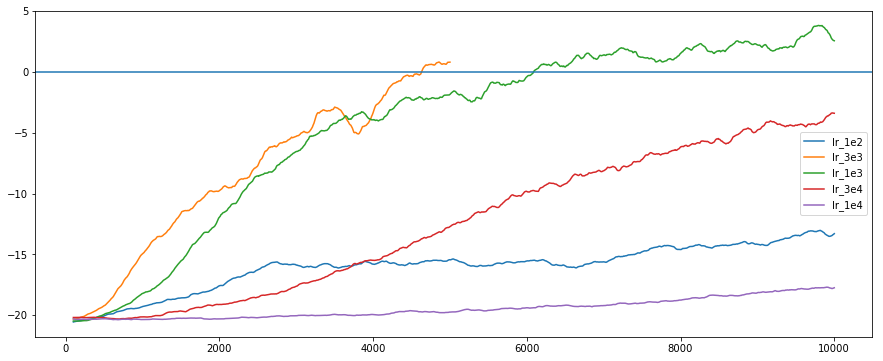

In [19]:
# Image source: https://gist.github.com/karpathy/a4166c7fe253700972fcbc77e4ea32c5#gistcomment-2205995
Image(filename='nn2.png') 